# Descarga de dataset

In [1]:
import gdown
import zipfile
import os

import numpy as np
import pandas as pd

import cv2
import matplotlib.pyplot as plt

!pip install ultralytics
from ultralytics import YOLO

import random
random.seed(123)

In [2]:
# Descargar el archivo desde Google Drive
file_id_train = '1CfmoYVoReTBciCvEY9PChq-H0MpPTccN'
gdown.download(f'https://drive.google.com/uc?id={file_id_train}', 'VisDrone2019-DET-train.zip', quiet=False)

# Descomprimir el archivo
with zipfile.ZipFile("VisDrone2019-DET-train.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")

# Eliminar el archivo zip después de la extracción
os.remove("VisDrone2019-DET-train.zip")


Downloading...
From (original): https://drive.google.com/uc?id=1CfmoYVoReTBciCvEY9PChq-H0MpPTccN
From (redirected): https://drive.google.com/uc?id=1CfmoYVoReTBciCvEY9PChq-H0MpPTccN&confirm=t&uuid=87183621-b5d8-471d-ad61-e952e003e02d
To: /content/VisDrone2019-DET-train.zip
100%|██████████| 1.55G/1.55G [00:22<00:00, 68.5MB/s]


In [3]:
file_id_val = '1BxxRDPHMkchfopDHTbjGpBkBg3EhkHwJ'
gdown.download(f'https://drive.google.com/uc?id={file_id_val}', 'VisDrone2019-DET-val.zip', quiet=False)

# Descomprimir el archivo
with zipfile.ZipFile("VisDrone2019-DET-val.zip", 'r') as zip_ref:
    zip_ref.extractall("/content")

# Eliminar el archivo zip después de la extracción
os.remove("VisDrone2019-DET-val.zip")



Downloading...
From (original): https://drive.google.com/uc?id=1BxxRDPHMkchfopDHTbjGpBkBg3EhkHwJ
From (redirected): https://drive.google.com/uc?id=1BxxRDPHMkchfopDHTbjGpBkBg3EhkHwJ&confirm=t&uuid=f048e574-f052-4ae9-82b1-a31b414d5800
To: /content/VisDrone2019-DET-val.zip
100%|██████████| 81.6M/81.6M [00:01<00:00, 48.8MB/s]


El dataset VisDrone utiliza un formato de anotación específico para describir la ubicación y el tipo de objetos presentes en las imágenes. Cada anotación se almacena en un archivo .txt correspondiente a cada imagen, que contiene la siguiente información:

- **x1, y1, x2, y2:**  Coordenadas del cuadro delimitador (bounding box) del objeto, donde (x1, y1) es la esquina superior izquierda y (x2, y2) la esquina inferior derecha.
- **object_id:** Identificador numérico del tipo de objeto detectado.  
- **occluded:** Indica si el objeto está ocluido (0: no ocluido, 1: ocluido).
- **truncated:** Indica si el objeto está truncado (0: no truncado, 1: truncado).

Estas anotaciones serán convertidas a un formato más compatible, en este caso Yolo, mediante el script obtenido del siguiente archivo ofrecido por Ultralytics:

https://raw.githubusercontent.com/ultralytics/yolov5/master/data/VisDrone.yaml

Se utilizará este formato como base y luego, dependiendo del modelo a entrenar, se realizarán nuevas conversiones en caso de ser necesario.

# Conversion a formato YOLO

In [4]:
def visdrone2yolo(dir):
    from PIL import Image
    from tqdm import tqdm

    def convert_box(size, box):
        # Convert VisDrone box to YOLO xywh box
        dw = 1. / size[0]
        dh = 1. / size[1]
        return (box[0] + box[2] / 2) * dw, (box[1] + box[3] / 2) * dh, box[2] * dw, box[3] * dh

    (dir / 'labels').mkdir(parents=True, exist_ok=True)  # make labels directory
    pbar = tqdm((dir / 'annotations').glob('*.txt'), desc=f'Converting {dir}')
    for f in pbar:
        img_size = Image.open((dir / 'images' / f.name).with_suffix('.jpg')).size
        lines = []
        with open(f, 'r') as file:  # read annotation.txt
            for row in [x.split(',') for x in file.read().strip().splitlines()]:
                if row[4] == '0':  # VisDrone 'ignored regions' class 0
                    continue
                cls = int(row[5]) - 1
                box = convert_box(img_size, tuple(map(int, row[:4])))
                lines.append(f"{cls} {' '.join(f'{x:.6f}' for x in box)}\n")
                with open(str(f).replace(os.sep + 'annotations' + os.sep, os.sep + 'labels' + os.sep), 'w') as fl:
                    fl.writelines(lines)  # write label.txt

In [5]:
from pathlib import Path

train_dir = Path('/content/VisDrone2019-DET-train')
val_dir = Path('/content/VisDrone2019-DET-val')

visdrone2yolo(train_dir)
visdrone2yolo(val_dir)


Converting /content/VisDrone2019-DET-train: 6471it [00:45, 143.24it/s]
Converting /content/VisDrone2019-DET-val: 548it [00:04, 126.64it/s]


In [6]:
%%writefile label_map.txt
0 pedestrian
1 people
2 bicycle
3 car
4 van
5 truck
6 tricycle
7 awning-tricycle
8 bus
9 motor

Writing label_map.txt


In [7]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone2019-DET-train/images'
labels_dir_train = 'VisDrone2019-DET-train/labels'

images_dir_val = 'VisDrone2019-DET-val/images'
labels_dir_val = 'VisDrone2019-DET-val/labels'

# Análisis de datos

## Código de las clases

In [8]:
file_path = 'label_map.txt'

# Leer el archivo y crear una lista de diccionarios con label y category
data = []
with open(file_path, 'r') as file:
    for line in file:
        label, category = line.strip().split(' ', 1)
        data.append({'label': int(label), 'category': category})

# Convertir la lista de diccionarios en un DataFrame
df = pd.DataFrame(data)
df


,label,category
0,0,pedestrian
1,1,people
2,2,bicycle
3,3,car
4,4,van
5,5,truck
6,6,tricycle
7,7,awning-tricycle
8,8,bus
9,9,motor


## Balance de clases

In [9]:
category_counts = {}
images = 0


# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

Cantidad de imagenes: 6471


In [10]:
df_merged = pd.merge(df_counts, df, on='label')

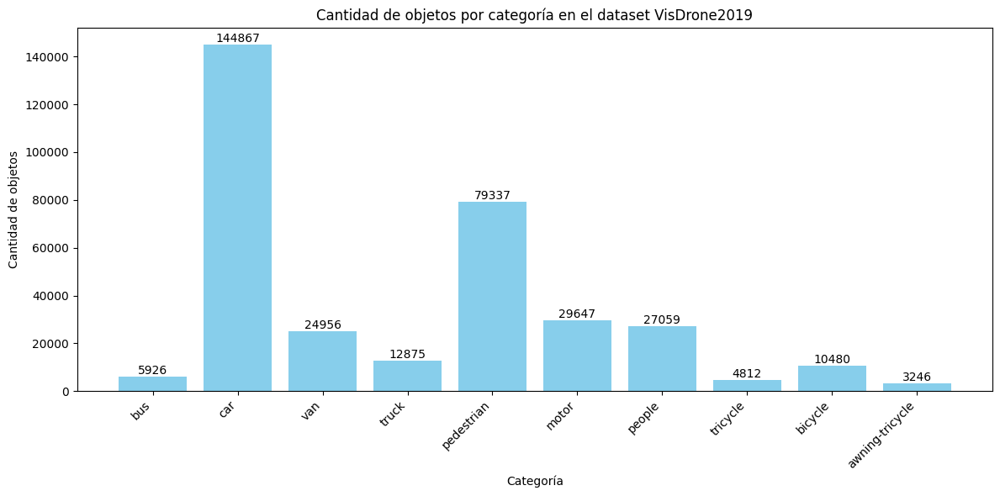

In [11]:
plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

Este gráfico permite visualizar la distribución de las clases en el dataset. Se puede ver que notoriamente la clase `car` es la que presenta mayor cantidad de detecciones, seguida por `pedestrian`. Entre las que presentan un número bastante menor se destacan `awning-tricycle`, `tricycle` y `bus`. Esto es necesario tenerlo en cuenta cuando se observen los resultados de los primeros entrenamientos. Es posible que los modelos tengan dificultades en detectar estas clases, aunque dependerá de las características particulares de las mismas y qué tan distinguibles son del resto.

## Bounding Boxes

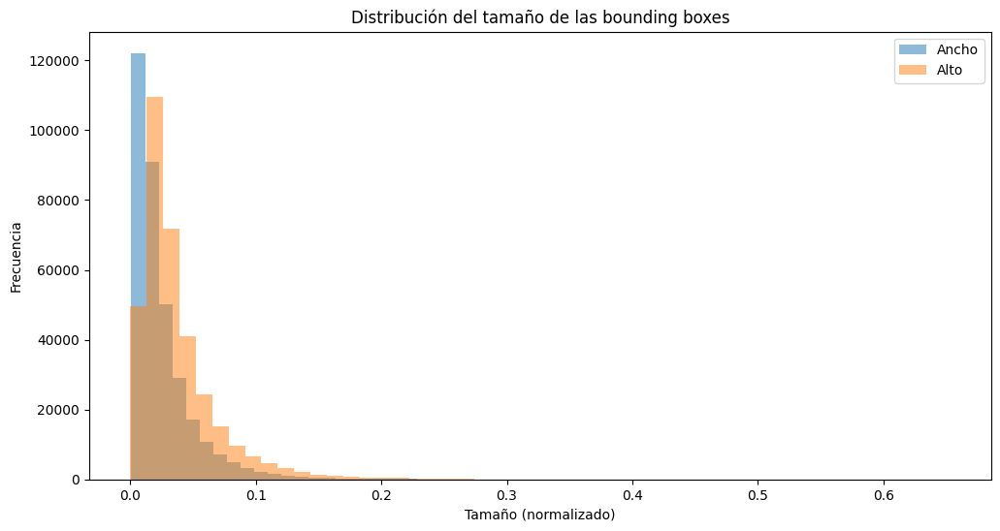

In [12]:
bbox_widths = []
bbox_heights = []

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                _, x_center, y_center, width, height, *_ = line.split()
                bbox_widths.append(float(width))
                bbox_heights.append(float(height))

plt.figure(figsize=(12, 6))
plt.hist(bbox_widths, bins=50, alpha=0.5, label='Ancho')
plt.hist(bbox_heights, bins=50, alpha=0.5, label='Alto')
plt.xlabel('Tamaño (normalizado)')
plt.ylabel('Frecuencia')
plt.title('Distribución del tamaño de las bounding boxes')
plt.legend()
plt.show()

Este gráfico muestra la distribución del ancho y alto de las *bounding boxes* del dataset. Se puede observar que la gran mayoría tiene un tamaño pequeño en relación con las dimensiones de la imagen. Tal como se mencionó anteriormente, tanto el ancho como el alto están normalizados entre 0 y 1.

El hecho de que haya *bounding boxes* tan pequeños en relación al tamaño de la imagen, sugiere que las mismas fueron tomadas a una distancia considerable de los diferentes objetivos. En este caso es normal, considerando las mismas fueron tomadas desde drones.

Esta información podría ser útil al momento del entrenamiento, ya que podría influir en el tamaño de la red y la estrategia de redimensionamiento de las imágenes.

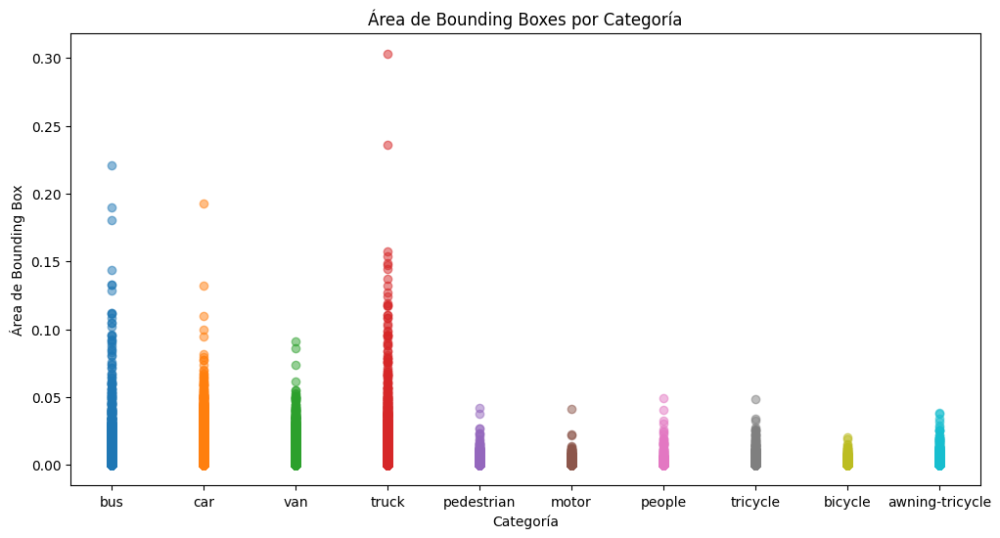

In [13]:
category_areas = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas:
                    category_areas[category] = []
                category_areas[category].append(area)

plt.figure(figsize=(12, 6))

for category, areas in category_areas.items():
  plt.scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)

plt.xlabel('Categoría')
plt.ylabel('Área de Bounding Box')
plt.title('Área de Bounding Boxes por Categoría')
#plt.legend()
plt.show()


Este gráfico muestra la distribución del área de las *bounding boxes* para cada categoría. Permite observar la variabilidad de los objetos detectados para cada clase.

Generalmente, se puede observar que los tamaños se distribuyen de acuerdo al tamaño de los objetos en la realidad. Lo que sugiere que las fotografías fueron tomadas utilizando un plano general y no enfocándose en un objeto particular.

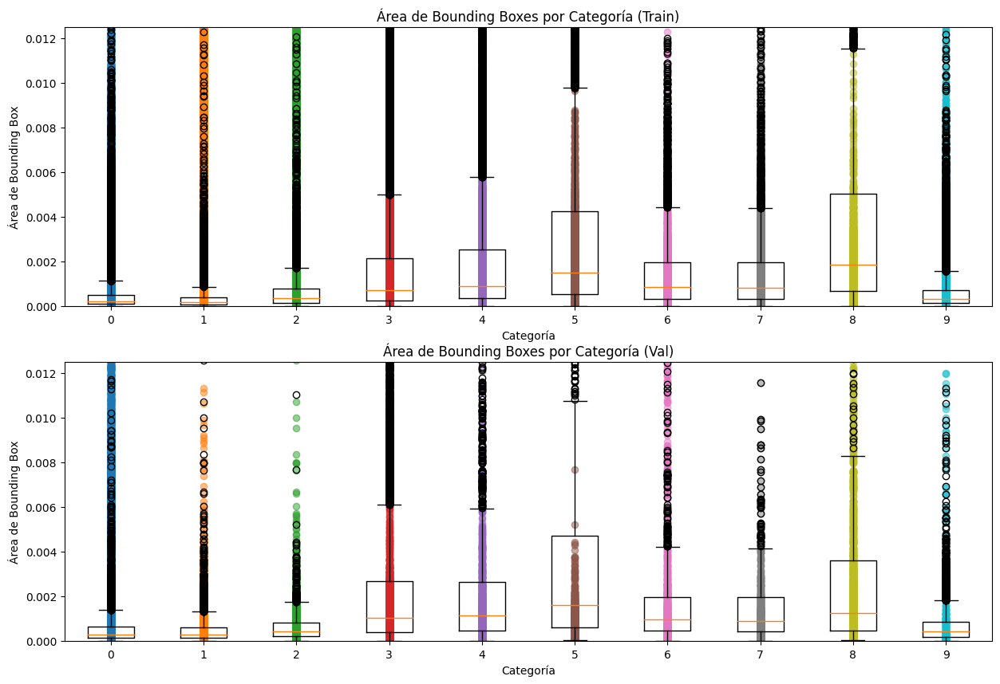

In [14]:
category_areas_train = {}
category_areas_val = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas_train:
                    category_areas_train[category] = []
                category_areas_train[category].append(area)

for filename in os.listdir(labels_dir_val):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_val, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                area = float(width) * float(height)
                if category not in category_areas_val:
                    category_areas_val[category] = []
                category_areas_val[category].append(area)

fig, axs = plt.subplots(2, 1, figsize=(15, 10))

for category, areas in category_areas_train.items():
  axs[0].scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  axs[0].boxplot(areas, positions=[category], widths=0.5)

axs[0].set_xlabel('Categoría')
axs[0].set_ylabel('Área de Bounding Box')
axs[0].set_title('Área de Bounding Boxes por Categoría (Train)')
axs[0].set_ylim(0, 0.0125)

for category, areas in category_areas_val.items():
  axs[1].scatter([df[df['label'] == category]['category'].values[0]] * len(areas), areas, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  axs[1].boxplot(areas, positions=[category], widths=0.5)

axs[1].set_xlabel('Categoría')
axs[1].set_ylabel('Área de Bounding Box')
axs[1].set_title('Área de Bounding Boxes por Categoría (Val)')
axs[1].set_ylim(0, 0.0125)

plt.show()

Se puede observar que las distribuciones mantienen su características en ambos datasets (train y validation). Las clases con mayor area corresponden a objetos de mayor tamaño (5-truck y 8-bus).

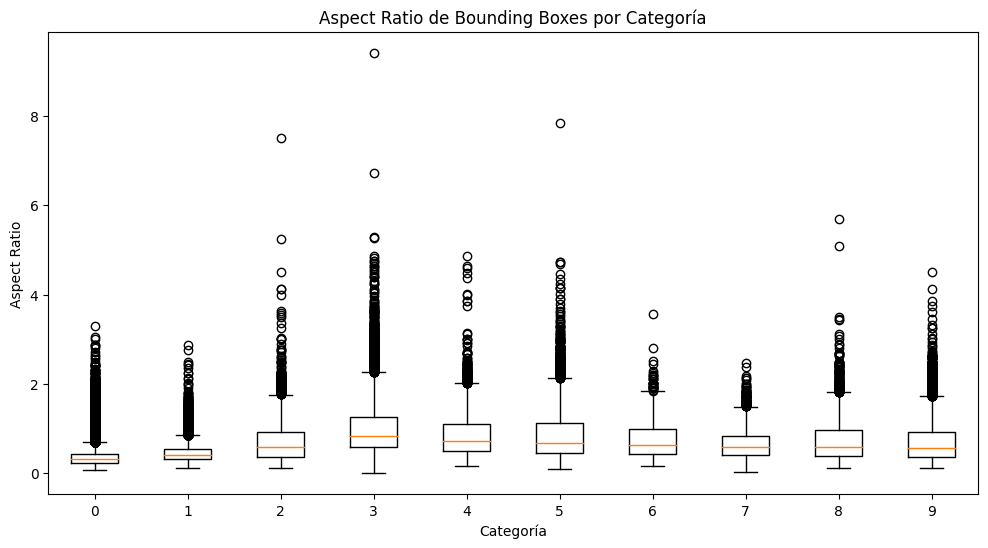

In [15]:
category_aspect_ratios = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height, *_ = line.split()
                category = int(category)
                if float(height) == 0 or float(width) == 0:
                    aspect_ratio = 0
                else:
                    aspect_ratio = float(width) / float(height)
                if category not in category_aspect_ratios:
                    category_aspect_ratios[category] = []
                category_aspect_ratios[category].append(aspect_ratio)

plt.figure(figsize=(12, 6))

for category, aspect_ratios in category_aspect_ratios.items():
  #plt.scatter([df[df['label'] == category]['category'].values[0]] * len(aspect_ratios), aspect_ratios, label=df[df['label'] == category]['category'].values[0], alpha=0.5)
  plt.boxplot(aspect_ratios, positions=[category], widths=0.5)

plt.xlabel('Categoría')
plt.ylabel('Aspect Ratio')
plt.title('Aspect Ratio de Bounding Boxes por Categoría')
#plt.legend()
plt.show()


En este gráfico se muestra la relación entre el ancho y el alto (aspect ratio) de las bounding boxes para cada clase. Cada punto representa una bounding box y la dispersión de los mismos indica la variabilidad de las relaciones de aspecto para cada clase.

Se puede observar una gran variabilidad de relaciones de aspecto, siendo en su gran mayoría de formas aproximadamente cuadradas. Para algunas clases se observa que el valor de la media es cercano a un Aspect Ratio = 0 (width < height), sobretodo en lo que refiere a las clases 0-pedestrian y 1-people.

Esta dispersión de los puntos no indica necesariamente variaciones en los aspectos de los objetos en la realidad, si no que probablemente se debe al ángulo en que los drones capturaron las fotos.

file =  9999985_00000_d_0000020.txt line =  3 0.437857 0.150476 0.002857 0.000000



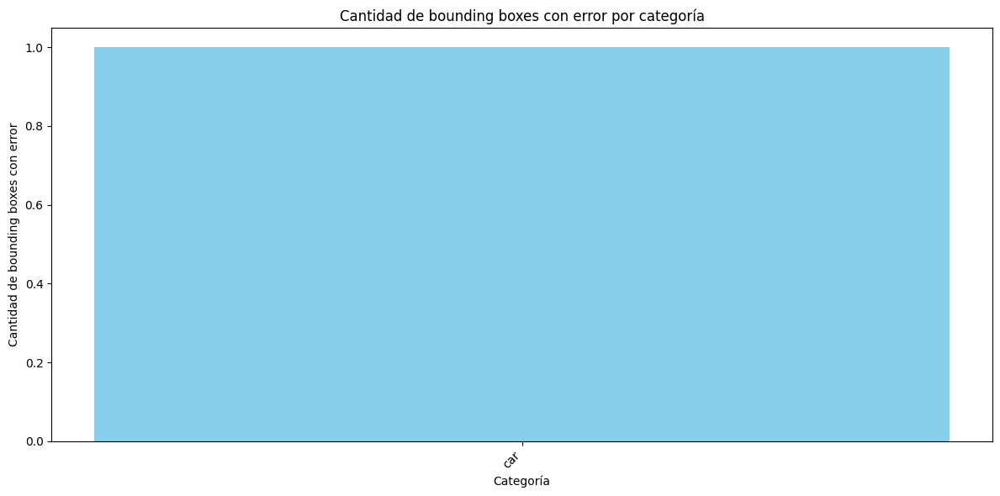

In [16]:
category_error_counts = {}

for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            for line in file:
                category, x_center, y_center, width, height = line.split()
                category = int(category)
                if float(width) <= 0 or float(height) <= 0 or float(x_center) < 0 or float(x_center) > 1 or float(y_center) < 0 or float(y_center) > 1:
                    if category not in category_error_counts:
                        category_error_counts[category] = 0
                    category_error_counts[category] += 1
                    print('file = ', filename, 'line = ', line)

# Convertir los datos a un DataFrame para facilitar el manejo
df_error_counts = pd.DataFrame(list(category_error_counts.items()), columns=['label', 'error_count'])

# Unir con el DataFrame original para obtener la categoría
df_merged_error = pd.merge(df_error_counts, df, on='label')

# Graficar la cantidad de bounding boxes con error por categoría
plt.figure(figsize=(12, 6))
plt.bar(df_merged_error['category'], df_merged_error['error_count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de bounding boxes con error')
plt.title('Cantidad de bounding boxes con error por categoría')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()


Como se puede observar, hay sólo una anotación con error en el dataset en la que no se definió el alto de la bounding box. Esto no significa que el resto de las anotaciones sean perfectas, pero es una buena señal.

En las celdas siguientes se realizará una exploración visual de algunas imágenes del conjunto de entrenamiento.

# Visualización de las clases

In [17]:
def show_images_with_bboxes(image_files, images_dir, labels_dir, df):
  """
  Muestra imágenes con sus correspondientes bounding boxes.

  Args:
    image_files: Lista de nombres de archivos de imágenes.
    images_dir: Directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Cargar la imagen
      image = cv2.imread(image_path)
      image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

      # Mostrar la imagen
      plt.figure(figsize=(10, 6))
      plt.imshow(image)
      plt.title(image_file)
      plt.axis('off')
      plt.show()


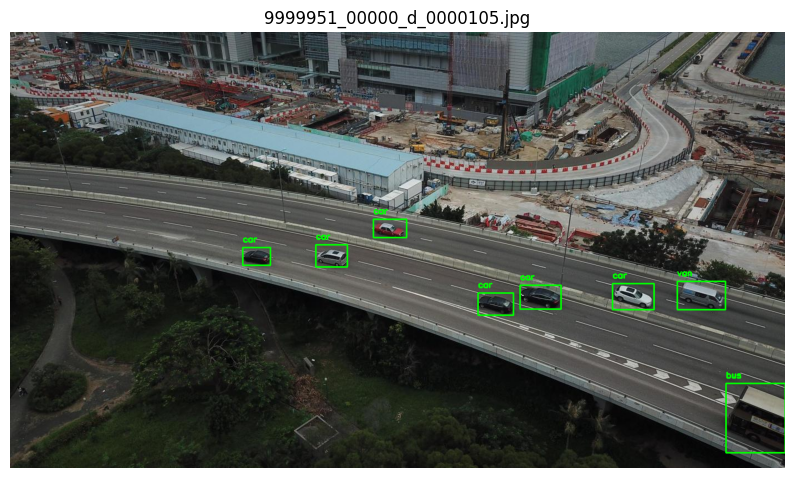

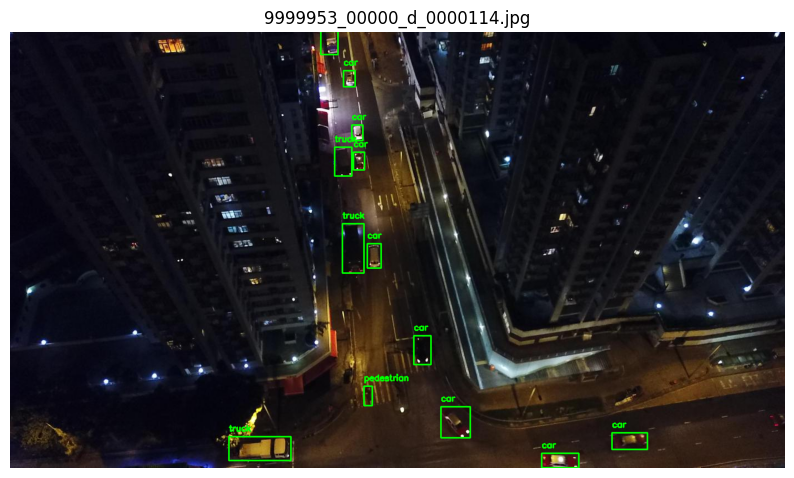

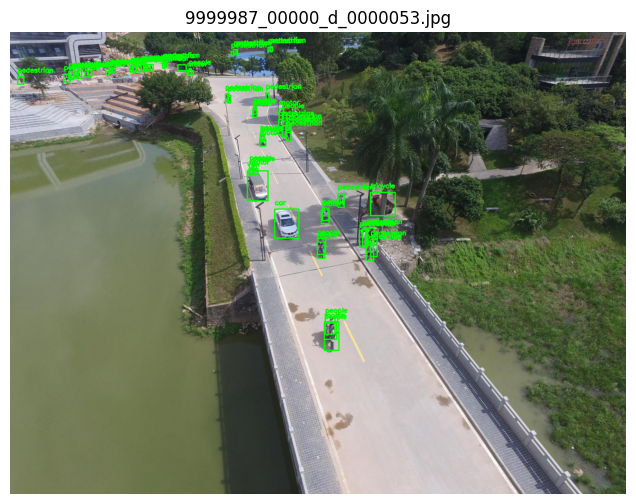

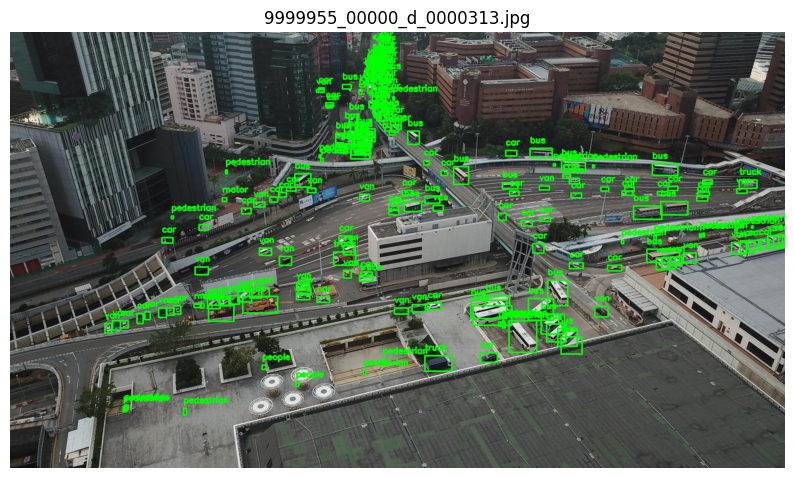

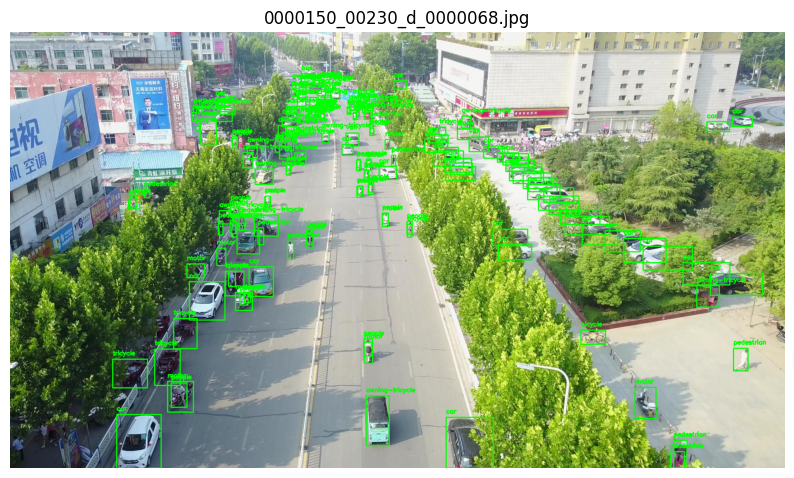

In [18]:
# Número de ejemplos a mostrar
num_examples = 5

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(images_dir_train) if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, images_dir_train, labels_dir_train, df)


In [19]:
def get_images_with_most_class(class_label, max_images=5):
  """
  Devuelve las imágenes con mayor cantidad de una clase dada.

  Args:
    class_label: Etiqueta de la clase a buscar.
    max_images: Número máximo de imágenes a devolver.

  Returns:
    Lista de nombres de archivos de imágenes con mayor cantidad de la clase.
  """
  labels_dir = 'VisDrone2019-DET-train/labels'
  class_image_counts = {}

  for filename in os.listdir(labels_dir):
      if filename.endswith('.txt'):
          with open(os.path.join(labels_dir, filename), 'r') as file:
              for line in file:
                  category, *_ = line.split()
                  category = int(category)
                  if category == class_label:  # Buscar la clase específica
                      image_name = filename.replace('.txt', '.jpg')
                      if image_name not in class_image_counts:
                          class_image_counts[image_name] = 0
                      class_image_counts[image_name] += 1

  sorted_images = sorted(class_image_counts.items(), key=lambda item: item[1], reverse=True)

  return [x[0] for x in sorted_images[:max_images]]

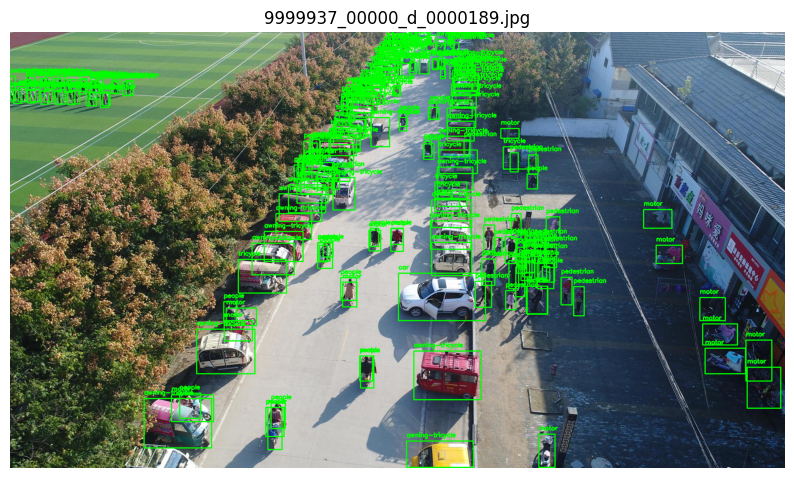

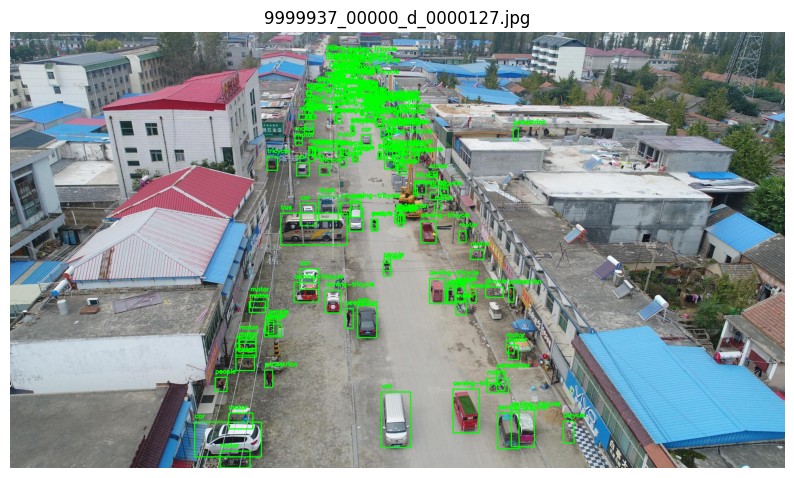

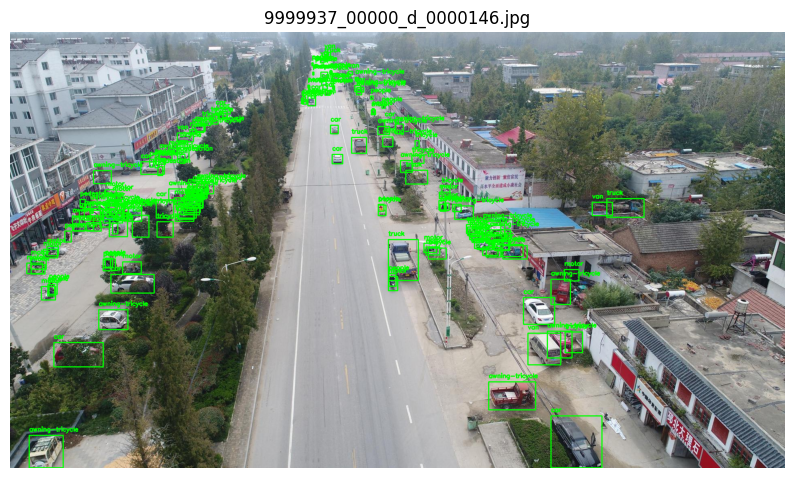

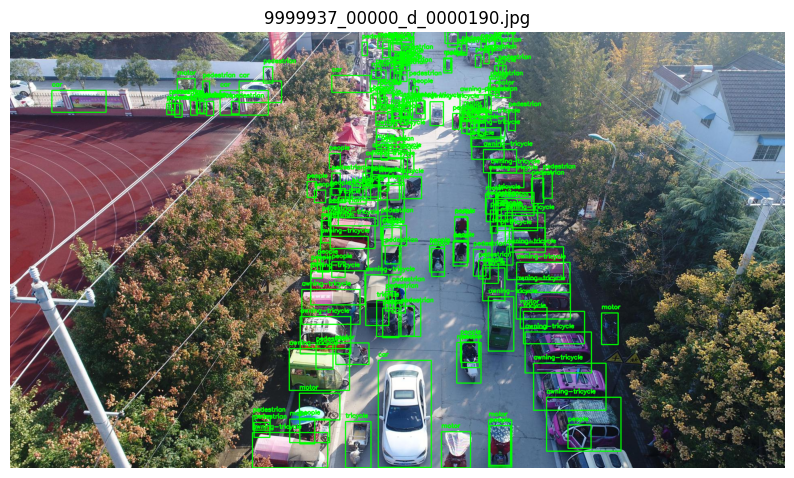

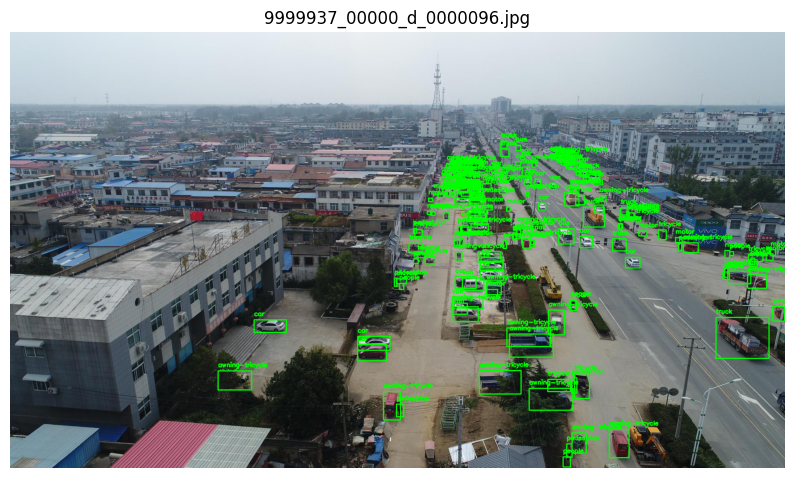

In [20]:
# Ejemplo de uso: obtener las 5 imágenes con más "awning-tricycle" (clase 7)
images_with_awning_tricycle = get_images_with_most_class(7, max_images=5)

# Mostrar las imágenes encontradas
show_images_with_bboxes(images_with_awning_tricycle, images_dir_train, labels_dir_train, df)

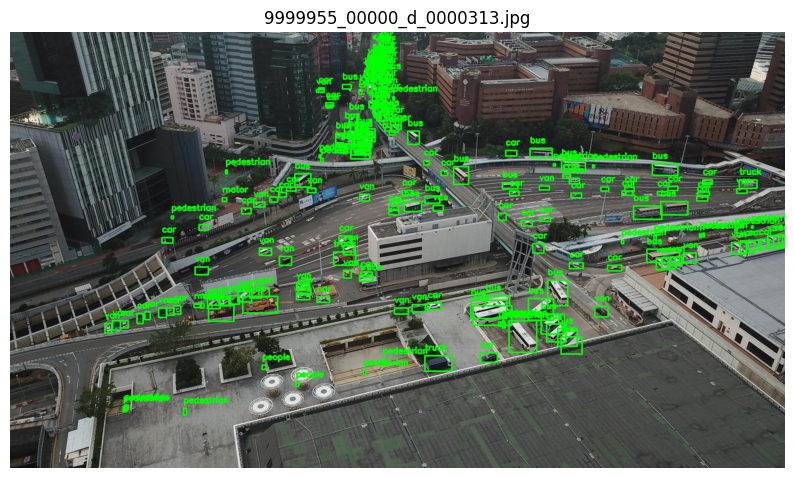

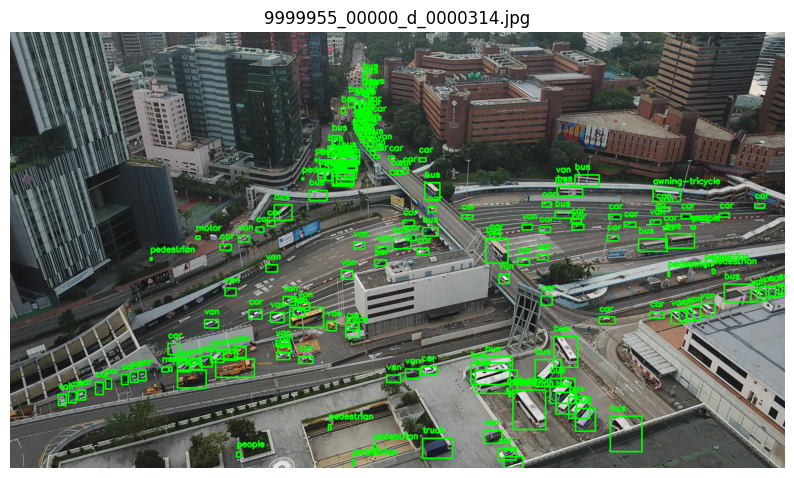

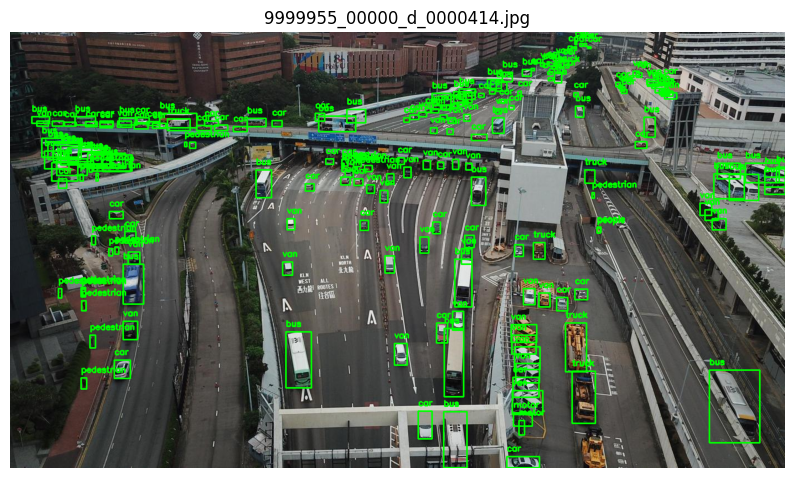

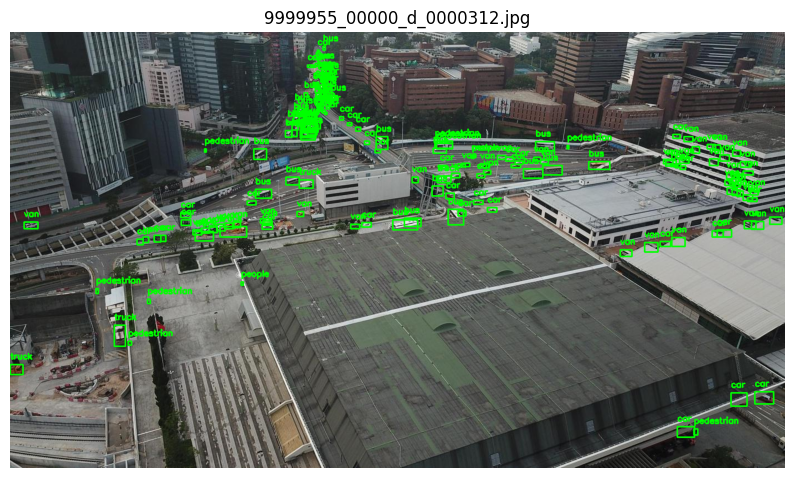

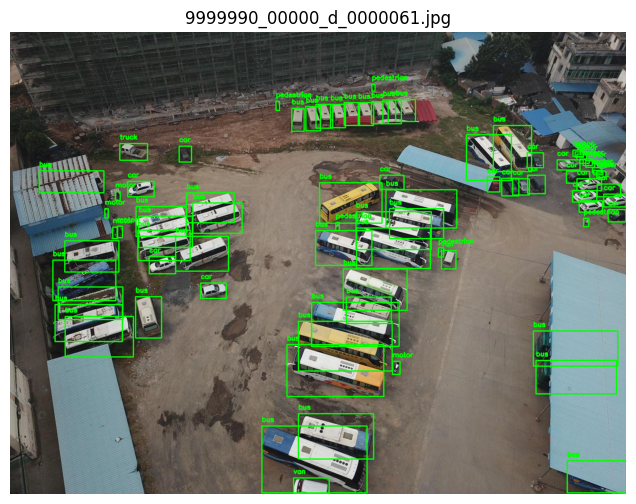

In [21]:
# Ejemplo de uso: obtener las 5 imágenes con más "bus" (clase 8)
images_with_awning_tricycle = get_images_with_most_class(8, max_images=5)

# Mostrar las imágenes encontradas
show_images_with_bboxes(images_with_awning_tricycle, images_dir_train, labels_dir_train, df)

In [22]:
def get_images_with_highest_proportion_of_class(class_name, labels_dir, max_images=5):
  """
  Dada una clase, devuelve las imágenes que tienen mayor proporción de dicha clase respecto a las demás.

  Args:
    class_name: El nombre de la clase a buscar (e.g., 'awning-tricycle').
    max_images: El máximo de imágenes a devolver.

  Returns:
    Una lista de tuplas (image_name, proportion), donde image_name es el nombre
    de la imagen y proportion es la proporción de la clase en la imagen.
  """

  class_label = df[df['category'] == class_name]['label'].values[0]
  images_with_class_counts = {}

  for filename in os.listdir(labels_dir):
    if filename.endswith('.txt'):
      with open(os.path.join(labels_dir, filename), 'r') as file:
        total_objects = 0
        class_objects = 0
        for line in file:
          category, *_ = line.split()
          category = int(category)
          total_objects += 1
          if category == class_label:
            class_objects += 1

        if total_objects > 0:
          proportion = class_objects / total_objects
          image_name = filename.replace('.txt', '.jpg')
          images_with_class_counts[image_name] = proportion

  sorted_images = sorted(images_with_class_counts.items(), key=lambda item: item[1], reverse=True)

  return sorted_images[:max_images]


Imágenes con mayor proporción de la clase 'awning-tricycle':
- 9999937_00000_d_0000183.jpg: Proporción = 0.33
- 9999937_00000_d_0000224.jpg: Proporción = 0.26
- 9999942_00000_d_0000158.jpg: Proporción = 0.25
- 9999937_00000_d_0000219.jpg: Proporción = 0.24
- 9999937_00000_d_0000184.jpg: Proporción = 0.23


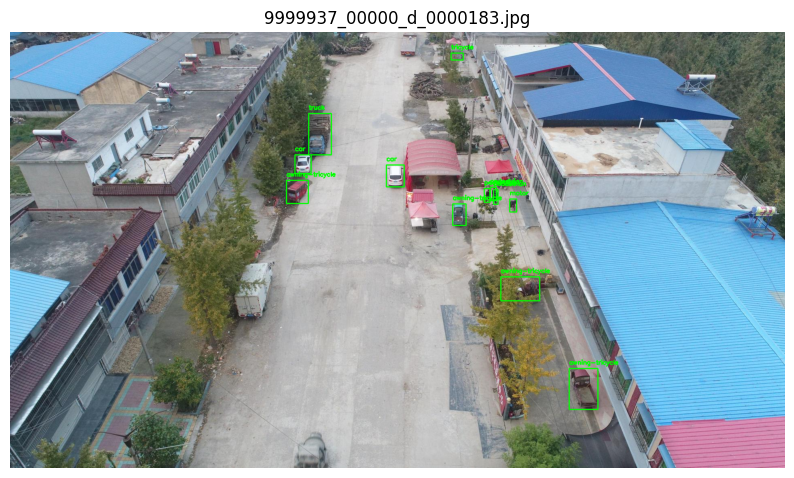

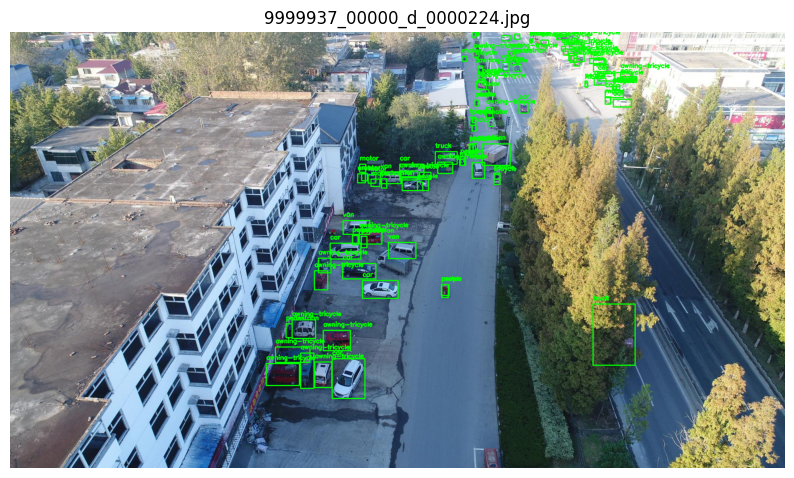

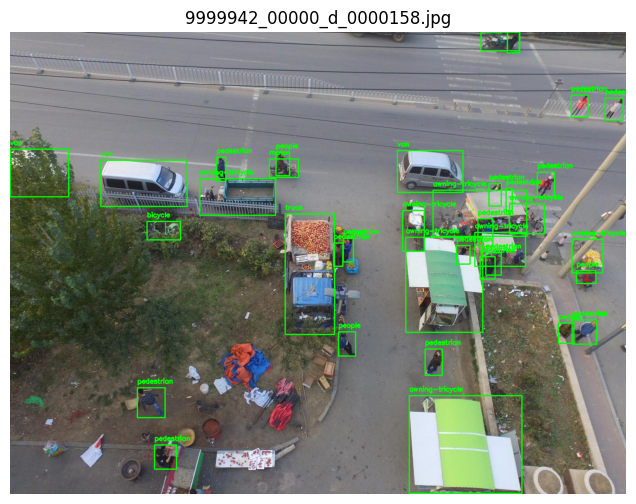

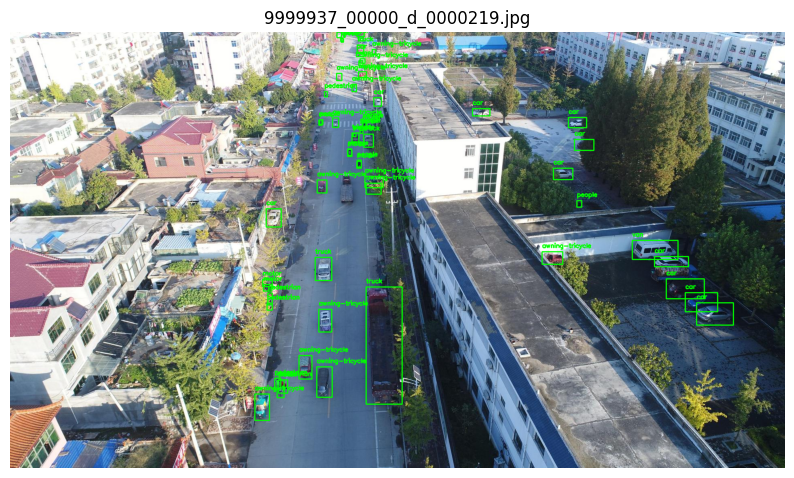

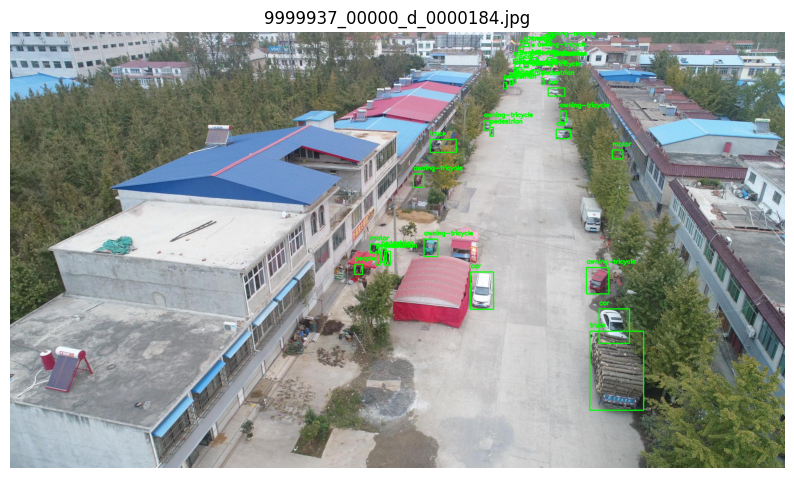

In [23]:
# Ejemplo de uso:
class_name_to_search = 'awning-tricycle'
max_images_to_return = 5
result = get_images_with_highest_proportion_of_class(class_name_to_search, labels_dir_train, max_images_to_return)

print(f"Imágenes con mayor proporción de la clase '{class_name_to_search}':")
for image_name, proportion in result:
  print(f"- {image_name}: Proporción = {proportion:.2f}")

show_images_with_bboxes([x[0] for x in result], images_dir_train, labels_dir_train, df)

Imágenes con mayor proporción de la clase 'bus':
- 9999956_00000_d_0000001.jpg: Proporción = 0.89
- 9999955_00000_d_0000120.jpg: Proporción = 0.75
- 9999955_00000_d_0000116.jpg: Proporción = 0.71
- 9999955_00000_d_0000118.jpg: Proporción = 0.70
- 9999951_00000_d_0000297.jpg: Proporción = 0.67


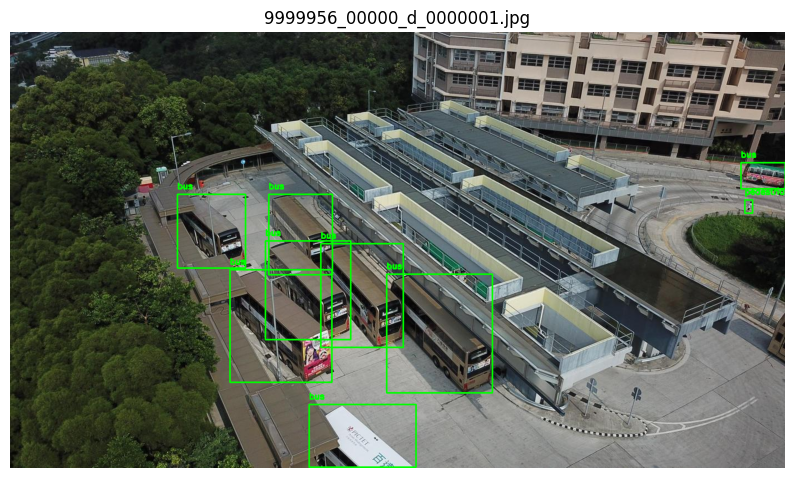

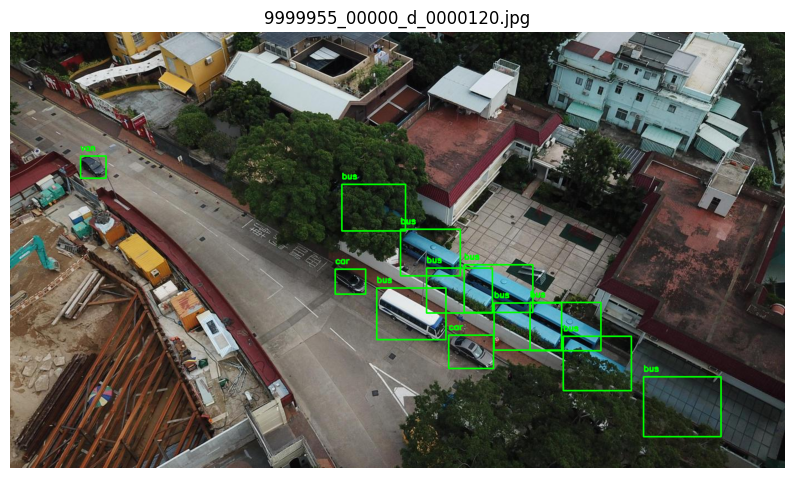

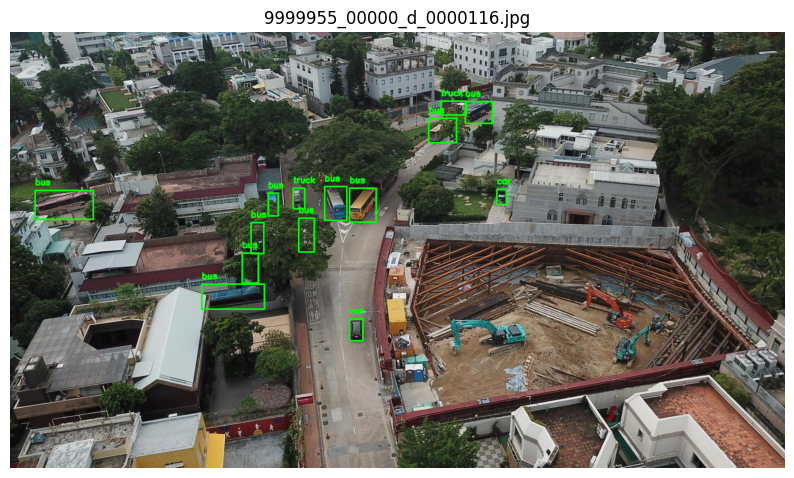

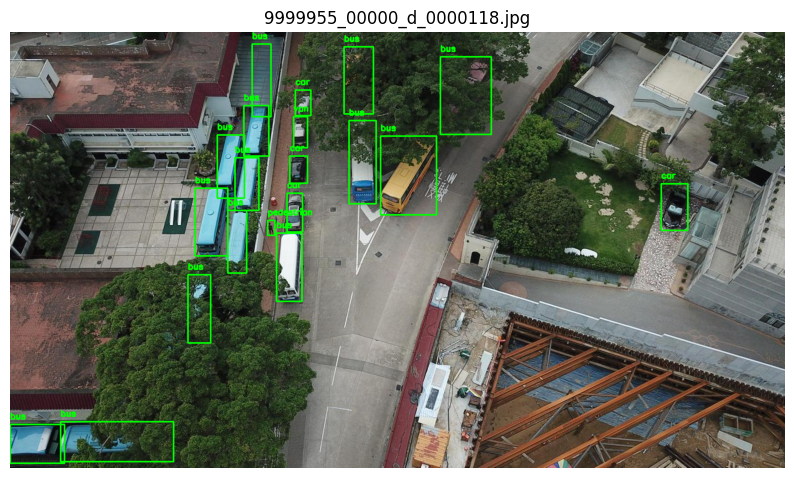

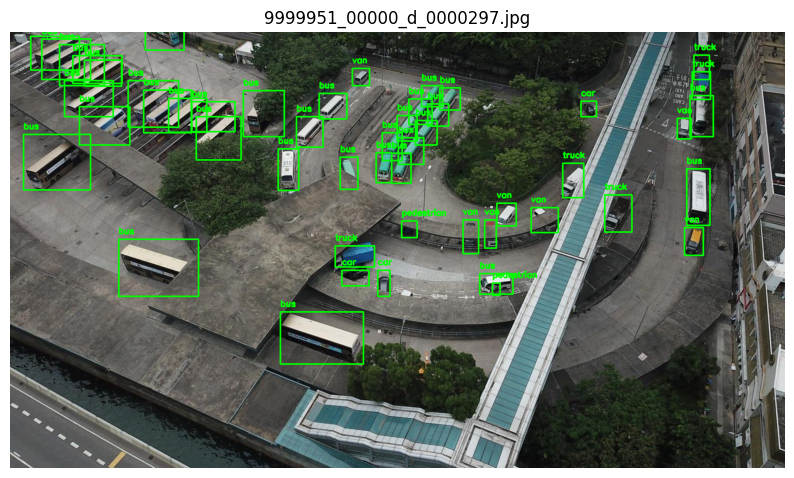

In [24]:
# Otro ejemplo de uso:
class_name_to_search = 'bus'
max_images_to_return = 5
result = get_images_with_highest_proportion_of_class(class_name_to_search, labels_dir_train, max_images_to_return)

print(f"Imágenes con mayor proporción de la clase '{class_name_to_search}':")
for image_name, proportion in result:
  print(f"- {image_name}: Proporción = {proportion:.2f}")

show_images_with_bboxes([x[0] for x in result], images_dir_train, labels_dir_train, df)

# Preprocesamiento
Filtrado según area del label en la imágen

In [25]:
def bounding_box_areas(image_file, images_dir, labels_dir):
  """
  Calcula el área de cada bounding box en una imagen y la asocia a su clase.

  Args:
    image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
    images_dir: El directorio donde se encuentra la imagen.
    labels_dir: El directorio donde se encuentra el archivo de etiquetas.

  Returns:
    Un diccionario donde las claves son los IDs de clase y los valores son
    listas de áreas de bounding boxes para esa clase.
  """

  image_path = os.path.join(images_dir, image_file)
  label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

  areas = {}
  if os.path.exists(label_path):
    with open(label_path, 'r') as f:
      for line in f:
        class_id, x_center, y_center, width, height, *_ = line.strip().split()
        class_id = int(class_id)
        area = float(width) * float(height)
        if class_id not in areas:
          areas[class_id] = []
        areas[class_id].append(area)
  return areas

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'  # Reemplazar con el nombre de tu imagen
images_dir = 'VisDrone2019-DET-train/images'  # Reemplazar con la ruta a tus imágenes
labels_dir = 'VisDrone2019-DET-train/labels'  # Reemplazar con la ruta a tus etiquetas

areas = bounding_box_areas(image_file, images_dir, labels_dir)

print(f"Áreas de las bounding boxes en {image_file}:")
for class_id, areas_list in areas.items():
  for i, area in enumerate(areas_list):
    print(f"  Clase {class_id}, Bounding box {i+1}: {area}")

Áreas de las bounding boxes en 9999937_00000_d_0000219.jpg:
  Clase 3, Bounding box 1: 0.0024231949000000003
  Clase 3, Bounding box 2: 0.0018204326459999999
  Clase 3, Bounding box 3: 0.002230067755
  Clase 3, Bounding box 4: 0.0010167166309999998
  Clase 3, Bounding box 5: 0.000650700648
  Clase 3, Bounding box 6: 0.0006042291880000001
  Clase 3, Bounding box 7: 0.000544663826
  Clase 3, Bounding box 8: 0.00037475321400000003
  Clase 3, Bounding box 9: 0.000806118384
  Clase 3, Bounding box 10: 0.000183023995
  Clase 3, Bounding box 11: 9.586658e-05
  Clase 3, Bounding box 12: 7.4558367e-05
  Clase 3, Bounding box 13: 5.325467599999999e-05
  Clase 4, Bounding box 1: 0.002571338223
  Clase 4, Bounding box 2: 6.390765200000001e-05
  Clase 7, Bounding box 1: 0.000765453826
  Clase 7, Bounding box 2: 0.001379841309
  Clase 7, Bounding box 3: 0.0008705325399999999
  Clase 7, Bounding box 4: 0.00084051864
  Clase 7, Bounding box 5: 0.0011329203330000001
  Clase 7, Bounding box 6: 0.0003718

In [26]:
def filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold=0.001):
    """
    Filtra las bounding boxes en una imagen basándose en un umbral de área.

    Args:
      image_file: El nombre del archivo de imagen (e.g., 'imagen.jpg').
      images_dir: El directorio donde se encuentra la imagen.
      labels_dir: El directorio donde se encuentra el archivo de etiquetas.
      area_threshold: El umbral de área mínima para las bounding boxes.

    Returns:
      Una lista de líneas (labels) que cumplen con el criterio de área.
    """

    image_path = os.path.join(images_dir, image_file)
    label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

    filtered_lines = []
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            for line in f:
                class_id, x_center, y_center, width, height, *_ = line.strip().split()
                area = float(width) * float(height)
                if area >= area_threshold:
                    filtered_lines.append(line)
    return filtered_lines

# Ejemplo de uso
image_file = '9999937_00000_d_0000219.jpg'
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
area_threshold = 0.001  # Puedes ajustar este valor

filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

print(f"Labels filtrados para {image_file}:")
for line in filtered_labels:
    print(line.strip())

Labels filtrados para 9999937_00000_d_0000219.jpg:
3 0.909447 0.647032 0.047495 0.051020
3 0.892484 0.620130 0.041754 0.043599
3 0.871086 0.590445 0.049061 0.045455
4 0.832724 0.501391 0.058977 0.043599
3 0.853862 0.528293 0.043841 0.023191
5 0.482516 0.720315 0.046451 0.268089
7 0.406054 0.803803 0.019833 0.069573
7 0.325157 0.860390 0.018789 0.060297
5 0.404749 0.544527 0.021399 0.053803


# Nuevo dataset
Se va a armar un nuevo dataset filtrando los labels que ocupen un area muy pequeña en realacion a la imagen.

In [27]:
import os
import shutil
import random
from shutil import copyfile

In [28]:
def filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold=0.001, num_images=50):
    """
    Selecciona imágenes aleatorias, filtra las bounding boxes por área y guarda las imágenes y
    labels filtrados en un nuevo directorio.

    Args:
      images_dir: Directorio de imágenes.
      labels_dir: Directorio de etiquetas.
      output_dir: Directorio de salida.
      area_threshold: Umbral de área para filtrar bounding boxes.
      num_images: Número de imágenes a seleccionar.
    """
    # Crea el directorio de salida si no existe
    os.makedirs(output_dir, exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'images'), exist_ok=True)
    os.makedirs(os.path.join(output_dir, 'labels'), exist_ok=True)

    # Selecciona imágenes aleatorias
    image_files = random.sample(os.listdir(images_dir), num_images)

    for image_file in image_files:
        # Copia la imagen al directorio de salida
        image_path = os.path.join(images_dir, image_file)
        output_image_path = os.path.join(output_dir, 'images', image_file)
        copyfile(image_path, output_image_path)

        # Filtra las bounding boxes
        label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))
        filtered_labels = filter_bboxes_by_area(image_file, images_dir, labels_dir, area_threshold)

        # Guarda las etiquetas filtradas
        if len(filtered_labels) > 0: # no se guardan los .txt sin labels
            output_label_path = os.path.join(output_dir, 'labels', image_file.replace('.jpg', '.txt'))
            with open(output_label_path, 'w') as f:
                for line in filtered_labels:
                    f.write(line)


In [29]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
output_dir = 'VisDrone-AreaFilter-train'
area_threshold = 0.001
num_images = 500

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

In [30]:
def delete_images_without_labels(images_dir, labels_dir):
  """
  Elimina las imágenes que no tienen un archivo de etiquetas correspondiente.

  Args:
    images_dir: Directorio de imágenes.
    labels_dir: Directorio de etiquetas.
  """
  for image_file in os.listdir(images_dir):
    if image_file.endswith('.jpg'):
      label_file = image_file.replace('.jpg', '.txt')
      label_path = os.path.join(labels_dir, label_file)
      if not os.path.exists(label_path):
        image_path = os.path.join(images_dir, image_file)
        os.remove(image_path)
        print(f"Imagen eliminada: {image_file}")

In [31]:
# Ejemplo de uso
delete_images_without_labels(f"{output_dir}/images", f"{output_dir}/labels")

Imagen eliminada: 9999998_00026_d_0000019.jpg
Imagen eliminada: 9999977_00000_d_0000077.jpg
Imagen eliminada: 9999997_00000_d_0000028.jpg
Imagen eliminada: 9999982_00000_d_0000160.jpg
Imagen eliminada: 9999984_00000_d_0000020.jpg
Imagen eliminada: 9999997_00000_d_0000045.jpg
Imagen eliminada: 9999981_00000_d_0000009.jpg
Imagen eliminada: 9999984_00000_d_0000127.jpg
Imagen eliminada: 9999975_00000_d_0000017.jpg
Imagen eliminada: 0000210_01551_d_0000228.jpg
Imagen eliminada: 9999977_00000_d_0000054.jpg
Imagen eliminada: 9999975_00000_d_0000020.jpg
Imagen eliminada: 9999982_00000_d_0000183.jpg
Imagen eliminada: 9999955_00000_d_0000135.jpg
Imagen eliminada: 0000180_01400_d_0000026.jpg
Imagen eliminada: 9999955_00000_d_0000187.jpg
Imagen eliminada: 0000180_00000_d_0000019.jpg
Imagen eliminada: 9999997_00000_d_0000052.jpg
Imagen eliminada: 0000263_05001_d_0000192.jpg
Imagen eliminada: 9999997_00000_d_0000070.jpg
Imagen eliminada: 9999966_00000_d_0000012.jpg
Imagen eliminada: 9999982_00000_d_

In [32]:
#!rm -rf /content/VisDrone-AreaFilter-train

## Visualización de las clases

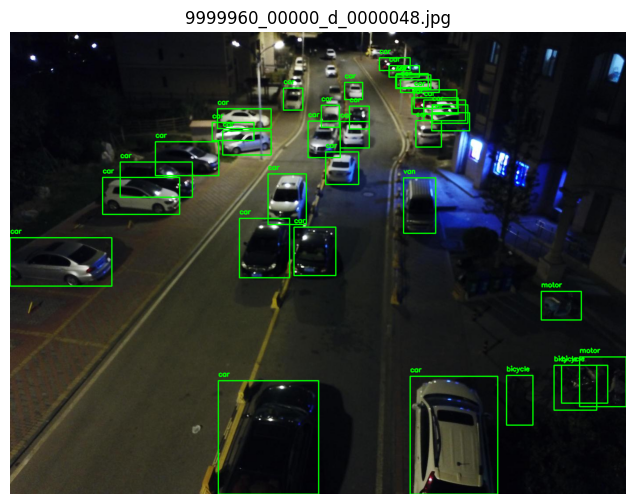

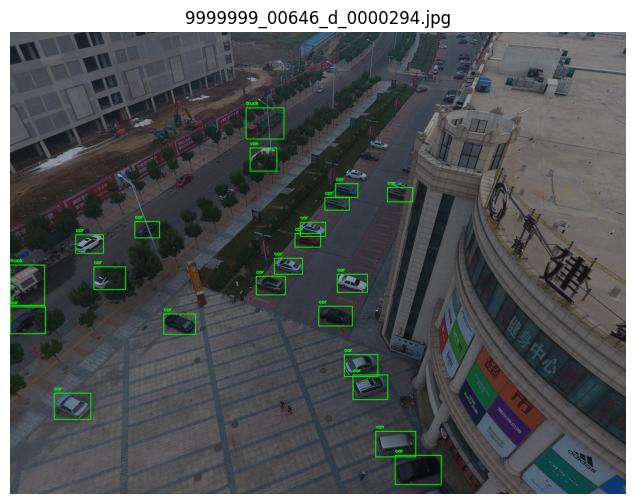

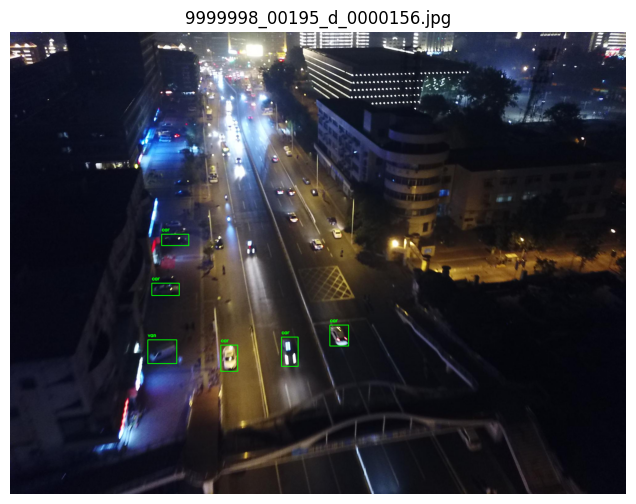

In [33]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df)

Repetimos proceso para dataset de validacion

In [34]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-val/images'
labels_dir = 'VisDrone2019-DET-val/labels'
output_dir = 'VisDrone-AreaFilter-val'
area_threshold = 0.001
num_images = 50

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

In [35]:
delete_images_without_labels(images_dir, labels_dir)

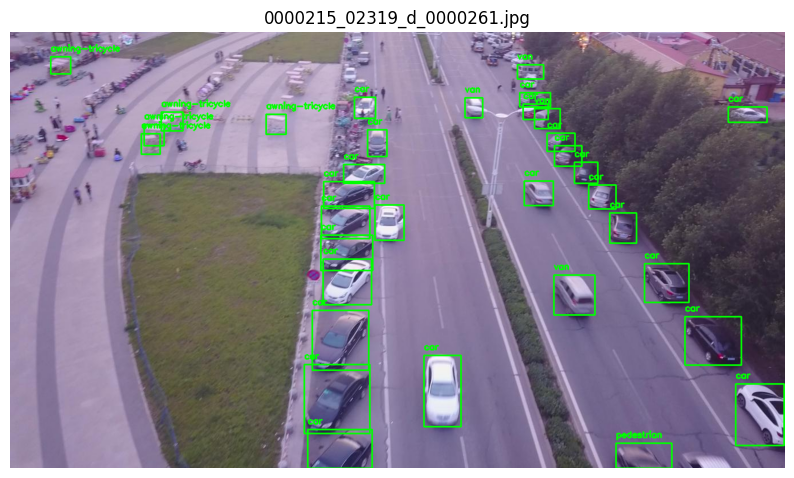

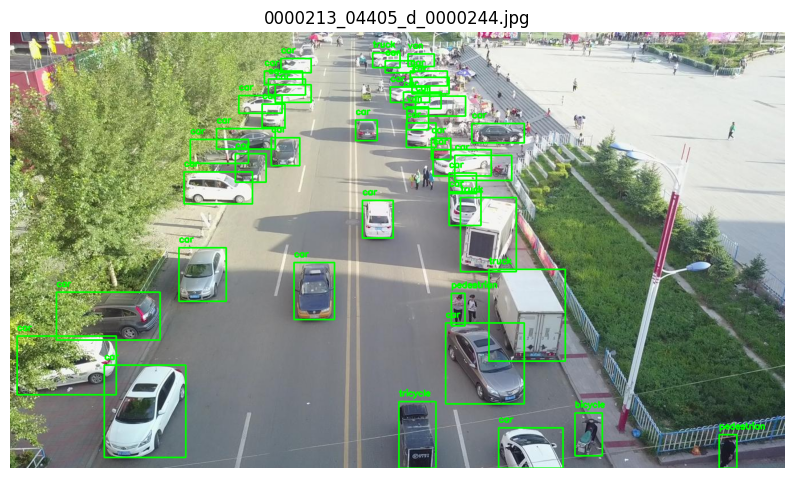

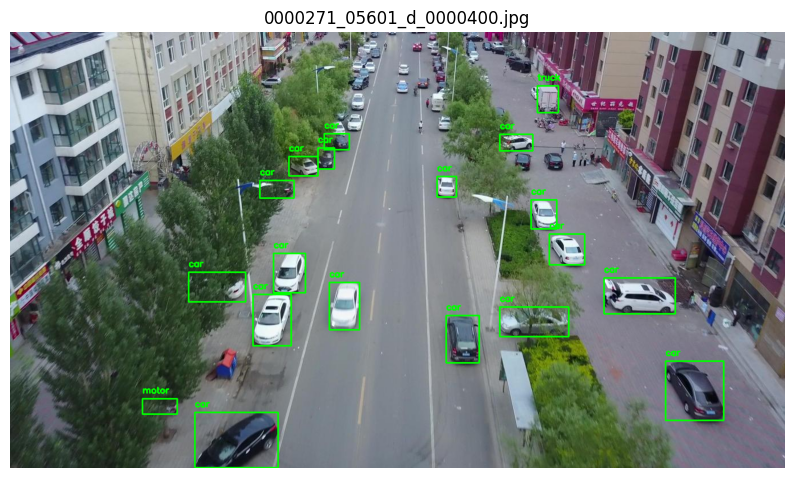

In [36]:
# Número de ejemplos a mostrar
num_examples = 3

# Lista de archivos de imágenes
image_files = [f for f in os.listdir(f'{output_dir}/images') if f.endswith('.jpg')]

# Seleccionar ejemplos aleatorios
random_image_files = random.sample(image_files, num_examples)

show_images_with_bboxes(random_image_files, f'{output_dir}/images', f'{output_dir}/labels', df)

Listo, ahora tenemos un nuevo dataset mas pequeño enfocado a objetos de gran tamaño.

## Nuevo balance de clases:

Cantidad de imagenes: 478


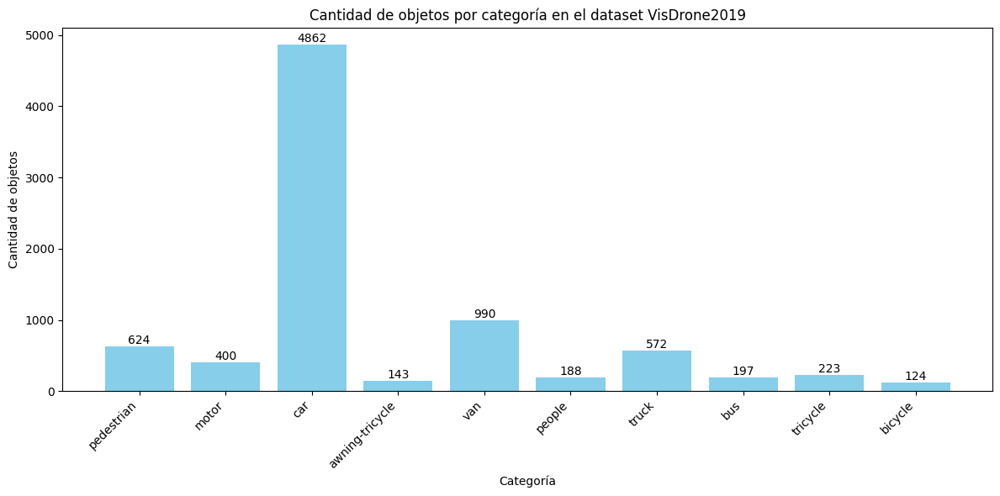

In [37]:
category_counts = {}
images = 0
labels_dir_train = 'VisDrone-AreaFilter-train/labels' #'VisDrone2019-DET-train/labels'

# Iterar sobre todos los archivos .txt en la carpeta
for filename in os.listdir(labels_dir_train):
    if filename.endswith('.txt'):
        # Abrir el archivo y contar cuántos objetos hay por categoría
        with open(os.path.join(labels_dir_train, filename), 'r') as file:
            images += 1
            for line in file:
                category = int(line.split()[0])  # El label de la categoría es la primera columna en YOLO
                category_counts[category] = category_counts.get(category, 0) + 1

# Convertir los datos a un DataFrame para facilitar el manejo
df_counts = pd.DataFrame(list(category_counts.items()), columns=['label', 'count'])
print("Cantidad de imagenes:",images)

df_merged = pd.merge(df_counts, df, on='label')

plt.figure(figsize=(12, 6))
bars = plt.bar(df_merged['category'], df_merged['count'], color='skyblue')
plt.xlabel('Categoría')
plt.ylabel('Cantidad de objetos')
plt.title('Cantidad de objetos por categoría en el dataset VisDrone2019')
plt.xticks(rotation=45, ha='right')

for bar in bars:
  yval = bar.get_height()
  plt.text(bar.get_x() + bar.get_width()/2, yval, int(yval), va='bottom', ha='center')

plt.tight_layout()
plt.show()

---

# Entrenamiento N 1

In [38]:
%%writefile data.yaml
train: ../../VisDrone-AreaFilter-train/images     #../../VisDrone2019-DET-train/images
val: ../../VisDrone-AreaFilter-val/images         # ../../VisDrone2019-DET-val/images

nc: 10
names: ['pedestrian', 'people', 'bicycle', 'car', 'van', 'truck', 'tricycle', 'awning-tricycle', 'bus', 'motor']


Writing data.yaml


## Predicción

In [39]:
def predict_and_show_images_comparison(image_files, model, images_dir, labels_dir, df, confidence_threshold=0.5):
  """
  Realiza predicciones con el modelo YOLO en un conjunto de imágenes y muestra las imágenes con las bounding boxes, comparando
  la predicción con las etiquetas reales.

  Args:
    image_files: Una lista de nombres de archivos de imágenes.
    model: El modelo YOLO a utilizar para las predicciones.
    images_dir: El directorio donde se encuentran las imágenes.
    labels_dir: Directorio donde se encuentran las etiquetas.
    df: DataFrame con la información de las etiquetas (label y category).
    confidence_threshold: El umbral de confianza para las predicciones.
  """
  for image_file in image_files:
      image_path = os.path.join(images_dir, image_file)
      label_path = os.path.join(labels_dir, image_file.replace('.jpg', '.txt'))

      # Realizar la predicción
      results = model(image_path)

      # Obtener la primera predicción (si hay más de una)
      predicted_image = cv2.imread(image_path)
      predicted_image = cv2.cvtColor(predicted_image, cv2.COLOR_BGR2RGB)
      if results and results[0].boxes:
          boxes = results[0].boxes.xywh.cpu().numpy()  # Coordenadas de las bounding boxes
          confidence = results[0].boxes.conf.cpu().numpy()
          class_ids = results[0].boxes.cls.cpu().numpy().astype(int)

          for box, conf, cls_id in zip(boxes, confidence, class_ids):
              if conf >= confidence_threshold:
                  x_center, y_center, width, height = box
                  x_min = int(x_center - width / 2)
                  y_min = int(y_center - height / 2)
                  x_max = int(x_center + width / 2)
                  y_max = int(y_center + height / 2)

                  # Dibujar la bounding box
                  cv2.rectangle(predicted_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == cls_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(predicted_image, f"{category}: {conf:.2f}", (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)


      # Cargar la imagen real con las bounding boxes reales
      real_image = cv2.imread(image_path)
      real_image = cv2.cvtColor(real_image, cv2.COLOR_BGR2RGB)

      # Cargar las etiquetas
      if os.path.exists(label_path):
          with open(label_path, 'r') as f:
              for line in f:
                  class_id, x_center, y_center, width, height, *_ = line.strip().split()
                  class_id = int(class_id)
                  x_center = float(x_center)
                  y_center = float(y_center)
                  width = float(width)
                  height = float(height)

                  # Calcular las coordenadas de la bounding box
                  image_height, image_width, _ = real_image.shape
                  x_min = int((x_center - width / 2) * image_width)
                  y_min = int((y_center - height / 2) * image_height)
                  x_max = int((x_center + width / 2) * image_width)
                  y_max = int((y_center + height / 2) * image_height)

                  # Dibujar la bounding box
                  cv2.rectangle(real_image, (x_min, y_min), (x_max, y_max), (0, 0, 255), 2)

                  # Obtener la etiqueta de la categoría
                  category = df[df['label'] == class_id]['category'].values[0]

                  # Agregar la etiqueta a la bounding box
                  cv2.putText(real_image, category, (x_min, y_min - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)


      # Combinar las imágenes lado a lado
      combined_image = np.concatenate((predicted_image, real_image), axis=1)

      # Mostrar la imagen combinada
      plt.figure(figsize=(15, 6))
      plt.imshow(combined_image)
      plt.title(f"Predicción vs. Real - {image_file}")
      plt.axis('off')
      plt.show()


In [40]:
# Directorio de imágenes y etiquetas
images_dir_train = 'VisDrone-AreaFilter-train/images'
labels_dir_train = 'VisDrone-AreaFilter-train/labels'

images_dir_val = 'VisDrone-AreaFilter-val/images'
labels_dir_val = 'VisDrone-AreaFilter-val/labels'

# Entrenamiento N 2

- Chequeo de la resolución original

In [41]:
import cv2

## Predicción

# Entrenamiento N 3

## Eliminamos algunas clases

Se van a eliminar las clases menos representativas, de peor calidad de imagen y que resultaron teniendo un mal rendimiento. El problema se va a enfocar solamente a vehículos de "gran" porte.

In [42]:
def delete_specific_labels(labels_dir, labels_to_delete):
    """
    Deletes specific labels from annotation files in a directory.

    Args:
        labels_dir: The directory containing the annotation files.
        labels_to_delete: A list of labels to delete.
    """
    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            filepath = os.path.join(labels_dir, filename)
            with open(filepath, 'r') as f:
                lines = f.readlines()

            filtered_lines = [line for line in lines if line.split()[0] not in labels_to_delete]

            with open(filepath, 'w') as f:
                f.writelines(filtered_lines)

In [43]:
# Specify the labels to delete (corresponding class IDs from label_map.txt)
labels_to_delete = ['1', '2', '6', '7']  # people, bicycle, tricycle, awning-tricycle

# Specify the directories for train and validation datasets
train_labels_dir = 'VisDrone-AreaFilter-train/labels'
val_labels_dir = 'VisDrone-AreaFilter-val/labels'

# Delete the labels from the datasets
delete_specific_labels(train_labels_dir, labels_to_delete)
delete_specific_labels(val_labels_dir, labels_to_delete)


- Chequeo balanceo de clases

In [44]:
def remap_class_ids(labels_dir, class_id_mapping):
    """
    Remaps class IDs in annotation files according to a mapping.

    Args:
        labels_dir: The directory containing the annotation files.
        class_id_mapping: A dictionary mapping old class IDs to new class IDs.
    """
    for filename in os.listdir(labels_dir):
        if filename.endswith('.txt'):
            filepath = os.path.join(labels_dir, filename)
            with open(filepath, 'r') as f:
                lines = f.readlines()

            updated_lines = []
            for line in lines:
                parts = line.strip().split()
                old_class_id = int(parts[0])
                if old_class_id in class_id_mapping:
                    new_class_id = class_id_mapping[old_class_id]
                    parts[0] = str(new_class_id)
                    updated_lines.append(' '.join(parts) + '\n')

            with open(filepath, 'w') as f:
                f.writelines(updated_lines)

In [45]:
# Buscamos evitar que yolo ignore las clases cuyo id supere el numero total de clases.
class_id_mapping = {
    0: 0,  # pedestrian remains 0
    3: 1,  # car becomes 1
    4: 2,  # van becomes 2
    5: 3,  # truck becomes 3
    8: 4,  # bus becomes 4
    9: 5   # motor becomes 5
}

In [46]:
remap_class_ids(train_labels_dir, class_id_mapping)
remap_class_ids(val_labels_dir, class_id_mapping)

print("Class IDs remapped in the datasets.")

Class IDs remapped in the datasets.


In [47]:
%%writefile data.yaml
train: ../../VisDrone-AreaFilter-train/images
val: ../../VisDrone-AreaFilter-val/images

nc: 6
names: ['pedestrian', 'car', 'van', 'truck', 'bus', 'motor']


Overwriting data.yaml


## Entrenamos

# Dataset final

- Dataset con filtro de area, disminución de clases y aumento de muestras.

## Train

In [48]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-train/images'
labels_dir = 'VisDrone2019-DET-train/labels'
output_dir = 'VisDrone-AreaFilter-10k-train'
area_threshold = 0.001
num_images = 5000

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

In [49]:
# Ejemplo de uso
delete_images_without_labels(f"{output_dir}/images", f"{output_dir}/labels")

Imagen eliminada: 9999998_00026_d_0000019.jpg
Imagen eliminada: 9999984_00000_d_0000032.jpg
Imagen eliminada: 9999997_00000_d_0000048.jpg
Imagen eliminada: 9999998_00041_d_0000033.jpg
Imagen eliminada: 9999975_00000_d_0000002.jpg
Imagen eliminada: 9999982_00000_d_0000121.jpg
Imagen eliminada: 9999998_00090_d_0000073.jpg
Imagen eliminada: 9999975_00000_d_0000022.jpg
Imagen eliminada: 9999977_00000_d_0000077.jpg
Imagen eliminada: 9999982_00000_d_0000160.jpg
Imagen eliminada: 9999987_00000_d_0000069.jpg
Imagen eliminada: 9999982_00000_d_0000057.jpg
Imagen eliminada: 9999984_00000_d_0000081.jpg
Imagen eliminada: 9999984_00000_d_0000084.jpg
Imagen eliminada: 9999956_00000_d_0000103.jpg
Imagen eliminada: 9999982_00000_d_0000203.jpg
Imagen eliminada: 9999975_00000_d_0000024.jpg
Imagen eliminada: 9999984_00000_d_0000158.jpg
Imagen eliminada: 9999953_00000_d_0000119.jpg
Imagen eliminada: 9999990_00000_d_0000004.jpg
Imagen eliminada: 9999975_00000_d_0000023.jpg
Imagen eliminada: 9999987_00000_d_

## Val

In [50]:
# Ejemplo de uso
images_dir = 'VisDrone2019-DET-val/images'
labels_dir = 'VisDrone2019-DET-val/labels'
output_dir = 'VisDrone-AreaFilter-10k-val'
area_threshold = 0.001
num_images = 500

filter_and_save_labels(images_dir, labels_dir, output_dir, area_threshold, num_images)

# Ejemplo de uso
delete_images_without_labels(f"{output_dir}/images", f"{output_dir}/labels")

Imagen eliminada: 0000276_02001_d_0000517.jpg
Imagen eliminada: 0000276_05801_d_0000536.jpg


## Limpieza de clases

In [51]:
# Specify the labels to delete (corresponding class IDs from label_map.txt)
labels_to_delete = ['1', '2', '6', '7']  # people, bicycle, tricycle, awning-tricycle

# Specify the directories for train and validation datasets
train_labels_dir = 'VisDrone-AreaFilter-10k-train/labels'
val_labels_dir = 'VisDrone-AreaFilter-10k-val/labels'

# Delete the labels from the datasets
delete_specific_labels(train_labels_dir, labels_to_delete)
delete_specific_labels(val_labels_dir, labels_to_delete)

In [52]:
remap_class_ids(train_labels_dir, class_id_mapping)
remap_class_ids(val_labels_dir, class_id_mapping)

print("Class IDs remapped in the datasets.")

Class IDs remapped in the datasets.


# Entrenamiento Final

# Tuneo de Hiperparámetros

In [53]:
%%writefile data.yaml
train: /content/VisDrone-AreaFilter-10k-train/images
val: /content/VisDrone-AreaFilter-10k-val/images

nc: 6
names: ['pedestrian', 'car', 'van', 'truck', 'bus', 'motor']

Overwriting data.yaml


In [54]:
%%python --version

Python 3.10.12


In [55]:
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

In [56]:
!pip install ray

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.6/65.6 MB 11.2 MB/s eta 0:00:00


In [57]:
from ray import tune

## Hiperparámetros de augmentation

In [67]:
# Define a function to train and evaluate the model with given hyperparameters
def train_and_evaluate_no_freeze(config):
    model = YOLO("yolov8m.pt")  # Load your model

    # Update training settings based on config
    model.train(data="/content/data.yaml",
                #imgsz=1080,
                batch=16,
                epochs=20,
                **config)

    # Evaluate the model
    metrics = model.val()
    return {"mAP50-95": metrics.box.map}  # Use your desired metric

### Entrenamiento con mejores parámetros

In [68]:
from ray import tune

final_config = {
    'crop_fraction': tune.choice([0.2117762086697687]),
    'mosaic': tune.choice([0.05512459673017776]),
    'hsv_v': tune.choice([0.10231233073067877]),
    'hsv_s': tune.choice([0.2333652008310614]),
    'hsv_h': tune.choice([0.9105351724667982]),
    'imgsz': tune.choice([1080]),
    'pretrained': tune.choice([True]),
    'lr0': tune.choice([0.00020466501708065032]),
    'momentum': tune.choice([0.807507179110354]),
    'weight_decay': tune.choice([0.0003053109518531123]),
    'warmup_bias_lr': tune.choice([0.09303984713844142]),
    'kobj': tune.choice([1.3858679301171386]),
    'dropout': tune.choice([0.13603356174206496])
}

In [69]:
freeze_space = {
    "freeze": tune.choice([10, 15, 16, 18, 19, 21, 22]),  # Randomly choose
}

In [ ]:
# Combinar los dos diccionarios de configuración
combined_config = {**final_config, **freeze_space}

# Iniciar la búsqueda de hiperparámetros con la configuración combinada
analysis = tune.run(
    train_and_evaluate_no_freeze,
    config=combined_config,
    num_samples=10,  # Número de pruebas
    resources_per_trial={"cpu": 2, "gpu": 1},
)

2024-10-16 16:51:25,907	WARNING callback.py:136 -- The TensorboardX logger cannot be instantiated because either TensorboardX or one of it's dependencies is not installed. Please make sure you have the latest version of TensorboardX installed: `pip install -U tensorboardx`


+-------------------------------------------------------------------------------------+
| Configuration for experiment     train_and_evaluate_no_freeze_2024-10-16_16-51-25   |
+-------------------------------------------------------------------------------------+
| Search algorithm                 BasicVariantGenerator                              |
| Scheduler                        FIFOScheduler                                      |
| Number of trials                 10                                                 |
+-------------------------------------------------------------------------------------+

View detailed results here: /root/ray_results/train_and_evaluate_no_freeze_2024-10-16_16-51-25

Trial status: 10 PENDING
Current time: 2024-10-16 16:51:26. Total running time: 0s
Logical resource usage: 0/2 CPUs, 0/1 GPUs (0.0/1.0 accelerator_type:T4)
+----------------------------------------------------------------------------------------------------------------------------------

  0%|          | 0.00/49.7M [00:00<?, ?B/s]
100%|██████████| 49.7M/49.7M [00:00<00:00, 291MB/s]


(train_and_evaluate_no_freeze pid=6958) Ultralytics 8.3.14 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
(train_and_evaluate_no_freeze pid=6958) engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=1080, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=21, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.13603356174206496, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_tx

100%|██████████| 755k/755k [00:00<00:00, 20.0MB/s]


(train_and_evaluate_no_freeze pid=6958) Overriding model.yaml nc=80 with nc=6
(train_and_evaluate_no_freeze pid=6958) 
(train_and_evaluate_no_freeze pid=6958)                    from  n    params  module                                       arguments                     
(train_and_evaluate_no_freeze pid=6958)   0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
(train_and_evaluate_no_freeze pid=6958)   1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
(train_and_evaluate_no_freeze pid=6958)   2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
(train_and_evaluate_no_freeze pid=6958)   3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
(train_and_evaluate_no_freeze pid=6958)   4                  -1  4    813312  ultralytics.nn.modules.block.C2f 

  0%|          | 0.00/5.35M [00:00<?, ?B/s]
100%|██████████| 5.35M/5.35M [00:00<00:00, 77.9MB/s]


(train_and_evaluate_no_freeze pid=6958) AMP: checks passed ✅
(train_and_evaluate_no_freeze pid=6958) WARNING ⚠️ imgsz=[1080] must be multiple of max stride 32, updating to [1088]


train: Scanning /content/VisDrone-AreaFilter-10k-train/labels...:   0%|          | 0/4794 [00:00<?, ?it/s]
train: Scanning /content/VisDrone-AreaFilter-10k-train/labels... 59 images, 0 backgrounds, 0 corrupt:   1%|          | 59/4794 [00:00<00:08, 574.47it/s]
train: Scanning /content/VisDrone-AreaFilter-10k-train/labels... 131 images, 0 backgrounds, 0 corrupt:   3%|▎         | 131/4794 [00:00<00:07, 635.02it/s]
train: Scanning /content/VisDrone-AreaFilter-10k-train/labels... 195 images, 0 backgrounds, 0 corrupt:   4%|▍         | 195/4794 [00:00<00:07, 635.16it/s]
train: Scanning /content/VisDrone-AreaFilter-10k-train/labels... 263 images, 0 backgrounds, 0 corrupt:   5%|▌         | 263/4794 [00:00<00:06, 651.02it/s]
train: Scanning /content/VisDrone-AreaFilter-10k-train/labels... 340 images, 0 backgrounds, 0 corrupt:   7%|▋         | 340/4794 [00:00<00:06, 688.53it/s]
train: Scanning /content/VisDrone-AreaFilter-10k-train/labels... 414 images, 0 backgrounds, 0 corrupt:   9%|▊         | 

(train_and_evaluate_no_freeze pid=6958) train: New cache created: /content/VisDrone-AreaFilter-10k-train/labels.cache

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:51:56. Total running time: 30s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

(train_and_evaluate_no_freeze pid=6958) /usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
(train_and_evaluate_no_freeze pid=6958)   check_for_updates()
val: Scanning /content/VisDrone-AreaFilter-10k-val/labels...:   0%|          | 0/498 [00:00<?, ?it/s]
val: Scanning /content/VisDrone-AreaFilter-10k-val/labels... 143 images, 0 backgrounds, 0 corrupt:  29%|██▊       | 143/498 [00:00<00:00, 1408.07it/s]
val: Scanning /content/VisDrone-AreaFilter-10k-val/labels... 284 images, 0 backgrounds, 0 corrupt:  57%|█████▋    | 284/498 [00:00<00:00, 1223.06it/s]
val: Scanning /content/VisDrone-AreaFilter-10k-val/labels... 408 images, 0 backgrounds, 0 corrupt:  82%|████████▏ | 408/498 [00:00<00:00, 969.36it/s] 
val: Scanning /content/VisDrone-AreaFilter-10

(train_and_evaluate_no_freeze pid=6958) val: New cache created: /content/VisDrone-AreaFilter-10k-val/labels.cache
(train_and_evaluate_no_freeze pid=6958) Plotting labels to runs/detect/train/labels.jpg... 
(train_and_evaluate_no_freeze pid=6958) optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00020466501708065032' and 'momentum=0.807507179110354' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
(train_and_evaluate_no_freeze pid=6958) optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 83 weight(decay=0.0), 90 weight(decay=0.0003053109518531123), 89 bias(decay=0.0)
(train_and_evaluate_no_freeze pid=6958) TensorBoard: model graph visualization added ✅
(train_and_evaluate_no_freeze pid=6958) Image sizes 1088 train, 1088 val
(train_and_evaluate_no_freeze pid=6958) Using 2 dataloader workers
(train_and_evaluate_no_freeze pid=6958) Logging results to runs/detect/train
(train_and_evaluate_no_freeze pid=6958) Starting training for 20 epochs...
(train_and_e

  0%|          | 0/300 [00:00<?, ?it/s]
       1/20      4.21G      1.096      4.204      1.023        216       1088:   0%|          | 1/300 [00:01<09:39,  1.94s/it]
       1/20      4.89G      1.085      4.208      1.037        207       1088:   1%|          | 2/300 [00:02<06:26,  1.30s/it]
       1/20      4.89G      1.146      4.197      1.084        190       1088:   1%|          | 3/300 [00:04<06:55,  1.40s/it]
       1/20       4.9G      1.104      4.159      1.076        183       1088:   1%|▏         | 4/300 [00:06<07:58,  1.62s/it]
       1/20       4.9G      1.136      4.148      1.091        242       1088:   2%|▏         | 5/300 [00:07<07:23,  1.50s/it]
       1/20       4.9G      1.119       4.16      1.088        203       1088:   2%|▏         | 6/300 [00:08<06:48,  1.39s/it]
       1/20      5.58G      1.179      4.186      1.125        287       1088:   2%|▏         | 7/300 [00:09<05:51,  1.20s/it]
       1/20      5.58G      1.182      4.174       1.12        313     

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:52:26. Total running time: 1min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.23336

       1/20      5.58G      1.181      4.168      1.132        250       1088:   4%|▍         | 13/300 [00:14<04:16,  1.12it/s]
       1/20      5.58G      1.181      4.155      1.134        268       1088:   5%|▍         | 14/300 [00:14<03:54,  1.22it/s]
       1/20      5.58G      1.174      4.147      1.134        297       1088:   5%|▌         | 15/300 [00:16<04:20,  1.09it/s]
       1/20      5.58G      1.172      4.142      1.128        237       1088:   5%|▌         | 16/300 [00:16<04:10,  1.14it/s]
       1/20      5.58G      1.162      4.137      1.123        225       1088:   6%|▌         | 17/300 [00:17<04:23,  1.07it/s]
       1/20      5.58G       1.16      4.137      1.123        229       1088:   6%|▌         | 18/300 [00:18<03:59,  1.18it/s]
       1/20      5.58G      1.157       4.14      1.118        219       1088:   6%|▋         | 19/300 [00:19<04:20,  1.08it/s]
       1/20      5.58G      1.159      4.129      1.119        268       1088:   7%|▋         | 20/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:52:56. Total running time: 1min 30s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.2333

       1/20      5.58G      1.185      4.009      1.128        274       1088:  14%|█▍        | 42/300 [00:43<04:05,  1.05it/s]
       1/20      5.58G      1.181      4.005      1.127        173       1088:  14%|█▍        | 43/300 [00:44<04:21,  1.02s/it]
       1/20      5.58G      1.185      4.004      1.126        246       1088:  15%|█▍        | 44/300 [00:45<03:52,  1.10it/s]
       1/20      5.58G      1.186      3.994      1.127        319       1088:  15%|█▌        | 45/300 [00:46<04:13,  1.01it/s]
       1/20      5.58G      1.183      3.983      1.126        282       1088:  15%|█▌        | 46/300 [00:47<03:46,  1.12it/s]
       1/20      5.58G      1.185      3.974      1.126        197       1088:  16%|█▌        | 47/300 [00:48<03:44,  1.13it/s]
       1/20      5.58G      1.185      3.965      1.126        265       1088:  16%|█▌        | 48/300 [00:48<03:28,  1.21it/s]
       1/20      5.58G      1.182      3.955      1.123        199       1088:  16%|█▋        | 49/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:53:26. Total running time: 2min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.23336

       1/20      5.58G      1.215      3.731      1.138        240       1088:  24%|██▍       | 73/300 [01:14<03:48,  1.01s/it]
       1/20      5.58G      1.214      3.721      1.137        215       1088:  25%|██▍       | 74/300 [01:14<03:22,  1.11it/s]
       1/20      5.58G      1.218      3.715      1.139        234       1088:  25%|██▌       | 75/300 [01:15<03:21,  1.11it/s]
       1/20      5.58G      1.216      3.699      1.138        264       1088:  25%|██▌       | 76/300 [01:16<03:10,  1.18it/s]
       1/20      6.34G      1.219      3.694      1.138        332       1088:  26%|██▌       | 77/300 [01:17<03:10,  1.17it/s]
       1/20      6.34G       1.22      3.684       1.14        202       1088:  26%|██▌       | 78/300 [01:18<03:13,  1.15it/s]
       1/20      6.34G       1.22       3.68      1.139        163       1088:  26%|██▋       | 79/300 [01:19<03:23,  1.09it/s]
       1/20      6.34G       1.22      3.668      1.139        345       1088:  27%|██▋       | 80/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:53:56. Total running time: 2min 30s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.2333

       1/20      6.34G      1.215      3.457      1.135        308       1088:  34%|███▍      | 102/300 [01:43<03:08,  1.05it/s]
       1/20      6.34G      1.216      3.445      1.134        213       1088:  34%|███▍      | 103/300 [01:44<02:51,  1.15it/s]
       1/20      6.34G      1.215      3.441      1.133        147       1088:  35%|███▍      | 104/300 [01:45<03:03,  1.07it/s]
       1/20      6.34G      1.213      3.432      1.133        213       1088:  35%|███▌      | 105/300 [01:46<02:51,  1.14it/s]
       1/20      6.34G      1.212      3.425      1.132        243       1088:  35%|███▌      | 105/300 [01:47<02:51,  1.14it/s]
       1/20      6.34G      1.212      3.425      1.132        243       1088:  35%|███▌      | 106/300 [01:47<03:05,  1.05it/s]
       1/20      6.34G      1.212      3.422      1.132        220       1088:  36%|███▌      | 107/300 [01:48<02:49,  1.14it/s]
       1/20      6.34G      1.213      3.412      1.132        302       1088:  36%|███▌      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:54:26. Total running time: 3min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.23336

       1/20      6.34G      1.209      3.231      1.131        254       1088:  44%|████▍     | 133/300 [02:13<02:26,  1.14it/s]
       1/20      6.34G      1.209      3.224      1.131        258       1088:  45%|████▍     | 134/300 [02:14<02:26,  1.13it/s]
       1/20      6.34G      1.209      3.217      1.132        291       1088:  45%|████▌     | 135/300 [02:15<02:17,  1.20it/s]
       1/20      6.34G       1.21      3.209      1.132        371       1088:  45%|████▌     | 136/300 [02:16<02:37,  1.04it/s]
       1/20      6.34G       1.21      3.204      1.132        309       1088:  46%|████▌     | 137/300 [02:17<02:23,  1.14it/s]
       1/20      6.34G       1.21      3.198      1.132        309       1088:  46%|████▌     | 138/300 [02:18<02:29,  1.08it/s]
       1/20      6.34G      1.209      3.192      1.132        207       1088:  46%|████▋     | 139/300 [02:19<02:23,  1.12it/s]
       1/20      6.34G      1.209      3.185      1.132        252       1088:  47%|████▋     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:54:56. Total running time: 3min 30s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.2333

       1/20      6.35G      1.203      3.045      1.133        282       1088:  55%|█████▍    | 164/300 [02:44<02:06,  1.07it/s]
       1/20      6.35G      1.203      3.039      1.132        271       1088:  55%|█████▌    | 165/300 [02:45<01:53,  1.19it/s]
       1/20      6.35G      1.203      3.036      1.132        298       1088:  55%|█████▌    | 166/300 [02:46<02:08,  1.05it/s]
       1/20      6.35G      1.202       3.03      1.132        225       1088:  56%|█████▌    | 167/300 [02:46<01:54,  1.16it/s]
       1/20      6.35G      1.202      3.025      1.132        215       1088:  56%|█████▌    | 168/300 [02:47<02:02,  1.08it/s]
       1/20      6.35G      1.201      3.019      1.132        263       1088:  56%|█████▋    | 169/300 [02:48<01:51,  1.18it/s]
       1/20      6.35G      1.201      3.016      1.132        154       1088:  57%|█████▋    | 170/300 [02:50<02:18,  1.07s/it]
       1/20      6.35G      1.201      3.011      1.132        192       1088:  57%|█████▋    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:55:26. Total running time: 4min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.23336

       1/20      6.35G      1.199       2.91      1.135        207       1088:  65%|██████▍   | 194/300 [03:14<01:46,  1.01s/it]
       1/20      6.35G      1.198      2.905      1.134        224       1088:  65%|██████▌   | 195/300 [03:14<01:35,  1.10it/s]
       1/20      6.35G      1.198      2.902      1.134        251       1088:  65%|██████▌   | 196/300 [03:16<01:43,  1.01it/s]
       1/20      6.35G      1.199      2.897      1.134        309       1088:  66%|██████▌   | 197/300 [03:16<01:33,  1.10it/s]
       1/20      6.35G      1.199      2.893      1.135        315       1088:  66%|██████▌   | 198/300 [03:17<01:31,  1.11it/s]
       1/20      6.35G      1.199      2.889      1.135        167       1088:  66%|██████▋   | 199/300 [03:18<01:24,  1.20it/s]
       1/20      6.35G      1.198      2.884      1.134        181       1088:  67%|██████▋   | 200/300 [03:19<01:35,  1.04it/s]
       1/20      6.35G      1.199      2.881      1.135        201       1088:  67%|██████▋   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:55:56. Total running time: 4min 30s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.2333

       1/20      6.35G      1.203        2.8      1.136        210       1088:  75%|███████▌  | 226/300 [03:44<01:07,  1.10it/s]
       1/20      6.35G      1.203      2.796      1.136        292       1088:  76%|███████▌  | 227/300 [03:44<01:00,  1.21it/s]
       1/20      6.35G      1.203      2.793      1.136        285       1088:  76%|███████▌  | 228/300 [03:45<01:07,  1.06it/s]
       1/20      6.35G      1.203      2.789      1.136        354       1088:  76%|███████▋  | 229/300 [03:46<01:00,  1.17it/s]
       1/20      6.35G      1.203      2.786      1.136        224       1088:  77%|███████▋  | 230/300 [03:47<01:00,  1.16it/s]
       1/20      6.35G      1.203      2.784      1.136        173       1088:  77%|███████▋  | 231/300 [03:48<00:55,  1.25it/s]
       1/20      6.35G      1.203      2.781      1.136        269       1088:  77%|███████▋  | 232/300 [03:49<01:14,  1.09s/it]
       1/20      6.35G      1.204      2.778      1.137        242       1088:  78%|███████▊  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:56:26. Total running time: 5min 0s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.23336

       1/20      6.35G      1.205      2.705      1.139        259       1088:  86%|████████▌ | 258/300 [04:14<00:38,  1.10it/s]
       1/20      6.35G      1.205      2.703      1.139        223       1088:  86%|████████▋ | 259/300 [04:15<00:34,  1.19it/s]
       1/20      6.35G      1.204      2.703      1.139        123       1088:  87%|████████▋ | 260/300 [04:16<00:37,  1.07it/s]
       1/20      6.35G      1.204      2.699      1.139        322       1088:  87%|████████▋ | 261/300 [04:17<00:33,  1.16it/s]
       1/20      6.35G      1.205      2.696      1.139        290       1088:  87%|████████▋ | 262/300 [04:18<00:41,  1.09s/it]
       1/20      6.35G      1.204      2.693      1.139        233       1088:  88%|████████▊ | 263/300 [04:19<00:35,  1.03it/s]
       1/20      6.35G      1.204       2.69      1.139        249       1088:  88%|████████▊ | 264/300 [04:21<00:42,  1.18s/it]
       1/20      6.35G      1.204      2.688      1.139        233       1088:  88%|████████▊ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:56:56. Total running time: 5min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze |
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| train_and_evaluate_no_freeze_e1ccb_00000   RUNNING           0.211776   0.0551246   0.102312   0.2333

       1/20      6.35G      1.203      2.631      1.138        198       1088:  96%|█████████▋| 289/300 [04:44<00:08,  1.33it/s]
       1/20      6.35G      1.203      2.629      1.138        287       1088:  97%|█████████▋| 290/300 [04:45<00:07,  1.25it/s]
       1/20      6.35G      1.203      2.626      1.138        316       1088:  97%|█████████▋| 291/300 [04:45<00:06,  1.30it/s]
       1/20      6.35G      1.203      2.624      1.138        230       1088:  97%|█████████▋| 292/300 [04:46<00:07,  1.13it/s]
       1/20      6.35G      1.203      2.621      1.137        225       1088:  98%|█████████▊| 293/300 [04:47<00:05,  1.21it/s]
       1/20      6.35G      1.203      2.619      1.138        191       1088:  98%|█████████▊| 294/300 [04:49<00:06,  1.08s/it]
       1/20      6.35G      1.202      2.617      1.137        301       1088:  98%|█████████▊| 295/300 [04:50<00:04,  1.00it/s]
       1/20      6.35G      1.202      2.614      1.138        253       1088:  99%|█████████▊| 2

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.391      0.398      0.355       0.24

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 1 at 2024-10-16 16:57:25. Total running time: 5min 59s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          354.837 |
| time_total_s                                              354.837 |
| training_iteration                                              1 |
| epoch                                                           0 |
| metrics/mAP50(B)                                          0.35453 |
| metrics/mAP50-95(B)                                       0.24009 |
| metrics/precision(B)                           

  0%|          | 0/300 [00:00<?, ?it/s]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:57:26. Total running time: 6min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       2/20      4.13G      1.208      2.021      1.177        247       1088:   0%|          | 1/300 [00:00<03:12,  1.56it/s]
       2/20      4.31G      1.194      1.928      1.158        224       1088:   1%|          | 2/300 [00:01<03:30,  1.42it/s]
       2/20      4.31G      1.219      1.865      1.165        346       1088:   1%|          | 3/300 [00:02<03:20,  1.48it/s]
       2/20       5.1G      1.241      1.856      1.167        314       1088:   1%|▏         | 4/300 [00:02<03:40,  1.34it/s]
       2/20       5.1G      1.204      1.854      1.155        174       1088:   2%|▏         | 5/300 [00:03<03:40,  1.34it/s]
       2/20       5.1G       1.18      1.821      1.142        259       1088:   2%|▏         | 6/300 [00:04<03:44,  1.31it/s]
       2/20       5.1G      1.178      1.822      1.136        291       1088:   2%|▏         | 7/300 [00:05<03:35,  1.36it/s]
       2/20       5.1G      1.191      1.849      1.142        207       1088:   3%|▎         | 8/300 [00:06<04

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:57:57. Total running time: 6min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       2/20       5.1G       1.19      1.874      1.132        288       1088:  12%|█▏        | 35/300 [00:31<03:21,  1.31it/s]
       2/20       5.1G      1.189      1.866      1.131        322       1088:  12%|█▏        | 36/300 [00:32<03:35,  1.23it/s]
       2/20       5.1G      1.194      1.876      1.133        175       1088:  12%|█▏        | 37/300 [00:32<03:23,  1.29it/s]
       2/20       5.1G        1.2      1.887      1.136        217       1088:  13%|█▎        | 38/300 [00:34<04:26,  1.02s/it]
       2/20       5.1G      1.199       1.89      1.135        225       1088:  13%|█▎        | 39/300 [00:34<03:58,  1.10it/s]
       2/20       5.1G        1.2      1.896      1.136        212       1088:  13%|█▎        | 40/300 [00:36<05:13,  1.20s/it]
       2/20       5.1G      1.198      1.897      1.136        256       1088:  14%|█▎        | 41/300 [00:37<04:29,  1.04s/it]
       2/20       5.1G      1.195      1.903      1.136        274       1088:  14%|█▍        | 42/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:58:27. Total running time: 7min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------------

       2/20       5.1G      1.189      1.893      1.135        252       1088:  22%|██▏       | 67/300 [01:00<03:04,  1.26it/s]
       2/20       5.1G      1.189      1.891      1.135        252       1088:  23%|██▎       | 68/300 [01:01<03:02,  1.27it/s]
       2/20       5.1G      1.188      1.891      1.134        191       1088:  23%|██▎       | 69/300 [01:02<02:52,  1.34it/s]
       2/20       5.1G      1.188      1.891      1.134        228       1088:  23%|██▎       | 70/300 [01:03<03:37,  1.06it/s]
       2/20       5.1G      1.186      1.893      1.133        266       1088:  24%|██▎       | 71/300 [01:04<03:16,  1.16it/s]
       2/20       5.1G      1.186      1.893      1.132        221       1088:  24%|██▍       | 72/300 [01:06<04:27,  1.17s/it]
       2/20       5.1G      1.184      1.893      1.133        275       1088:  24%|██▍       | 73/300 [01:06<03:51,  1.02s/it]
       2/20       5.1G      1.184      1.892      1.132        218       1088:  25%|██▍       | 74/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:58:57. Total running time: 7min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       2/20      5.85G      1.181      1.876       1.13        237       1088:  34%|███▎      | 101/300 [01:31<02:51,  1.16it/s]
       2/20      5.85G      1.182      1.881       1.13        202       1088:  34%|███▍      | 102/300 [01:31<02:45,  1.20it/s]
       2/20      5.85G      1.182      1.878       1.13        326       1088:  34%|███▍      | 103/300 [01:33<03:03,  1.07it/s]
       2/20      5.85G       1.18      1.876      1.129        346       1088:  35%|███▍      | 104/300 [01:34<03:12,  1.02it/s]
       2/20      5.85G      1.182      1.876      1.129        317       1088:  35%|███▌      | 105/300 [01:35<03:30,  1.08s/it]
       2/20      5.85G      1.182      1.876      1.131        234       1088:  35%|███▌      | 106/300 [01:36<03:25,  1.06s/it]
       2/20      5.85G      1.185      1.877      1.132        244       1088:  36%|███▌      | 107/300 [01:37<03:22,  1.05s/it]
       2/20      5.85G      1.186      1.877      1.133        308       1088:  36%|███▌      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:59:27. Total running time: 8min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------------

       2/20      5.85G      1.183      1.857      1.132        196       1088:  45%|████▍     | 134/300 [02:01<02:06,  1.31it/s]
       2/20      5.85G      1.183      1.856      1.132        263       1088:  45%|████▌     | 135/300 [02:01<02:09,  1.27it/s]
       2/20      5.85G      1.183      1.855      1.132        317       1088:  45%|████▌     | 136/300 [02:02<02:16,  1.20it/s]
       2/20      5.85G      1.184      1.854      1.133        245       1088:  46%|████▌     | 137/300 [02:04<02:50,  1.05s/it]
       2/20      5.85G      1.184      1.854      1.133        263       1088:  46%|████▌     | 138/300 [02:05<02:48,  1.04s/it]
       2/20      5.85G      1.184      1.854      1.133        243       1088:  46%|████▋     | 139/300 [02:06<02:59,  1.11s/it]
       2/20      5.85G      1.183      1.851      1.133        216       1088:  47%|████▋     | 140/300 [02:07<02:50,  1.06s/it]
       2/20      5.85G      1.184       1.85      1.134        269       1088:  47%|████▋     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 16:59:57. Total running time: 8min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       2/20      5.85G      1.181      1.841      1.134        259       1088:  56%|█████▌    | 167/300 [02:31<01:57,  1.13it/s]
       2/20      5.85G       1.18      1.839      1.133        189       1088:  56%|█████▌    | 168/300 [02:32<01:53,  1.16it/s]
       2/20      5.85G      1.181      1.838      1.134        248       1088:  56%|█████▋    | 169/300 [02:33<02:28,  1.13s/it]
       2/20      5.85G       1.18      1.837      1.133        216       1088:  57%|█████▋    | 170/300 [02:34<02:11,  1.01s/it]
       2/20      5.85G       1.18      1.836      1.133        311       1088:  57%|█████▋    | 171/300 [02:36<02:37,  1.22s/it]
       2/20      5.85G      1.179      1.834      1.133        239       1088:  57%|█████▋    | 172/300 [02:37<02:15,  1.06s/it]
       2/20      5.85G      1.179      1.833      1.132        248       1088:  58%|█████▊    | 173/300 [02:37<01:59,  1.07it/s]
       2/20      5.85G      1.179      1.832      1.133        268       1088:  58%|█████▊    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:00:27. Total running time: 9min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------------

       2/20      5.85G      1.176      1.817      1.132        258       1088:  67%|██████▋   | 201/300 [03:02<01:34,  1.05it/s]
       2/20      5.85G      1.176      1.816      1.132        234       1088:  67%|██████▋   | 202/300 [03:02<01:29,  1.10it/s]
       2/20      5.85G      1.176      1.816      1.132        197       1088:  68%|██████▊   | 203/300 [03:04<01:51,  1.15s/it]
       2/20      5.85G      1.176      1.815      1.132        292       1088:  68%|██████▊   | 204/300 [03:05<01:40,  1.05s/it]
       2/20      5.85G      1.176      1.815      1.132        236       1088:  68%|██████▊   | 205/300 [03:06<01:43,  1.09s/it]
       2/20      5.85G      1.176      1.814      1.131        234       1088:  69%|██████▊   | 206/300 [03:07<01:34,  1.00s/it]
       2/20      5.85G      1.175      1.813      1.131        216       1088:  69%|██████▉   | 207/300 [03:08<01:25,  1.08it/s]
       2/20      5.85G      1.175      1.813      1.131        206       1088:  69%|██████▉   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:00:57. Total running time: 9min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       2/20      5.85G      1.175        1.8      1.132        160       1088:  78%|███████▊  | 234/300 [03:33<01:20,  1.23s/it]
       2/20      5.85G      1.174      1.798      1.132        277       1088:  78%|███████▊  | 235/300 [03:33<01:10,  1.08s/it]
       2/20      5.85G      1.174      1.798      1.132        263       1088:  79%|███████▊  | 236/300 [03:35<01:14,  1.16s/it]
       2/20      5.85G      1.174      1.798      1.131        189       1088:  79%|███████▉  | 237/300 [03:35<01:05,  1.04s/it]
       2/20      5.85G      1.175      1.798      1.131        273       1088:  79%|███████▉  | 238/300 [03:36<01:04,  1.04s/it]
       2/20      5.85G      1.174      1.796      1.131        162       1088:  80%|███████▉  | 239/300 [03:37<00:56,  1.08it/s]
       2/20      5.85G      1.174      1.796      1.131        295       1088:  80%|████████  | 240/300 [03:38<00:52,  1.14it/s]
       2/20      5.85G      1.174      1.795      1.131        206       1088:  80%|████████  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:01:27. Total running time: 10min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       2/20      5.85G      1.175      1.782      1.133        225       1088:  89%|████████▊ | 266/300 [04:02<00:38,  1.14s/it]
       2/20      5.85G      1.175      1.781      1.133        273       1088:  89%|████████▉ | 267/300 [04:03<00:33,  1.03s/it]
       2/20      5.85G      1.175      1.782      1.133        179       1088:  89%|████████▉ | 268/300 [04:04<00:35,  1.11s/it]
       2/20      5.85G      1.175      1.781      1.133        270       1088:  90%|████████▉ | 269/300 [04:05<00:30,  1.01it/s]
       2/20      5.85G      1.175       1.78      1.133        267       1088:  90%|█████████ | 270/300 [04:06<00:32,  1.09s/it]
       2/20      5.85G      1.174      1.779      1.133        193       1088:  90%|█████████ | 271/300 [04:07<00:27,  1.04it/s]
       2/20      5.85G      1.174      1.779      1.132        172       1088:  91%|█████████ | 272/300 [04:08<00:27,  1.03it/s]
       2/20      5.85G      1.175      1.779      1.133        234       1088:  91%|█████████ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:01:57. Total running time: 10min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       2/20      5.85G      1.176      1.773      1.134        269       1088:  99%|█████████▉| 298/300 [04:31<00:02,  1.07s/it]
       2/20      5.85G      1.176      1.773      1.134        330       1088: 100%|█████████▉| 299/300 [04:32<00:01,  1.08s/it]
       2/20      5.85G      1.177      1.772      1.135        158       1088: 100%|██████████| 300/300 [04:33<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:23,  1.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:17,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:03<00:13,  1.04s/it]
                 Class     Images  Instances      Box(P          R      m

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.477      0.446      0.428      0.293

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 2 at 2024-10-16 17:02:14. Total running time: 10min 48s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          288.646 |
| time_total_s                                              643.484 |
| training_iteration                                              2 |
| epoch                                                           1 |
| metrics/mAP50(B)                                          0.42777 |
| metrics/mAP50-95(B)                                       0.29254 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
       3/20      4.04G     0.9298      1.304      1.027        249       1088:   0%|          | 1/300 [00:00<03:21,  1.49it/s]
       3/20       4.5G      1.007      1.564       1.03        206       1088:   1%|          | 2/300 [00:01<03:15,  1.52it/s]
       3/20       4.5G      1.011      1.605      1.045        162       1088:   1%|          | 3/300 [00:02<03:34,  1.38it/s]
       3/20       4.5G      1.048      1.616      1.054        300       1088:   1%|▏         | 4/300 [00:02<03:30,  1.41it/s]
       3/20      4.88G      1.046      1.574      1.054        311       1088:   2%|▏         | 5/300 [00:03<03:26,  1.43it/s]
       3/20      4.88G      1.053      1.602      1.059        260       1088:   2%|▏         | 6/300 [00:04<03:29,  1.40it/s]
       3/20      4.88G      1.071      1.609      1.069        256       1088:   2%|▏         | 7/300 [00:04<03:23,  1.44it/s]
       3/20      4.88G      1.061      1.595       1.07        248     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:02:27. Total running time: 11min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       3/20      5.47G       1.11      1.564      1.107        359       1088:   5%|▌         | 16/300 [00:13<04:56,  1.05s/it]
       3/20      5.47G      1.109      1.571      1.107        198       1088:   6%|▌         | 17/300 [00:14<05:44,  1.22s/it]
       3/20      5.47G      1.106      1.562      1.107        235       1088:   6%|▌         | 18/300 [00:15<05:02,  1.07s/it]
       3/20      5.47G      1.101      1.556      1.104        355       1088:   6%|▋         | 19/300 [00:16<04:39,  1.01it/s]
       3/20      5.47G      1.099      1.553      1.101        264       1088:   7%|▋         | 20/300 [00:16<04:14,  1.10it/s]
       3/20      5.47G      1.108      1.554      1.104        293       1088:   7%|▋         | 21/300 [00:17<03:59,  1.16it/s]
       3/20      5.47G      1.106      1.549      1.105        298       1088:   7%|▋         | 22/300 [00:18<03:44,  1.24it/s]
       3/20      5.47G      1.116      1.556      1.106        433       1088:   8%|▊         | 23/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:02:57. Total running time: 11min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       3/20      5.47G      1.126      1.576       1.11        205       1088:  16%|█▌        | 47/300 [00:43<04:37,  1.10s/it]
       3/20      5.47G      1.127      1.576       1.11        253       1088:  16%|█▌        | 48/300 [00:44<04:46,  1.14s/it]
       3/20      5.47G      1.124      1.577      1.109        222       1088:  16%|█▋        | 49/300 [00:45<04:45,  1.14s/it]
       3/20      5.47G      1.125      1.576       1.11        211       1088:  17%|█▋        | 50/300 [00:46<04:10,  1.00s/it]
       3/20      5.47G      1.124      1.576      1.109        301       1088:  17%|█▋        | 51/300 [00:47<04:10,  1.01s/it]
       3/20      5.47G      1.125      1.579      1.109        200       1088:  17%|█▋        | 52/300 [00:47<03:42,  1.11it/s]
       3/20      5.47G      1.126       1.58       1.11        221       1088:  18%|█▊        | 53/300 [00:49<03:53,  1.06it/s]
       3/20      5.47G      1.125      1.581       1.11        316       1088:  18%|█▊        | 54/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:03:27. Total running time: 12min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       3/20      5.47G      1.131      1.567      1.111        200       1088:  26%|██▌       | 77/300 [01:13<04:31,  1.22s/it]
       3/20      5.47G       1.13      1.565       1.11        269       1088:  26%|██▌       | 78/300 [01:14<04:02,  1.09s/it]
       3/20      5.47G      1.129      1.566      1.109        272       1088:  26%|██▋       | 79/300 [01:15<04:18,  1.17s/it]
       3/20      5.47G       1.13      1.567      1.109        322       1088:  27%|██▋       | 80/300 [01:16<03:43,  1.02s/it]
       3/20      5.47G      1.131      1.567       1.11        209       1088:  27%|██▋       | 81/300 [01:17<03:44,  1.03s/it]
       3/20      5.47G      1.131      1.566       1.11        329       1088:  27%|██▋       | 82/300 [01:18<03:18,  1.10it/s]
       3/20      5.47G      1.133      1.568      1.111        279       1088:  28%|██▊       | 83/300 [01:19<03:31,  1.02it/s]
       3/20      5.47G      1.133      1.566      1.111        421       1088:  28%|██▊       | 84/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:03:57. Total running time: 12min 31s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       3/20      5.47G      1.138      1.569      1.112        251       1088:  35%|███▌      | 106/300 [01:43<04:19,  1.34s/it]
       3/20      5.47G      1.138      1.568      1.112        254       1088:  36%|███▌      | 107/300 [01:44<03:41,  1.15s/it]
       3/20      5.47G      1.138      1.568      1.112        271       1088:  36%|███▌      | 108/300 [01:46<04:09,  1.30s/it]
       3/20      5.47G      1.138      1.567      1.112        293       1088:  36%|███▋      | 109/300 [01:46<03:32,  1.11s/it]
       3/20      5.47G      1.138      1.568      1.113        246       1088:  37%|███▋      | 110/300 [01:47<03:16,  1.03s/it]
       3/20      5.47G      1.137      1.566      1.112        233       1088:  37%|███▋      | 111/300 [01:48<02:58,  1.06it/s]
       3/20      5.47G      1.136      1.566      1.112        286       1088:  37%|███▋      | 112/300 [01:49<02:58,  1.05it/s]
       3/20      5.47G      1.138      1.566      1.112        288       1088:  38%|███▊      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:04:27. Total running time: 13min 1s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       3/20      6.19G      1.139      1.569      1.113        290       1088:  46%|████▌     | 137/300 [02:13<03:07,  1.15s/it]
       3/20      6.19G       1.14       1.57      1.113        291       1088:  46%|████▌     | 138/300 [02:14<02:50,  1.06s/it]
       3/20      6.19G      1.141      1.571      1.114        215       1088:  46%|████▋     | 139/300 [02:15<03:02,  1.13s/it]
       3/20      6.19G      1.141      1.572      1.114        167       1088:  47%|████▋     | 140/300 [02:16<02:37,  1.02it/s]
       3/20      6.19G      1.141      1.571      1.114        237       1088:  47%|████▋     | 141/300 [02:17<02:41,  1.01s/it]
       3/20      6.19G      1.142       1.57      1.115        290       1088:  47%|████▋     | 142/300 [02:18<02:23,  1.10it/s]
       3/20      6.19G      1.141      1.569      1.114        257       1088:  48%|████▊     | 143/300 [02:18<02:10,  1.20it/s]
       3/20      6.19G      1.142      1.568      1.115        214       1088:  48%|████▊     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:04:57. Total running time: 13min 32s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       3/20      6.19G      1.141      1.562      1.116        242       1088:  57%|█████▋    | 170/300 [02:43<02:11,  1.02s/it]
       3/20      6.19G      1.143      1.566      1.117        109       1088:  57%|█████▋    | 171/300 [02:45<02:46,  1.29s/it]
       3/20      6.19G      1.145      1.567      1.118        213       1088:  57%|█████▋    | 172/300 [02:46<02:20,  1.10s/it]
       3/20      6.19G      1.145      1.567      1.118        210       1088:  58%|█████▊    | 173/300 [02:47<02:15,  1.07s/it]
       3/20      6.19G      1.144      1.566      1.118        195       1088:  58%|█████▊    | 174/300 [02:47<02:01,  1.04it/s]
       3/20      6.19G      1.144      1.565      1.118        252       1088:  58%|█████▊    | 175/300 [02:48<01:55,  1.09it/s]
       3/20      6.19G      1.144      1.565      1.118        155       1088:  59%|█████▊    | 176/300 [02:49<01:44,  1.18it/s]
       3/20      6.19G      1.145      1.566      1.118        296       1088:  59%|█████▉    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:05:28. Total running time: 14min 2s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       3/20      6.19G      1.147      1.565       1.12        173       1088:  67%|██████▋   | 202/300 [03:13<01:43,  1.06s/it]
       3/20      6.19G      1.148      1.567      1.121        190       1088:  68%|██████▊   | 203/300 [03:15<02:06,  1.31s/it]
       3/20      6.19G      1.147      1.566       1.12        217       1088:  68%|██████▊   | 204/300 [03:15<01:46,  1.11s/it]
       3/20      6.19G      1.147      1.566      1.121        246       1088:  68%|██████▊   | 205/300 [03:16<01:36,  1.02s/it]
       3/20      6.19G      1.147      1.566       1.12        226       1088:  69%|██████▊   | 206/300 [03:17<01:28,  1.06it/s]
       3/20      6.19G      1.148      1.566      1.121        221       1088:  69%|██████▉   | 207/300 [03:18<01:18,  1.18it/s]
       3/20      6.19G      1.148      1.567      1.121        197       1088:  69%|██████▉   | 208/300 [03:18<01:12,  1.27it/s]
       3/20      6.19G      1.148      1.567      1.121        257       1088:  70%|██████▉   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:05:58. Total running time: 14min 32s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       3/20      6.95G      1.153      1.566      1.121        131       1088:  78%|███████▊  | 235/300 [03:44<01:17,  1.19s/it]
       3/20      6.95G      1.154      1.566      1.121        362       1088:  79%|███████▊  | 236/300 [03:45<01:06,  1.05s/it]
       3/20      6.95G      1.154      1.566      1.121        233       1088:  79%|███████▉  | 237/300 [03:46<01:05,  1.05s/it]
       3/20      6.95G      1.154      1.566      1.121        177       1088:  79%|███████▉  | 238/300 [03:46<00:59,  1.04it/s]
       3/20      6.95G      1.154      1.566      1.121        213       1088:  80%|███████▉  | 239/300 [03:48<01:04,  1.06s/it]
       3/20      6.95G      1.153      1.565       1.12        254       1088:  80%|████████  | 240/300 [03:48<00:56,  1.06it/s]
       3/20      6.95G      1.154      1.565       1.12        424       1088:  80%|████████  | 241/300 [03:49<00:53,  1.10it/s]
       3/20      6.95G      1.154      1.566       1.12        221       1088:  81%|████████  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:06:28. Total running time: 15min 2s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       3/20      6.95G      1.153      1.563      1.121        180       1088:  89%|████████▉ | 268/300 [04:13<00:32,  1.01s/it]
       3/20      6.95G      1.154      1.563      1.121        187       1088:  90%|████████▉ | 269/300 [04:14<00:33,  1.08s/it]
       3/20      6.95G      1.154      1.562      1.121        307       1088:  90%|█████████ | 270/300 [04:15<00:30,  1.01s/it]
       3/20      6.95G      1.154      1.562      1.121        430       1088:  90%|█████████ | 271/300 [04:16<00:27,  1.06it/s]
       3/20      6.95G      1.155      1.561      1.121        220       1088:  91%|█████████ | 272/300 [04:17<00:23,  1.17it/s]
       3/20      6.95G      1.155      1.562      1.121        366       1088:  91%|█████████ | 273/300 [04:18<00:24,  1.12it/s]
       3/20      6.95G      1.156      1.563      1.122        254       1088:  91%|█████████▏| 274/300 [04:18<00:22,  1.15it/s]
       3/20      6.95G      1.155      1.563      1.122        164       1088:  92%|█████████▏| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:06:58. Total running time: 15min 32s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       3/20      6.95G      1.156      1.559      1.123        171       1088: 100%|██████████| 300/300 [04:43<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:20,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:15,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:03<00:12,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:03<00:10,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  31%|███▏      | 5/16 [00:04<00:08,  1.23it/s]
                 Class     Images  Instances      Box(P  

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.518      0.463      0.459      0.314

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 3 at 2024-10-16 17:07:12. Total running time: 15min 46s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          298.298 |
| time_total_s                                              941.782 |
| training_iteration                                              3 |
| epoch                                                           2 |
| metrics/mAP50(B)                                          0.45891 |
| metrics/mAP50-95(B)                                       0.31409 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
       4/20      4.12G      1.168        1.7      1.137        191       1088:   0%|          | 1/300 [00:00<03:10,  1.57it/s]
       4/20      4.81G      1.204      1.571      1.154        307       1088:   1%|          | 2/300 [00:01<03:24,  1.46it/s]
       4/20      4.81G      1.236      1.625      1.165        180       1088:   1%|          | 3/300 [00:02<03:18,  1.50it/s]
       4/20      5.96G      1.293      1.616      1.173        330       1088:   1%|▏         | 4/300 [00:02<03:24,  1.45it/s]
       4/20      5.96G      1.254      1.582       1.16        254       1088:   2%|▏         | 5/300 [00:03<03:20,  1.47it/s]
       4/20      5.96G      1.229      1.568      1.144        221       1088:   2%|▏         | 6/300 [00:04<03:23,  1.44it/s]
       4/20      5.96G      1.222      1.556      1.139        238       1088:   2%|▏         | 7/300 [00:04<03:19,  1.47it/s]
       4/20      5.96G      1.233       1.58      1.148        141     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:07:28. Total running time: 16min 2s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       4/20      5.96G      1.191      1.553      1.131        232       1088:   6%|▌         | 18/300 [00:15<05:04,  1.08s/it]
       4/20      5.96G      1.185      1.546      1.129        228       1088:   6%|▋         | 19/300 [00:16<05:03,  1.08s/it]
       4/20      5.96G      1.191      1.543      1.133        368       1088:   7%|▋         | 20/300 [00:17<04:29,  1.04it/s]
       4/20      5.96G      1.187      1.541      1.133        246       1088:   7%|▋         | 21/300 [00:18<04:18,  1.08it/s]
       4/20      5.96G      1.189      1.534      1.135        246       1088:   7%|▋         | 22/300 [00:18<04:00,  1.15it/s]
       4/20      5.96G      1.193      1.537      1.136        274       1088:   8%|▊         | 23/300 [00:19<04:05,  1.13it/s]
       4/20      5.96G      1.196      1.545      1.142        173       1088:   8%|▊         | 24/300 [00:20<03:46,  1.22it/s]
       4/20      5.96G      1.197      1.546      1.144        213       1088:   8%|▊         | 25/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:07:58. Total running time: 16min 32s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       4/20      5.96G      1.166      1.525       1.12        257       1088:  17%|█▋        | 50/300 [00:45<04:19,  1.04s/it]
       4/20      5.96G      1.172      1.538      1.123        185       1088:  17%|█▋        | 51/300 [00:46<03:59,  1.04it/s]
       4/20      5.96G       1.17      1.536      1.122        242       1088:  17%|█▋        | 52/300 [00:46<03:35,  1.15it/s]
       4/20      5.96G      1.169      1.534      1.122        228       1088:  18%|█▊        | 53/300 [00:47<03:42,  1.11it/s]
       4/20      5.96G      1.167      1.535      1.121        291       1088:  18%|█▊        | 54/300 [00:48<03:31,  1.16it/s]
       4/20      5.96G      1.167      1.535       1.12        192       1088:  18%|█▊        | 55/300 [00:49<03:14,  1.26it/s]
       4/20      5.96G      1.167      1.535       1.12        305       1088:  19%|█▊        | 56/300 [00:50<03:49,  1.06it/s]
       4/20      5.96G      1.164       1.53      1.118        279       1088:  19%|█▉        | 57/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:08:28. Total running time: 17min 2s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       4/20      5.96G      1.149      1.492      1.112        287       1088:  28%|██▊       | 84/300 [01:16<03:28,  1.04it/s]
       4/20      5.96G      1.148      1.489      1.112        238       1088:  28%|██▊       | 85/300 [01:16<03:08,  1.14it/s]
       4/20      5.96G      1.148       1.49      1.112        235       1088:  29%|██▊       | 86/300 [01:18<03:36,  1.01s/it]
       4/20      5.96G      1.149      1.489      1.112        282       1088:  29%|██▉       | 87/300 [01:18<03:14,  1.10it/s]
       4/20      5.96G      1.149      1.492      1.113        149       1088:  29%|██▉       | 88/300 [01:19<03:12,  1.10it/s]
       4/20      5.96G       1.15      1.493      1.113        266       1088:  30%|██▉       | 89/300 [01:20<02:56,  1.20it/s]
       4/20      5.96G      1.151      1.494      1.114        216       1088:  30%|███       | 90/300 [01:21<02:47,  1.25it/s]
       4/20      5.96G      1.151      1.494      1.114        280       1088:  30%|███       | 91/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:08:58. Total running time: 17min 32s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       4/20      5.96G      1.152      1.486      1.113        220       1088:  39%|███▉      | 117/300 [01:45<02:24,  1.27it/s]
       4/20      5.96G      1.154      1.489      1.113        280       1088:  39%|███▉      | 118/300 [01:46<02:27,  1.23it/s]
       4/20      5.96G      1.155      1.487      1.113        372       1088:  40%|███▉      | 119/300 [01:47<02:16,  1.32it/s]
       4/20      5.96G      1.154      1.487      1.113        292       1088:  40%|████      | 120/300 [01:48<02:30,  1.20it/s]
       4/20      5.96G      1.154      1.488      1.113        118       1088:  40%|████      | 121/300 [01:49<02:20,  1.28it/s]
       4/20      5.96G      1.154      1.487      1.112        245       1088:  41%|████      | 122/300 [01:50<02:34,  1.15it/s]
       4/20      5.96G      1.154      1.488      1.113        331       1088:  41%|████      | 123/300 [01:50<02:22,  1.24it/s]
       4/20      5.96G      1.153      1.488      1.112        265       1088:  41%|████▏     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:09:28. Total running time: 18min 2s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       4/20      5.96G      1.154       1.49      1.116        309       1088:  50%|████▉     | 149/300 [02:15<02:21,  1.06it/s]
       4/20      5.96G      1.154      1.489      1.116        221       1088:  50%|█████     | 150/300 [02:16<02:13,  1.13it/s]
       4/20      5.96G      1.154      1.488      1.116        312       1088:  50%|█████     | 151/300 [02:17<02:02,  1.22it/s]
       4/20      5.96G      1.153      1.488      1.116        211       1088:  51%|█████     | 152/300 [02:18<02:09,  1.15it/s]
       4/20      5.96G      1.153      1.488      1.116        313       1088:  51%|█████     | 153/300 [02:18<01:59,  1.24it/s]
       4/20      5.96G      1.153       1.49      1.116        203       1088:  51%|█████▏    | 154/300 [02:19<02:15,  1.08it/s]
       4/20      5.96G      1.152      1.489      1.115        202       1088:  52%|█████▏    | 155/300 [02:20<02:02,  1.18it/s]
       4/20      5.96G      1.153      1.488      1.116        215       1088:  52%|█████▏    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:09:58. Total running time: 18min 32s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       4/20      5.96G      1.153      1.486      1.117        179       1088:  60%|██████    | 181/300 [02:45<01:52,  1.06it/s]
       4/20      5.96G      1.154      1.487      1.117        210       1088:  61%|██████    | 182/300 [02:46<02:00,  1.02s/it]
       4/20      5.96G      1.154      1.486      1.117        229       1088:  61%|██████    | 183/300 [02:47<01:46,  1.10it/s]
       4/20      5.96G      1.154      1.485      1.117        212       1088:  61%|██████▏   | 184/300 [02:48<01:56,  1.01s/it]
       4/20      5.96G      1.154      1.485      1.117        268       1088:  62%|██████▏   | 185/300 [02:49<01:43,  1.11it/s]
       4/20      5.96G      1.154      1.485      1.117        214       1088:  62%|██████▏   | 186/300 [02:50<01:54,  1.00s/it]
       4/20      5.96G      1.154      1.485      1.116        204       1088:  62%|██████▏   | 187/300 [02:51<01:41,  1.11it/s]
       4/20      5.96G      1.154      1.485      1.116        286       1088:  63%|██████▎   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:10:28. Total running time: 19min 2s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       4/20      5.96G      1.151      1.484      1.116        229       1088:  71%|███████   | 212/300 [03:15<01:25,  1.02it/s]
       4/20      5.96G      1.152      1.484      1.117        338       1088:  71%|███████   | 213/300 [03:16<01:18,  1.11it/s]
       4/20      5.96G      1.151      1.484      1.117        286       1088:  71%|███████▏  | 214/300 [03:17<01:24,  1.01it/s]
       4/20      5.96G      1.151      1.484      1.117        379       1088:  72%|███████▏  | 215/300 [03:18<01:16,  1.11it/s]
       4/20      5.96G      1.151      1.484      1.117        252       1088:  72%|███████▏  | 216/300 [03:19<01:21,  1.03it/s]
       4/20      5.96G      1.151      1.484      1.117        303       1088:  72%|███████▏  | 217/300 [03:20<01:14,  1.12it/s]
       4/20      5.96G      1.152      1.485      1.117        215       1088:  73%|███████▎  | 218/300 [03:21<01:14,  1.10it/s]
       4/20      5.96G      1.152      1.485      1.118        180       1088:  73%|███████▎  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:10:58. Total running time: 19min 32s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       4/20      5.96G      1.151      1.482      1.118        284       1088:  81%|████████  | 243/300 [03:46<00:50,  1.13it/s]
       4/20      5.96G      1.151      1.482      1.118        199       1088:  81%|████████▏ | 244/300 [03:46<00:49,  1.14it/s]
       4/20      5.96G      1.151      1.482      1.117        227       1088:  82%|████████▏ | 245/300 [03:47<00:45,  1.22it/s]
       4/20      5.96G      1.151      1.481      1.117        295       1088:  82%|████████▏ | 246/300 [03:48<00:48,  1.11it/s]
       4/20      5.96G      1.151      1.481      1.118        341       1088:  82%|████████▏ | 247/300 [03:49<00:43,  1.22it/s]
       4/20      5.96G      1.151       1.48      1.118        265       1088:  83%|████████▎ | 248/300 [03:50<00:43,  1.20it/s]
       4/20      5.96G      1.151      1.479      1.118        183       1088:  83%|████████▎ | 249/300 [03:50<00:40,  1.25it/s]
       4/20      5.96G      1.151      1.479      1.118        346       1088:  83%|████████▎ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:11:28. Total running time: 20min 2s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       4/20      5.96G      1.149      1.473      1.117        307       1088:  92%|█████████▏| 275/300 [04:16<00:22,  1.13it/s]
       4/20      5.96G      1.149      1.474      1.117        181       1088:  92%|█████████▏| 276/300 [04:17<00:21,  1.10it/s]
       4/20      5.96G      1.149      1.474      1.117        339       1088:  92%|█████████▏| 277/300 [04:17<00:19,  1.17it/s]
       4/20      5.96G      1.149      1.474      1.117        277       1088:  93%|█████████▎| 278/300 [04:18<00:19,  1.11it/s]
       4/20      5.96G      1.149      1.473      1.117        293       1088:  93%|█████████▎| 279/300 [04:19<00:17,  1.22it/s]
       4/20      5.96G      1.149      1.472      1.117        181       1088:  93%|█████████▎| 280/300 [04:20<00:17,  1.12it/s]
       4/20      5.96G      1.148      1.471      1.117        289       1088:  94%|█████████▎| 281/300 [04:21<00:16,  1.18it/s]
       4/20      5.96G      1.148      1.471      1.117        239       1088:  94%|█████████▍| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:11:58. Total running time: 20min 33s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 8/16 [00:06<00:06,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  56%|█████▋    | 9/16 [00:07<00:05,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  62%|██████▎   | 10/16 [00:08<00:04,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  69%|██████▉   | 11/16 [00:09<00:03,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 12/16 [00:09<00:02,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  81%|████████▏ | 13/16 [00:10<00:02,  1.35it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  88%|████████▊ | 14/16 [00:11<00:01,  1.38it/s]
                 Class     Images  I

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.501      0.468      0.466      0.324

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 4 at 2024-10-16 17:12:06. Total running time: 20min 40s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          293.834 |
| time_total_s                                              1235.62 |
| training_iteration                                              4 |
| epoch                                                           3 |
| metrics/mAP50(B)                                          0.46634 |
| metrics/mAP50-95(B)                                       0.32352 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
       5/20      4.77G      1.187      1.327      1.133        269       1088:   0%|          | 1/300 [00:00<03:37,  1.37it/s]
       5/20      4.77G      1.174      1.331      1.123        323       1088:   1%|          | 2/300 [00:01<03:38,  1.36it/s]
       5/20      4.77G      1.227      1.375      1.155        334       1088:   1%|          | 3/300 [00:02<03:32,  1.40it/s]
       5/20      4.77G      1.209      1.361      1.151        318       1088:   1%|▏         | 4/300 [00:02<03:24,  1.45it/s]
       5/20      4.77G      1.218      1.375      1.153        261       1088:   2%|▏         | 5/300 [00:03<03:22,  1.46it/s]
       5/20      4.77G      1.179      1.369      1.138        142       1088:   2%|▏         | 6/300 [00:04<03:30,  1.39it/s]
       5/20      4.77G      1.169      1.368       1.13        243       1088:   2%|▏         | 7/300 [00:04<03:21,  1.46it/s]
       5/20      4.77G      1.178      1.376      1.139        288     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:12:29. Total running time: 21min 3s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       5/20      6.01G      1.182      1.421      1.137        313       1088:   9%|▉         | 27/300 [00:22<04:01,  1.13it/s]
       5/20      6.01G      1.177      1.415      1.136        205       1088:   9%|▉         | 28/300 [00:23<03:58,  1.14it/s]
       5/20      6.01G      1.174      1.408      1.135        240       1088:  10%|▉         | 29/300 [00:24<03:39,  1.23it/s]
       5/20      6.01G      1.171      1.409      1.133        291       1088:  10%|█         | 30/300 [00:24<03:41,  1.22it/s]
       5/20      6.01G      1.172      1.409      1.131        319       1088:  10%|█         | 31/300 [00:25<03:30,  1.28it/s]
       5/20      6.01G      1.169      1.414      1.127        261       1088:  11%|█         | 32/300 [00:26<03:35,  1.24it/s]
       5/20      6.01G      1.169      1.416      1.125        313       1088:  11%|█         | 33/300 [00:27<03:33,  1.25it/s]
       5/20      6.01G      1.167      1.412      1.126        237       1088:  11%|█▏        | 34/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:12:59. Total running time: 21min 33s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       5/20      6.01G      1.142      1.408      1.109        219       1088:  20%|█▉        | 59/300 [00:52<03:22,  1.19it/s]
       5/20      6.01G      1.143      1.411       1.11        311       1088:  20%|██        | 60/300 [00:53<03:33,  1.13it/s]
       5/20      6.01G      1.141      1.408      1.109        356       1088:  20%|██        | 61/300 [00:54<03:16,  1.21it/s]
       5/20      6.01G      1.144      1.409      1.111        236       1088:  21%|██        | 62/300 [00:55<03:58,  1.00s/it]
       5/20      6.01G      1.143      1.407      1.111        265       1088:  21%|██        | 63/300 [00:56<03:34,  1.11it/s]
       5/20      6.01G      1.143      1.408      1.111        273       1088:  21%|██▏       | 64/300 [00:57<04:04,  1.04s/it]
       5/20      6.01G      1.141      1.405       1.11        240       1088:  22%|██▏       | 65/300 [00:58<03:38,  1.08it/s]
       5/20      6.01G      1.139      1.406       1.11        155       1088:  22%|██▏       | 66/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:13:29. Total running time: 22min 3s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       5/20      6.01G      1.148      1.426      1.116        237       1088:  30%|███       | 90/300 [01:22<02:47,  1.25it/s]
       5/20      6.01G      1.149      1.427      1.117        281       1088:  30%|███       | 91/300 [01:23<02:37,  1.32it/s]
       5/20      6.01G      1.148      1.427      1.116        228       1088:  31%|███       | 92/300 [01:24<02:59,  1.16it/s]
       5/20      6.01G       1.15      1.429      1.118        209       1088:  31%|███       | 93/300 [01:25<02:49,  1.22it/s]
       5/20      6.01G      1.149      1.429      1.118        232       1088:  31%|███▏      | 94/300 [01:26<03:27,  1.01s/it]
       5/20      6.01G      1.148      1.429      1.118        281       1088:  32%|███▏      | 95/300 [01:27<03:06,  1.10it/s]
       5/20      6.01G      1.147      1.429      1.117        277       1088:  32%|███▏      | 96/300 [01:29<04:19,  1.27s/it]
       5/20      6.01G      1.146      1.429      1.117        302       1088:  32%|███▏      | 97/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:13:59. Total running time: 22min 33s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       5/20      6.01G      1.153      1.439      1.122        203       1088:  40%|████      | 120/300 [01:52<02:48,  1.07it/s]
       5/20      6.01G      1.152      1.439      1.122        304       1088:  40%|████      | 121/300 [01:53<02:35,  1.15it/s]
       5/20      6.01G      1.154       1.44      1.123        299       1088:  41%|████      | 122/300 [01:54<02:28,  1.20it/s]
       5/20      6.01G      1.155       1.44      1.124        306       1088:  41%|████      | 123/300 [01:54<02:22,  1.24it/s]
       5/20      6.01G      1.155      1.439      1.124        268       1088:  41%|████▏     | 124/300 [01:55<02:33,  1.14it/s]
       5/20      6.01G      1.154      1.438      1.124        173       1088:  42%|████▏     | 125/300 [01:56<02:23,  1.22it/s]
       5/20      6.01G      1.153      1.437      1.123        205       1088:  42%|████▏     | 126/300 [01:58<03:23,  1.17s/it]
       5/20      6.01G      1.155      1.438      1.124        390       1088:  42%|████▏     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:14:29. Total running time: 23min 3s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       5/20      6.01G      1.154      1.432      1.124        207       1088:  51%|█████     | 152/300 [02:22<01:55,  1.28it/s]
       5/20      6.01G      1.154      1.432      1.124        205       1088:  51%|█████     | 153/300 [02:23<01:50,  1.33it/s]
       5/20      6.01G      1.156      1.432      1.125        271       1088:  51%|█████▏    | 154/300 [02:24<01:58,  1.23it/s]
       5/20      6.01G      1.155      1.432      1.125        286       1088:  52%|█████▏    | 155/300 [02:25<01:52,  1.28it/s]
       5/20      6.01G      1.156      1.433      1.125        236       1088:  52%|█████▏    | 156/300 [02:26<02:30,  1.05s/it]
       5/20      6.01G      1.155      1.433      1.124        242       1088:  52%|█████▏    | 157/300 [02:27<02:14,  1.07it/s]
       5/20      6.01G      1.155      1.432      1.124        207       1088:  53%|█████▎    | 158/300 [02:29<02:51,  1.21s/it]
       5/20      6.01G      1.156      1.432      1.125        281       1088:  53%|█████▎    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:14:59. Total running time: 23min 33s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       5/20      6.01G      1.154      1.426      1.122        386       1088:  61%|██████    | 183/300 [02:52<01:49,  1.07it/s]
       5/20      6.01G      1.154      1.426      1.122        233       1088:  61%|██████▏   | 184/300 [02:53<01:39,  1.17it/s]
       5/20      6.01G      1.153      1.426      1.121        219       1088:  62%|██████▏   | 185/300 [02:54<01:41,  1.13it/s]
       5/20      6.01G      1.152      1.426      1.121        241       1088:  62%|██████▏   | 186/300 [02:55<01:38,  1.16it/s]
       5/20      6.01G      1.152      1.426      1.121        270       1088:  62%|██████▏   | 187/300 [02:56<01:59,  1.06s/it]
       5/20      6.01G      1.153      1.426      1.121        249       1088:  63%|██████▎   | 188/300 [02:57<01:46,  1.06it/s]
       5/20      6.01G      1.153      1.426      1.121        224       1088:  63%|██████▎   | 189/300 [02:59<02:24,  1.30s/it]
       5/20      6.01G      1.152      1.425      1.121        292       1088:  63%|██████▎   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:15:29. Total running time: 24min 3s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       5/20      6.01G      1.152      1.425      1.118        295       1088:  72%|███████▏  | 215/300 [03:22<01:04,  1.32it/s]
       5/20      6.01G      1.153      1.426      1.119        261       1088:  72%|███████▏  | 216/300 [03:23<01:01,  1.36it/s]
       5/20      6.01G      1.152      1.425      1.118        235       1088:  72%|███████▏  | 217/300 [03:24<01:03,  1.31it/s]
       5/20      6.01G      1.152      1.425      1.118        183       1088:  73%|███████▎  | 218/300 [03:25<01:04,  1.28it/s]
       5/20      6.01G      1.151      1.424      1.118        275       1088:  73%|███████▎  | 219/300 [03:27<01:32,  1.14s/it]
       5/20      6.01G      1.151      1.424      1.117        225       1088:  73%|███████▎  | 220/300 [03:27<01:19,  1.00it/s]
       5/20      6.01G      1.151      1.424      1.118        266       1088:  74%|███████▎  | 221/300 [03:29<01:36,  1.22s/it]
       5/20      6.01G      1.151      1.425      1.118        258       1088:  74%|███████▍  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:15:59. Total running time: 24min 33s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       5/20      6.01G      1.146       1.42      1.116        286       1088:  82%|████████▏ | 246/300 [03:53<00:52,  1.02it/s]
       5/20      6.01G      1.146       1.42      1.116        233       1088:  82%|████████▏ | 247/300 [03:54<00:47,  1.12it/s]
       5/20      6.01G      1.146       1.42      1.116        193       1088:  83%|████████▎ | 248/300 [03:55<00:52,  1.01s/it]
       5/20      6.01G      1.146       1.42      1.116        282       1088:  83%|████████▎ | 249/300 [03:56<00:46,  1.09it/s]
       5/20      6.01G      1.147      1.419      1.117        405       1088:  83%|████████▎ | 250/300 [03:58<01:04,  1.28s/it]
       5/20      6.01G      1.147       1.42      1.117        368       1088:  84%|████████▎ | 251/300 [03:58<00:54,  1.12s/it]
       5/20      6.01G      1.147       1.42      1.117        300       1088:  84%|████████▍ | 252/300 [04:00<01:00,  1.26s/it]
       5/20      6.01G      1.147       1.42      1.117        175       1088:  84%|████████▍ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:16:29. Total running time: 25min 3s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       5/20      6.01G      1.146      1.418      1.118        296       1088:  92%|█████████▏| 277/300 [04:22<00:17,  1.29it/s]
       5/20      6.01G      1.146      1.418      1.118        234       1088:  93%|█████████▎| 278/300 [04:23<00:20,  1.06it/s]
       5/20      6.01G      1.146      1.417      1.118        161       1088:  93%|█████████▎| 279/300 [04:24<00:18,  1.14it/s]
       5/20      6.01G      1.146      1.417      1.118        236       1088:  93%|█████████▎| 280/300 [04:26<00:20,  1.02s/it]
       5/20      6.01G      1.146      1.417      1.118        189       1088:  94%|█████████▎| 281/300 [04:26<00:17,  1.08it/s]
       5/20      6.01G      1.146      1.416      1.118        281       1088:  94%|█████████▍| 282/300 [04:28<00:21,  1.20s/it]
       5/20      6.01G      1.146      1.417      1.117        191       1088:  94%|█████████▍| 283/300 [04:29<00:17,  1.04s/it]
       5/20      6.01G      1.146      1.416      1.117        251       1088:  95%|█████████▍| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:16:59. Total running time: 25min 33s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  69%|██████▉   | 11/16 [00:09<00:03,  1.30it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 12/16 [00:09<00:03,  1.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  81%|████████▏ | 13/16 [00:10<00:02,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  88%|████████▊ | 14/16 [00:11<00:01,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  94%|█████████▍| 15/16 [00:12<00:00,  1.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:13<00:00,  1.22it/s]


(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.514      0.481      0.487      0.336

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 5 at 2024-10-16 17:17:05. Total running time: 25min 39s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          299.002 |
| time_total_s                                              1534.62 |
| training_iteration                                              5 |
| epoch                                                           4 |
| metrics/mAP50(B)                                          0.48717 |
| metrics/mAP50-95(B)                                       0.33617 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
       6/20      4.16G      1.172      1.289      1.167        269       1088:   0%|          | 1/300 [00:00<03:11,  1.56it/s]
       6/20      4.43G      1.077      1.217       1.11        206       1088:   1%|          | 2/300 [00:01<03:25,  1.45it/s]
       6/20      4.43G      1.117      1.383      1.142        235       1088:   1%|          | 3/300 [00:02<03:17,  1.50it/s]
       6/20      4.91G      1.123      1.366      1.142        347       1088:   1%|▏         | 4/300 [00:02<03:22,  1.46it/s]
       6/20      4.91G      1.155      1.411      1.125        292       1088:   2%|▏         | 5/300 [00:03<03:17,  1.49it/s]
       6/20      4.91G      1.176      1.418       1.13        218       1088:   2%|▏         | 6/300 [00:04<03:25,  1.43it/s]
       6/20      4.91G      1.168      1.409      1.126        345       1088:   2%|▏         | 7/300 [00:04<03:19,  1.47it/s]
       6/20      4.91G      1.173      1.422      1.129        203     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:17:29. Total running time: 26min 3s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       6/20      5.37G      1.152      1.414      1.117        341       1088:  10%|▉         | 29/300 [00:24<04:22,  1.03it/s]
       6/20      5.37G      1.151      1.413      1.117        424       1088:  10%|█         | 30/300 [00:25<04:21,  1.03it/s]
       6/20      5.37G      1.149       1.41      1.117        259       1088:  10%|█         | 31/300 [00:27<05:52,  1.31s/it]
       6/20      5.37G       1.15      1.416      1.117        198       1088:  11%|█         | 32/300 [00:28<04:59,  1.12s/it]
       6/20      5.37G      1.148      1.413      1.114        333       1088:  11%|█         | 33/300 [00:29<05:29,  1.23s/it]
       6/20      5.37G      1.148      1.414      1.113        205       1088:  11%|█▏        | 34/300 [00:30<04:49,  1.09s/it]
       6/20      5.37G      1.147      1.413      1.112        261       1088:  12%|█▏        | 35/300 [00:31<04:32,  1.03s/it]
       6/20      5.37G      1.145      1.409      1.112        275       1088:  12%|█▏        | 36/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:17:59. Total running time: 26min 34s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       6/20      6.13G      1.137      1.391       1.11        345       1088:  20%|██        | 61/300 [00:54<03:17,  1.21it/s]
       6/20      6.13G      1.135      1.391      1.111        198       1088:  21%|██        | 62/300 [00:55<03:48,  1.04it/s]
       6/20      6.13G      1.135       1.39       1.11        308       1088:  21%|██        | 63/300 [00:56<03:28,  1.14it/s]
       6/20      6.13G      1.137      1.393      1.111        236       1088:  21%|██▏       | 64/300 [00:57<04:17,  1.09s/it]
       6/20      6.13G      1.136      1.392      1.111        226       1088:  22%|██▏       | 65/300 [00:58<03:59,  1.02s/it]
       6/20      6.13G      1.134       1.39      1.109        214       1088:  22%|██▏       | 66/300 [01:00<04:39,  1.20s/it]
       6/20      6.13G      1.133       1.39      1.109        317       1088:  22%|██▏       | 67/300 [01:00<04:04,  1.05s/it]
       6/20      6.13G      1.132       1.39      1.108        310       1088:  23%|██▎       | 68/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:18:30. Total running time: 27min 4s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       6/20      6.13G       1.12      1.382      1.103        299       1088:  31%|███▏      | 94/300 [01:24<02:42,  1.27it/s]
       6/20      6.13G      1.121      1.381      1.104        296       1088:  32%|███▏      | 95/300 [01:25<02:46,  1.23it/s]
       6/20      6.13G      1.121      1.378      1.104        318       1088:  32%|███▏      | 96/300 [01:26<03:03,  1.11it/s]
       6/20      6.13G       1.12      1.379      1.103        178       1088:  32%|███▏      | 97/300 [01:27<03:29,  1.03s/it]
       6/20      6.13G       1.12      1.379      1.103        250       1088:  33%|███▎      | 98/300 [01:28<03:35,  1.06s/it]
       6/20      6.13G      1.118      1.377      1.102        173       1088:  33%|███▎      | 99/300 [01:30<03:37,  1.08s/it]
       6/20      6.13G      1.118      1.376      1.102        263       1088:  33%|███▎      | 100/300 [01:30<03:27,  1.04s/it]
       6/20      6.13G      1.117      1.375      1.101        198       1088:  34%|███▎      | 101/300

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:19:00. Total running time: 27min 34s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       6/20      6.13G      1.121      1.363      1.104        333       1088:  42%|████▏     | 127/300 [01:54<02:09,  1.33it/s]
       6/20      6.13G       1.12      1.363      1.103        250       1088:  43%|████▎     | 128/300 [01:56<02:58,  1.04s/it]
       6/20      6.13G      1.119      1.362      1.103        342       1088:  43%|████▎     | 129/300 [01:57<02:40,  1.07it/s]
       6/20      6.13G      1.119      1.363      1.103        222       1088:  43%|████▎     | 130/300 [01:58<03:25,  1.21s/it]
       6/20      6.13G       1.12      1.364      1.104        385       1088:  44%|████▎     | 131/300 [01:59<02:58,  1.06s/it]
       6/20      6.13G       1.12      1.363      1.104        325       1088:  44%|████▍     | 132/300 [02:00<03:06,  1.11s/it]
       6/20      6.13G      1.121      1.363      1.104        155       1088:  44%|████▍     | 133/300 [02:01<02:45,  1.01it/s]
       6/20      6.13G       1.12      1.363      1.104        243       1088:  45%|████▍     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:19:30. Total running time: 28min 4s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       6/20      6.13G      1.126      1.368      1.107        345       1088:  53%|█████▎    | 159/300 [02:24<02:04,  1.13it/s]
       6/20      6.13G      1.126      1.369      1.107        228       1088:  53%|█████▎    | 160/300 [02:26<02:48,  1.21s/it]
       6/20      6.13G      1.125      1.369      1.106        227       1088:  54%|█████▎    | 161/300 [02:27<02:26,  1.05s/it]
       6/20      6.13G      1.124      1.369      1.107        227       1088:  54%|█████▍    | 162/300 [02:29<02:52,  1.25s/it]
       6/20      6.13G      1.126       1.37      1.107        237       1088:  54%|█████▍    | 163/300 [02:29<02:27,  1.08s/it]
       6/20      6.13G      1.125      1.371      1.107        242       1088:  55%|█████▍    | 164/300 [02:31<02:33,  1.13s/it]
       6/20      6.13G      1.126      1.371      1.107        448       1088:  55%|█████▌    | 165/300 [02:31<02:14,  1.00it/s]
       6/20      6.13G      1.125       1.37      1.107        236       1088:  55%|█████▌    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:20:00. Total running time: 28min 34s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       6/20      6.13G      1.131      1.375      1.109        234       1088:  63%|██████▎   | 190/300 [02:54<01:59,  1.09s/it]
       6/20      6.13G      1.131      1.377      1.109        134       1088:  64%|██████▎   | 191/300 [02:55<01:45,  1.03it/s]
       6/20      6.13G      1.131      1.379      1.109        241       1088:  64%|██████▍   | 192/300 [02:57<02:14,  1.25s/it]
       6/20      6.13G      1.132      1.378      1.109        270       1088:  64%|██████▍   | 193/300 [02:58<01:55,  1.08s/it]
       6/20      6.13G      1.133      1.379      1.109        206       1088:  65%|██████▍   | 194/300 [02:59<01:57,  1.11s/it]
       6/20      6.13G      1.133      1.379      1.109        181       1088:  65%|██████▌   | 195/300 [03:00<01:42,  1.03it/s]
       6/20      6.13G      1.134      1.379       1.11        313       1088:  65%|██████▌   | 196/300 [03:00<01:39,  1.05it/s]
       6/20      6.13G      1.133      1.379      1.109        232       1088:  66%|██████▌   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:20:30. Total running time: 29min 4s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       6/20      6.13G      1.135      1.377       1.11        307       1088:  74%|███████▍  | 222/300 [03:24<01:13,  1.06it/s]
       6/20      6.13G      1.134      1.376       1.11        289       1088:  74%|███████▍  | 223/300 [03:26<01:38,  1.28s/it]
       6/20      6.13G      1.135      1.376       1.11        226       1088:  75%|███████▍  | 224/300 [03:27<01:22,  1.09s/it]
       6/20      6.13G      1.135      1.377       1.11        249       1088:  75%|███████▌  | 225/300 [03:29<01:36,  1.28s/it]
       6/20      6.13G      1.135      1.378       1.11        262       1088:  75%|███████▌  | 226/300 [03:29<01:21,  1.10s/it]
       6/20      6.13G      1.135      1.378       1.11        223       1088:  76%|███████▌  | 227/300 [03:31<01:22,  1.12s/it]
       6/20      6.13G      1.135      1.377       1.11        291       1088:  76%|███████▌  | 228/300 [03:31<01:11,  1.01it/s]
       6/20      6.13G      1.135      1.377       1.11        301       1088:  76%|███████▋  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:21:00. Total running time: 29min 34s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       6/20      6.95G      1.139      1.377       1.11        235       1088:  84%|████████▍ | 253/300 [03:56<00:58,  1.24s/it]
       6/20      6.95G      1.139      1.377       1.11        212       1088:  84%|████████▍ | 253/300 [03:56<00:58,  1.24s/it]
       6/20      6.95G      1.139      1.377       1.11        212       1088:  85%|████████▍ | 254/300 [03:56<00:49,  1.09s/it]
       6/20      6.95G      1.139      1.377       1.11        162       1088:  85%|████████▌ | 255/300 [03:58<00:49,  1.09s/it]
       6/20      6.95G      1.139      1.377       1.11        232       1088:  85%|████████▌ | 256/300 [03:58<00:42,  1.04it/s]
       6/20      6.95G      1.139      1.378      1.111        256       1088:  86%|████████▌ | 257/300 [03:59<00:45,  1.05s/it]
       6/20      6.95G      1.139      1.377       1.11        262       1088:  86%|████████▌ | 258/300 [04:00<00:41,  1.02it/s]
       6/20      6.95G      1.139      1.377      1.111        217       1088:  86%|████████▋ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:21:30. Total running time: 30min 4s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       6/20      6.95G      1.135      1.371      1.108        351       1088:  95%|█████████▌| 285/300 [04:24<00:15,  1.02s/it]
       6/20      6.95G      1.135      1.371      1.108        395       1088:  95%|█████████▌| 285/300 [04:26<00:15,  1.02s/it]
       6/20      6.95G      1.135      1.371      1.108        395       1088:  95%|█████████▌| 286/300 [04:26<00:15,  1.12s/it]
       6/20      6.95G      1.135      1.371      1.108        232       1088:  96%|█████████▌| 287/300 [04:27<00:14,  1.09s/it]
       6/20      6.95G      1.135      1.371      1.108        256       1088:  96%|█████████▌| 288/300 [04:27<00:11,  1.04it/s]
       6/20      6.95G      1.134       1.37      1.108        208       1088:  96%|█████████▋| 289/300 [04:29<00:11,  1.01s/it]
       6/20      6.95G      1.134      1.369      1.108        201       1088:  97%|█████████▋| 290/300 [04:29<00:09,  1.08it/s]
       6/20      6.95G      1.134       1.37      1.108        251       1088:  97%|█████████▋| 2

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.528      0.476      0.482      0.335

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 6 at 2024-10-16 17:21:58. Total running time: 30min 32s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          292.932 |
| time_total_s                                              1827.55 |
| training_iteration                                              6 |
| epoch                                                           5 |
| metrics/mAP50(B)                                          0.48245 |
| metrics/mAP50-95(B)                                       0.33502 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
       7/20      4.41G      1.173      1.409      1.064        292       1088:   0%|          | 1/300 [00:00<03:30,  1.42it/s]
       7/20      4.75G      1.155       1.38      1.091        229       1088:   1%|          | 2/300 [00:01<03:45,  1.32it/s]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:22:00. Total running time: 30min 34s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+----------------------------------------------------------------------------------------------------

       7/20      4.75G      1.121      1.363       1.07        216       1088:   1%|          | 3/300 [00:02<03:36,  1.37it/s]
       7/20      4.75G      1.165       1.39      1.101        232       1088:   1%|▏         | 4/300 [00:02<03:36,  1.37it/s]
       7/20      4.75G      1.148      1.383      1.092        220       1088:   2%|▏         | 5/300 [00:03<03:24,  1.45it/s]
       7/20      4.75G      1.147      1.378      1.097        234       1088:   2%|▏         | 6/300 [00:04<03:47,  1.29it/s]
       7/20      5.29G      1.173      1.377      1.119        352       1088:   2%|▏         | 7/300 [00:05<03:37,  1.35it/s]
       7/20      5.29G      1.186      1.381      1.126        292       1088:   3%|▎         | 8/300 [00:06<04:07,  1.18it/s]
       7/20      5.29G      1.184      1.372      1.127        290       1088:   3%|▎         | 9/300 [00:06<03:55,  1.24it/s]
       7/20      5.29G      1.191      1.384      1.132        268       1088:   3%|▎         | 10/300 [00:07<0

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:22:30. Total running time: 31min 4s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       7/20      5.29G       1.13      1.347      1.104        268       1088:  11%|█▏        | 34/300 [00:31<05:09,  1.16s/it]
       7/20      5.29G      1.139       1.35      1.106        340       1088:  12%|█▏        | 35/300 [00:32<04:34,  1.04s/it]
       7/20      5.29G       1.14      1.348      1.105        238       1088:  12%|█▏        | 36/300 [00:34<05:22,  1.22s/it]
       7/20      5.29G      1.136      1.347      1.104        224       1088:  12%|█▏        | 37/300 [00:34<04:37,  1.06s/it]
       7/20      5.29G      1.136      1.348      1.105        254       1088:  13%|█▎        | 38/300 [00:36<05:07,  1.18s/it]
       7/20      5.29G      1.134      1.346      1.105        269       1088:  13%|█▎        | 39/300 [00:36<04:28,  1.03s/it]
       7/20      5.29G      1.131      1.343      1.104        239       1088:  13%|█▎        | 40/300 [00:38<04:40,  1.08s/it]
       7/20      5.29G      1.134      1.346      1.106        269       1088:  14%|█▎        | 41/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:23:00. Total running time: 31min 34s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       7/20      5.29G       1.11      1.317      1.099        203       1088:  22%|██▏       | 65/300 [01:02<03:57,  1.01s/it]
       7/20      5.29G       1.11      1.316      1.098        303       1088:  22%|██▏       | 66/300 [01:03<04:47,  1.23s/it]
       7/20      5.29G      1.109      1.316      1.098        266       1088:  22%|██▏       | 67/300 [01:04<04:08,  1.07s/it]
       7/20      5.29G      1.108      1.315      1.097        299       1088:  23%|██▎       | 68/300 [01:05<03:50,  1.01it/s]
       7/20      5.29G      1.109      1.321      1.098        154       1088:  23%|██▎       | 69/300 [01:06<03:26,  1.12it/s]
       7/20      5.29G      1.108       1.32      1.097        277       1088:  23%|██▎       | 70/300 [01:07<03:34,  1.07it/s]
       7/20      5.29G      1.107      1.318      1.097        281       1088:  24%|██▎       | 71/300 [01:07<03:16,  1.16it/s]
       7/20      5.29G      1.106      1.317      1.096        220       1088:  24%|██▍       | 72/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:23:30. Total running time: 32min 4s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       7/20      5.29G      1.108      1.317      1.097        297       1088:  32%|███▏      | 96/300 [01:33<04:40,  1.37s/it]
       7/20      5.29G      1.107      1.316      1.096        265       1088:  32%|███▏      | 97/300 [01:34<03:56,  1.16s/it]
       7/20      5.29G      1.111      1.322      1.099        270       1088:  33%|███▎      | 98/300 [01:35<03:50,  1.14s/it]
       7/20      5.29G      1.112      1.325        1.1        166       1088:  33%|███▎      | 99/300 [01:35<03:17,  1.02it/s]
       7/20      5.29G      1.112      1.324        1.1        260       1088:  33%|███▎      | 100/300 [01:36<02:58,  1.12it/s]
       7/20      5.29G      1.112      1.325      1.099        256       1088:  34%|███▎      | 101/300 [01:37<02:44,  1.21it/s]
       7/20      5.29G      1.112      1.327      1.099        204       1088:  34%|███▍      | 102/300 [01:37<02:44,  1.21it/s]
       7/20      5.29G      1.112      1.327      1.099        286       1088:  34%|███▍      | 103/3

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:24:00. Total running time: 32min 34s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       7/20      5.29G      1.116      1.336      1.102        259       1088:  42%|████▏     | 127/300 [02:03<03:29,  1.21s/it]
       7/20      5.29G      1.116      1.336      1.102        178       1088:  43%|████▎     | 128/300 [02:03<02:59,  1.04s/it]
       7/20      5.29G      1.115      1.335      1.101        229       1088:  43%|████▎     | 129/300 [02:04<02:59,  1.05s/it]
       7/20      5.29G      1.115      1.336      1.101        269       1088:  43%|████▎     | 130/300 [02:05<02:40,  1.06it/s]
       7/20      5.29G      1.116      1.336      1.102        275       1088:  44%|████▎     | 131/300 [02:06<03:00,  1.07s/it]
       7/20      5.29G      1.116      1.335      1.101        255       1088:  44%|████▍     | 132/300 [02:07<02:39,  1.05it/s]
       7/20      5.29G      1.116      1.335      1.102        237       1088:  44%|████▍     | 133/300 [02:08<02:22,  1.17it/s]
       7/20      5.29G      1.116      1.335      1.102        298       1088:  45%|████▍     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:24:30. Total running time: 33min 5s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       7/20      5.93G       1.12      1.335      1.105        243       1088:  53%|█████▎    | 158/300 [02:32<02:31,  1.07s/it]
       7/20      5.93G      1.119      1.336      1.105        219       1088:  53%|█████▎    | 159/300 [02:33<02:51,  1.22s/it]
       7/20      5.93G      1.118      1.335      1.104        225       1088:  53%|█████▎    | 160/300 [02:34<02:29,  1.07s/it]
       7/20      5.93G      1.119      1.335      1.105        279       1088:  54%|█████▎    | 161/300 [02:35<02:11,  1.06it/s]
       7/20      5.93G      1.119      1.335      1.105        298       1088:  54%|█████▍    | 162/300 [02:35<02:00,  1.14it/s]
       7/20      5.93G      1.121      1.335      1.106        214       1088:  54%|█████▍    | 163/300 [02:36<02:04,  1.10it/s]
       7/20      5.93G      1.121      1.335      1.106        285       1088:  55%|█████▍    | 164/300 [02:37<01:52,  1.21it/s]
       7/20      5.93G      1.123      1.336      1.106        207       1088:  55%|█████▌    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:25:01. Total running time: 33min 35s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       7/20      5.93G      1.128      1.341      1.108        216       1088:  64%|██████▎   | 191/300 [03:03<02:08,  1.18s/it]
       7/20      5.93G      1.127      1.341      1.107        248       1088:  64%|██████▍   | 192/300 [03:03<01:50,  1.02s/it]
       7/20      5.93G      1.127      1.341      1.107        196       1088:  64%|██████▍   | 193/300 [03:04<01:46,  1.01it/s]
       7/20      5.93G      1.128      1.342      1.108        288       1088:  65%|██████▍   | 194/300 [03:05<01:39,  1.06it/s]
       7/20      5.93G      1.128      1.342      1.108        400       1088:  65%|██████▌   | 195/300 [03:06<01:32,  1.13it/s]
       7/20      5.93G      1.128      1.343      1.108        198       1088:  65%|██████▌   | 196/300 [03:07<01:24,  1.23it/s]
       7/20      5.93G      1.127      1.342      1.108        185       1088:  66%|██████▌   | 197/300 [03:08<01:28,  1.16it/s]
       7/20      5.93G      1.127      1.342      1.108        239       1088:  66%|██████▌   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:25:31. Total running time: 34min 5s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       7/20      5.93G      1.129      1.343      1.108        169       1088:  74%|███████▍  | 222/300 [03:32<01:36,  1.23s/it]
       7/20      5.93G      1.129      1.342      1.108        291       1088:  74%|███████▍  | 223/300 [03:32<01:20,  1.05s/it]
       7/20      5.93G       1.13      1.342      1.108        271       1088:  75%|███████▍  | 224/300 [03:33<01:17,  1.02s/it]
       7/20      5.93G      1.129      1.342      1.108        212       1088:  75%|███████▌  | 225/300 [03:34<01:08,  1.10it/s]
       7/20      5.93G       1.13      1.342      1.108        227       1088:  75%|███████▌  | 226/300 [03:35<01:14,  1.00s/it]
       7/20      5.93G      1.129      1.341      1.108        241       1088:  76%|███████▌  | 227/300 [03:36<01:05,  1.11it/s]
       7/20      5.93G      1.129      1.341      1.108        181       1088:  76%|███████▌  | 228/300 [03:37<01:08,  1.06it/s]
       7/20      5.93G      1.129      1.342      1.108        237       1088:  76%|███████▋  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:26:01. Total running time: 34min 35s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       7/20      5.93G       1.13      1.342      1.108        232       1088:  85%|████████▌ | 256/300 [04:03<00:45,  1.03s/it]
       7/20      5.93G       1.13      1.343      1.109        262       1088:  86%|████████▌ | 257/300 [04:03<00:39,  1.08it/s]
       7/20      5.93G      1.131      1.343      1.109        375       1088:  86%|████████▌ | 258/300 [04:04<00:37,  1.13it/s]
       7/20      5.93G      1.131      1.343      1.109        242       1088:  86%|████████▋ | 259/300 [04:05<00:33,  1.22it/s]
       7/20      5.93G      1.131      1.343      1.109        282       1088:  87%|████████▋ | 260/300 [04:06<00:35,  1.12it/s]
       7/20      5.93G      1.131      1.342      1.109        214       1088:  87%|████████▋ | 261/300 [04:06<00:32,  1.21it/s]
       7/20      5.93G      1.131      1.343      1.109        220       1088:  87%|████████▋ | 262/300 [04:07<00:31,  1.22it/s]
       7/20      5.93G       1.13      1.342      1.109        324       1088:  88%|████████▊ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:26:31. Total running time: 35min 5s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       7/20      5.93G       1.13      1.344      1.108        267       1088:  96%|█████████▌| 288/300 [04:33<00:13,  1.09s/it]
       7/20      5.93G      1.131      1.345      1.108        302       1088:  96%|█████████▋| 289/300 [04:33<00:10,  1.04it/s]
       7/20      5.93G      1.131      1.344      1.108        262       1088:  97%|█████████▋| 290/300 [04:35<00:10,  1.08s/it]
       7/20      5.93G       1.13      1.344      1.108        275       1088:  97%|█████████▋| 291/300 [04:35<00:08,  1.05it/s]
       7/20      5.93G      1.129      1.343      1.108        245       1088:  97%|█████████▋| 292/300 [04:36<00:07,  1.04it/s]
       7/20      5.93G      1.129      1.343      1.108        242       1088:  98%|█████████▊| 293/300 [04:37<00:06,  1.16it/s]
       7/20      5.93G       1.13      1.345      1.109        200       1088:  98%|█████████▊| 294/300 [04:38<00:05,  1.06it/s]
       7/20      5.93G       1.13      1.345      1.109        154       1088:  98%|█████████▊| 2

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.522      0.488      0.494      0.344

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 7 at 2024-10-16 17:26:56. Total running time: 35min 30s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                           298.45 |
| time_total_s                                                 2126 |
| training_iteration                                              7 |
| epoch                                                           6 |
| metrics/mAP50(B)                                          0.49405 |
| metrics/mAP50-95(B)                                       0.34367 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
       8/20       4.1G     0.9931        1.4      1.127        170       1088:   0%|          | 1/300 [00:00<03:27,  1.44it/s]
       8/20      4.79G       1.06      1.289      1.123        199       1088:   1%|          | 2/300 [00:01<03:46,  1.32it/s]
       8/20      4.79G      1.027      1.246      1.103        274       1088:   1%|          | 3/300 [00:02<03:40,  1.35it/s]
       8/20      4.79G      1.078       1.27      1.118        265       1088:   1%|▏         | 4/300 [00:02<03:29,  1.41it/s]
       8/20      4.79G      1.105      1.296      1.118        301       1088:   2%|▏         | 5/300 [00:03<03:29,  1.41it/s]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:27:01. Total running time: 35min 35s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+----------------------------------------------------------------------------------------------------

       8/20      4.79G      1.097      1.316      1.106        177       1088:   2%|▏         | 6/300 [00:04<03:31,  1.39it/s]
       8/20      4.79G      1.137      1.365      1.129        182       1088:   2%|▏         | 7/300 [00:04<03:24,  1.43it/s]
       8/20      4.79G      1.141      1.404      1.135        307       1088:   3%|▎         | 8/300 [00:06<04:15,  1.14it/s]
       8/20      4.79G      1.143      1.414      1.139        250       1088:   3%|▎         | 9/300 [00:06<03:54,  1.24it/s]
       8/20      4.79G      1.134      1.402      1.136        302       1088:   3%|▎         | 10/300 [00:08<04:36,  1.05it/s]
       8/20      4.79G      1.131      1.397      1.132        175       1088:   4%|▎         | 11/300 [00:08<04:12,  1.15it/s]
       8/20      4.79G      1.136      1.412       1.13        251       1088:   4%|▍         | 12/300 [00:09<04:12,  1.14it/s]
       8/20      4.79G      1.154      1.434      1.133        200       1088:   4%|▍         | 13/300 [00:1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:27:31. Total running time: 36min 5s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       8/20      5.26G      1.133      1.357      1.119        263       1088:  13%|█▎        | 38/300 [00:34<04:28,  1.03s/it]
       8/20      5.26G       1.13      1.356      1.117        226       1088:  13%|█▎        | 39/300 [00:35<03:58,  1.09it/s]
       8/20      5.26G       1.13      1.352      1.118        273       1088:  13%|█▎        | 40/300 [00:36<04:06,  1.06it/s]
       8/20      5.26G      1.133      1.353       1.12        263       1088:  14%|█▎        | 41/300 [00:37<03:44,  1.15it/s]
       8/20      5.26G      1.131       1.35      1.119        204       1088:  14%|█▍        | 42/300 [00:37<03:36,  1.19it/s]
       8/20      5.26G      1.129      1.349      1.118        314       1088:  14%|█▍        | 43/300 [00:38<03:25,  1.25it/s]
       8/20      5.26G      1.127      1.348      1.118        337       1088:  15%|█▍        | 44/300 [00:39<03:51,  1.11it/s]
       8/20      5.26G      1.123      1.345      1.116        262       1088:  15%|█▌        | 45/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:28:01. Total running time: 36min 35s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       8/20      5.26G      1.119      1.343      1.114        201       1088:  23%|██▎       | 68/300 [01:04<04:04,  1.05s/it]
       8/20      5.26G      1.119      1.344      1.113        234       1088:  23%|██▎       | 69/300 [01:04<03:37,  1.06it/s]
       8/20      5.26G      1.122      1.343      1.114        375       1088:  23%|██▎       | 70/300 [01:05<03:25,  1.12it/s]
       8/20      5.26G      1.126      1.346      1.115        265       1088:  24%|██▎       | 71/300 [01:06<03:53,  1.02s/it]
       8/20      5.26G      1.124      1.342      1.114        299       1088:  24%|██▍       | 72/300 [01:07<03:24,  1.11it/s]
       8/20      5.26G      1.122       1.34      1.113        250       1088:  24%|██▍       | 73/300 [01:08<03:25,  1.10it/s]
       8/20      5.26G      1.121       1.34      1.112        234       1088:  25%|██▍       | 74/300 [01:09<03:26,  1.09it/s]
       8/20      5.26G      1.122      1.339      1.112        159       1088:  25%|██▌       | 75/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:28:31. Total running time: 37min 5s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       8/20      5.26G      1.126      1.334      1.112        193       1088:  33%|███▎      | 98/300 [01:34<03:33,  1.06s/it]
       8/20      5.26G      1.126      1.334      1.111        242       1088:  33%|███▎      | 99/300 [01:35<03:10,  1.05it/s]
       8/20      5.26G      1.125      1.335      1.111        194       1088:  33%|███▎      | 100/300 [01:35<02:53,  1.15it/s]
       8/20      5.26G      1.124      1.334       1.11        316       1088:  34%|███▎      | 101/300 [01:37<03:12,  1.04it/s]
       8/20      5.26G      1.125      1.335      1.111        247       1088:  34%|███▍      | 102/300 [01:37<02:55,  1.13it/s]
       8/20      5.26G      1.124      1.333       1.11        212       1088:  34%|███▍      | 103/300 [01:38<02:38,  1.24it/s]
       8/20      5.26G      1.124      1.332       1.11        214       1088:  35%|███▍      | 104/300 [01:39<02:30,  1.30it/s]
       8/20      5.26G      1.123      1.332       1.11        203       1088:  35%|███▌      | 105

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:29:01. Total running time: 37min 35s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       8/20      5.26G      1.121      1.321      1.108        265       1088:  43%|████▎     | 129/300 [02:04<03:18,  1.16s/it]
       8/20      5.26G      1.122      1.321      1.108        243       1088:  43%|████▎     | 130/300 [02:04<02:54,  1.02s/it]
       8/20      5.26G      1.122      1.322      1.108        287       1088:  44%|████▎     | 131/300 [02:05<02:49,  1.00s/it]
       8/20      5.26G      1.122      1.322      1.108        245       1088:  44%|████▍     | 132/300 [02:06<02:32,  1.10it/s]
       8/20      5.26G      1.122      1.323      1.108        354       1088:  44%|████▍     | 133/300 [02:07<02:24,  1.15it/s]
       8/20      5.26G      1.122      1.322      1.108        256       1088:  45%|████▍     | 134/300 [02:07<02:17,  1.21it/s]
       8/20      5.26G      1.122      1.322      1.108        260       1088:  45%|████▌     | 135/300 [02:08<02:10,  1.26it/s]
       8/20      5.26G      1.122      1.323      1.107        251       1088:  45%|████▌     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:29:31. Total running time: 38min 5s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       8/20      5.26G      1.122      1.325      1.106        182       1088:  54%|█████▍    | 163/300 [02:34<02:09,  1.06it/s]
       8/20      5.26G      1.122      1.324      1.107        238       1088:  55%|█████▍    | 164/300 [02:35<01:56,  1.17it/s]
       8/20      5.26G      1.122      1.324      1.107        195       1088:  55%|█████▌    | 165/300 [02:36<02:02,  1.10it/s]
       8/20      5.26G      1.121      1.324      1.107        134       1088:  55%|█████▌    | 166/300 [02:37<01:56,  1.15it/s]
       8/20      5.26G      1.121      1.324      1.107        260       1088:  56%|█████▌    | 167/300 [02:37<01:51,  1.19it/s]
       8/20      5.26G      1.122      1.324      1.108        200       1088:  56%|█████▌    | 168/300 [02:38<01:44,  1.26it/s]
       8/20      5.26G      1.122      1.324      1.108        238       1088:  56%|█████▋    | 169/300 [02:39<01:41,  1.29it/s]
       8/20      5.26G      1.122      1.323      1.108        262       1088:  57%|█████▋    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:30:01. Total running time: 38min 35s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       8/20      5.26G      1.119      1.322      1.105        162       1088:  65%|██████▌   | 195/300 [03:04<01:46,  1.01s/it]
       8/20      5.26G      1.118      1.321      1.105        218       1088:  65%|██████▌   | 196/300 [03:05<01:43,  1.00it/s]
       8/20      5.26G      1.118      1.322      1.105        259       1088:  66%|██████▌   | 197/300 [03:06<01:32,  1.11it/s]
       8/20      5.26G      1.119      1.322      1.106        291       1088:  66%|██████▌   | 198/300 [03:08<01:49,  1.07s/it]
       8/20      5.26G      1.118      1.321      1.105        140       1088:  66%|██████▋   | 199/300 [03:08<01:35,  1.06it/s]
       8/20      5.26G      1.118      1.321      1.105        229       1088:  67%|██████▋   | 200/300 [03:09<01:32,  1.08it/s]
       8/20      5.26G      1.118      1.321      1.105        303       1088:  67%|██████▋   | 201/300 [03:10<01:24,  1.17it/s]
       8/20      5.26G      1.118       1.32      1.105        247       1088:  67%|██████▋   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:30:31. Total running time: 39min 5s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       8/20      5.26G      1.121      1.325      1.106        159       1088:  76%|███████▌  | 227/300 [03:35<01:07,  1.08it/s]
       8/20      5.26G       1.12      1.325      1.107        213       1088:  76%|███████▌  | 228/300 [03:35<01:03,  1.14it/s]
       8/20      5.26G       1.12      1.325      1.106        287       1088:  76%|███████▋  | 229/300 [03:36<00:57,  1.23it/s]
       8/20      5.26G       1.12      1.325      1.106        231       1088:  77%|███████▋  | 230/300 [03:37<01:05,  1.06it/s]
       8/20      5.26G      1.119      1.324      1.106        200       1088:  77%|███████▋  | 231/300 [03:38<00:58,  1.17it/s]
       8/20      5.26G       1.12      1.324      1.106        250       1088:  77%|███████▋  | 232/300 [03:39<01:01,  1.11it/s]
       8/20      5.26G      1.119      1.324      1.106        239       1088:  78%|███████▊  | 233/300 [03:40<00:55,  1.20it/s]
       8/20      5.26G       1.12      1.324      1.106        212       1088:  78%|███████▊  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:31:01. Total running time: 39min 35s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       8/20      5.26G      1.122      1.328      1.106        318       1088:  86%|████████▋ | 259/300 [04:04<00:36,  1.13it/s]
       8/20      5.26G      1.121      1.327      1.106        273       1088:  87%|████████▋ | 260/300 [04:05<00:33,  1.21it/s]
       8/20      5.26G      1.122      1.327      1.106        231       1088:  87%|████████▋ | 261/300 [04:06<00:32,  1.21it/s]
       8/20      5.26G      1.122      1.328      1.107        269       1088:  87%|████████▋ | 262/300 [04:07<00:35,  1.08it/s]
       8/20      5.26G      1.124      1.328      1.107        356       1088:  88%|████████▊ | 263/300 [04:08<00:31,  1.16it/s]
       8/20      5.26G      1.123      1.328      1.107        172       1088:  88%|████████▊ | 264/300 [04:09<00:28,  1.25it/s]
       8/20      5.26G      1.124      1.329      1.107        145       1088:  88%|████████▊ | 265/300 [04:09<00:26,  1.34it/s]
       8/20      5.26G      1.123      1.328      1.107        316       1088:  89%|████████▊ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:31:31. Total running time: 40min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       8/20      6.01G      1.125      1.326      1.107        335       1088:  97%|█████████▋| 290/300 [04:35<00:10,  1.04s/it]
       8/20      6.01G      1.125      1.326      1.107        230       1088:  97%|█████████▋| 291/300 [04:35<00:08,  1.07it/s]
       8/20      6.01G      1.125      1.326      1.107        209       1088:  97%|█████████▋| 292/300 [04:36<00:06,  1.18it/s]
       8/20      6.01G      1.125      1.327      1.107        218       1088:  98%|█████████▊| 293/300 [04:37<00:05,  1.24it/s]
       8/20      6.01G      1.125      1.327      1.107        247       1088:  98%|█████████▊| 294/300 [04:38<00:05,  1.19it/s]
       8/20      6.01G      1.124      1.327      1.107        185       1088:  98%|█████████▊| 295/300 [04:38<00:03,  1.28it/s]
       8/20      6.01G      1.124      1.327      1.107        236       1088:  99%|█████████▊| 296/300 [04:39<00:03,  1.14it/s]
       8/20      6.01G      1.123      1.326      1.107        266       1088:  99%|█████████▉| 2

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.551      0.486      0.497      0.346

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 8 at 2024-10-16 17:31:55. Total running time: 40min 29s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                           298.49 |
| time_total_s                                              2424.49 |
| training_iteration                                              8 |
| epoch                                                           7 |
| metrics/mAP50(B)                                          0.49693 |
| metrics/mAP50-95(B)                                       0.34633 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
       9/20      4.34G      1.426      1.537      1.187        326       1088:   0%|          | 1/300 [00:00<03:36,  1.38it/s]
       9/20      4.34G      1.265      1.415      1.157        241       1088:   1%|          | 2/300 [00:01<03:51,  1.29it/s]
       9/20      4.34G      1.158      1.331      1.108        256       1088:   1%|          | 3/300 [00:02<03:40,  1.35it/s]
       9/20      4.65G      1.124      1.329       1.09        175       1088:   1%|▏         | 4/300 [00:02<03:30,  1.41it/s]
       9/20      4.65G      1.124      1.339      1.091        226       1088:   2%|▏         | 5/300 [00:03<03:26,  1.43it/s]
       9/20      4.65G      1.139      1.343      1.099        250       1088:   2%|▏         | 6/300 [00:04<03:34,  1.37it/s]
       9/20      4.65G      1.125      1.356      1.098        210       1088:   2%|▏         | 7/300 [00:04<03:24,  1.43it/s]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:32:02. Total running time: 40min 36s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+----------------------------------------------------------------------------------------------------

       9/20      4.65G      1.113      1.361      1.096        163       1088:   3%|▎         | 8/300 [00:06<04:24,  1.10it/s]
       9/20      4.65G      1.101      1.343      1.087        283       1088:   3%|▎         | 9/300 [00:07<04:06,  1.18it/s]
       9/20      4.65G      1.112      1.338      1.089        326       1088:   3%|▎         | 10/300 [00:07<04:05,  1.18it/s]
       9/20      5.33G      1.115      1.336      1.089        350       1088:   4%|▎         | 11/300 [00:08<03:54,  1.23it/s]
       9/20      5.33G      1.125      1.339      1.091        239       1088:   4%|▍         | 12/300 [00:09<04:01,  1.19it/s]
       9/20      5.33G      1.126      1.333       1.09        254       1088:   4%|▍         | 13/300 [00:10<04:08,  1.16it/s]
       9/20      5.33G      1.121      1.336      1.091        220       1088:   5%|▍         | 14/300 [00:11<04:03,  1.17it/s]
       9/20      5.33G      1.117      1.334      1.092        299       1088:   5%|▌         | 15/300 [00

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:32:32. Total running time: 41min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       9/20      5.33G      1.099      1.323      1.097        283       1088:  13%|█▎        | 40/300 [00:36<03:58,  1.09it/s]
       9/20      5.33G      1.096      1.317      1.095        282       1088:  14%|█▎        | 41/300 [00:37<04:06,  1.05it/s]
       9/20      5.33G      1.095      1.317      1.095        231       1088:  14%|█▍        | 42/300 [00:38<03:48,  1.13it/s]
       9/20      5.33G      1.097      1.318      1.096        208       1088:  14%|█▍        | 43/300 [00:39<03:53,  1.10it/s]
       9/20      5.33G      1.096       1.32      1.095        242       1088:  15%|█▍        | 44/300 [00:40<03:32,  1.21it/s]
       9/20      5.33G      1.096      1.322      1.093        210       1088:  15%|█▌        | 45/300 [00:40<03:16,  1.30it/s]
       9/20      5.33G      1.097      1.325      1.093        236       1088:  15%|█▌        | 46/300 [00:41<03:11,  1.33it/s]
       9/20      5.33G      1.102      1.327      1.095        340       1088:  16%|█▌        | 47/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:33:02. Total running time: 41min 36s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       9/20      6.27G      1.104      1.325      1.096        260       1088:  24%|██▍       | 72/300 [01:06<03:41,  1.03it/s]
       9/20      6.27G      1.105      1.328      1.097        288       1088:  24%|██▍       | 73/300 [01:07<03:24,  1.11it/s]
       9/20      6.27G      1.107      1.326      1.098        217       1088:  25%|██▍       | 74/300 [01:09<04:21,  1.16s/it]
       9/20      6.27G      1.109      1.327      1.099        220       1088:  25%|██▌       | 75/300 [01:09<03:49,  1.02s/it]
       9/20      6.27G       1.11       1.33      1.099        264       1088:  25%|██▌       | 76/300 [01:10<03:23,  1.10it/s]
       9/20      6.27G       1.11      1.329      1.098        194       1088:  26%|██▌       | 77/300 [01:11<03:07,  1.19it/s]
       9/20      6.27G       1.11       1.33      1.098        168       1088:  26%|██▌       | 78/300 [01:12<03:22,  1.10it/s]
       9/20      6.27G       1.11       1.33      1.098        241       1088:  26%|██▋       | 79/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:33:32. Total running time: 42min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       9/20      6.27G      1.112      1.326        1.1        262       1088:  34%|███▍      | 103/300 [01:36<02:35,  1.26it/s]
       9/20      6.27G      1.113      1.328        1.1        315       1088:  35%|███▍      | 104/300 [01:37<02:46,  1.18it/s]
       9/20      6.27G      1.112      1.327        1.1        238       1088:  35%|███▌      | 105/300 [01:38<02:34,  1.26it/s]
       9/20      6.27G      1.113      1.329        1.1        199       1088:  35%|███▌      | 106/300 [01:39<03:03,  1.05it/s]
       9/20      6.27G      1.114       1.33      1.101        150       1088:  36%|███▌      | 107/300 [01:40<02:44,  1.17it/s]
       9/20      6.27G      1.115      1.331      1.101        234       1088:  36%|███▌      | 108/300 [01:41<03:04,  1.04it/s]
       9/20      6.27G      1.114       1.33      1.101        309       1088:  36%|███▋      | 109/300 [01:42<02:47,  1.14it/s]
       9/20      6.27G      1.113      1.328        1.1        204       1088:  37%|███▋      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:34:02. Total running time: 42min 36s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       9/20      6.27G      1.112      1.319      1.099        263       1088:  45%|████▌     | 135/300 [02:06<02:18,  1.20it/s]
       9/20      6.27G      1.113      1.319      1.099        205       1088:  45%|████▌     | 136/300 [02:07<02:16,  1.20it/s]
       9/20      6.27G      1.112      1.317      1.099        182       1088:  46%|████▌     | 137/300 [02:08<02:17,  1.19it/s]
       9/20      6.27G      1.111      1.317      1.099        363       1088:  46%|████▌     | 138/300 [02:09<02:18,  1.17it/s]
       9/20      6.27G      1.112      1.316      1.099        332       1088:  46%|████▋     | 139/300 [02:10<02:11,  1.23it/s]
       9/20      6.27G      1.115      1.318      1.101        207       1088:  47%|████▋     | 140/300 [02:11<02:24,  1.11it/s]
       9/20      6.27G      1.115      1.317      1.101        254       1088:  47%|████▋     | 141/300 [02:12<02:13,  1.19it/s]
       9/20      6.27G      1.116      1.317      1.102        219       1088:  47%|████▋     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:34:32. Total running time: 43min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       9/20      6.27G      1.115      1.318      1.101        217       1088:  55%|█████▌    | 165/300 [02:36<01:55,  1.17it/s]
       9/20      6.27G      1.115      1.317      1.101        228       1088:  55%|█████▌    | 166/300 [02:38<02:13,  1.00it/s]
       9/20      6.27G      1.113      1.315        1.1        199       1088:  56%|█████▌    | 167/300 [02:39<01:59,  1.11it/s]
       9/20      6.27G      1.114      1.315        1.1        334       1088:  56%|█████▌    | 168/300 [02:39<01:50,  1.20it/s]
       9/20      6.27G      1.114      1.315        1.1        218       1088:  56%|█████▋    | 169/300 [02:40<01:41,  1.29it/s]
       9/20      6.27G      1.115      1.315      1.101        292       1088:  57%|█████▋    | 170/300 [02:41<02:07,  1.02it/s]
       9/20      6.27G      1.114      1.314      1.101        223       1088:  57%|█████▋    | 171/300 [02:42<01:54,  1.12it/s]
       9/20      6.27G      1.114      1.314      1.101        235       1088:  57%|█████▋    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:35:02. Total running time: 43min 36s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       9/20      6.27G       1.11      1.312      1.099        260       1088:  66%|██████▌   | 197/300 [03:06<01:25,  1.21it/s]
       9/20      6.27G       1.11      1.312      1.099        248       1088:  66%|██████▌   | 198/300 [03:07<01:34,  1.08it/s]
       9/20      6.27G       1.11      1.312      1.099        237       1088:  66%|██████▋   | 199/300 [03:08<01:24,  1.19it/s]
       9/20      6.27G      1.111      1.313      1.099        267       1088:  67%|██████▋   | 200/300 [03:09<01:25,  1.17it/s]
       9/20      6.27G       1.11      1.312      1.099        225       1088:  67%|██████▋   | 201/300 [03:09<01:19,  1.25it/s]
       9/20      6.27G      1.111      1.312      1.099        230       1088:  67%|██████▋   | 202/300 [03:11<01:48,  1.11s/it]
       9/20      6.27G       1.11      1.311      1.099        199       1088:  68%|██████▊   | 203/300 [03:12<01:39,  1.03s/it]
       9/20      6.27G       1.11      1.311      1.099        250       1088:  68%|██████▊   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:35:32. Total running time: 44min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       9/20      6.27G      1.113      1.311        1.1        345       1088:  76%|███████▋  | 229/300 [03:37<01:03,  1.11it/s]
       9/20      6.27G      1.113       1.31      1.099        251       1088:  77%|███████▋  | 230/300 [03:37<01:00,  1.15it/s]
       9/20      6.27G      1.113       1.31      1.099        321       1088:  77%|███████▋  | 231/300 [03:38<00:58,  1.18it/s]
       9/20      6.27G      1.112       1.31      1.099        277       1088:  77%|███████▋  | 232/300 [03:39<00:55,  1.22it/s]
       9/20      6.27G      1.112       1.31      1.099        229       1088:  78%|███████▊  | 233/300 [03:40<01:10,  1.06s/it]
       9/20      6.27G      1.113       1.31      1.099        304       1088:  78%|███████▊  | 234/300 [03:41<01:04,  1.02it/s]
       9/20      6.27G      1.112      1.309      1.099        184       1088:  78%|███████▊  | 235/300 [03:43<01:16,  1.18s/it]
       9/20      6.27G      1.111      1.308      1.099        207       1088:  79%|███████▊  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:36:02. Total running time: 44min 36s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

       9/20      6.27G      1.112      1.306      1.098        204       1088:  87%|████████▋ | 260/300 [04:06<00:38,  1.04it/s]
       9/20      6.27G      1.112      1.306      1.098        291       1088:  87%|████████▋ | 261/300 [04:07<00:34,  1.14it/s]
       9/20      6.27G      1.113      1.306      1.098        220       1088:  87%|████████▋ | 262/300 [04:08<00:35,  1.07it/s]
       9/20      6.27G      1.114      1.306      1.098        251       1088:  88%|████████▊ | 263/300 [04:09<00:32,  1.15it/s]
       9/20      6.27G      1.114      1.306      1.098        290       1088:  88%|████████▊ | 264/300 [04:10<00:37,  1.03s/it]
       9/20      6.27G      1.114      1.306      1.098        216       1088:  88%|████████▊ | 265/300 [04:11<00:32,  1.08it/s]
       9/20      6.27G      1.114      1.306      1.098        306       1088:  89%|████████▊ | 266/300 [04:13<00:41,  1.22s/it]
       9/20      6.27G      1.114      1.305      1.098        272       1088:  89%|████████▉ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:36:32. Total running time: 45min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

       9/20      6.27G      1.112      1.304      1.098        314       1088:  97%|█████████▋| 292/300 [04:37<00:07,  1.10it/s]
       9/20      6.27G      1.112      1.304      1.098        314       1088:  98%|█████████▊| 293/300 [04:38<00:05,  1.21it/s]
       9/20      6.27G      1.112      1.304      1.098        317       1088:  98%|█████████▊| 294/300 [04:39<00:05,  1.08it/s]
       9/20      6.27G      1.112      1.304      1.098        260       1088:  98%|█████████▊| 295/300 [04:39<00:04,  1.17it/s]
       9/20      6.27G      1.112      1.303      1.098        238       1088:  99%|█████████▊| 296/300 [04:41<00:04,  1.14s/it]
       9/20      6.27G      1.112      1.304      1.098        263       1088:  99%|█████████▉| 297/300 [04:42<00:03,  1.08s/it]
       9/20      6.27G      1.112      1.303      1.099        302       1088:  99%|█████████▉| 298/300 [04:44<00:02,  1.25s/it]
       9/20      6.27G      1.112      1.303      1.099        189       1088: 100%|█████████▉| 2

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.548      0.496      0.508      0.353

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 9 at 2024-10-16 17:36:54. Total running time: 45min 28s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                           299.43 |
| time_total_s                                              2723.92 |
| training_iteration                                              9 |
| epoch                                                           8 |
| metrics/mAP50(B)                                          0.50806 |
| metrics/mAP50-95(B)                                       0.35327 |
| metrics/precision(B)                          

  0%|          | 0/300 [00:00<?, ?it/s]
      10/20      4.07G      1.338      1.448      1.171        193       1088:   0%|          | 1/300 [00:00<03:18,  1.51it/s]
      10/20      4.75G      1.149      1.247      1.114        205       1088:   1%|          | 2/300 [00:01<03:18,  1.50it/s]
      10/20      4.75G      1.189      1.347      1.142        241       1088:   1%|          | 3/300 [00:01<03:11,  1.55it/s]
      10/20      4.75G      1.135       1.33      1.122        302       1088:   1%|▏         | 4/300 [00:02<03:16,  1.51it/s]
      10/20      4.75G      1.088      1.285      1.103        228       1088:   2%|▏         | 5/300 [00:03<03:12,  1.53it/s]
      10/20      4.75G      1.088      1.287      1.101        196       1088:   2%|▏         | 6/300 [00:03<03:12,  1.52it/s]
      10/20      4.75G      1.068      1.256      1.089        254       1088:   2%|▏         | 7/300 [00:04<03:10,  1.54it/s]
      10/20      4.75G      1.077      1.271      1.093        326     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:37:02. Total running time: 45min 36s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+----------------------------------------------------------------------------------------------------

      10/20      4.75G      1.082      1.274      1.094        264       1088:   3%|▎         | 10/300 [00:07<04:23,  1.10it/s]
      10/20      4.75G      1.078      1.269      1.094        352       1088:   4%|▎         | 11/300 [00:08<04:01,  1.20it/s]
      10/20      4.75G      1.092      1.291      1.094        217       1088:   4%|▍         | 12/300 [00:09<03:50,  1.25it/s]
      10/20      4.75G      1.092      1.291      1.094        306       1088:   4%|▍         | 13/300 [00:09<03:46,  1.27it/s]
      10/20      4.75G      1.094      1.297      1.095        273       1088:   5%|▍         | 14/300 [00:11<04:59,  1.05s/it]
      10/20      4.75G      1.084      1.283      1.091        193       1088:   5%|▌         | 15/300 [00:12<04:52,  1.03s/it]
      10/20      4.75G      1.086      1.291      1.088        275       1088:   5%|▌         | 16/300 [00:13<05:18,  1.12s/it]
      10/20      4.75G      1.084      1.298      1.087        214       1088:   6%|▌         | 17/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:37:32. Total running time: 46min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      10/20      5.21G      1.103      1.283      1.099        254       1088:  14%|█▍        | 42/300 [00:37<03:38,  1.18it/s]
      10/20      5.21G        1.1       1.28      1.098        227       1088:  14%|█▍        | 43/300 [00:38<03:21,  1.28it/s]
      10/20      5.21G      1.101      1.278      1.098        365       1088:  15%|█▍        | 44/300 [00:39<03:56,  1.08it/s]
      10/20      5.21G      1.098      1.276      1.097        194       1088:  15%|█▌        | 45/300 [00:40<03:36,  1.18it/s]
      10/20      5.21G      1.095      1.273      1.097        307       1088:  15%|█▌        | 46/300 [00:42<05:12,  1.23s/it]
      10/20      5.21G      1.096      1.272      1.097        210       1088:  16%|█▌        | 47/300 [00:43<04:30,  1.07s/it]
      10/20      5.21G      1.096      1.272      1.097        228       1088:  16%|█▌        | 48/300 [00:44<04:58,  1.19s/it]
      10/20      5.21G      1.094       1.27      1.096        282       1088:  16%|█▋        | 49/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:38:02. Total running time: 46min 36s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      10/20      5.93G      1.089      1.271      1.089        176       1088:  24%|██▍       | 72/300 [01:07<03:26,  1.10it/s]
      10/20      5.93G      1.089       1.27      1.089        306       1088:  24%|██▍       | 73/300 [01:08<03:11,  1.19it/s]
      10/20      5.93G      1.091      1.274       1.09        281       1088:  25%|██▍       | 74/300 [01:09<03:07,  1.21it/s]
      10/20      5.93G      1.093      1.275      1.091        240       1088:  25%|██▌       | 75/300 [01:10<03:40,  1.02it/s]
      10/20      5.93G      1.092      1.274       1.09        250       1088:  25%|██▌       | 76/300 [01:11<03:19,  1.12it/s]
      10/20      5.93G       1.09      1.273       1.09        214       1088:  26%|██▌       | 77/300 [01:12<04:25,  1.19s/it]
      10/20      5.93G      1.091      1.275       1.09        222       1088:  26%|██▌       | 78/300 [01:13<03:56,  1.07s/it]
      10/20      5.93G       1.09      1.275       1.09        331       1088:  26%|██▋       | 79/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:38:32. Total running time: 47min 6s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      10/20      5.93G      1.106      1.292      1.097        316       1088:  35%|███▍      | 104/300 [01:39<03:39,  1.12s/it]
      10/20      5.93G      1.106      1.293      1.096        203       1088:  35%|███▌      | 105/300 [01:40<03:12,  1.01it/s]
      10/20      5.93G      1.108      1.294      1.096        334       1088:  35%|███▌      | 106/300 [01:41<04:07,  1.28s/it]
      10/20      5.93G      1.108      1.294      1.096        230       1088:  36%|███▌      | 107/300 [01:42<03:30,  1.09s/it]
      10/20      5.93G      1.108      1.296      1.096        156       1088:  36%|███▌      | 108/300 [01:43<03:13,  1.01s/it]
      10/20      5.93G      1.108      1.295      1.097        359       1088:  36%|███▋      | 109/300 [01:44<02:53,  1.10it/s]
      10/20      5.93G      1.106      1.295      1.096        199       1088:  37%|███▋      | 110/300 [01:45<02:59,  1.06it/s]
      10/20      5.93G      1.107      1.295      1.097        183       1088:  37%|███▋      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:39:02. Total running time: 47min 37s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      10/20      5.93G      1.104      1.293      1.094        268       1088:  45%|████▍     | 134/300 [02:07<02:45,  1.00it/s]
      10/20      5.93G      1.105      1.293      1.095        233       1088:  45%|████▌     | 135/300 [02:08<02:30,  1.10it/s]
      10/20      6.68G      1.104      1.293      1.094        348       1088:  45%|████▌     | 136/300 [02:10<03:14,  1.18s/it]
      10/20      6.68G      1.106      1.295      1.095        298       1088:  46%|████▌     | 137/300 [02:11<02:51,  1.05s/it]
      10/20      6.68G      1.105      1.294      1.094        198       1088:  46%|████▌     | 138/300 [02:12<03:12,  1.19s/it]
      10/20      6.68G      1.105      1.293      1.094        236       1088:  46%|████▋     | 139/300 [02:13<02:46,  1.03s/it]
      10/20      6.68G      1.105      1.293      1.094        262       1088:  47%|████▋     | 140/300 [02:14<02:39,  1.00it/s]
      10/20      6.68G      1.105      1.292      1.094        271       1088:  47%|████▋     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:39:33. Total running time: 48min 7s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      10/20      6.68G      1.109      1.291      1.098        169       1088:  55%|█████▌    | 166/300 [02:39<02:29,  1.11s/it]
      10/20      6.68G       1.11      1.291      1.099        290       1088:  56%|█████▌    | 167/300 [02:40<02:11,  1.01it/s]
      10/20      6.68G       1.11      1.291      1.098        214       1088:  56%|█████▌    | 168/300 [02:41<02:34,  1.17s/it]
      10/20      6.68G      1.109       1.29      1.098        336       1088:  56%|█████▋    | 169/300 [02:42<02:14,  1.03s/it]
      10/20      6.68G      1.109      1.289      1.098        280       1088:  57%|█████▋    | 170/300 [02:43<02:19,  1.07s/it]
      10/20      6.68G      1.109      1.289      1.098        214       1088:  57%|█████▋    | 171/300 [02:44<02:02,  1.05it/s]
      10/20      6.68G      1.109      1.289      1.098        307       1088:  57%|█████▋    | 172/300 [02:45<02:11,  1.02s/it]
      10/20      6.68G      1.109       1.29      1.098        242       1088:  58%|█████▊    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:40:03. Total running time: 48min 37s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      10/20      6.68G       1.11      1.293      1.097        236       1088:  66%|██████▌   | 198/300 [03:09<01:57,  1.15s/it]
      10/20      6.68G      1.109      1.292      1.097        171       1088:  66%|██████▋   | 199/300 [03:09<01:41,  1.01s/it]
      10/20      6.68G      1.109      1.292      1.097        312       1088:  67%|██████▋   | 200/300 [03:10<01:42,  1.03s/it]
      10/20      6.68G      1.109      1.292      1.097        287       1088:  67%|██████▋   | 201/300 [03:12<01:53,  1.14s/it]
      10/20      6.68G      1.109      1.291      1.097        309       1088:  67%|██████▋   | 202/300 [03:13<01:44,  1.07s/it]
      10/20      6.68G      1.109      1.291      1.097        248       1088:  68%|██████▊   | 203/300 [03:14<01:42,  1.05s/it]
      10/20      6.68G      1.109      1.291      1.097        285       1088:  68%|██████▊   | 204/300 [03:14<01:29,  1.08it/s]
      10/20      6.68G      1.109       1.29      1.096        243       1088:  68%|██████▊   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:40:33. Total running time: 49min 7s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      10/20      6.68G      1.108       1.29      1.095        261       1088:  76%|███████▋  | 229/300 [03:38<01:09,  1.02it/s]
      10/20      6.68G      1.108       1.29      1.094        323       1088:  77%|███████▋  | 230/300 [03:39<01:04,  1.09it/s]
      10/20      6.68G      1.107       1.29      1.094        220       1088:  77%|███████▋  | 231/300 [03:40<01:19,  1.15s/it]
      10/20      6.68G      1.107       1.29      1.094        301       1088:  77%|███████▋  | 232/300 [03:41<01:07,  1.00it/s]
      10/20      6.68G      1.107       1.29      1.094        205       1088:  78%|███████▊  | 233/300 [03:42<01:11,  1.07s/it]
      10/20      6.68G      1.108      1.291      1.094        232       1088:  78%|███████▊  | 234/300 [03:43<01:05,  1.01it/s]
      10/20      6.68G      1.108      1.291      1.094        245       1088:  78%|███████▊  | 235/300 [03:44<01:03,  1.02it/s]
      10/20      6.68G      1.108      1.291      1.094        283       1088:  79%|███████▊  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:41:03. Total running time: 49min 37s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      10/20      6.68G       1.11      1.291      1.096        256       1088:  87%|████████▋ | 261/300 [04:08<00:37,  1.05it/s]
      10/20      6.68G       1.11      1.291      1.095        299       1088:  87%|████████▋ | 262/300 [04:08<00:35,  1.08it/s]
      10/20      6.68G      1.109      1.291      1.095        224       1088:  88%|████████▊ | 263/300 [04:10<00:43,  1.18s/it]
      10/20      6.68G      1.109      1.291      1.095        238       1088:  88%|████████▊ | 264/300 [04:11<00:36,  1.02s/it]
      10/20      6.68G      1.109      1.291      1.095        167       1088:  88%|████████▊ | 265/300 [04:12<00:39,  1.13s/it]
      10/20      6.68G      1.109      1.292      1.095        222       1088:  89%|████████▊ | 266/300 [04:13<00:34,  1.02s/it]
      10/20      6.68G      1.109      1.292      1.095        198       1088:  89%|████████▉ | 267/300 [04:14<00:30,  1.08it/s]
      10/20      6.68G      1.109      1.292      1.096        214       1088:  89%|████████▉ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:41:33. Total running time: 50min 7s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      10/20      6.68G       1.11      1.292      1.096        188       1088:  98%|█████████▊| 294/300 [04:38<00:05,  1.10it/s]
      10/20      6.68G       1.11      1.293      1.095        209       1088:  98%|█████████▊| 295/300 [04:40<00:06,  1.25s/it]
      10/20      6.68G       1.11      1.293      1.096        336       1088:  99%|█████████▊| 296/300 [04:41<00:04,  1.08s/it]
      10/20      6.68G       1.11      1.293      1.096        242       1088:  99%|█████████▉| 297/300 [04:42<00:03,  1.14s/it]
      10/20      6.68G       1.11      1.293      1.096        188       1088:  99%|█████████▉| 298/300 [04:43<00:01,  1.00it/s]
      10/20      6.68G       1.11      1.294      1.096        197       1088: 100%|█████████▉| 299/300 [04:44<00:01,  1.08s/it]
      10/20      6.68G       1.11      1.294      1.096        110       1088: 100%|██████████| 300/300 [04:44<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|  

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.543      0.499      0.508      0.354

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 10 at 2024-10-16 17:41:54. Total running time: 50min 28s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                           299.65 |
| time_total_s                                              3023.57 |
| training_iteration                                             10 |
| epoch                                                           9 |
| metrics/mAP50(B)                                          0.50841 |
| metrics/mAP50-95(B)                                        0.3545 |
| metrics/precision(B)                         

  0%|          | 0/300 [00:00<?, ?it/s]
      11/20      4.36G      1.287      1.439       1.16        244       1088:   0%|          | 1/300 [00:02<10:40,  2.14s/it]
      11/20      4.64G      1.184      1.333      1.132        187       1088:   1%|          | 2/300 [00:03<07:03,  1.42s/it]
      11/20      4.64G      1.142      1.319       1.12        193       1088:   1%|          | 3/300 [00:04<07:03,  1.43s/it]
      11/20      4.64G      1.124      1.306      1.098        186       1088:   1%|▏         | 4/300 [00:05<07:06,  1.44s/it]
      11/20      4.64G      1.154      1.343      1.105        191       1088:   2%|▏         | 5/300 [00:06<05:49,  1.18s/it]
      11/20      4.64G      1.122      1.349      1.098        184       1088:   2%|▏         | 6/300 [00:07<05:49,  1.19s/it]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:42:03. Total running time: 50min 37s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+----------------------------------------------------------------------------------------------------

      11/20      4.64G      1.129       1.34      1.097        253       1088:   2%|▏         | 7/300 [00:09<06:38,  1.36s/it]
      11/20      4.64G      1.123       1.34      1.093        224       1088:   3%|▎         | 8/300 [00:10<05:43,  1.18s/it]
      11/20      4.64G      1.127      1.354      1.101        187       1088:   3%|▎         | 9/300 [00:11<05:48,  1.20s/it]
      11/20      4.64G       1.14      1.353      1.099        238       1088:   3%|▎         | 10/300 [00:12<05:07,  1.06s/it]
      11/20      4.64G      1.147      1.354      1.099        326       1088:   4%|▎         | 11/300 [00:13<04:45,  1.01it/s]
      11/20      4.64G      1.146      1.354      1.103        221       1088:   4%|▍         | 12/300 [00:13<04:12,  1.14it/s]
      11/20      4.64G      1.155       1.36      1.111        222       1088:   4%|▍         | 13/300 [00:14<04:16,  1.12it/s]
      11/20      4.64G      1.167      1.367      1.118        201       1088:   5%|▍         | 14/300 [00:

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:42:33. Total running time: 51min 7s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      11/20      5.89G      1.137       1.31      1.099        146       1088:  13%|█▎        | 39/300 [00:38<04:51,  1.12s/it]
      11/20      5.89G       1.14      1.311      1.101        228       1088:  13%|█▎        | 40/300 [00:39<04:18,  1.01it/s]
      11/20      5.89G      1.137      1.307        1.1        276       1088:  14%|█▎        | 41/300 [00:41<05:03,  1.17s/it]
      11/20      5.89G      1.136      1.308        1.1        280       1088:  14%|█▍        | 42/300 [00:41<04:26,  1.03s/it]
      11/20      5.89G      1.139      1.306        1.1        282       1088:  14%|█▍        | 43/300 [00:42<03:58,  1.08it/s]
      11/20      5.89G      1.137      1.305        1.1        248       1088:  15%|█▍        | 44/300 [00:43<03:37,  1.17it/s]
      11/20      5.89G      1.141       1.31      1.104        170       1088:  15%|█▌        | 45/300 [00:44<03:38,  1.17it/s]
      11/20      5.89G       1.14      1.311      1.105        230       1088:  15%|█▌        | 46/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:43:03. Total running time: 51min 37s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      11/20      5.89G      1.124        1.3      1.098        149       1088:  24%|██▍       | 73/300 [01:10<04:34,  1.21s/it]
      11/20      5.89G      1.125        1.3      1.099        244       1088:  25%|██▍       | 74/300 [01:10<04:01,  1.07s/it]
      11/20      5.89G      1.123      1.298      1.098        269       1088:  25%|██▌       | 75/300 [01:11<03:52,  1.03s/it]
      11/20      5.89G      1.121      1.296      1.097        206       1088:  25%|██▌       | 76/300 [01:12<03:26,  1.08it/s]
      11/20      5.89G      1.119      1.294      1.097        276       1088:  26%|██▌       | 77/300 [01:13<03:22,  1.10it/s]
      11/20      5.89G      1.117      1.291      1.096        211       1088:  26%|██▌       | 78/300 [01:14<03:09,  1.17it/s]
      11/20      5.89G      1.119      1.291      1.096        316       1088:  26%|██▋       | 79/300 [01:15<03:22,  1.09it/s]
      11/20      5.89G       1.12      1.293      1.097        215       1088:  27%|██▋       | 80/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:43:33. Total running time: 52min 7s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      11/20      5.89G      1.115       1.29      1.099        301       1088:  35%|███▌      | 105/300 [01:39<03:35,  1.10s/it]
      11/20      5.89G      1.117      1.291        1.1        349       1088:  35%|███▌      | 106/300 [01:40<03:56,  1.22s/it]
      11/20      5.89G      1.117      1.292        1.1        222       1088:  36%|███▌      | 107/300 [01:41<03:21,  1.05s/it]
      11/20      5.89G      1.115      1.291      1.099        204       1088:  36%|███▌      | 108/300 [01:41<02:58,  1.08it/s]
      11/20      5.89G      1.115      1.291        1.1        277       1088:  36%|███▋      | 109/300 [01:42<03:00,  1.06it/s]
      11/20      5.89G      1.114       1.29      1.099        252       1088:  37%|███▋      | 110/300 [01:43<02:47,  1.13it/s]
      11/20      5.89G      1.115      1.289      1.099        322       1088:  37%|███▋      | 111/300 [01:44<02:45,  1.14it/s]
      11/20      5.89G      1.116       1.29        1.1        215       1088:  37%|███▋      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:44:03. Total running time: 52min 37s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      11/20      5.89G      1.112      1.288      1.098        218       1088:  46%|████▌     | 137/300 [02:09<03:21,  1.24s/it]
      11/20      5.89G      1.111      1.288      1.098        280       1088:  46%|████▌     | 138/300 [02:10<02:55,  1.09s/it]
      11/20      5.89G      1.111      1.288      1.097        190       1088:  46%|████▋     | 139/300 [02:11<03:00,  1.12s/it]
      11/20      5.89G      1.111      1.288      1.098        202       1088:  47%|████▋     | 140/300 [02:12<02:38,  1.01it/s]
      11/20      5.89G      1.112      1.288      1.098        235       1088:  47%|████▋     | 141/300 [02:13<02:27,  1.08it/s]
      11/20      5.89G       1.11      1.287      1.097        172       1088:  47%|████▋     | 142/300 [02:13<02:20,  1.13it/s]
      11/20      5.89G       1.11      1.287      1.097        265       1088:  48%|████▊     | 143/300 [02:14<02:09,  1.21it/s]
      11/20      5.89G      1.109      1.287      1.096        261       1088:  48%|████▊     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:44:33. Total running time: 53min 7s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      11/20      5.89G      1.109      1.285      1.095        180       1088:  56%|█████▋    | 169/300 [02:39<02:18,  1.06s/it]
      11/20      5.89G      1.109      1.286      1.096        229       1088:  57%|█████▋    | 170/300 [02:40<02:04,  1.04it/s]
      11/20      5.89G      1.109      1.285      1.095        207       1088:  57%|█████▋    | 171/300 [02:41<02:07,  1.01it/s]
      11/20      5.89G      1.109      1.284      1.095        320       1088:  57%|█████▋    | 172/300 [02:42<01:53,  1.13it/s]
      11/20      5.89G      1.108      1.285      1.095        180       1088:  58%|█████▊    | 173/300 [02:42<01:49,  1.16it/s]
      11/20      5.89G      1.108      1.285      1.095        265       1088:  58%|█████▊    | 174/300 [02:43<01:46,  1.18it/s]
      11/20      5.89G      1.109      1.285      1.095        356       1088:  58%|█████▊    | 175/300 [02:44<01:41,  1.23it/s]
      11/20      5.89G      1.109      1.285      1.095        205       1088:  59%|█████▊    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:45:03. Total running time: 53min 37s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      11/20      5.89G      1.106      1.284      1.095        195       1088:  67%|██████▋   | 201/300 [03:08<02:01,  1.23s/it]
      11/20      5.89G      1.106      1.284      1.095        212       1088:  67%|██████▋   | 202/300 [03:09<01:46,  1.09s/it]
      11/20      5.89G      1.107      1.284      1.095        245       1088:  68%|██████▊   | 203/300 [03:10<01:33,  1.04it/s]
      11/20      5.89G      1.108      1.284      1.095        206       1088:  68%|██████▊   | 204/300 [03:11<01:29,  1.07it/s]
      11/20      5.89G      1.107      1.283      1.095        268       1088:  68%|██████▊   | 205/300 [03:12<01:32,  1.02it/s]
      11/20      5.89G      1.107      1.283      1.095        278       1088:  69%|██████▊   | 206/300 [03:13<01:24,  1.11it/s]
      11/20      5.89G      1.107      1.282      1.094        150       1088:  69%|██████▉   | 207/300 [03:14<01:28,  1.05it/s]
      11/20      5.89G      1.106      1.282      1.094        193       1088:  69%|██████▉   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:45:33. Total running time: 54min 7s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      11/20      5.89G      1.109      1.287      1.096        292       1088:  78%|███████▊  | 234/300 [03:39<01:09,  1.06s/it]
      11/20      5.89G      1.109      1.286      1.096        310       1088:  78%|███████▊  | 235/300 [03:39<01:02,  1.04it/s]
      11/20      5.89G      1.109      1.286      1.096        243       1088:  79%|███████▊  | 236/300 [03:40<00:56,  1.13it/s]
      11/20      5.89G      1.108      1.287      1.096        230       1088:  79%|███████▉  | 237/300 [03:41<00:53,  1.18it/s]
      11/20      5.89G      1.108      1.286      1.096        228       1088:  79%|███████▉  | 238/300 [03:42<00:50,  1.22it/s]
      11/20      5.89G      1.108      1.286      1.096        242       1088:  80%|███████▉  | 239/300 [03:43<00:51,  1.18it/s]
      11/20      5.89G      1.109      1.287      1.096        271       1088:  80%|████████  | 240/300 [03:43<00:47,  1.26it/s]
      11/20      5.89G      1.109      1.287      1.096        321       1088:  80%|████████  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:46:03. Total running time: 54min 38s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      11/20      5.89G      1.109      1.285      1.095        197       1088:  89%|████████▉ | 267/300 [04:09<00:33,  1.03s/it]
      11/20      5.89G      1.108      1.285      1.094        195       1088:  89%|████████▉ | 268/300 [04:09<00:29,  1.08it/s]
      11/20      5.89G      1.108      1.285      1.094        272       1088:  90%|████████▉ | 269/300 [04:10<00:28,  1.08it/s]
      11/20      5.89G      1.108      1.286      1.095        257       1088:  90%|█████████ | 270/300 [04:11<00:26,  1.13it/s]
      11/20      5.89G      1.108      1.285      1.095        237       1088:  90%|█████████ | 271/300 [04:12<00:23,  1.22it/s]
      11/20      5.89G      1.108      1.286      1.095        255       1088:  91%|█████████ | 272/300 [04:13<00:21,  1.29it/s]
      11/20      5.89G      1.108      1.286      1.094        209       1088:  91%|█████████ | 273/300 [04:14<00:22,  1.18it/s]
      11/20      5.89G      1.108      1.286      1.094        217       1088:  91%|█████████▏| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:46:34. Total running time: 55min 8s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      11/20      6.64G      1.107      1.288      1.094        162       1088: 100%|██████████| 300/300 [04:39<00:00,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:19,  1.27s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:15,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:02<00:12,  1.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:03<00:10,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  31%|███▏      | 5/16 [00:04<00:08,  1.26it/s]
                 Class     Images  Instances      Box(P  

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.522      0.501      0.508      0.356

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 11 at 2024-10-16 17:46:48. Total running time: 55min 22s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          293.643 |
| time_total_s                                              3317.21 |
| training_iteration                                             11 |
| epoch                                                          10 |
| metrics/mAP50(B)                                          0.50799 |
| metrics/mAP50-95(B)                                       0.35615 |
| metrics/precision(B)                         

  0%|          | 0/300 [00:00<?, ?it/s]
      12/20       4.1G      1.031      1.276       1.06        276       1088:   0%|          | 1/300 [00:00<03:10,  1.57it/s]
      12/20      4.78G      1.044      1.184      1.052        318       1088:   1%|          | 2/300 [00:01<03:25,  1.45it/s]
      12/20      4.78G      1.069      1.216      1.081        216       1088:   1%|          | 3/300 [00:02<03:19,  1.49it/s]
      12/20      4.78G      1.044      1.229      1.067        262       1088:   1%|▏         | 4/300 [00:02<03:17,  1.50it/s]
      12/20      4.78G      1.059      1.251      1.066        162       1088:   2%|▏         | 5/300 [00:03<03:11,  1.54it/s]
      12/20      4.78G      1.045      1.237      1.065        220       1088:   2%|▏         | 6/300 [00:04<03:17,  1.49it/s]
      12/20      4.78G      1.041      1.247      1.067        258       1088:   2%|▏         | 7/300 [00:04<03:12,  1.52it/s]
      12/20      4.78G      1.035      1.236      1.061        270     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:47:04. Total running time: 55min 38s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+----------------------------------------------------------------------------------------------------

      12/20       5.3G      1.077       1.25      1.092        284       1088:   6%|▌         | 18/300 [00:15<04:42,  1.00s/it]
      12/20       5.3G      1.077      1.243      1.091        268       1088:   6%|▋         | 19/300 [00:16<04:52,  1.04s/it]
      12/20       5.3G       1.08      1.245      1.092        208       1088:   7%|▋         | 20/300 [00:17<04:22,  1.07it/s]
      12/20       5.3G      1.087      1.247      1.094        336       1088:   7%|▋         | 21/300 [00:18<03:58,  1.17it/s]
      12/20       5.3G      1.087      1.242      1.093        293       1088:   7%|▋         | 22/300 [00:18<03:45,  1.23it/s]
      12/20       5.3G      1.085      1.235      1.094        244       1088:   8%|▊         | 23/300 [00:19<04:02,  1.14it/s]
      12/20       5.3G      1.083       1.24      1.092        163       1088:   8%|▊         | 24/300 [00:20<03:41,  1.24it/s]
      12/20       5.3G      1.093      1.247      1.097        214       1088:   8%|▊         | 25/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:47:34. Total running time: 56min 8s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      12/20       5.3G      1.105      1.251      1.098        356       1088:  17%|█▋        | 51/300 [00:46<04:09,  1.00s/it]
      12/20       5.3G      1.105      1.254      1.097        183       1088:  17%|█▋        | 52/300 [00:47<03:42,  1.11it/s]
      12/20       5.3G      1.104      1.251      1.096        342       1088:  18%|█▊        | 53/300 [00:48<03:42,  1.11it/s]
      12/20       5.3G      1.107      1.252      1.098        322       1088:  18%|█▊        | 54/300 [00:48<03:32,  1.16it/s]
      12/20       5.3G       1.11      1.258      1.098        148       1088:  18%|█▊        | 55/300 [00:49<03:36,  1.13it/s]
      12/20       5.3G      1.111       1.26      1.099        155       1088:  19%|█▊        | 56/300 [00:50<03:16,  1.24it/s]
      12/20       5.3G      1.112       1.26      1.101        249       1088:  19%|█▉        | 57/300 [00:51<04:10,  1.03s/it]
      12/20       5.3G      1.112      1.262      1.101        209       1088:  19%|█▉        | 58/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:48:04. Total running time: 56min 38s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      12/20       5.3G       1.11      1.277      1.099        296       1088:  28%|██▊       | 83/300 [01:16<03:22,  1.07it/s]
      12/20       5.3G       1.11      1.277        1.1        343       1088:  28%|██▊       | 84/300 [01:16<03:04,  1.17it/s]
      12/20       5.3G      1.111      1.276        1.1        174       1088:  28%|██▊       | 85/300 [01:17<03:18,  1.08it/s]
      12/20       5.3G      1.112      1.277        1.1        170       1088:  29%|██▊       | 86/300 [01:18<03:06,  1.14it/s]
      12/20       5.3G      1.111      1.276      1.099        207       1088:  29%|██▉       | 87/300 [01:19<03:06,  1.14it/s]
      12/20       5.3G       1.11      1.275      1.098        304       1088:  29%|██▉       | 88/300 [01:20<02:52,  1.23it/s]
      12/20       5.3G       1.11      1.275      1.098        212       1088:  30%|██▉       | 89/300 [01:21<03:10,  1.11it/s]
      12/20       5.3G      1.111      1.276      1.098        268       1088:  30%|███       | 90/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:48:34. Total running time: 57min 8s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      12/20       5.3G      1.105      1.278      1.095        247       1088:  39%|███▊      | 116/300 [01:46<02:41,  1.14it/s]
      12/20       5.3G      1.104      1.278      1.094        280       1088:  39%|███▉      | 117/300 [01:47<02:51,  1.07it/s]
      12/20       5.3G      1.106      1.278      1.095        279       1088:  39%|███▉      | 118/300 [01:48<02:57,  1.03it/s]
      12/20       5.3G      1.105      1.277      1.095        200       1088:  40%|███▉      | 119/300 [01:48<02:39,  1.14it/s]
      12/20       5.3G      1.104      1.277      1.094        200       1088:  40%|████      | 120/300 [01:49<02:37,  1.14it/s]
      12/20       5.3G      1.103      1.276      1.094        292       1088:  40%|████      | 121/300 [01:50<02:26,  1.22it/s]
      12/20       5.3G      1.103      1.274      1.094        272       1088:  41%|████      | 122/300 [01:51<02:49,  1.05it/s]
      12/20       5.3G      1.103      1.274      1.093        175       1088:  41%|████      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:49:04. Total running time: 57min 38s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      12/20       5.3G      1.103      1.273      1.091        206       1088:  49%|████▉     | 147/300 [02:15<02:06,  1.21it/s]
      12/20       5.3G      1.103      1.273      1.091        353       1088:  49%|████▉     | 148/300 [02:16<02:15,  1.12it/s]
      12/20       5.3G      1.104      1.274      1.091        287       1088:  50%|████▉     | 149/300 [02:17<02:04,  1.22it/s]
      12/20       5.3G      1.104      1.274      1.091        260       1088:  50%|█████     | 150/300 [02:18<02:19,  1.07it/s]
      12/20       5.3G      1.104      1.274      1.091        213       1088:  50%|█████     | 151/300 [02:19<02:08,  1.16it/s]
      12/20       5.3G      1.105      1.275      1.091        268       1088:  51%|█████     | 152/300 [02:20<02:01,  1.22it/s]
      12/20       5.3G      1.104      1.274       1.09        300       1088:  51%|█████     | 153/300 [02:20<01:56,  1.27it/s]
      12/20       5.3G      1.105      1.274      1.091        329       1088:  51%|█████▏    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:49:34. Total running time: 58min 8s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      12/20       5.3G        1.1      1.276      1.089        221       1088:  60%|██████    | 180/300 [02:46<01:37,  1.23it/s]
      12/20       5.3G      1.101      1.276      1.089        231       1088:  60%|██████    | 181/300 [02:47<01:43,  1.15it/s]
      12/20       5.3G      1.101      1.275      1.089        299       1088:  61%|██████    | 182/300 [02:48<01:38,  1.19it/s]
      12/20       5.3G      1.101      1.275      1.089        273       1088:  61%|██████    | 183/300 [02:48<01:31,  1.27it/s]
      12/20       5.3G      1.102      1.277      1.089        209       1088:  61%|██████▏   | 184/300 [02:49<01:32,  1.26it/s]
      12/20       5.3G      1.102      1.276      1.089        236       1088:  62%|██████▏   | 185/300 [02:50<01:26,  1.33it/s]
      12/20       5.3G      1.102      1.276      1.089        267       1088:  62%|██████▏   | 186/300 [02:51<01:41,  1.13it/s]
      12/20       5.3G      1.102      1.275      1.089        243       1088:  62%|██████▏   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:50:04. Total running time: 58min 38s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      12/20       5.3G      1.098      1.273      1.089        239       1088:  71%|███████   | 212/300 [03:16<01:15,  1.17it/s]
      12/20       5.3G      1.097      1.272      1.089        232       1088:  71%|███████   | 213/300 [03:16<01:14,  1.17it/s]
      12/20       5.3G      1.097      1.273      1.089        194       1088:  71%|███████▏  | 214/300 [03:17<01:10,  1.22it/s]
      12/20       5.3G      1.098      1.273      1.089        183       1088:  72%|███████▏  | 215/300 [03:18<01:18,  1.09it/s]
      12/20       5.3G      1.097      1.273      1.089        216       1088:  72%|███████▏  | 216/300 [03:19<01:10,  1.20it/s]
      12/20       5.3G      1.097      1.273      1.088        234       1088:  72%|███████▏  | 217/300 [03:20<01:11,  1.17it/s]
      12/20       5.3G      1.098      1.274      1.089        255       1088:  73%|███████▎  | 218/300 [03:21<01:09,  1.19it/s]
      12/20       5.3G      1.099      1.274      1.089        250       1088:  73%|███████▎  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:50:34. Total running time: 59min 8s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------------

      12/20       5.3G      1.099       1.27      1.091        208       1088:  82%|████████▏ | 245/300 [03:46<00:51,  1.08it/s]
      12/20       5.3G        1.1      1.271      1.092        145       1088:  82%|████████▏ | 246/300 [03:47<00:47,  1.14it/s]
      12/20       5.3G        1.1      1.271      1.092        180       1088:  82%|████████▏ | 247/300 [03:48<00:42,  1.23it/s]
      12/20       5.3G        1.1      1.271      1.092        200       1088:  83%|████████▎ | 248/300 [03:48<00:40,  1.28it/s]
      12/20       5.3G        1.1      1.271      1.092        169       1088:  83%|████████▎ | 249/300 [03:49<00:37,  1.36it/s]
      12/20       5.3G        1.1      1.271      1.092        258       1088:  83%|████████▎ | 250/300 [03:50<00:37,  1.35it/s]
      12/20       5.3G        1.1      1.272      1.092        251       1088:  84%|████████▎ | 251/300 [03:51<00:43,  1.14it/s]
      12/20       5.3G      1.101      1.272      1.092        237       1088:  84%|████████▍ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:51:04. Total running time: 59min 38s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------------------------------

      12/20       5.3G      1.103      1.273      1.092        229       1088:  92%|█████████▏| 277/300 [04:16<00:18,  1.22it/s]
      12/20       5.3G      1.103      1.272      1.092        218       1088:  93%|█████████▎| 278/300 [04:16<00:17,  1.25it/s]
      12/20       5.3G      1.103      1.272      1.092        216       1088:  93%|█████████▎| 279/300 [04:17<00:16,  1.25it/s]
      12/20       5.3G      1.102      1.272      1.092        224       1088:  93%|█████████▎| 280/300 [04:18<00:14,  1.34it/s]
      12/20       5.3G      1.102      1.271      1.092        183       1088:  94%|█████████▎| 281/300 [04:19<00:14,  1.28it/s]
      12/20       5.3G      1.102      1.271      1.092        313       1088:  94%|█████████▍| 282/300 [04:20<00:14,  1.21it/s]
      12/20       5.3G      1.102      1.272      1.092        177       1088:  94%|█████████▍| 283/300 [04:21<00:15,  1.12it/s]
      12/20      6.07G      1.103      1.272      1.093        412       1088:  95%|█████████▍| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:51:34. Total running time: 1hr 0min 8s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  69%|██████▉   | 11/16 [00:09<00:03,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 12/16 [00:10<00:02,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  81%|████████▏ | 13/16 [00:10<00:02,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  88%|████████▊ | 14/16 [00:11<00:01,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  94%|█████████▍| 15/16 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:12<00:00,  1.25it/s]


(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.588      0.482      0.514      0.359

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 12 at 2024-10-16 17:51:39. Total running time: 1hr 0min 13s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          291.265 |
| time_total_s                                              3608.48 |
| training_iteration                                             12 |
| epoch                                                          11 |
| metrics/mAP50(B)                                          0.51427 |
| metrics/mAP50-95(B)                                        0.3592 |
| metrics/precision(B)                      

  0%|          | 0/300 [00:00<?, ?it/s]
      13/20      4.04G      1.113      1.212      1.095        199       1088:   0%|          | 1/300 [00:00<03:27,  1.44it/s]
      13/20      5.16G      1.139        1.2      1.098        268       1088:   1%|          | 2/300 [00:01<03:39,  1.36it/s]
      13/20      5.16G      1.083      1.198      1.076        287       1088:   1%|          | 3/300 [00:02<03:29,  1.41it/s]
      13/20      5.16G      1.093      1.224      1.087        273       1088:   1%|▏         | 4/300 [00:02<03:29,  1.41it/s]
      13/20      5.16G      1.065      1.244      1.076        172       1088:   2%|▏         | 5/300 [00:03<03:25,  1.43it/s]
      13/20      5.16G      1.061      1.228      1.074        268       1088:   2%|▏         | 6/300 [00:04<03:33,  1.38it/s]
      13/20      5.16G      1.076      1.226      1.077        239       1088:   2%|▏         | 7/300 [00:05<03:32,  1.38it/s]
      13/20      5.16G      1.073      1.223      1.078        284     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:52:04. Total running time: 1hr 0min 38s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      13/20      5.16G      1.083      1.244      1.093        143       1088:  10%|█         | 30/300 [00:25<03:50,  1.17it/s]
      13/20      5.16G      1.078      1.238       1.09        217       1088:  10%|█         | 31/300 [00:26<03:34,  1.26it/s]
      13/20      5.16G      1.073      1.239      1.088        166       1088:  11%|█         | 32/300 [00:26<03:34,  1.25it/s]
      13/20      5.16G      1.071      1.234      1.087        244       1088:  11%|█         | 33/300 [00:27<03:32,  1.26it/s]
      13/20      5.16G      1.078      1.244       1.09        243       1088:  11%|█▏        | 34/300 [00:29<04:12,  1.06it/s]
      13/20      5.16G      1.074      1.244      1.089        220       1088:  12%|█▏        | 35/300 [00:29<03:49,  1.15it/s]
      13/20      5.16G      1.078      1.246      1.089        280       1088:  12%|█▏        | 36/300 [00:31<04:52,  1.11s/it]
      13/20      5.16G      1.077      1.242      1.089        205       1088:  12%|█▏        | 37/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:52:34. Total running time: 1hr 1min 8s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------

      13/20      5.88G      1.082      1.257      1.087        274       1088:  21%|██        | 62/300 [00:55<03:33,  1.12it/s]
      13/20      5.88G      1.083      1.255      1.088        208       1088:  21%|██        | 63/300 [00:55<03:13,  1.23it/s]
      13/20      5.88G      1.084      1.255      1.089        222       1088:  21%|██▏       | 64/300 [00:56<03:30,  1.12it/s]
      13/20      5.88G      1.087      1.258      1.091        314       1088:  22%|██▏       | 65/300 [00:57<03:17,  1.19it/s]
      13/20      5.88G      1.085      1.256       1.09        298       1088:  22%|██▏       | 66/300 [00:58<03:13,  1.21it/s]
      13/20      5.88G      1.086       1.26      1.089        128       1088:  22%|██▏       | 67/300 [00:59<03:03,  1.27it/s]
      13/20      5.88G      1.085      1.258      1.089        213       1088:  23%|██▎       | 68/300 [01:00<03:36,  1.07it/s]
      13/20      5.88G      1.086      1.258      1.089        224       1088:  23%|██▎       | 69/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:53:04. Total running time: 1hr 1min 39s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      13/20      5.88G      1.093      1.262      1.089        252       1088:  32%|███▏      | 96/300 [01:25<02:51,  1.19it/s]
      13/20      5.88G      1.096      1.263       1.09        280       1088:  32%|███▏      | 97/300 [01:26<02:41,  1.26it/s]
      13/20      5.88G      1.094      1.261      1.089        225       1088:  33%|███▎      | 98/300 [01:27<02:49,  1.19it/s]
      13/20      5.88G      1.093       1.26      1.089        226       1088:  33%|███▎      | 99/300 [01:27<02:38,  1.27it/s]
      13/20      5.88G      1.091      1.259      1.089        240       1088:  33%|███▎      | 100/300 [01:28<02:32,  1.31it/s]
      13/20      5.88G      1.092      1.259       1.09        203       1088:  34%|███▎      | 101/300 [01:29<02:26,  1.36it/s]
      13/20      5.88G      1.094      1.261       1.09        236       1088:  34%|███▍      | 102/300 [01:31<03:43,  1.13s/it]
      13/20      5.88G      1.095      1.261       1.09        214       1088:  34%|███▍      | 103/3

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:53:35. Total running time: 1hr 2min 9s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------

      13/20      5.88G      1.096      1.258      1.088        182       1088:  42%|████▏     | 127/300 [01:55<02:57,  1.02s/it]
      13/20      5.88G      1.096      1.259      1.089        191       1088:  43%|████▎     | 128/300 [01:55<02:35,  1.11it/s]
      13/20      5.88G      1.095      1.258      1.088        249       1088:  43%|████▎     | 129/300 [01:56<02:48,  1.02it/s]
      13/20      5.88G      1.096       1.26      1.088        299       1088:  43%|████▎     | 130/300 [01:57<02:36,  1.09it/s]
      13/20      5.88G      1.095      1.259      1.088        267       1088:  44%|████▎     | 131/300 [01:58<02:27,  1.15it/s]
      13/20      5.88G      1.096      1.259      1.089        312       1088:  44%|████▍     | 132/300 [01:59<02:18,  1.22it/s]
      13/20      5.88G      1.097       1.26      1.089        183       1088:  44%|████▍     | 133/300 [02:00<02:57,  1.06s/it]
      13/20      5.88G      1.097      1.261      1.089        244       1088:  45%|████▍     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:54:05. Total running time: 1hr 2min 39s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      13/20      5.88G      1.098      1.262      1.091        146       1088:  53%|█████▎    | 160/300 [02:25<01:52,  1.24it/s]
      13/20      5.88G      1.099      1.262      1.091        279       1088:  54%|█████▎    | 161/300 [02:27<02:31,  1.09s/it]
      13/20      5.88G      1.098       1.26       1.09        293       1088:  54%|█████▍    | 162/300 [02:27<02:21,  1.03s/it]
      13/20      5.88G      1.097      1.259       1.09        230       1088:  54%|█████▍    | 163/300 [02:29<02:33,  1.12s/it]
      13/20      5.88G      1.098       1.26       1.09        268       1088:  55%|█████▍    | 164/300 [02:30<02:16,  1.00s/it]
      13/20      5.88G      1.097      1.259       1.09        161       1088:  55%|█████▌    | 165/300 [02:32<02:58,  1.32s/it]
      13/20      5.88G      1.096      1.258       1.09        239       1088:  55%|█████▌    | 166/300 [02:32<02:31,  1.13s/it]
      13/20      5.88G      1.095      1.258      1.089        246       1088:  56%|█████▌    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:54:35. Total running time: 1hr 3min 9s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------

      13/20      5.88G      1.096      1.258      1.088        219       1088:  64%|██████▍   | 192/300 [02:55<01:29,  1.21it/s]
      13/20      5.88G      1.096      1.259      1.089        317       1088:  64%|██████▍   | 193/300 [02:56<01:24,  1.27it/s]
      13/20      5.88G      1.096      1.259      1.089        225       1088:  65%|██████▍   | 194/300 [02:57<01:28,  1.19it/s]
      13/20      5.88G      1.096      1.259      1.088        226       1088:  65%|██████▌   | 195/300 [02:58<01:39,  1.06it/s]
      13/20      5.88G      1.096       1.26      1.089        216       1088:  65%|██████▌   | 196/300 [02:59<01:35,  1.08it/s]
      13/20      5.88G      1.097       1.26      1.089        287       1088:  66%|██████▌   | 197/300 [03:01<02:01,  1.18s/it]
      13/20      5.88G      1.096      1.259      1.088        218       1088:  66%|██████▌   | 198/300 [03:02<02:00,  1.18s/it]
      13/20      5.88G      1.096      1.259      1.088        240       1088:  66%|██████▋   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:55:05. Total running time: 1hr 3min 39s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      13/20      5.88G      1.094      1.259      1.088        208       1088:  75%|███████▍  | 224/300 [03:25<01:00,  1.25it/s]
      13/20      5.88G      1.094      1.259      1.088        209       1088:  75%|███████▌  | 225/300 [03:26<01:06,  1.12it/s]
      13/20      5.88G      1.093      1.258      1.088        230       1088:  75%|███████▌  | 226/300 [03:27<01:03,  1.16it/s]
      13/20      5.88G      1.094      1.258      1.088        272       1088:  76%|███████▌  | 227/300 [03:29<01:17,  1.07s/it]
      13/20      5.88G      1.093      1.257      1.088        242       1088:  76%|███████▌  | 228/300 [03:29<01:08,  1.05it/s]
      13/20      5.88G      1.094      1.258      1.088        191       1088:  76%|███████▋  | 229/300 [03:31<01:26,  1.21s/it]
      13/20      5.88G      1.094      1.258      1.088        322       1088:  77%|███████▋  | 230/300 [03:32<01:15,  1.07s/it]
      13/20      5.88G      1.095      1.259      1.088        192       1088:  77%|███████▋  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:55:35. Total running time: 1hr 4min 9s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------

      13/20      5.88G      1.096      1.261       1.09        304       1088:  86%|████████▌ | 257/300 [03:56<00:37,  1.15it/s]
      13/20      5.88G      1.096       1.26       1.09        230       1088:  86%|████████▌ | 258/300 [03:57<00:35,  1.19it/s]
      13/20      5.88G      1.096       1.26       1.09        320       1088:  86%|████████▋ | 259/300 [03:58<00:46,  1.12s/it]
      13/20      5.88G      1.096       1.26       1.09        289       1088:  87%|████████▋ | 260/300 [03:59<00:40,  1.00s/it]
      13/20      5.88G      1.096       1.26      1.089        204       1088:  87%|████████▋ | 261/300 [04:01<00:43,  1.12s/it]
      13/20      5.88G      1.096       1.26      1.089        220       1088:  87%|████████▋ | 262/300 [04:01<00:38,  1.02s/it]
      13/20      5.88G      1.097       1.26       1.09        318       1088:  88%|████████▊ | 263/300 [04:02<00:36,  1.00it/s]
      13/20      5.88G      1.097       1.26       1.09        228       1088:  88%|████████▊ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:56:05. Total running time: 1hr 4min 39s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      13/20      5.88G      1.095      1.258      1.089        228       1088:  96%|█████████▋| 289/300 [04:26<00:10,  1.00it/s]
      13/20      5.88G      1.095      1.258      1.089        320       1088:  97%|█████████▋| 290/300 [04:27<00:09,  1.06it/s]
      13/20      5.88G      1.095      1.258      1.089        213       1088:  97%|█████████▋| 291/300 [04:28<00:10,  1.12s/it]
      13/20      5.88G      1.096      1.259      1.089        265       1088:  97%|█████████▋| 292/300 [04:29<00:07,  1.01it/s]
      13/20      5.88G      1.096      1.259      1.089        248       1088:  98%|█████████▊| 293/300 [04:30<00:07,  1.10s/it]
      13/20      5.88G      1.096      1.259      1.089        275       1088:  98%|█████████▊| 294/300 [04:31<00:05,  1.00it/s]
      13/20      5.88G      1.096      1.259      1.089        357       1088:  98%|█████████▊| 295/300 [04:32<00:04,  1.04it/s]
      13/20      5.88G      1.096      1.258      1.089        318       1088:  99%|█████████▊| 2

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.575      0.492      0.517      0.363

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 13 at 2024-10-16 17:56:29. Total running time: 1hr 5min 3s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          290.299 |
| time_total_s                                              3898.78 |
| training_iteration                                             13 |
| epoch                                                          12 |
| metrics/mAP50(B)                                          0.51717 |
| metrics/mAP50-95(B)                                       0.36334 |
| metrics/precision(B)                       

  0%|          | 0/300 [00:00<?, ?it/s]
      14/20      4.09G     0.9623      1.315      1.017        235       1088:   0%|          | 1/300 [00:00<03:09,  1.58it/s]
      14/20      4.77G     0.9825      1.238      1.042        213       1088:   1%|          | 2/300 [00:01<03:22,  1.47it/s]
      14/20      4.77G      1.028      1.249      1.061        264       1088:   1%|          | 3/300 [00:01<03:14,  1.53it/s]
      14/20      4.77G      1.055      1.278      1.081        208       1088:   1%|▏         | 4/300 [00:02<03:17,  1.50it/s]
      14/20      4.77G      1.058      1.245      1.081        321       1088:   2%|▏         | 5/300 [00:03<03:15,  1.51it/s]
      14/20      4.77G      1.061      1.251      1.082        228       1088:   2%|▏         | 6/300 [00:04<03:25,  1.43it/s]
      14/20      4.77G      1.058      1.241       1.08        212       1088:   2%|▏         | 7/300 [00:04<03:24,  1.44it/s]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:56:35. Total running time: 1hr 5min 9s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      14/20      4.77G       1.06      1.248      1.074        189       1088:   3%|▎         | 8/300 [00:05<03:22,  1.44it/s]
      14/20      4.77G      1.054      1.223      1.067        234       1088:   3%|▎         | 9/300 [00:06<04:19,  1.12it/s]
      14/20      4.77G      1.066       1.23       1.08        195       1088:   3%|▎         | 10/300 [00:08<04:56,  1.02s/it]
      14/20      4.77G      1.069      1.236      1.076        281       1088:   4%|▎         | 11/300 [00:09<04:47,  1.01it/s]
      14/20      4.77G      1.099      1.254      1.086        221       1088:   4%|▍         | 12/300 [00:10<04:48,  1.00s/it]
      14/20      4.77G       1.09      1.251      1.082        182       1088:   4%|▍         | 13/300 [00:10<04:20,  1.10it/s]
      14/20      4.77G       1.09      1.256       1.08        167       1088:   5%|▍         | 14/300 [00:11<04:07,  1.16it/s]
      14/20      4.77G      1.086      1.253      1.079        250       1088:   5%|▌         | 15/300 [00

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:57:05. Total running time: 1hr 5min 39s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      14/20      5.24G      1.115      1.292      1.093        216       1088:  13%|█▎        | 40/300 [00:35<04:20,  1.00s/it]
      14/20      5.24G      1.111      1.285       1.09        290       1088:  14%|█▎        | 41/300 [00:36<03:57,  1.09it/s]
      14/20      5.24G      1.113      1.285       1.09        286       1088:  14%|█▍        | 42/300 [00:37<05:00,  1.16s/it]
      14/20      5.24G      1.109      1.284       1.09        276       1088:  14%|█▍        | 43/300 [00:38<04:19,  1.01s/it]
      14/20      5.24G      1.113      1.291      1.091        233       1088:  15%|█▍        | 44/300 [00:39<04:25,  1.04s/it]
      14/20      5.24G       1.11      1.289       1.09        236       1088:  15%|█▌        | 45/300 [00:40<03:55,  1.08it/s]
      14/20      5.24G       1.11      1.288      1.091        192       1088:  15%|█▌        | 46/300 [00:41<03:58,  1.07it/s]
      14/20      5.24G      1.111      1.288      1.091        228       1088:  16%|█▌        | 47/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:57:35. Total running time: 1hr 6min 9s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------

      14/20      5.24G        1.1      1.263      1.087        236       1088:  24%|██▍       | 72/300 [01:05<04:26,  1.17s/it]
      14/20      5.24G      1.102      1.271      1.088        113       1088:  24%|██▍       | 73/300 [01:06<03:53,  1.03s/it]
      14/20      5.24G      1.103      1.274      1.089        266       1088:  25%|██▍       | 74/300 [01:07<04:19,  1.15s/it]
      14/20      5.24G      1.103      1.276      1.089        204       1088:  25%|██▌       | 75/300 [01:08<03:45,  1.00s/it]
      14/20      5.24G      1.104      1.278       1.09        217       1088:  25%|██▌       | 76/300 [01:09<03:42,  1.01it/s]
      14/20      5.24G      1.107       1.28      1.091        303       1088:  26%|██▌       | 77/300 [01:10<03:19,  1.12it/s]
      14/20      5.24G      1.104      1.279       1.09        267       1088:  26%|██▌       | 78/300 [01:11<03:28,  1.07it/s]
      14/20      5.24G      1.107       1.28      1.091        241       1088:  26%|██▋       | 79/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:58:05. Total running time: 1hr 6min 39s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      14/20      5.24G      1.099      1.262      1.087        219       1088:  35%|███▌      | 105/300 [01:36<03:16,  1.01s/it]
      14/20      5.24G      1.099      1.261      1.086        223       1088:  35%|███▌      | 106/300 [01:37<03:36,  1.11s/it]
      14/20      5.24G      1.098       1.26      1.086        266       1088:  36%|███▌      | 107/300 [01:38<03:09,  1.02it/s]
      14/20      5.24G      1.098      1.257      1.085        257       1088:  36%|███▌      | 108/300 [01:39<02:58,  1.08it/s]
      14/20      5.24G      1.097      1.257      1.085        220       1088:  36%|███▋      | 109/300 [01:39<02:43,  1.17it/s]
      14/20      5.24G      1.097      1.258      1.085        169       1088:  37%|███▋      | 110/300 [01:40<02:52,  1.10it/s]
      14/20      5.24G      1.097      1.257      1.085        299       1088:  37%|███▋      | 111/300 [01:41<02:40,  1.18it/s]
      14/20      5.24G      1.098      1.257      1.085        283       1088:  37%|███▋      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:58:35. Total running time: 1hr 7min 9s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+---------------------------------------------------------------------------------------------------

      14/20      5.24G      1.099       1.26      1.087        247       1088:  46%|████▌     | 138/300 [02:07<03:05,  1.14s/it]
      14/20      5.24G      1.099      1.261      1.088        206       1088:  46%|████▋     | 139/300 [02:07<02:40,  1.00it/s]
      14/20      5.24G      1.099      1.262      1.087        210       1088:  47%|████▋     | 140/300 [02:08<02:35,  1.03it/s]
      14/20      5.24G      1.098      1.261      1.087        220       1088:  47%|████▋     | 141/300 [02:09<02:21,  1.12it/s]
      14/20      5.24G      1.098      1.262      1.087        243       1088:  47%|████▋     | 142/300 [02:10<02:18,  1.14it/s]
      14/20      5.24G      1.098      1.261      1.087        252       1088:  48%|████▊     | 143/300 [02:10<02:08,  1.22it/s]
      14/20      5.24G      1.099      1.262      1.088        225       1088:  48%|████▊     | 144/300 [02:11<02:01,  1.28it/s]
      14/20      5.24G      1.101      1.263      1.088        311       1088:  48%|████▊     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:59:05. Total running time: 1hr 7min 39s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      14/20      5.24G      1.104      1.264       1.09        262       1088:  57%|█████▋    | 170/300 [02:36<02:27,  1.13s/it]
      14/20      5.24G      1.104      1.264       1.09        245       1088:  57%|█████▋    | 171/300 [02:36<02:07,  1.01it/s]
      14/20      5.24G      1.104      1.264       1.09        289       1088:  57%|█████▋    | 172/300 [02:37<02:08,  1.01s/it]
      14/20      5.24G      1.105      1.265       1.09        282       1088:  58%|█████▊    | 173/300 [02:38<01:54,  1.11it/s]
      14/20      5.24G      1.105      1.264       1.09        179       1088:  58%|█████▊    | 174/300 [02:39<01:58,  1.07it/s]
      14/20      5.24G      1.105      1.264       1.09        227       1088:  58%|█████▊    | 175/300 [02:40<01:46,  1.17it/s]
      14/20      5.24G      1.104      1.264      1.089        338       1088:  59%|█████▊    | 176/300 [02:41<01:49,  1.13it/s]
      14/20      5.24G      1.104      1.264       1.09        202       1088:  59%|█████▉    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 17:59:35. Total running time: 1hr 8min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      14/20      5.24G      1.104      1.264      1.092        252       1088:  68%|██████▊   | 204/300 [03:06<01:31,  1.05it/s]
      14/20      5.24G      1.104      1.265      1.092        173       1088:  68%|██████▊   | 205/300 [03:07<01:35,  1.01s/it]
      14/20      5.24G      1.104      1.266      1.092        222       1088:  69%|██████▊   | 206/300 [03:08<01:26,  1.08it/s]
      14/20      5.24G      1.104      1.265      1.092        327       1088:  69%|██████▉   | 207/300 [03:09<01:28,  1.05it/s]
      14/20      5.24G      1.104      1.265      1.093        335       1088:  69%|██████▉   | 208/300 [03:09<01:19,  1.15it/s]
      14/20      5.24G      1.104      1.265      1.093        236       1088:  70%|██████▉   | 209/300 [03:10<01:19,  1.14it/s]
      14/20      5.24G      1.104      1.266      1.092        179       1088:  70%|███████   | 210/300 [03:11<01:16,  1.18it/s]
      14/20      5.24G      1.103      1.265      1.092        205       1088:  70%|███████   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:00:06. Total running time: 1hr 8min 40s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      14/20      5.92G      1.103       1.26      1.092        284       1088:  79%|███████▊  | 236/300 [03:36<01:02,  1.03it/s]
      14/20      5.92G      1.104       1.26      1.092        277       1088:  79%|███████▉  | 237/300 [03:36<00:55,  1.13it/s]
      14/20      5.92G      1.103      1.259      1.091        131       1088:  79%|███████▉  | 238/300 [03:37<00:57,  1.07it/s]
      14/20      5.92G      1.102      1.259      1.091        191       1088:  80%|███████▉  | 239/300 [03:38<00:51,  1.18it/s]
      14/20      5.92G      1.102      1.259      1.091        310       1088:  80%|████████  | 240/300 [03:39<00:52,  1.13it/s]
      14/20      5.92G      1.102      1.259      1.091        219       1088:  80%|████████  | 241/300 [03:40<00:50,  1.17it/s]
      14/20      5.92G      1.102      1.258      1.091        214       1088:  81%|████████  | 242/300 [03:41<00:52,  1.11it/s]
      14/20      5.92G      1.102      1.258      1.091        209       1088:  81%|████████  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:00:36. Total running time: 1hr 9min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

      14/20      6.69G        1.1      1.256       1.09        219       1088:  90%|████████▉ | 269/300 [04:06<00:26,  1.18it/s]
      14/20      6.69G        1.1      1.257       1.09        206       1088:  90%|█████████ | 270/300 [04:07<00:27,  1.10it/s]
      14/20      6.69G      1.099      1.256       1.09        223       1088:  90%|█████████ | 271/300 [04:07<00:24,  1.20it/s]
      14/20      6.69G        1.1      1.257       1.09        251       1088:  91%|█████████ | 272/300 [04:08<00:23,  1.21it/s]
      14/20      6.69G        1.1      1.257       1.09        231       1088:  91%|█████████ | 273/300 [04:09<00:21,  1.25it/s]
      14/20      6.69G        1.1      1.257       1.09        247       1088:  91%|█████████▏| 274/300 [04:10<00:20,  1.29it/s]
      14/20      6.69G        1.1      1.257       1.09        318       1088:  92%|█████████▏| 275/300 [04:11<00:21,  1.14it/s]
      14/20      6.69G      1.099      1.257       1.09        223       1088:  92%|█████████▏| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:01:06. Total running time: 1hr 9min 40s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+--------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:17,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:15,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:03<00:13,  1.00s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:03<00:10,  1.12it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  31%|███▏      | 5/16 [00:04<00:09,  1.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  38%|███▊      | 6/16 [00:05<00:07,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  44%|████▍     | 7/16 [00:05<00:06,  1.32it/s]
                 Class     Images  Instan

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.558      0.482       0.51      0.359

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 14 at 2024-10-16 18:01:19. Total running time: 1hr 9min 53s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          289.342 |
| time_total_s                                              4188.12 |
| training_iteration                                             14 |
| epoch                                                          13 |
| metrics/mAP50(B)                                           0.5102 |
| metrics/mAP50-95(B)                                       0.35904 |
| metrics/precision(B)                      

  0%|          | 0/300 [00:00<?, ?it/s]
      15/20      4.59G      1.182      1.188      1.096        284       1088:   0%|          | 1/300 [00:00<03:17,  1.51it/s]
      15/20      4.59G      1.151      1.273      1.073        215       1088:   1%|          | 2/300 [00:01<03:20,  1.49it/s]
      15/20      4.59G      1.144      1.296      1.073        265       1088:   1%|          | 3/300 [00:02<03:18,  1.50it/s]
      15/20      5.11G      1.186      1.291       1.11        333       1088:   1%|▏         | 4/300 [00:02<03:24,  1.44it/s]
      15/20      5.11G       1.16      1.262      1.102        292       1088:   2%|▏         | 5/300 [00:03<03:20,  1.47it/s]
      15/20      5.11G      1.112      1.239      1.081        183       1088:   2%|▏         | 6/300 [00:04<03:21,  1.46it/s]
      15/20      5.11G      1.107      1.245      1.078        218       1088:   2%|▏         | 7/300 [00:04<03:17,  1.48it/s]
      15/20      5.11G      1.121      1.281      1.084        166     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:01:36. Total running time: 1hr 10min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

      15/20      5.11G      1.107      1.238       1.08        235       1088:   7%|▋         | 20/300 [00:16<04:14,  1.10it/s]
      15/20      5.11G      1.101      1.237      1.077        218       1088:   7%|▋         | 21/300 [00:17<03:51,  1.21it/s]
      15/20      5.11G      1.105      1.257       1.08        148       1088:   7%|▋         | 22/300 [00:18<04:10,  1.11it/s]
      15/20      5.11G      1.102      1.258       1.08        170       1088:   8%|▊         | 23/300 [00:19<03:48,  1.21it/s]
      15/20      5.11G      1.098      1.258      1.079        269       1088:   8%|▊         | 24/300 [00:19<03:41,  1.24it/s]
      15/20      5.11G      1.093      1.257      1.079        237       1088:   8%|▊         | 25/300 [00:20<03:30,  1.31it/s]
      15/20      5.11G      1.092      1.256       1.08        238       1088:   9%|▊         | 26/300 [00:21<04:03,  1.12it/s]
      15/20      5.11G      1.091      1.258      1.082        225       1088:   9%|▉         | 27/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:02:06. Total running time: 1hr 10min 40s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      5.79G        1.1       1.25      1.082        263       1088:  18%|█▊        | 53/300 [00:47<03:58,  1.04it/s]
      15/20      5.79G      1.098       1.25      1.082        265       1088:  18%|█▊        | 54/300 [00:47<03:37,  1.13it/s]
      15/20      5.79G        1.1      1.248      1.083        276       1088:  18%|█▊        | 55/300 [00:48<03:43,  1.10it/s]
      15/20      5.79G        1.1       1.25      1.084        218       1088:  19%|█▊        | 56/300 [00:49<03:24,  1.19it/s]
      15/20      5.79G      1.098      1.248      1.084        294       1088:  19%|█▉        | 57/300 [00:50<03:23,  1.20it/s]
      15/20      5.79G      1.099      1.249      1.084        224       1088:  19%|█▉        | 58/300 [00:51<03:23,  1.19it/s]
      15/20      5.79G        1.1      1.246      1.085        250       1088:  20%|█▉        | 59/300 [00:52<04:20,  1.08s/it]
      15/20      5.79G      1.098      1.243      1.084        274       1088:  20%|██        | 60/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:02:36. Total running time: 1hr 11min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      5.79G      1.092      1.231      1.083        209       1088:  29%|██▊       | 86/300 [01:16<02:50,  1.26it/s]
      15/20      5.79G      1.092      1.231      1.084        321       1088:  29%|██▉       | 87/300 [01:18<03:08,  1.13it/s]
      15/20      5.79G      1.091      1.229      1.084        293       1088:  29%|██▉       | 88/300 [01:18<02:53,  1.22it/s]
      15/20      5.79G       1.09       1.23      1.083        293       1088:  30%|██▉       | 89/300 [01:19<03:18,  1.07it/s]
      15/20      5.79G      1.089      1.229      1.082        229       1088:  30%|███       | 90/300 [01:20<03:11,  1.09it/s]
      15/20      5.79G      1.089      1.228      1.082        261       1088:  30%|███       | 91/300 [01:22<03:35,  1.03s/it]
      15/20      5.79G      1.087      1.228      1.081        301       1088:  31%|███       | 92/300 [01:22<03:14,  1.07it/s]
      15/20      5.79G      1.091      1.234      1.083        201       1088:  31%|███       | 93/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:03:06. Total running time: 1hr 11min 40s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      5.79G      1.094      1.252      1.083        210       1088:  40%|███▉      | 119/300 [01:47<02:08,  1.41it/s]
      15/20      5.79G      1.094      1.251      1.082        247       1088:  40%|████      | 120/300 [01:47<02:03,  1.46it/s]
      15/20      5.79G      1.093      1.251      1.083        248       1088:  40%|████      | 121/300 [01:49<02:34,  1.16it/s]
      15/20      5.79G      1.092      1.251      1.083        129       1088:  41%|████      | 122/300 [01:49<02:28,  1.20it/s]
      15/20      5.79G      1.093      1.251      1.083        427       1088:  41%|████      | 123/300 [01:51<02:54,  1.01it/s]
      15/20      5.79G      1.093      1.251      1.084        263       1088:  41%|████▏     | 124/300 [01:51<02:37,  1.12it/s]
      15/20      5.79G      1.092      1.251      1.083        215       1088:  42%|████▏     | 125/300 [01:53<03:23,  1.16s/it]
      15/20      5.79G      1.092      1.253      1.084        153       1088:  42%|████▏     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:03:36. Total running time: 1hr 12min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      5.79G      1.088      1.252      1.082        189       1088:  51%|█████     | 152/300 [02:17<01:53,  1.31it/s]
      15/20      5.79G      1.088      1.252      1.082        221       1088:  51%|█████     | 153/300 [02:18<01:55,  1.27it/s]
      15/20      5.79G      1.088      1.251      1.082        330       1088:  51%|█████▏    | 154/300 [02:18<02:01,  1.20it/s]
      15/20      5.79G      1.089      1.251      1.083        188       1088:  52%|█████▏    | 155/300 [02:19<02:03,  1.17it/s]
      15/20      5.79G      1.089      1.253      1.083        184       1088:  52%|█████▏    | 156/300 [02:21<02:20,  1.02it/s]
      15/20      5.79G       1.09      1.252      1.083        241       1088:  52%|█████▏    | 157/300 [02:22<02:29,  1.05s/it]
      15/20      5.79G       1.09      1.252      1.084        265       1088:  53%|█████▎    | 158/300 [02:23<02:41,  1.13s/it]
      15/20      5.79G       1.09      1.252      1.083        233       1088:  53%|█████▎    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:04:06. Total running time: 1hr 12min 40s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      5.79G      1.088       1.25      1.084        292       1088:  62%|██████▏   | 185/300 [02:47<01:34,  1.22it/s]
      15/20      5.79G      1.088       1.25      1.084        255       1088:  62%|██████▏   | 186/300 [02:48<01:36,  1.18it/s]
      15/20      5.79G      1.088      1.249      1.084        178       1088:  62%|██████▏   | 187/300 [02:49<01:54,  1.01s/it]
      15/20      5.79G      1.088      1.249      1.083        178       1088:  63%|██████▎   | 188/300 [02:50<01:49,  1.03it/s]
      15/20      5.79G      1.087      1.247      1.083        363       1088:  63%|██████▎   | 189/300 [02:52<02:02,  1.11s/it]
      15/20      5.79G      1.087      1.248      1.083        260       1088:  63%|██████▎   | 190/300 [02:53<01:59,  1.08s/it]
      15/20      5.79G      1.087      1.248      1.083        175       1088:  64%|██████▎   | 191/300 [02:54<01:47,  1.02it/s]
      15/20      5.79G      1.087      1.248      1.083        239       1088:  64%|██████▍   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:04:36. Total running time: 1hr 13min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      5.79G      1.086      1.246      1.083        152       1088:  72%|███████▏  | 217/300 [03:17<01:11,  1.16it/s]
      15/20      5.79G      1.086      1.246      1.083        222       1088:  73%|███████▎  | 218/300 [03:18<01:07,  1.21it/s]
      15/20      5.79G      1.087      1.246      1.084        263       1088:  73%|███████▎  | 219/300 [03:19<01:26,  1.06s/it]
      15/20      5.79G      1.088      1.246      1.084        301       1088:  73%|███████▎  | 220/300 [03:20<01:24,  1.05s/it]
      15/20      5.79G      1.087      1.246      1.084        298       1088:  74%|███████▎  | 221/300 [03:21<01:28,  1.12s/it]
      15/20      5.79G      1.087      1.245      1.084        226       1088:  74%|███████▍  | 222/300 [03:22<01:24,  1.09s/it]
      15/20      5.79G      1.087      1.244      1.084        310       1088:  74%|███████▍  | 223/300 [03:23<01:21,  1.06s/it]
      15/20      5.79G      1.087      1.245      1.083        222       1088:  75%|███████▍  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:05:06. Total running time: 1hr 13min 40s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      6.54G      1.088      1.244      1.085        276       1088:  83%|████████▎ | 250/300 [03:48<00:53,  1.07s/it]
      15/20      6.54G      1.088      1.245      1.085        230       1088:  84%|████████▎ | 251/300 [03:49<01:02,  1.27s/it]
      15/20      6.54G      1.089      1.245      1.086        237       1088:  84%|████████▍ | 252/300 [03:50<00:53,  1.11s/it]
      15/20      6.54G      1.089      1.245      1.086        299       1088:  84%|████████▍ | 253/300 [03:51<00:51,  1.09s/it]
      15/20      6.54G      1.089      1.245      1.086        335       1088:  85%|████████▍ | 254/300 [03:52<00:47,  1.02s/it]
      15/20      6.54G      1.089      1.246      1.086        260       1088:  85%|████████▌ | 255/300 [03:53<00:46,  1.03s/it]
      15/20      6.54G      1.089      1.246      1.086        244       1088:  85%|████████▌ | 256/300 [03:54<00:40,  1.08it/s]
      15/20      6.54G      1.089      1.245      1.086        234       1088:  86%|████████▌ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:05:36. Total running time: 1hr 14min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      15/20      6.54G       1.09      1.245      1.086        222       1088:  94%|█████████▍| 283/300 [04:18<00:19,  1.16s/it]
      15/20      6.54G       1.09      1.245      1.086        237       1088:  95%|█████████▍| 284/300 [04:19<00:16,  1.02s/it]
      15/20      6.54G       1.09      1.245      1.086        205       1088:  95%|█████████▌| 285/300 [04:21<00:17,  1.19s/it]
      15/20      6.54G       1.09      1.245      1.086        212       1088:  95%|█████████▌| 286/300 [04:21<00:14,  1.06s/it]
      15/20      6.54G       1.09      1.246      1.086        222       1088:  96%|█████████▌| 287/300 [04:23<00:14,  1.11s/it]
      15/20      6.54G       1.09      1.246      1.086        257       1088:  96%|█████████▌| 288/300 [04:23<00:11,  1.04it/s]
      15/20      6.54G       1.09      1.246      1.086        239       1088:  96%|█████████▋| 289/300 [04:24<00:09,  1.15it/s]
      15/20      6.54G      1.089      1.245      1.086        150       1088:  97%|█████████▋| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:06:06. Total running time: 1hr 14min 40s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

  0%|          | 0/300 [00:00<?, ?it/s]
      16/20      4.04G      1.036      1.216       1.07        260       1088:   0%|          | 1/300 [00:00<03:15,  1.53it/s]
      16/20      4.24G      1.025      1.174      1.069        226       1088:   1%|          | 2/300 [00:01<03:21,  1.48it/s]
      16/20      4.24G     0.9896      1.128      1.052        234       1088:   1%|          | 3/300 [00:01<03:15,  1.52it/s]
      16/20      4.45G     0.9694      1.103      1.049        202       1088:   1%|▏         | 4/300 [00:02<03:16,  1.50it/s]
      16/20       4.8G       1.01      1.138      1.073        296       1088:   2%|▏         | 5/300 [00:03<03:16,  1.50it/s]
      16/20       4.8G      1.036       1.16      1.075        150       1088:   2%|▏         | 6/300 [00:04<04:03,  1.21it/s]
      16/20       4.8G      1.064      1.175      1.079        259       1088:   2%|▏         | 7/300 [00:05<03:47,  1.29it/s]
      16/20       4.8G      1.071      1.179      1.077        366     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:06:36. Total running time: 1hr 15min 10s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

      16/20      5.44G      1.071      1.216      1.079        269       1088:  11%|█         | 33/300 [00:28<04:20,  1.03it/s]
      16/20      5.44G       1.07      1.212      1.079        211       1088:  11%|█▏        | 34/300 [00:30<05:07,  1.16s/it]
      16/20      5.44G      1.065      1.211      1.077        177       1088:  12%|█▏        | 35/300 [00:30<04:26,  1.01s/it]
      16/20      5.44G       1.07      1.211      1.079        201       1088:  12%|█▏        | 36/300 [00:31<03:59,  1.10it/s]
      16/20      5.44G      1.073      1.216      1.081        183       1088:  12%|█▏        | 37/300 [00:32<03:36,  1.21it/s]
      16/20      5.44G      1.076      1.218      1.082        218       1088:  13%|█▎        | 38/300 [00:33<04:02,  1.08it/s]
      16/20      5.44G      1.076      1.218      1.081        288       1088:  13%|█▎        | 39/300 [00:34<03:43,  1.17it/s]
      16/20      5.44G      1.074      1.214      1.078        310       1088:  13%|█▎        | 40/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:07:07. Total running time: 1hr 15min 41s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G      1.086      1.225      1.087        286       1088:  22%|██▏       | 66/300 [00:59<04:46,  1.23s/it]
      16/20      5.44G      1.086      1.224      1.087        222       1088:  22%|██▏       | 67/300 [01:00<04:06,  1.06s/it]
      16/20      5.44G      1.089      1.228      1.088        374       1088:  23%|██▎       | 68/300 [01:00<03:39,  1.06it/s]
      16/20      5.44G      1.091      1.233      1.089        237       1088:  23%|██▎       | 69/300 [01:01<03:27,  1.11it/s]
      16/20      5.44G       1.09      1.232      1.089        285       1088:  23%|██▎       | 70/300 [01:02<03:21,  1.14it/s]
      16/20      5.44G      1.089      1.231      1.088        320       1088:  24%|██▎       | 71/300 [01:03<03:12,  1.19it/s]
      16/20      5.44G      1.092      1.232       1.09        257       1088:  24%|██▍       | 72/300 [01:03<02:58,  1.28it/s]
      16/20      5.44G      1.092      1.233       1.09        302       1088:  24%|██▍       | 73/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:07:37. Total running time: 1hr 16min 11s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G      1.091      1.238      1.089        164       1088:  33%|███▎      | 98/300 [01:28<03:28,  1.03s/it]
      16/20      5.44G       1.09      1.237      1.088        189       1088:  33%|███▎      | 99/300 [01:29<03:35,  1.07s/it]
      16/20      5.44G      1.091      1.237      1.088        293       1088:  33%|███▎      | 100/300 [01:30<03:08,  1.06it/s]
      16/20      5.44G      1.094      1.238       1.09        265       1088:  34%|███▎      | 101/300 [01:31<03:05,  1.07it/s]
      16/20      5.44G      1.093      1.239      1.089        195       1088:  34%|███▍      | 102/300 [01:32<02:51,  1.16it/s]
      16/20      5.44G      1.094      1.239      1.089        277       1088:  34%|███▍      | 103/300 [01:32<02:36,  1.26it/s]
      16/20      5.44G      1.095      1.239      1.089        348       1088:  35%|███▍      | 104/300 [01:33<02:28,  1.32it/s]
      16/20      5.44G      1.095      1.238      1.089        218       1088:  35%|███▌      | 105

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:08:07. Total running time: 1hr 16min 41s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G        1.1       1.24      1.089        265       1088:  44%|████▎     | 131/300 [01:58<03:02,  1.08s/it]
      16/20      5.44G        1.1      1.239      1.088        301       1088:  44%|████▍     | 132/300 [01:59<02:39,  1.05it/s]
      16/20      5.44G      1.101      1.241      1.088        231       1088:  44%|████▍     | 133/300 [02:00<02:37,  1.06it/s]
      16/20      5.44G      1.102      1.242      1.089        371       1088:  45%|████▍     | 134/300 [02:01<02:27,  1.13it/s]
      16/20      5.44G      1.101      1.242      1.089        258       1088:  45%|████▌     | 135/300 [02:02<02:36,  1.05it/s]
      16/20      5.44G        1.1       1.24      1.088        169       1088:  45%|████▌     | 136/300 [02:02<02:21,  1.16it/s]
      16/20      5.44G      1.099      1.239      1.088        229       1088:  46%|████▌     | 137/300 [02:03<02:15,  1.20it/s]
      16/20      5.44G      1.098      1.239      1.087        253       1088:  46%|████▌     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:08:37. Total running time: 1hr 17min 11s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G      1.094      1.236      1.086        264       1088:  54%|█████▍    | 163/300 [02:28<02:19,  1.02s/it]
      16/20      5.44G      1.093      1.237      1.085        168       1088:  55%|█████▍    | 164/300 [02:29<02:03,  1.10it/s]
      16/20      5.44G      1.093      1.236      1.085        171       1088:  55%|█████▌    | 165/300 [02:30<02:08,  1.05it/s]
      16/20      5.44G      1.092      1.236      1.085        195       1088:  55%|█████▌    | 166/300 [02:31<01:57,  1.14it/s]
      16/20      5.44G      1.091      1.236      1.085        270       1088:  56%|█████▌    | 167/300 [02:32<02:05,  1.06it/s]
      16/20      5.44G      1.091      1.236      1.085        164       1088:  56%|█████▌    | 168/300 [02:33<01:52,  1.17it/s]
      16/20      5.44G      1.091      1.236      1.085        232       1088:  56%|█████▋    | 169/300 [02:33<01:53,  1.15it/s]
      16/20      5.44G       1.09      1.236      1.084        160       1088:  57%|█████▋    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:09:07. Total running time: 1hr 17min 41s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G      1.092       1.24      1.085        232       1088:  65%|██████▌   | 196/300 [02:58<01:40,  1.03it/s]
      16/20      5.44G      1.092      1.241      1.086        263       1088:  66%|██████▌   | 197/300 [02:59<01:30,  1.14it/s]
      16/20      5.44G      1.093      1.242      1.086        308       1088:  66%|██████▌   | 198/300 [03:00<01:32,  1.10it/s]
      16/20      5.44G      1.093      1.243      1.086        245       1088:  66%|██████▋   | 199/300 [03:01<01:22,  1.22it/s]
      16/20      5.44G      1.092      1.242      1.086        235       1088:  67%|██████▋   | 200/300 [03:02<01:23,  1.20it/s]
      16/20      5.44G      1.092      1.241      1.086        204       1088:  67%|██████▋   | 201/300 [03:02<01:16,  1.29it/s]
      16/20      5.44G      1.092      1.242      1.086        239       1088:  67%|██████▋   | 202/300 [03:03<01:24,  1.17it/s]
      16/20      5.44G      1.092      1.242      1.086        257       1088:  68%|██████▊   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:09:37. Total running time: 1hr 18min 11s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G       1.09      1.237      1.085        255       1088:  76%|███████▋  | 229/300 [03:29<01:03,  1.12it/s]
      16/20      5.44G      1.089      1.236      1.085        229       1088:  77%|███████▋  | 230/300 [03:29<00:58,  1.20it/s]
      16/20      5.44G      1.088      1.235      1.085        190       1088:  77%|███████▋  | 231/300 [03:30<00:53,  1.30it/s]
      16/20      5.44G      1.089      1.236      1.085        243       1088:  77%|███████▋  | 232/300 [03:31<01:03,  1.07it/s]
      16/20      5.44G      1.089      1.236      1.086        305       1088:  78%|███████▊  | 233/300 [03:32<00:57,  1.17it/s]
      16/20      5.44G      1.088      1.235      1.085        215       1088:  78%|███████▊  | 234/300 [03:33<00:59,  1.10it/s]
      16/20      5.44G      1.088      1.236      1.085        209       1088:  78%|███████▊  | 235/300 [03:34<00:53,  1.22it/s]
      16/20      5.44G      1.088      1.236      1.085        343       1088:  79%|███████▊  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:10:07. Total running time: 1hr 18min 41s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G      1.088      1.237      1.085        227       1088:  87%|████████▋ | 262/300 [03:59<00:33,  1.14it/s]
      16/20      5.44G      1.088      1.237      1.084        184       1088:  88%|████████▊ | 263/300 [04:00<00:35,  1.03it/s]
      16/20      5.44G      1.088      1.238      1.085        255       1088:  88%|████████▊ | 264/300 [04:01<00:31,  1.15it/s]
      16/20      5.44G      1.088      1.239      1.085        248       1088:  88%|████████▊ | 265/300 [04:01<00:30,  1.14it/s]
      16/20      5.44G      1.089      1.239      1.085        349       1088:  89%|████████▊ | 266/300 [04:02<00:29,  1.15it/s]
      16/20      5.44G      1.089       1.24      1.085        148       1088:  89%|████████▉ | 267/300 [04:03<00:28,  1.16it/s]
      16/20      5.44G      1.089       1.24      1.085        197       1088:  89%|████████▉ | 268/300 [04:04<00:25,  1.25it/s]
      16/20      5.44G      1.089      1.239      1.085        282       1088:  90%|████████▉ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:10:37. Total running time: 1hr 19min 11s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      16/20      5.44G      1.089      1.239      1.086        201       1088:  98%|█████████▊| 294/300 [04:29<00:06,  1.06s/it]
      16/20      5.44G      1.088      1.239      1.085        194       1088:  98%|█████████▊| 295/300 [04:30<00:05,  1.08s/it]
      16/20      5.44G      1.088      1.238      1.085        219       1088:  99%|█████████▊| 296/300 [04:31<00:03,  1.05it/s]
      16/20      5.44G      1.088      1.239      1.085        187       1088:  99%|█████████▉| 297/300 [04:31<00:02,  1.08it/s]
      16/20      5.44G      1.087      1.238      1.085        217       1088:  99%|█████████▉| 298/300 [04:32<00:01,  1.16it/s]
      16/20      5.44G      1.087      1.238      1.085        317       1088: 100%|█████████▉| 299/300 [04:33<00:00,  1.17it/s]
      16/20      5.44G      1.088      1.238      1.085        219       1088: 100%|██████████| 300/300 [04:33<00:00,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|  

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.568      0.497      0.516      0.361

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 16 at 2024-10-16 18:10:56. Total running time: 1hr 19min 30s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          288.332 |
| time_total_s                                              4765.34 |
| training_iteration                                             16 |
| epoch                                                          15 |
| metrics/mAP50(B)                                          0.51554 |
| metrics/mAP50-95(B)                                       0.36129 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
      17/20       4.1G     0.9243      1.132      1.014        272       1088:   0%|          | 1/300 [00:00<03:12,  1.56it/s]
      17/20      4.28G     0.9473      1.091      1.019        222       1088:   1%|          | 2/300 [00:01<03:34,  1.39it/s]
      17/20      4.28G     0.9827      1.113      1.043        296       1088:   1%|          | 3/300 [00:02<03:26,  1.44it/s]
      17/20      4.54G     0.9525      1.094      1.027        275       1088:   1%|▏         | 4/300 [00:02<03:26,  1.43it/s]
      17/20      4.54G     0.9833      1.092      1.041        354       1088:   2%|▏         | 5/300 [00:03<03:24,  1.44it/s]
      17/20      4.96G      1.005      1.106      1.051        293       1088:   2%|▏         | 6/300 [00:04<04:17,  1.14it/s]
      17/20      4.96G      1.017      1.133      1.061        184       1088:   2%|▏         | 7/300 [00:05<04:23,  1.11it/s]
      17/20      4.96G      1.045      1.191      1.071        251     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:11:07. Total running time: 1hr 19min 41s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

      17/20      5.48G      1.072       1.24      1.083        294       1088:   5%|▍         | 14/300 [00:11<03:51,  1.24it/s]
      17/20      5.48G      1.062      1.228       1.08        232       1088:   5%|▌         | 15/300 [00:12<04:05,  1.16it/s]
      17/20      5.48G      1.059       1.22      1.077        242       1088:   5%|▌         | 16/300 [00:13<03:51,  1.23it/s]
      17/20      5.48G      1.062      1.229      1.079        215       1088:   6%|▌         | 17/300 [00:13<03:56,  1.20it/s]
      17/20      5.48G      1.065      1.225      1.078        333       1088:   6%|▌         | 18/300 [00:14<03:54,  1.20it/s]
      17/20      5.48G      1.074      1.241      1.083        222       1088:   6%|▋         | 19/300 [00:15<04:05,  1.14it/s]
      17/20      5.48G      1.071      1.237      1.081        245       1088:   7%|▋         | 20/300 [00:17<04:46,  1.02s/it]
      17/20      5.48G       1.07       1.23      1.082        258       1088:   7%|▋         | 21/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:11:37. Total running time: 1hr 20min 11s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      5.48G      1.087      1.234      1.078        161       1088:  16%|█▌        | 47/300 [00:41<03:10,  1.33it/s]
      17/20      5.48G      1.089      1.237      1.077        251       1088:  16%|█▌        | 48/300 [00:42<03:32,  1.19it/s]
      17/20      5.48G      1.088      1.239      1.078        154       1088:  16%|█▋        | 49/300 [00:43<03:17,  1.27it/s]
      17/20      5.48G       1.09      1.242       1.08        238       1088:  17%|█▋        | 50/300 [00:44<03:18,  1.26it/s]
      17/20      5.48G       1.09      1.241       1.08        264       1088:  17%|█▋        | 51/300 [00:44<03:15,  1.28it/s]
      17/20      5.48G      1.087      1.239      1.078        188       1088:  17%|█▋        | 52/300 [00:46<04:05,  1.01it/s]
      17/20      5.48G      1.092       1.24       1.08        238       1088:  18%|█▊        | 53/300 [00:47<04:21,  1.06s/it]
      17/20      5.48G      1.095       1.24      1.082        306       1088:  18%|█▊        | 54/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:12:07. Total running time: 1hr 20min 41s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      5.48G      1.107      1.254      1.085        280       1088:  26%|██▋       | 79/300 [01:11<03:24,  1.08it/s]
      17/20      5.48G      1.107      1.254      1.084        182       1088:  27%|██▋       | 80/300 [01:12<03:07,  1.17it/s]
      17/20      5.48G      1.106      1.251      1.084        372       1088:  27%|██▋       | 81/300 [01:13<03:19,  1.10it/s]
      17/20      5.48G      1.104      1.251      1.082        215       1088:  27%|██▋       | 82/300 [01:13<03:05,  1.18it/s]
      17/20      5.48G      1.104       1.25      1.082        263       1088:  28%|██▊       | 83/300 [01:15<03:31,  1.03it/s]
      17/20      5.48G      1.102      1.247      1.081        243       1088:  28%|██▊       | 84/300 [01:15<03:13,  1.12it/s]
      17/20      5.48G      1.102      1.249      1.081        162       1088:  28%|██▊       | 85/300 [01:17<04:14,  1.18s/it]
      17/20      5.48G      1.101       1.25      1.081        273       1088:  29%|██▊       | 86/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:12:37. Total running time: 1hr 21min 11s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      5.48G      1.095      1.239      1.081        261       1088:  38%|███▊      | 113/300 [01:41<02:23,  1.30it/s]
      17/20      5.48G      1.095       1.24      1.081        225       1088:  38%|███▊      | 114/300 [01:42<02:35,  1.20it/s]
      17/20      5.48G      1.095      1.241      1.081        208       1088:  38%|███▊      | 115/300 [01:42<02:26,  1.27it/s]
      17/20      5.48G      1.093      1.239       1.08        273       1088:  39%|███▊      | 116/300 [01:44<02:44,  1.12it/s]
      17/20      5.48G      1.093      1.239       1.08        175       1088:  39%|███▉      | 117/300 [01:45<03:14,  1.06s/it]
      17/20      5.48G      1.093      1.239       1.08        198       1088:  39%|███▉      | 118/300 [01:46<03:11,  1.05s/it]
      17/20      5.48G      1.092      1.238       1.08        208       1088:  40%|███▉      | 119/300 [01:47<03:08,  1.04s/it]
      17/20      5.48G      1.092      1.238       1.08        226       1088:  40%|████      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:13:07. Total running time: 1hr 21min 42s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      5.48G      1.091      1.239       1.08        202       1088:  49%|████▉     | 147/300 [02:11<01:52,  1.37it/s]
      17/20      5.48G       1.09      1.238       1.08        253       1088:  49%|████▉     | 148/300 [02:13<02:25,  1.04it/s]
      17/20      5.48G       1.09      1.238       1.08        251       1088:  50%|████▉     | 149/300 [02:13<02:10,  1.15it/s]
      17/20      5.48G       1.09      1.238       1.08        291       1088:  50%|█████     | 150/300 [02:15<02:55,  1.17s/it]
      17/20      5.48G       1.09      1.239      1.081        253       1088:  50%|█████     | 151/300 [02:16<02:31,  1.01s/it]
      17/20      5.48G       1.09      1.239      1.081        206       1088:  51%|█████     | 152/300 [02:17<02:41,  1.09s/it]
      17/20      5.48G       1.09      1.238       1.08        328       1088:  51%|█████     | 153/300 [02:18<02:23,  1.02it/s]
      17/20      5.48G       1.09      1.238       1.08        272       1088:  51%|█████▏    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:13:38. Total running time: 1hr 22min 12s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      5.48G      1.092      1.239      1.081        185       1088:  61%|██████    | 182/300 [02:42<01:46,  1.11it/s]
      17/20      5.48G      1.091      1.238      1.081        180       1088:  61%|██████    | 183/300 [02:43<01:53,  1.03it/s]
      17/20      5.48G      1.091      1.237      1.081        336       1088:  61%|██████▏   | 184/300 [02:44<02:00,  1.04s/it]
      17/20      5.48G      1.091      1.236       1.08        278       1088:  62%|██████▏   | 185/300 [02:45<02:08,  1.12s/it]
      17/20      5.48G      1.091      1.236       1.08        249       1088:  62%|██████▏   | 186/300 [02:46<01:54,  1.00s/it]
      17/20      5.48G      1.091      1.236       1.08        207       1088:  62%|██████▏   | 187/300 [02:47<01:54,  1.01s/it]
      17/20      5.48G       1.09      1.235       1.08        245       1088:  63%|██████▎   | 188/300 [02:48<01:42,  1.09it/s]
      17/20      5.48G       1.09      1.236       1.08        243       1088:  63%|██████▎   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:14:08. Total running time: 1hr 22min 42s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      5.48G      1.088      1.233      1.079        193       1088:  71%|███████   | 213/300 [03:11<01:16,  1.14it/s]
      17/20      6.17G      1.088      1.233      1.078        319       1088:  71%|███████▏  | 214/300 [03:12<01:15,  1.14it/s]
      17/20      6.17G      1.087      1.233      1.078        182       1088:  72%|███████▏  | 215/300 [03:14<01:37,  1.15s/it]
      17/20      6.17G      1.087      1.232      1.078        270       1088:  72%|███████▏  | 216/300 [03:14<01:24,  1.01s/it]
      17/20      6.17G      1.086      1.232      1.078        231       1088:  72%|███████▏  | 217/300 [03:16<01:32,  1.11s/it]
      17/20      6.17G      1.087      1.233      1.078        243       1088:  73%|███████▎  | 218/300 [03:16<01:21,  1.01it/s]
      17/20      6.17G      1.087      1.232      1.077        235       1088:  73%|███████▎  | 219/300 [03:17<01:22,  1.02s/it]
      17/20      6.17G      1.087      1.233      1.078        280       1088:  73%|███████▎  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:14:38. Total running time: 1hr 23min 12s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      6.17G      1.088      1.236       1.08        224       1088:  82%|████████▏ | 245/300 [03:41<00:58,  1.07s/it]
      17/20      6.17G      1.088      1.236       1.08        284       1088:  82%|████████▏ | 246/300 [03:42<00:52,  1.02it/s]
      17/20      6.17G      1.087      1.235       1.08        303       1088:  82%|████████▏ | 247/300 [03:44<01:06,  1.25s/it]
      17/20      6.17G      1.088      1.236       1.08        296       1088:  83%|████████▎ | 248/300 [03:44<00:55,  1.07s/it]
      17/20      6.17G      1.087      1.235      1.081        214       1088:  83%|████████▎ | 249/300 [03:45<00:50,  1.01it/s]
      17/20      6.17G      1.088      1.235      1.081        279       1088:  83%|████████▎ | 250/300 [03:46<00:45,  1.10it/s]
      17/20      6.17G      1.088      1.235      1.081        247       1088:  84%|████████▎ | 251/300 [03:47<00:43,  1.12it/s]
      17/20      6.17G      1.088      1.235      1.081        292       1088:  84%|████████▍ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:15:08. Total running time: 1hr 23min 42s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      17/20      6.17G      1.087      1.232       1.08        301       1088:  92%|█████████▏| 276/300 [04:11<00:22,  1.05it/s]
      17/20      6.17G      1.087      1.233       1.08        143       1088:  92%|█████████▏| 277/300 [04:13<00:29,  1.29s/it]
      17/20      6.17G      1.087      1.234       1.08        168       1088:  93%|█████████▎| 278/300 [04:14<00:24,  1.12s/it]
      17/20      6.17G      1.087      1.234      1.079        188       1088:  93%|█████████▎| 279/300 [04:15<00:23,  1.14s/it]
      17/20      6.17G      1.086      1.234      1.079        208       1088:  93%|█████████▎| 280/300 [04:16<00:19,  1.02it/s]
      17/20      6.17G      1.086      1.235      1.079        214       1088:  94%|█████████▎| 281/300 [04:17<00:18,  1.02it/s]
      17/20      6.17G      1.087      1.235       1.08        282       1088:  94%|█████████▍| 282/300 [04:17<00:16,  1.10it/s]
      17/20      6.17G      1.086      1.235      1.079        242       1088:  94%|█████████▍| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:15:38. Total running time: 1hr 24min 12s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 8/16 [00:07<00:07,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  56%|█████▋    | 9/16 [00:08<00:06,  1.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  62%|██████▎   | 10/16 [00:09<00:05,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  69%|██████▉   | 11/16 [00:10<00:04,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 12/16 [00:10<00:03,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  81%|████████▏ | 13/16 [00:11<00:02,  1.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  88%|████████▊ | 14/16 [00:12<00:01,  1.30it/s]
                 Class     Images  I

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.556      0.512      0.521      0.366

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 17 at 2024-10-16 18:15:45. Total running time: 1hr 24min 19s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          289.247 |
| time_total_s                                              5054.59 |
| training_iteration                                             17 |
| epoch                                                          16 |
| metrics/mAP50(B)                                          0.52093 |
| metrics/mAP50-95(B)                                       0.36597 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
      18/20      4.05G     0.9983      1.162      1.034        175       1088:   0%|          | 1/300 [00:00<03:07,  1.60it/s]
      18/20      4.73G      1.071      1.235      1.094        244       1088:   1%|          | 2/300 [00:01<03:22,  1.47it/s]
      18/20      4.73G      1.189      1.362      1.156        223       1088:   1%|          | 3/300 [00:01<03:17,  1.50it/s]
      18/20      4.73G       1.16      1.308      1.132        212       1088:   1%|▏         | 4/300 [00:02<03:12,  1.54it/s]
      18/20      4.73G       1.13      1.282      1.116        263       1088:   2%|▏         | 5/300 [00:03<03:12,  1.53it/s]
      18/20      4.73G      1.142      1.328      1.132        263       1088:   2%|▏         | 6/300 [00:04<03:51,  1.27it/s]
      18/20      4.73G      1.147      1.303      1.128        242       1088:   2%|▏         | 7/300 [00:04<03:39,  1.34it/s]
      18/20      4.73G      1.136      1.286      1.119        337     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:16:08. Total running time: 1hr 24min 42s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

      18/20      5.24G      1.082      1.243      1.078        233       1088:   8%|▊         | 24/300 [00:23<05:48,  1.26s/it]
      18/20      5.24G      1.087      1.253      1.081        191       1088:   8%|▊         | 25/300 [00:24<05:00,  1.09s/it]
      18/20      5.24G      1.086      1.248      1.081        253       1088:   9%|▊         | 26/300 [00:26<05:55,  1.30s/it]
      18/20      5.24G      1.084      1.243      1.081        229       1088:   9%|▉         | 27/300 [00:26<05:02,  1.11s/it]
      18/20      5.24G      1.083      1.235       1.08        226       1088:   9%|▉         | 28/300 [00:27<04:48,  1.06s/it]
      18/20      5.24G      1.077       1.23      1.078        250       1088:  10%|▉         | 29/300 [00:28<04:15,  1.06it/s]
      18/20      5.24G      1.076      1.224      1.079        174       1088:  10%|█         | 30/300 [00:29<04:21,  1.03it/s]
      18/20      5.24G      1.081      1.233      1.079        254       1088:  10%|█         | 31/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:16:38. Total running time: 1hr 25min 12s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      5.24G      1.072      1.211      1.072        342       1088:  19%|█▊        | 56/300 [00:54<05:19,  1.31s/it]
      18/20      5.24G      1.072       1.21      1.072        346       1088:  19%|█▉        | 57/300 [00:55<04:30,  1.11s/it]
      18/20      5.24G      1.074      1.211      1.073        187       1088:  19%|█▉        | 58/300 [00:56<04:42,  1.17s/it]
      18/20      5.24G      1.075      1.208      1.073        267       1088:  20%|█▉        | 59/300 [00:57<04:05,  1.02s/it]
      18/20      5.24G      1.075      1.209      1.073        303       1088:  20%|██        | 60/300 [00:58<04:04,  1.02s/it]
      18/20      5.24G      1.074      1.209      1.072        304       1088:  20%|██        | 61/300 [00:58<03:38,  1.10it/s]
      18/20      5.24G      1.075      1.211      1.072        189       1088:  21%|██        | 62/300 [00:59<03:29,  1.14it/s]
      18/20      5.24G      1.075      1.211      1.072        349       1088:  21%|██        | 63/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:17:08. Total running time: 1hr 25min 42s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      5.24G      1.078       1.23      1.075        265       1088:  29%|██▉       | 87/300 [01:24<04:45,  1.34s/it]
      18/20      5.24G      1.078       1.23      1.075        230       1088:  29%|██▉       | 88/300 [01:25<03:58,  1.13s/it]
      18/20      5.24G      1.079      1.231      1.076        221       1088:  30%|██▉       | 89/300 [01:26<04:32,  1.29s/it]
      18/20      5.24G       1.08      1.233      1.077        161       1088:  30%|███       | 90/300 [01:27<03:52,  1.11s/it]
      18/20      5.24G       1.08      1.232      1.077        214       1088:  30%|███       | 91/300 [01:28<03:45,  1.08s/it]
      18/20      5.24G       1.08      1.231      1.077        236       1088:  31%|███       | 92/300 [01:29<03:18,  1.05it/s]
      18/20      5.24G      1.082      1.233      1.077        270       1088:  31%|███       | 93/300 [01:30<03:17,  1.05it/s]
      18/20      5.24G      1.082      1.233      1.077        179       1088:  31%|███▏      | 94/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:17:38. Total running time: 1hr 26min 12s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      5.24G      1.086      1.231      1.079        236       1088:  39%|███▊      | 116/300 [01:53<03:23,  1.11s/it]
      18/20      5.24G      1.085       1.23      1.078        284       1088:  39%|███▉      | 117/300 [01:53<03:01,  1.01it/s]
      18/20      5.24G      1.085      1.229      1.078        222       1088:  39%|███▉      | 118/300 [01:55<03:37,  1.19s/it]
      18/20      5.24G      1.084      1.228      1.077        245       1088:  40%|███▉      | 119/300 [01:56<03:07,  1.03s/it]
      18/20      5.24G      1.083      1.229      1.077        153       1088:  40%|████      | 120/300 [01:56<02:47,  1.07it/s]
      18/20      5.24G      1.082      1.228      1.076        280       1088:  40%|████      | 121/300 [01:57<02:34,  1.16it/s]
      18/20      5.24G      1.082      1.228      1.077        281       1088:  41%|████      | 122/300 [01:58<02:30,  1.18it/s]
      18/20      5.24G      1.083      1.229      1.077        201       1088:  41%|████      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:18:08. Total running time: 1hr 26min 42s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      5.24G      1.084      1.226      1.079        298       1088:  49%|████▉     | 148/300 [02:22<02:36,  1.03s/it]
      18/20      5.24G      1.084      1.226      1.079        184       1088:  50%|████▉     | 149/300 [02:24<02:56,  1.17s/it]
      18/20      5.24G      1.083      1.228      1.079        207       1088:  50%|█████     | 150/300 [02:25<02:43,  1.09s/it]
      18/20      5.99G      1.083      1.228      1.078        340       1088:  50%|█████     | 151/300 [02:26<02:41,  1.08s/it]
      18/20      5.99G      1.084      1.228      1.078        267       1088:  51%|█████     | 152/300 [02:27<02:20,  1.05it/s]
      18/20      5.99G      1.083      1.227      1.078        213       1088:  51%|█████     | 153/300 [02:27<02:14,  1.09it/s]
      18/20      5.99G      1.083      1.227      1.078        294       1088:  51%|█████▏    | 154/300 [02:28<02:18,  1.05it/s]
      18/20      5.99G      1.083      1.228      1.078        316       1088:  52%|█████▏    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:18:38. Total running time: 1hr 27min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      5.99G      1.087      1.231      1.079        263       1088:  60%|█████▉    | 179/300 [02:53<02:19,  1.15s/it]
      18/20      5.99G      1.087      1.231      1.079        253       1088:  60%|██████    | 180/300 [02:54<02:25,  1.22s/it]
      18/20      5.99G      1.088      1.232       1.08        221       1088:  60%|██████    | 181/300 [02:55<02:13,  1.12s/it]
      18/20      5.99G      1.088      1.231       1.08        267       1088:  61%|██████    | 182/300 [02:56<02:03,  1.05s/it]
      18/20      5.99G      1.087      1.231       1.08        222       1088:  61%|██████    | 183/300 [02:57<01:55,  1.01it/s]
      18/20      5.99G      1.088      1.231       1.08        255       1088:  61%|██████▏   | 184/300 [02:58<01:44,  1.11it/s]
      18/20      6.76G       1.09      1.232      1.081        296       1088:  62%|██████▏   | 185/300 [02:59<01:55,  1.00s/it]
      18/20      6.76G       1.09      1.232      1.081        206       1088:  62%|██████▏   | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:19:09. Total running time: 1hr 27min 43s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      6.76G      1.088      1.227      1.081        272       1088:  70%|██████▉   | 209/300 [03:23<01:44,  1.15s/it]
      18/20      6.76G      1.088      1.228      1.081        188       1088:  70%|███████   | 210/300 [03:24<01:41,  1.13s/it]
      18/20      6.76G      1.088      1.228      1.081        269       1088:  70%|███████   | 211/300 [03:25<01:40,  1.13s/it]
      18/20      6.76G      1.087      1.228       1.08        252       1088:  71%|███████   | 212/300 [03:26<01:25,  1.03it/s]
      18/20      6.76G      1.088      1.229       1.08        218       1088:  71%|███████   | 213/300 [03:27<01:29,  1.03s/it]
      18/20      6.76G      1.088      1.229       1.08        234       1088:  71%|███████▏  | 214/300 [03:28<01:20,  1.07it/s]
      18/20      6.76G      1.087      1.228       1.08        241       1088:  72%|███████▏  | 215/300 [03:29<01:21,  1.05it/s]
      18/20      6.76G      1.086      1.227      1.079        243       1088:  72%|███████▏  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:19:39. Total running time: 1hr 28min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      6.76G      1.085      1.224      1.078        280       1088:  80%|████████  | 241/300 [03:53<01:01,  1.05s/it]
      18/20      6.76G      1.085      1.224      1.078        233       1088:  81%|████████  | 242/300 [03:55<01:08,  1.18s/it]
      18/20      6.76G      1.085      1.224      1.078        227       1088:  81%|████████  | 243/300 [03:55<00:58,  1.02s/it]
      18/20      6.76G      1.085      1.224      1.078        237       1088:  81%|████████▏ | 244/300 [03:56<00:59,  1.06s/it]
      18/20      6.76G      1.085      1.224      1.078        297       1088:  82%|████████▏ | 245/300 [03:57<00:51,  1.07it/s]
      18/20      6.76G      1.085      1.223      1.078        240       1088:  82%|████████▏ | 246/300 [03:58<00:52,  1.03it/s]
      18/20      6.76G      1.085      1.224      1.078        183       1088:  82%|████████▏ | 247/300 [03:59<00:46,  1.13it/s]
      18/20      6.76G      1.084      1.223      1.078        223       1088:  83%|████████▎ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:20:09. Total running time: 1hr 28min 43s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      18/20      6.76G      1.087      1.226      1.079        212       1088:  91%|█████████ | 272/300 [04:24<00:32,  1.16s/it]
      18/20      6.76G      1.088      1.226      1.079        294       1088:  91%|█████████ | 273/300 [04:25<00:30,  1.14s/it]
      18/20      6.76G      1.088      1.227      1.079        210       1088:  91%|█████████▏| 274/300 [04:26<00:29,  1.13s/it]
      18/20      6.76G      1.088      1.227      1.079        192       1088:  92%|█████████▏| 275/300 [04:26<00:24,  1.02it/s]
      18/20      6.76G      1.087      1.227      1.079        236       1088:  92%|█████████▏| 276/300 [04:28<00:24,  1.01s/it]
      18/20      6.76G      1.088      1.227      1.079        283       1088:  92%|█████████▏| 277/300 [04:28<00:21,  1.08it/s]
      18/20      6.76G      1.087      1.226      1.079        187       1088:  93%|█████████▎| 278/300 [04:30<00:22,  1.04s/it]
      18/20      6.76G      1.087      1.227      1.079        223       1088:  93%|█████████▎| 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:20:39. Total running time: 1hr 29min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:18,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:03<00:16,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:04<00:14,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  31%|███▏      | 5/16 [00:05<00:11,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  38%|███▊      | 6/16 [00:06<00:09,  1.02it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  44%|████▍     | 7/16 [00:07<00:08,  1.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 8/16 [00:08<00:06,  1.18it/s]
                 Class     Images  Instan

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165       0.57      0.498      0.518      0.364

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 18 at 2024-10-16 18:20:51. Total running time: 1hr 29min 25s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          305.887 |
| time_total_s                                              5360.48 |
| training_iteration                                             18 |
| epoch                                                          17 |
| metrics/mAP50(B)                                          0.51764 |
| metrics/mAP50-95(B)                                       0.36406 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
      19/20       4.2G      1.322      1.433      1.141        240       1088:   0%|          | 1/300 [00:00<03:32,  1.40it/s]
      19/20      4.54G      1.158      1.252      1.114        294       1088:   1%|          | 2/300 [00:01<03:45,  1.32it/s]
      19/20      4.54G       1.12      1.239      1.096        272       1088:   1%|          | 3/300 [00:02<03:36,  1.37it/s]
      19/20      4.54G      1.076      1.204      1.078        249       1088:   1%|▏         | 4/300 [00:02<03:33,  1.38it/s]
      19/20      4.54G      1.081      1.235      1.075        190       1088:   2%|▏         | 5/300 [00:03<03:33,  1.38it/s]
      19/20      4.54G      1.078      1.256      1.077        169       1088:   2%|▏         | 6/300 [00:04<03:51,  1.27it/s]
      19/20      4.54G      1.098      1.257      1.093        231       1088:   2%|▏         | 7/300 [00:05<03:37,  1.35it/s]
      19/20      4.54G      1.084      1.249      1.084        275     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:21:09. Total running time: 1hr 29min 43s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

      19/20      5.66G      1.091       1.28      1.083        175       1088:   7%|▋         | 20/300 [00:18<06:01,  1.29s/it]
      19/20      5.66G      1.103      1.282       1.09        242       1088:   7%|▋         | 21/300 [00:19<05:08,  1.10s/it]
      19/20      5.66G        1.1      1.276      1.087        223       1088:   7%|▋         | 22/300 [00:20<05:18,  1.15s/it]
      19/20      5.66G      1.094      1.271      1.084        255       1088:   8%|▊         | 23/300 [00:21<04:33,  1.01it/s]
      19/20      5.66G        1.1      1.278      1.088        197       1088:   8%|▊         | 24/300 [00:22<04:24,  1.04it/s]
      19/20      5.66G      1.092      1.272      1.085        333       1088:   8%|▊         | 25/300 [00:22<03:59,  1.15it/s]
      19/20      5.66G      1.088      1.264      1.087        227       1088:   9%|▊         | 26/300 [00:24<04:22,  1.04it/s]
      19/20      5.66G      1.093      1.269      1.086        198       1088:   9%|▉         | 27/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:21:39. Total running time: 1hr 30min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      5.66G      1.076      1.243      1.077        208       1088:  17%|█▋        | 50/300 [00:47<05:08,  1.23s/it]
      19/20      5.66G      1.075      1.241      1.076        324       1088:  17%|█▋        | 51/300 [00:48<04:47,  1.16s/it]
      19/20      5.66G      1.078      1.241      1.077        254       1088:  17%|█▋        | 52/300 [00:49<04:20,  1.05s/it]
      19/20      5.66G      1.075       1.24      1.076        175       1088:  18%|█▊        | 53/300 [00:50<04:12,  1.02s/it]
      19/20      5.66G      1.076      1.242      1.076        245       1088:  18%|█▊        | 54/300 [00:51<03:54,  1.05it/s]
      19/20      5.66G      1.076      1.239      1.076        258       1088:  18%|█▊        | 55/300 [00:52<03:51,  1.06it/s]
      19/20      5.66G      1.077      1.239      1.077        228       1088:  19%|█▊        | 56/300 [00:53<03:48,  1.07it/s]
      19/20      5.66G      1.076      1.237      1.076        223       1088:  19%|█▉        | 57/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:22:09. Total running time: 1hr 30min 43s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      5.66G      1.069      1.227      1.073        264       1088:  27%|██▋       | 82/300 [01:18<04:43,  1.30s/it]
      19/20      5.66G      1.072      1.227      1.073        345       1088:  28%|██▊       | 83/300 [01:19<04:02,  1.12s/it]
      19/20      5.66G       1.07      1.226      1.072        185       1088:  28%|██▊       | 84/300 [01:20<04:06,  1.14s/it]
      19/20      5.66G      1.071      1.227      1.072        316       1088:  28%|██▊       | 85/300 [01:21<03:34,  1.00it/s]
      19/20      5.66G      1.072      1.226      1.073        222       1088:  29%|██▊       | 86/300 [01:22<03:31,  1.01it/s]
      19/20      5.66G      1.071      1.227      1.073        163       1088:  29%|██▉       | 87/300 [01:23<03:08,  1.13it/s]
      19/20      5.66G      1.072      1.227      1.074        252       1088:  29%|██▉       | 88/300 [01:24<03:17,  1.07it/s]
      19/20      5.66G      1.072      1.229      1.074        212       1088:  30%|██▉       | 89/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:22:39. Total running time: 1hr 31min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      5.66G      1.079      1.233      1.075        297       1088:  38%|███▊      | 113/300 [01:48<03:25,  1.10s/it]
      19/20      5.66G       1.08      1.234      1.075        264       1088:  38%|███▊      | 114/300 [01:49<03:29,  1.13s/it]
      19/20      5.66G       1.08      1.234      1.075        324       1088:  38%|███▊      | 115/300 [01:49<03:01,  1.02it/s]
      19/20      5.66G      1.079      1.233      1.075        246       1088:  39%|███▊      | 116/300 [01:51<03:10,  1.04s/it]
      19/20      5.66G      1.078      1.232      1.074        234       1088:  39%|███▉      | 117/300 [01:51<02:53,  1.06it/s]
      19/20      5.66G      1.078      1.232      1.074        271       1088:  39%|███▉      | 118/300 [01:53<03:03,  1.01s/it]
      19/20      5.66G       1.08      1.234      1.075        285       1088:  40%|███▉      | 119/300 [01:54<03:07,  1.03s/it]
      19/20      5.66G      1.081      1.234      1.075        303       1088:  40%|████      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:23:09. Total running time: 1hr 31min 43s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      5.66G      1.079      1.232      1.076        149       1088:  48%|████▊     | 143/300 [02:18<03:35,  1.37s/it]
      19/20      5.66G      1.079      1.232      1.076        255       1088:  48%|████▊     | 144/300 [02:19<03:01,  1.17s/it]
      19/20      5.66G      1.081      1.233      1.077        284       1088:  48%|████▊     | 145/300 [02:19<02:36,  1.01s/it]
      19/20      5.66G       1.08      1.232      1.076        371       1088:  49%|████▊     | 146/300 [02:20<02:23,  1.07it/s]
      19/20      5.66G       1.08      1.232      1.076        291       1088:  49%|████▉     | 147/300 [02:21<02:32,  1.00it/s]
      19/20      5.66G       1.08      1.231      1.076        201       1088:  49%|████▉     | 148/300 [02:22<02:14,  1.13it/s]
      19/20      5.66G       1.08      1.232      1.077        189       1088:  50%|████▉     | 149/300 [02:23<02:45,  1.09s/it]
      19/20      5.66G       1.08      1.234      1.077        201       1088:  50%|█████     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:23:39. Total running time: 1hr 32min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      5.66G      1.081      1.228       1.08        314       1088:  58%|█████▊    | 173/300 [02:47<02:24,  1.14s/it]
      19/20      5.66G       1.08      1.227       1.08        288       1088:  58%|█████▊    | 174/300 [02:49<02:31,  1.20s/it]
      19/20      5.66G      1.081      1.227       1.08        323       1088:  58%|█████▊    | 175/300 [02:49<02:09,  1.03s/it]
      19/20      5.66G      1.081      1.227       1.08        301       1088:  59%|█████▊    | 176/300 [02:50<01:55,  1.08it/s]
      19/20      5.66G      1.081      1.226       1.08        324       1088:  59%|█████▉    | 177/300 [02:51<01:45,  1.16it/s]
      19/20      5.66G      1.081      1.226       1.08        230       1088:  59%|█████▉    | 178/300 [02:52<01:52,  1.09it/s]
      19/20      5.66G      1.081      1.226       1.08        209       1088:  60%|█████▉    | 179/300 [02:52<01:41,  1.19it/s]
      19/20      5.66G      1.082      1.226       1.08        349       1088:  60%|██████    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:24:09. Total running time: 1hr 32min 43s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      5.66G      1.079      1.221      1.079        362       1088:  68%|██████▊   | 204/300 [03:18<01:53,  1.18s/it]
      19/20      5.66G      1.079      1.221      1.079        192       1088:  68%|██████▊   | 205/300 [03:18<01:37,  1.03s/it]
      19/20      5.66G      1.079      1.222      1.079        231       1088:  69%|██████▊   | 206/300 [03:19<01:35,  1.01s/it]
      19/20      5.66G      1.079      1.221      1.079        212       1088:  69%|██████▉   | 207/300 [03:20<01:24,  1.10it/s]
      19/20      5.66G      1.079      1.222      1.079        152       1088:  69%|██████▉   | 208/300 [03:21<01:32,  1.00s/it]
      19/20      5.66G      1.079      1.222      1.079        201       1088:  70%|██████▉   | 209/300 [03:22<01:23,  1.10it/s]
      19/20      5.66G      1.078      1.221      1.079        170       1088:  70%|███████   | 210/300 [03:23<01:15,  1.19it/s]
      19/20      5.66G      1.079      1.221      1.079        263       1088:  70%|███████   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:24:39. Total running time: 1hr 33min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      5.66G      1.076       1.22      1.078        230       1088:  79%|███████▊  | 236/300 [03:48<01:07,  1.06s/it]
      19/20      5.66G      1.076      1.219      1.078        209       1088:  79%|███████▉  | 237/300 [03:49<01:10,  1.11s/it]
      19/20      5.66G      1.075      1.219      1.078        194       1088:  79%|███████▉  | 238/300 [03:50<01:01,  1.01it/s]
      19/20      5.66G      1.075      1.219      1.078        232       1088:  80%|███████▉  | 239/300 [03:50<00:55,  1.11it/s]
      19/20      5.66G      1.074      1.219      1.077        230       1088:  80%|████████  | 240/300 [03:51<00:49,  1.21it/s]
      19/20      5.66G      1.074      1.218      1.077        314       1088:  80%|████████  | 241/300 [03:52<00:53,  1.11it/s]
      19/20      5.66G      1.074      1.219      1.078        262       1088:  81%|████████  | 242/300 [03:53<00:49,  1.18it/s]
      19/20      5.66G      1.075      1.219      1.078        233       1088:  81%|████████  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:25:09. Total running time: 1hr 33min 43s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      6.42G      1.074      1.216      1.077        164       1088:  89%|████████▊ | 266/300 [04:18<00:38,  1.13s/it]
      19/20      6.42G      1.075      1.216      1.077        240       1088:  89%|████████▉ | 267/300 [04:19<00:32,  1.02it/s]
      19/20      6.42G      1.074      1.216      1.077        227       1088:  89%|████████▉ | 268/300 [04:19<00:28,  1.12it/s]
      19/20      6.42G      1.075      1.216      1.077        179       1088:  90%|████████▉ | 269/300 [04:20<00:26,  1.15it/s]
      19/20      6.42G      1.074      1.216      1.077        205       1088:  90%|█████████ | 270/300 [04:21<00:24,  1.24it/s]
      19/20      6.42G      1.075      1.216      1.077        183       1088:  90%|█████████ | 271/300 [04:22<00:25,  1.13it/s]
      19/20      6.42G      1.075      1.216      1.077        236       1088:  91%|█████████ | 272/300 [04:23<00:23,  1.19it/s]
      19/20      6.42G      1.075      1.217      1.077        241       1088:  91%|█████████ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:25:39. Total running time: 1hr 34min 13s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      19/20      6.42G      1.076      1.218      1.077        292       1088:  99%|█████████▉| 297/300 [04:48<00:03,  1.13s/it]
      19/20      6.42G      1.076      1.219      1.077        220       1088:  99%|█████████▉| 298/300 [04:49<00:02,  1.02s/it]
      19/20      6.42G      1.076      1.219      1.077        182       1088: 100%|█████████▉| 299/300 [04:50<00:00,  1.09it/s]
      19/20      6.42G      1.077       1.22      1.077        109       1088: 100%|██████████| 300/300 [04:50<00:00,  1.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:18,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:14,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mA

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165       0.55      0.508      0.519      0.366

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 19 at 2024-10-16 18:25:56. Total running time: 1hr 34min 30s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          305.122 |
| time_total_s                                               5665.6 |
| training_iteration                                             19 |
| epoch                                                          18 |
| metrics/mAP50(B)                                          0.51909 |
| metrics/mAP50-95(B)                                       0.36554 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
      20/20       4.1G       1.22      1.329      1.113        224       1088:   0%|          | 1/300 [00:00<03:08,  1.58it/s]
      20/20      4.61G      1.219      1.373      1.126        264       1088:   1%|          | 2/300 [00:01<03:27,  1.44it/s]
      20/20      4.61G      1.162      1.293      1.101        248       1088:   1%|          | 3/300 [00:02<03:20,  1.48it/s]
      20/20      4.61G      1.099      1.239      1.082        158       1088:   1%|▏         | 4/300 [00:02<03:16,  1.50it/s]
      20/20      4.61G      1.097      1.239      1.079        248       1088:   2%|▏         | 5/300 [00:03<03:15,  1.51it/s]
      20/20      4.61G       1.09      1.224       1.08        172       1088:   2%|▏         | 6/300 [00:04<03:25,  1.43it/s]
      20/20      4.61G      1.095       1.23      1.082        299       1088:   2%|▏         | 7/300 [00:04<03:35,  1.36it/s]
      20/20      4.61G      1.082      1.219      1.075        199     


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:26:09. Total running time: 1hr 34min 44s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

      20/20      5.02G      1.071      1.201      1.065        189       1088:   5%|▌         | 15/300 [00:13<05:01,  1.06s/it]
      20/20      5.02G      1.077      1.199      1.068        222       1088:   5%|▌         | 16/300 [00:14<04:26,  1.07it/s]
      20/20      5.02G      1.081      1.211      1.074        255       1088:   6%|▌         | 17/300 [00:15<04:38,  1.02it/s]
      20/20      5.02G      1.088      1.209      1.075        255       1088:   6%|▌         | 18/300 [00:15<04:12,  1.12it/s]
      20/20      5.02G      1.092      1.213      1.083        204       1088:   6%|▋         | 19/300 [00:17<04:44,  1.01s/it]
      20/20      5.02G      1.091      1.208      1.082        241       1088:   7%|▋         | 20/300 [00:17<04:14,  1.10it/s]
      20/20      5.02G       1.09      1.204       1.08        326       1088:   7%|▋         | 21/300 [00:18<04:27,  1.04it/s]
      20/20      5.02G      1.084      1.199      1.076        229       1088:   7%|▋         | 22/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:26:40. Total running time: 1hr 35min 14s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.02G      1.074      1.194      1.073        149       1088:  15%|█▌        | 46/300 [00:43<04:00,  1.06it/s]
      20/20      5.02G      1.072      1.193      1.072        133       1088:  16%|█▌        | 47/300 [00:44<04:09,  1.01it/s]
      20/20      5.02G      1.069      1.193       1.07        186       1088:  16%|█▌        | 48/300 [00:45<03:43,  1.13it/s]
      20/20      5.02G      1.071      1.193      1.071        243       1088:  16%|█▋        | 49/300 [00:46<04:09,  1.01it/s]
      20/20      5.02G      1.075      1.196      1.074        169       1088:  17%|█▋        | 50/300 [00:47<03:45,  1.11it/s]
      20/20      5.02G      1.077      1.196      1.074        272       1088:  17%|█▋        | 51/300 [00:48<03:48,  1.09it/s]
      20/20      5.02G      1.078      1.201      1.074        199       1088:  17%|█▋        | 52/300 [00:48<03:27,  1.19it/s]
      20/20      5.02G      1.078      1.202      1.074        244       1088:  18%|█▊        | 53/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:27:10. Total running time: 1hr 35min 44s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.02G      1.075      1.204      1.078        285       1088:  25%|██▌       | 76/300 [01:13<04:13,  1.13s/it]
      20/20      5.02G      1.075      1.203      1.078        216       1088:  26%|██▌       | 77/300 [01:14<03:43,  1.00s/it]
      20/20      5.02G      1.074      1.203      1.078        222       1088:  26%|██▌       | 78/300 [01:14<03:23,  1.09it/s]
      20/20      5.02G      1.075      1.203      1.079        263       1088:  26%|██▋       | 79/300 [01:15<03:11,  1.16it/s]
      20/20      5.02G      1.073        1.2      1.078        225       1088:  27%|██▋       | 80/300 [01:16<02:55,  1.25it/s]
      20/20      5.02G      1.073        1.2      1.077        262       1088:  27%|██▋       | 81/300 [01:17<03:18,  1.10it/s]
      20/20      5.02G      1.075      1.202      1.077        213       1088:  27%|██▋       | 82/300 [01:18<03:11,  1.14it/s]
      20/20      5.02G      1.075      1.201      1.077        245       1088:  28%|██▊       | 83/300 [

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:27:40. Total running time: 1hr 36min 14s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.02G      1.075      1.199      1.077        188       1088:  36%|███▌      | 108/300 [01:43<03:18,  1.03s/it]
      20/20      5.02G      1.074        1.2      1.077        169       1088:  36%|███▋      | 109/300 [01:44<03:06,  1.02it/s]
      20/20      5.02G      1.074      1.199      1.076        269       1088:  37%|███▋      | 110/300 [01:45<03:13,  1.02s/it]
      20/20      5.02G      1.074      1.197      1.076        324       1088:  37%|███▋      | 111/300 [01:46<02:50,  1.11it/s]
      20/20      5.02G      1.072      1.196      1.076        306       1088:  37%|███▋      | 112/300 [01:46<02:45,  1.14it/s]
      20/20      5.78G      1.073      1.197      1.076        400       1088:  38%|███▊      | 113/300 [01:47<02:48,  1.11it/s]
      20/20      5.78G      1.074      1.197      1.076        254       1088:  38%|███▊      | 114/300 [01:48<02:36,  1.19it/s]
      20/20      5.78G      1.074      1.196      1.076        248       1088:  38%|███▊      | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:28:10. Total running time: 1hr 36min 44s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.78G      1.071      1.199      1.075        208       1088:  47%|████▋     | 141/300 [02:14<02:31,  1.05it/s]
      20/20      5.78G      1.071        1.2      1.076        250       1088:  47%|████▋     | 142/300 [02:15<02:44,  1.04s/it]
      20/20      5.78G      1.071      1.201      1.075        161       1088:  48%|████▊     | 143/300 [02:16<02:27,  1.07it/s]
      20/20      5.78G      1.069        1.2      1.075        229       1088:  48%|████▊     | 144/300 [02:17<02:21,  1.10it/s]
      20/20      5.78G      1.068        1.2      1.074        184       1088:  48%|████▊     | 145/300 [02:18<02:35,  1.00s/it]
      20/20      5.78G      1.068      1.199      1.075        257       1088:  49%|████▊     | 146/300 [02:19<02:27,  1.04it/s]
      20/20      5.78G      1.069      1.201      1.075        213       1088:  49%|████▉     | 147/300 [02:20<02:51,  1.12s/it]
      20/20      5.78G       1.07      1.201      1.075        263       1088:  49%|████▉     | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:28:40. Total running time: 1hr 37min 14s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.78G      1.074      1.202      1.076        312       1088:  57%|█████▋    | 171/300 [02:43<01:55,  1.11it/s]
      20/20      5.78G      1.075      1.202      1.077        359       1088:  57%|█████▋    | 172/300 [02:44<01:55,  1.11it/s]
      20/20      5.78G      1.075      1.202      1.076        240       1088:  58%|█████▊    | 173/300 [02:45<01:45,  1.21it/s]
      20/20      5.78G      1.075      1.202      1.077        340       1088:  58%|█████▊    | 174/300 [02:46<02:03,  1.02it/s]
      20/20      5.78G      1.076      1.203      1.077        204       1088:  58%|█████▊    | 175/300 [02:47<01:49,  1.14it/s]
      20/20      5.78G      1.075      1.203      1.076        194       1088:  59%|█████▊    | 176/300 [02:47<01:41,  1.22it/s]
      20/20      5.78G      1.077      1.206      1.077        260       1088:  59%|█████▉    | 177/300 [02:48<01:35,  1.29it/s]
      20/20      5.78G      1.077      1.206      1.077        257       1088:  59%|█████▉    | 1

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:29:10. Total running time: 1hr 37min 44s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.78G      1.077      1.207      1.078        196       1088:  67%|██████▋   | 201/300 [03:13<01:34,  1.05it/s]
      20/20      5.78G      1.078      1.208      1.078        252       1088:  67%|██████▋   | 202/300 [03:14<01:27,  1.12it/s]
      20/20      5.78G      1.078      1.208      1.078        288       1088:  68%|██████▊   | 203/300 [03:15<01:27,  1.10it/s]
      20/20      5.78G      1.078      1.207      1.078        227       1088:  68%|██████▊   | 204/300 [03:16<01:19,  1.21it/s]
      20/20      5.78G      1.077      1.207      1.078        165       1088:  68%|██████▊   | 205/300 [03:16<01:17,  1.23it/s]
      20/20      5.78G      1.078      1.207      1.078        207       1088:  69%|██████▊   | 206/300 [03:17<01:13,  1.27it/s]
      20/20      5.78G      1.078      1.208      1.078        166       1088:  69%|██████▉   | 207/300 [03:18<01:16,  1.22it/s]
      20/20      5.78G      1.078      1.209      1.078        244       1088:  69%|██████▉   | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:29:40. Total running time: 1hr 38min 14s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.78G      1.078      1.215      1.079        257       1088:  78%|███████▊  | 233/300 [03:43<00:58,  1.14it/s]
      20/20      5.78G      1.079      1.216      1.079        234       1088:  78%|███████▊  | 234/300 [03:44<01:03,  1.03it/s]
      20/20      5.78G      1.078      1.216      1.078        254       1088:  78%|███████▊  | 235/300 [03:45<00:56,  1.15it/s]
      20/20      5.78G      1.078      1.216      1.078        273       1088:  79%|███████▊  | 236/300 [03:46<00:51,  1.24it/s]
      20/20      5.78G      1.078      1.215      1.078        332       1088:  79%|███████▉  | 237/300 [03:46<00:48,  1.31it/s]
      20/20      5.78G      1.078      1.215      1.078        306       1088:  79%|███████▉  | 238/300 [03:47<00:50,  1.23it/s]
      20/20      5.78G      1.077      1.215      1.078        222       1088:  80%|███████▉  | 239/300 [03:48<00:46,  1.32it/s]
      20/20      5.78G      1.077      1.215      1.078        259       1088:  80%|████████  | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:30:10. Total running time: 1hr 38min 44s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.78G      1.075      1.217      1.077        240       1088:  88%|████████▊ | 265/300 [04:13<00:29,  1.18it/s]
      20/20      5.78G      1.075      1.217      1.077        226       1088:  89%|████████▊ | 266/300 [04:15<00:32,  1.06it/s]
      20/20      5.78G      1.075      1.217      1.077        293       1088:  89%|████████▉ | 267/300 [04:15<00:28,  1.16it/s]
      20/20      5.78G      1.076      1.217      1.077        235       1088:  89%|████████▉ | 268/300 [04:16<00:25,  1.26it/s]
      20/20      5.78G      1.075      1.217      1.076        246       1088:  90%|████████▉ | 269/300 [04:17<00:23,  1.34it/s]
      20/20      5.78G      1.076      1.217      1.076        295       1088:  90%|█████████ | 270/300 [04:18<00:24,  1.23it/s]
      20/20      5.78G      1.077      1.218      1.077        230       1088:  90%|█████████ | 271/300 [04:18<00:22,  1.28it/s]
      20/20      5.78G      1.076      1.217      1.077        235       1088:  91%|█████████ | 2

Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:30:40. Total running time: 1hr 39min 14s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------------------------

      20/20      5.78G      1.077      1.215      1.078        338       1088:  99%|█████████▉| 297/300 [04:44<00:02,  1.06it/s]
      20/20      5.78G      1.077      1.215      1.078        222       1088:  99%|█████████▉| 298/300 [04:44<00:01,  1.13it/s]
      20/20      5.78G      1.076      1.215      1.078        278       1088: 100%|█████████▉| 299/300 [04:45<00:00,  1.12it/s]
      20/20      5.78G      1.076      1.215      1.078        133       1088: 100%|██████████| 300/300 [04:46<00:00,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:16,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:15,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mA

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.557      0.506      0.521      0.367

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 20 at 2024-10-16 18:30:56. Total running time: 1hr 39min 30s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00000 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          300.337 |
| time_total_s                                              5965.94 |
| training_iteration                                             20 |
| epoch                                                          19 |
| metrics/mAP50(B)                                          0.52143 |
| metrics/mAP50-95(B)                                       0.36747 |
| metrics/precision(B)                     

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:00<00:12,  1.17it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:21,  1.52s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:08<00:43,  3.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:10<00:36,  3.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  31%|███▏      | 5/16 [00:11<00:24,  2.20s/it]



Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:31:10. Total running time: 1hr 39min 44s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  38%|███▊      | 6/16 [00:12<00:17,  1.70s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  44%|████▍     | 7/16 [00:13<00:12,  1.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 8/16 [00:13<00:09,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  56%|█████▋    | 9/16 [00:14<00:07,  1.06s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  62%|██████▎   | 10/16 [00:15<00:05,  1.05it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  69%|██████▉   | 11/16 [00:16<00:04,  1.14it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 12/16 [00:16<00:03,  1.19it/s]
                 Class     Images  Ins

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.557      0.506      0.521      0.367
(train_and_evaluate_no_freeze pid=6958)             pedestrian        255       1161      0.643      0.549      0.623      0.377
(train_and_evaluate_no_freeze pid=6958)                    car        458       6564      0.713      0.831      0.838      0.651
(train_and_evaluate_no_freeze pid=6958)                    van        337        975      0.445      0.438      0.411      0.312
(train_and_evaluate_no_freeze pid=6958)                  truck        204        442      0.426      0.337      0.314      0.223
(train_and_evaluate_no_freeze pid=6958)                    bus         80        119      0.547      0.622      0.595      0.463
(train_and_evaluate_no_freeze pid=6958)                  motor        298        904       0.57      0.261      0.348      0.178

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 21 at 2024-10-16 18:31:22. Tot

val: Scanning /content/VisDrone-AreaFilter-10k-val/labels.cache... 498 images, 0 backgrounds, 0 corrupt: 100%|██████████| 498/498 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/32 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   3%|▎         | 1/32 [00:01<00:42,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 2/32 [00:03<01:02,  2.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   9%|▉         | 3/32 [00:04<00:46,  1.60s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 4/32 [00:10<01:24,  3.02s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  16%|█▌        | 5/32 [00:10<00:58,  2.17s/it]
                 Class     Images  Inst


Trial status: 1 RUNNING | 9 PENDING
Current time: 2024-10-16 18:31:40. Total running time: 1hr 40min 14s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status       crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  41%|████      | 13/32 [00:16<00:13,  1.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  44%|████▍     | 14/32 [00:16<00:12,  1.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  47%|████▋     | 15/32 [00:17<00:11,  1.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 16/32 [00:18<00:10,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  53%|█████▎    | 17/32 [00:18<00:09,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  56%|█████▋    | 18/32 [00:19<00:09,  1.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  59%|█████▉    | 19/32 [00:20<00:08,  1.46it/s]
                 Class     Images 

(train_and_evaluate_no_freeze pid=6958)                    all        498      10165      0.557      0.506      0.521      0.368
(train_and_evaluate_no_freeze pid=6958)             pedestrian        255       1161      0.643      0.547      0.622      0.379
(train_and_evaluate_no_freeze pid=6958)                    car        458       6564      0.714      0.831      0.838      0.653
(train_and_evaluate_no_freeze pid=6958)                    van        337        975      0.446      0.439      0.411      0.312
(train_and_evaluate_no_freeze pid=6958)                  truck        204        442      0.424      0.336      0.314      0.222
(train_and_evaluate_no_freeze pid=6958)                    bus         80        119      0.549      0.623      0.595      0.467
(train_and_evaluate_no_freeze pid=6958)                  motor        298        904      0.566       0.26      0.346      0.178

Trial train_and_evaluate_no_freeze_e1ccb_00000 finished iteration 22 at 2024-10-16 18:31:56. Tot

  0%|          | 0.00/49.7M [00:00<?, ?B/s]
100%|██████████| 49.7M/49.7M [00:00<00:00, 293MB/s]


(train_and_evaluate_no_freeze pid=32139) Ultralytics 8.3.14 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
(train_and_evaluate_no_freeze pid=32139) engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/content/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=1080, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=21, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.13603356174206496, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_

100%|██████████| 5.35M/5.35M [00:00<00:00, 89.0MB/s]


(train_and_evaluate_no_freeze pid=32139) AMP: checks passed ✅
(train_and_evaluate_no_freeze pid=32139) WARNING ⚠️ imgsz=[1080] must be multiple of max stride 32, updating to [1088]


train: Scanning /content/VisDrone-AreaFilter-10k-train/labels.cache... 4794 images, 12 backgrounds, 0 corrupt: 100%|██████████| 4794/4794 [00:00<?, ?it/s]


(train_and_evaluate_no_freeze pid=32139) albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


(train_and_evaluate_no_freeze pid=32139) /usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.18 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
(train_and_evaluate_no_freeze pid=32139)   check_for_updates()
val: Scanning /content/VisDrone-AreaFilter-10k-val/labels.cache... 498 images, 0 backgrounds, 0 corrupt: 100%|██████████| 498/498 [00:00<?, ?it/s]


(train_and_evaluate_no_freeze pid=32139) Plotting labels to runs/detect/train/labels.jpg... 
(train_and_evaluate_no_freeze pid=32139) optimizer: 'optimizer=auto' found, ignoring 'lr0=0.00020466501708065032' and 'momentum=0.807507179110354' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
(train_and_evaluate_no_freeze pid=32139) optimizer: AdamW(lr=0.001, momentum=0.9) with parameter groups 83 weight(decay=0.0), 90 weight(decay=0.0003053109518531123), 89 bias(decay=0.0)
(train_and_evaluate_no_freeze pid=32139) TensorBoard: model graph visualization added ✅
(train_and_evaluate_no_freeze pid=32139) Image sizes 1088 train, 1088 val
(train_and_evaluate_no_freeze pid=32139) Using 2 dataloader workers
(train_and_evaluate_no_freeze pid=32139) Logging results to runs/detect/train
(train_and_evaluate_no_freeze pid=32139) Starting training for 20 epochs...
(train_and_evaluate_no_freeze pid=32139) 
(train_and_evaluate_no_freeze pid=32139)       Epoch    GPU_mem   box_loss  

  0%|          | 0/300 [00:00<?, ?it/s]
       1/20      4.16G      1.096      4.204      1.023        216       1088:   0%|          | 1/300 [00:01<07:39,  1.54s/it]
       1/20      4.84G      1.085      4.208      1.037        207       1088:   0%|          | 1/300 [00:02<07:39,  1.54s/it]
       1/20      4.84G      1.085      4.208      1.037        207       1088:   1%|          | 2/300 [00:02<05:21,  1.08s/it]
       1/20      4.84G      1.146      4.197      1.084        190       1088:   1%|          | 3/300 [00:03<06:14,  1.26s/it]
       1/20      4.84G      1.104      4.159      1.076        183       1088:   1%|▏         | 4/300 [00:05<06:56,  1.41s/it]
       1/20      4.84G      1.136      4.148      1.091        242       1088:   2%|▏         | 5/300 [00:06<05:50,  1.19s/it]
       1/20      4.84G      1.119       4.16      1.088        203       1088:   2%|▏         | 6/300 [00:06<05:04,  1.04s/it]
       1/20      5.52G      1.179      4.186      1.125        287     

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:32:41. Total running time: 1hr 41min 15s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      5.52G      1.182      4.174       1.12        313       1088:   3%|▎         | 8/300 [00:08<04:30,  1.08it/s]
       1/20      5.52G       1.18      4.173      1.119        230       1088:   3%|▎         | 9/300 [00:09<04:19,  1.12it/s]
       1/20      5.52G       1.16      4.181       1.11        164       1088:   3%|▎         | 10/300 [00:10<04:21,  1.11it/s]
       1/20      5.52G      1.186       4.18      1.132        228       1088:   4%|▎         | 11/300 [00:11<05:06,  1.06s/it]
       1/20      5.52G      1.185      4.172      1.135        248       1088:   4%|▍         | 12/300 [00:12<04:28,  1.07it/s]
       1/20      5.52G      1.181      4.168      1.132        250       1088:   4%|▍         | 13/300 [00:13<04:34,  1.04it/s]
       1/20      5.52G      1.181      4.155      1.134        268       1088:   5%|▍         | 14/300 [00:14<04:14,  1.12it/s]
       1/20      5.52G      1.174      4.147      1.134        297       1088:   5%|▌         | 15/300 [00

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:33:11. Total running time: 1hr 41min 45s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      5.52G      1.185      4.031      1.128        199       1088:  13%|█▎        | 39/300 [00:39<05:17,  1.22s/it]
       1/20      5.52G      1.185      4.028      1.128        200       1088:  13%|█▎        | 40/300 [00:40<04:45,  1.10s/it]
       1/20      5.52G      1.188      4.021       1.13        284       1088:  14%|█▎        | 41/300 [00:41<05:07,  1.19s/it]
       1/20      5.52G      1.185      4.009      1.128        274       1088:  14%|█▍        | 42/300 [00:42<04:28,  1.04s/it]
       1/20      5.52G      1.181      4.005      1.127        173       1088:  14%|█▍        | 43/300 [00:43<04:39,  1.09s/it]
       1/20      5.52G      1.185      4.004      1.126        246       1088:  15%|█▍        | 44/300 [00:44<04:07,  1.04it/s]
       1/20      5.52G      1.186      3.994      1.127        319       1088:  15%|█▌        | 45/300 [00:45<03:54,  1.09it/s]
       1/20      5.52G      1.183      3.983      1.126        282       1088:  15%|█▌        | 46/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:33:41. Total running time: 1hr 42min 15s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      5.52G      1.208      3.755      1.136        322       1088:  23%|██▎       | 70/300 [01:08<04:20,  1.13s/it]
       1/20      5.52G       1.21      3.747      1.138        246       1088:  24%|██▎       | 71/300 [01:10<04:23,  1.15s/it]
       1/20      5.52G      1.213      3.738      1.138        268       1088:  24%|██▍       | 72/300 [01:11<04:16,  1.12s/it]
       1/20      5.52G      1.215      3.731      1.138        240       1088:  24%|██▍       | 73/300 [01:11<03:49,  1.01s/it]
       1/20      5.52G      1.214      3.721      1.137        215       1088:  25%|██▍       | 74/300 [01:13<04:05,  1.08s/it]
       1/20      5.52G      1.218      3.715      1.139        234       1088:  25%|██▌       | 75/300 [01:13<03:40,  1.02it/s]
       1/20      5.52G      1.216      3.699      1.138        264       1088:  25%|██▌       | 76/300 [01:14<03:21,  1.11it/s]
       1/20      6.29G      1.219      3.694      1.138        332       1088:  26%|██▌       | 77/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:34:11. Total running time: 1hr 42min 45s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      6.29G      1.214      3.467      1.134        292       1088:  34%|███▎      | 101/300 [01:38<03:17,  1.01it/s]
       1/20      6.29G      1.215      3.457      1.135        308       1088:  34%|███▍      | 102/300 [01:40<03:48,  1.15s/it]
       1/20      6.29G      1.216      3.445      1.134        213       1088:  34%|███▍      | 103/300 [01:40<03:19,  1.01s/it]
       1/20      6.29G      1.215      3.441      1.133        147       1088:  35%|███▍      | 104/300 [01:41<03:20,  1.03s/it]
       1/20      6.29G      1.213      3.432      1.133        213       1088:  35%|███▌      | 105/300 [01:42<03:02,  1.07it/s]
       1/20      6.29G      1.212      3.425      1.132        243       1088:  35%|███▌      | 106/300 [01:43<03:12,  1.01it/s]
       1/20      6.29G      1.212      3.422      1.132        220       1088:  36%|███▌      | 107/300 [01:44<02:53,  1.11it/s]
       1/20      6.29G      1.213      3.412      1.132        302       1088:  36%|███▌      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:34:41. Total running time: 1hr 43min 15s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      6.29G      1.209      3.238      1.131        257       1088:  44%|████▍     | 132/300 [02:08<03:07,  1.12s/it]
       1/20      6.29G      1.209      3.231      1.131        254       1088:  44%|████▍     | 133/300 [02:10<03:14,  1.17s/it]
       1/20      6.29G      1.209      3.224      1.131        258       1088:  45%|████▍     | 134/300 [02:10<02:49,  1.02s/it]
       1/20      6.29G      1.209      3.217      1.132        291       1088:  45%|████▌     | 135/300 [02:12<02:56,  1.07s/it]
       1/20      6.29G       1.21      3.209      1.132        371       1088:  45%|████▌     | 136/300 [02:12<02:38,  1.03it/s]
       1/20      6.29G       1.21      3.204      1.132        309       1088:  46%|████▌     | 137/300 [02:13<02:42,  1.00it/s]
       1/20      6.29G       1.21      3.198      1.132        309       1088:  46%|████▌     | 138/300 [02:14<02:28,  1.09it/s]
       1/20      6.29G      1.209      3.192      1.132        207       1088:  46%|████▋     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:35:11. Total running time: 1hr 43min 45s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      6.29G      1.203      3.045      1.133        282       1088:  55%|█████▍    | 164/300 [02:39<02:26,  1.08s/it]
       1/20      6.29G      1.203      3.039      1.132        271       1088:  55%|█████▌    | 165/300 [02:40<02:25,  1.08s/it]
       1/20      6.29G      1.203      3.036      1.132        298       1088:  55%|█████▌    | 166/300 [02:41<02:25,  1.08s/it]
       1/20      6.29G      1.202       3.03      1.132        225       1088:  56%|█████▌    | 167/300 [02:41<02:06,  1.05it/s]
       1/20      6.29G      1.202      3.025      1.132        215       1088:  56%|█████▌    | 168/300 [02:42<02:03,  1.07it/s]
       1/20      6.29G      1.201      3.019      1.132        263       1088:  56%|█████▋    | 169/300 [02:43<01:55,  1.13it/s]
       1/20      6.29G      1.201      3.016      1.132        154       1088:  57%|█████▋    | 170/300 [02:44<02:01,  1.07it/s]
       1/20      6.29G      1.201      3.011      1.132        192       1088:  57%|█████▋    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:35:41. Total running time: 1hr 44min 15s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      6.29G      1.199       2.91      1.135        207       1088:  65%|██████▍   | 194/300 [03:09<02:20,  1.32s/it]
       1/20      6.29G      1.198      2.905      1.134        224       1088:  65%|██████▌   | 195/300 [03:10<01:57,  1.12s/it]
       1/20      6.29G      1.198      2.902      1.134        251       1088:  65%|██████▌   | 196/300 [03:10<01:46,  1.02s/it]
       1/20      6.29G      1.199      2.897      1.134        309       1088:  66%|██████▌   | 197/300 [03:11<01:34,  1.09it/s]
       1/20      6.29G      1.199      2.893      1.135        315       1088:  66%|██████▌   | 198/300 [03:12<01:38,  1.03it/s]
       1/20      6.29G      1.199      2.889      1.135        167       1088:  66%|██████▋   | 199/300 [03:13<01:26,  1.17it/s]
       1/20      6.29G      1.198      2.884      1.134        181       1088:  67%|██████▋   | 200/300 [03:14<01:26,  1.15it/s]
       1/20      6.29G      1.199      2.881      1.135        201       1088:  67%|██████▋   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:36:11. Total running time: 1hr 44min 45s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      6.29G      1.203        2.8      1.136        210       1088:  75%|███████▌  | 226/300 [03:39<01:30,  1.22s/it]
       1/20      6.29G      1.203      2.796      1.136        292       1088:  76%|███████▌  | 227/300 [03:40<01:17,  1.06s/it]
       1/20      6.29G      1.203      2.793      1.136        285       1088:  76%|███████▌  | 228/300 [03:41<01:19,  1.10s/it]
       1/20      6.29G      1.203      2.789      1.136        354       1088:  76%|███████▋  | 229/300 [03:42<01:08,  1.04it/s]
       1/20      6.29G      1.203      2.786      1.136        224       1088:  77%|███████▋  | 230/300 [03:43<01:06,  1.06it/s]
       1/20      6.29G      1.203      2.784      1.136        173       1088:  77%|███████▋  | 231/300 [03:43<00:58,  1.19it/s]
       1/20      6.29G      1.203      2.781      1.136        269       1088:  77%|███████▋  | 232/300 [03:44<01:00,  1.13it/s]
       1/20      6.29G      1.204      2.778      1.137        242       1088:  78%|███████▊  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:36:41. Total running time: 1hr 45min 15s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      6.29G      1.204      2.708      1.139        285       1088:  86%|████████▌ | 257/300 [04:09<00:45,  1.05s/it]
       1/20      6.29G      1.205      2.705      1.139        259       1088:  86%|████████▌ | 258/300 [04:10<00:46,  1.10s/it]
       1/20      6.29G      1.205      2.703      1.139        223       1088:  86%|████████▋ | 259/300 [04:11<00:40,  1.02it/s]
       1/20      6.29G      1.204      2.703      1.139        123       1088:  87%|████████▋ | 260/300 [04:12<00:41,  1.04s/it]
       1/20      6.29G      1.204      2.699      1.139        322       1088:  87%|████████▋ | 261/300 [04:12<00:36,  1.08it/s]
       1/20      6.29G      1.205      2.696      1.139        290       1088:  87%|████████▋ | 262/300 [04:13<00:35,  1.08it/s]
       1/20      6.29G      1.204      2.693      1.139        233       1088:  88%|████████▊ | 263/300 [04:14<00:31,  1.16it/s]
       1/20      6.29G      1.204       2.69      1.139        249       1088:  88%|████████▊ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:37:11. Total running time: 1hr 45min 45s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s) |
+----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

       1/20      6.29G      1.203      2.633      1.138        300       1088:  96%|█████████▌| 288/300 [04:39<00:13,  1.14s/it]
       1/20      6.29G      1.203      2.631      1.138        198       1088:  96%|█████████▋| 289/300 [04:40<00:11,  1.02s/it]
       1/20      6.29G      1.203      2.629      1.138        287       1088:  97%|█████████▋| 290/300 [04:41<00:10,  1.01s/it]
       1/20      6.29G      1.203      2.626      1.138        316       1088:  97%|█████████▋| 291/300 [04:41<00:08,  1.09it/s]
       1/20      6.29G      1.203      2.624      1.138        230       1088:  97%|█████████▋| 292/300 [04:43<00:08,  1.05s/it]
       1/20      6.29G      1.203      2.621      1.137        225       1088:  98%|█████████▊| 293/300 [04:43<00:06,  1.09it/s]
       1/20      6.29G      1.203      2.619      1.138        191       1088:  98%|█████████▊| 294/300 [04:44<00:06,  1.02s/it]
       1/20      6.29G      1.202      2.617      1.137        301       1088:  98%|█████████▊| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.391      0.398      0.355       0.24

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 1 at 2024-10-16 18:37:40. Total running time: 1hr 46min 14s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          335.934 |
| time_total_s                                              335.934 |
| training_iteration                                              1 |
| epoch                                                           0 |
| metrics/mAP50(B)                                          0.35453 |
| metrics/mAP50-95(B)                                       0.24009 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
       2/20      4.14G      1.208      2.021      1.177        247       1088:   0%|          | 1/300 [00:00<03:19,  1.50it/s]



Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:37:41. Total running time: 1hr 46min 15s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

       2/20      4.32G      1.194      1.928      1.158        224       1088:   1%|          | 2/300 [00:01<03:16,  1.51it/s]
       2/20      4.32G      1.219      1.865      1.165        346       1088:   1%|          | 3/300 [00:01<03:11,  1.55it/s]
       2/20       5.1G      1.241      1.856      1.167        314       1088:   1%|▏         | 4/300 [00:02<03:24,  1.45it/s]
       2/20       5.1G      1.204      1.854      1.155        174       1088:   2%|▏         | 5/300 [00:03<03:16,  1.50it/s]
       2/20       5.1G       1.18      1.821      1.142        259       1088:   2%|▏         | 6/300 [00:04<03:17,  1.49it/s]
       2/20       5.1G      1.178      1.822      1.136        291       1088:   2%|▏         | 7/300 [00:04<03:11,  1.53it/s]
       2/20       5.1G      1.191      1.849      1.142        207       1088:   3%|▎         | 8/300 [00:05<03:55,  1.24it/s]
       2/20       5.1G      1.189      1.863      1.136        223       1088:   3%|▎         | 9/300 [00:06<03

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:38:11. Total running time: 1hr 46min 45s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20       5.1G       1.19      1.874      1.132        310       1088:  11%|█▏        | 34/300 [00:31<04:37,  1.04s/it]
       2/20       5.1G       1.19      1.874      1.132        288       1088:  12%|█▏        | 35/300 [00:32<04:41,  1.06s/it]
       2/20       5.1G      1.189      1.866      1.131        322       1088:  12%|█▏        | 36/300 [00:33<04:18,  1.02it/s]
       2/20       5.1G      1.194      1.876      1.133        175       1088:  12%|█▏        | 37/300 [00:34<04:03,  1.08it/s]
       2/20       5.1G        1.2      1.887      1.136        217       1088:  13%|█▎        | 38/300 [00:35<03:47,  1.15it/s]
       2/20       5.1G      1.199       1.89      1.135        225       1088:  13%|█▎        | 39/300 [00:36<04:16,  1.02it/s]
       2/20       5.1G        1.2      1.896      1.136        212       1088:  13%|█▎        | 40/300 [00:37<03:50,  1.13it/s]
       2/20       5.1G      1.198      1.897      1.136        256       1088:  14%|█▎        | 41/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:38:41. Total running time: 1hr 47min 15s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20       5.1G      1.185       1.89      1.134        191       1088:  21%|██▏       | 64/300 [01:01<04:13,  1.07s/it]
       2/20       5.1G      1.188      1.894      1.135        182       1088:  22%|██▏       | 65/300 [01:02<04:25,  1.13s/it]
       2/20       5.1G       1.19      1.892      1.136        331       1088:  22%|██▏       | 66/300 [01:03<03:59,  1.02s/it]
       2/20       5.1G      1.189      1.893      1.135        252       1088:  22%|██▏       | 67/300 [01:03<03:38,  1.07it/s]
       2/20       5.1G      1.189      1.891      1.135        252       1088:  23%|██▎       | 68/300 [01:04<03:25,  1.13it/s]
       2/20       5.1G      1.188      1.891      1.134        191       1088:  23%|██▎       | 69/300 [01:05<03:42,  1.04it/s]
       2/20       5.1G      1.188      1.891      1.134        228       1088:  23%|██▎       | 70/300 [01:06<03:25,  1.12it/s]
       2/20       5.1G      1.186      1.893      1.133        266       1088:  24%|██▎       | 71/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:39:11. Total running time: 1hr 47min 46s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20      5.85G      1.185      1.883      1.131        311       1088:  32%|███▏      | 96/300 [01:31<03:49,  1.13s/it]
       2/20      5.85G      1.185      1.885      1.131        185       1088:  32%|███▏      | 97/300 [01:32<03:18,  1.02it/s]
       2/20      5.85G      1.183      1.884       1.13        222       1088:  33%|███▎      | 98/300 [01:33<03:30,  1.04s/it]
       2/20      5.85G      1.182      1.881       1.13        225       1088:  33%|███▎      | 99/300 [01:34<03:07,  1.07it/s]
       2/20      5.85G       1.18      1.878      1.129        305       1088:  33%|███▎      | 100/300 [01:35<02:56,  1.13it/s]
       2/20      5.85G      1.181      1.876       1.13        237       1088:  34%|███▎      | 101/300 [01:35<02:41,  1.23it/s]
       2/20      5.85G      1.182      1.881       1.13        202       1088:  34%|███▍      | 102/300 [01:36<02:50,  1.16it/s]
       2/20      5.85G      1.182      1.878       1.13        326       1088:  34%|███▍      | 103/3

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:39:42. Total running time: 1hr 48min 16s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20      5.85G      1.185      1.865      1.133        248       1088:  42%|████▏     | 127/300 [02:02<03:01,  1.05s/it]
       2/20      5.85G      1.185      1.863      1.133        268       1088:  43%|████▎     | 128/300 [02:02<02:50,  1.01it/s]
       2/20      5.85G      1.184      1.861      1.133        231       1088:  43%|████▎     | 129/300 [02:03<02:32,  1.12it/s]
       2/20      5.85G      1.183      1.861      1.133        249       1088:  43%|████▎     | 130/300 [02:04<02:42,  1.05it/s]
       2/20      5.85G      1.183      1.859      1.132        331       1088:  44%|████▎     | 131/300 [02:05<02:26,  1.16it/s]
       2/20      5.85G      1.185      1.859      1.133        385       1088:  44%|████▍     | 132/300 [02:06<02:39,  1.06it/s]
       2/20      5.85G      1.184      1.858      1.133        307       1088:  44%|████▍     | 133/300 [02:07<02:22,  1.17it/s]
       2/20      5.85G      1.183      1.857      1.132        196       1088:  45%|████▍     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:40:12. Total running time: 1hr 48min 46s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20      5.85G      1.183      1.844      1.134        220       1088:  52%|█████▏    | 157/300 [02:31<02:46,  1.17s/it]
       2/20      5.85G      1.183      1.843      1.134        310       1088:  53%|█████▎    | 158/300 [02:32<02:24,  1.02s/it]
       2/20      5.85G      1.182      1.844      1.134        164       1088:  53%|█████▎    | 159/300 [02:33<02:17,  1.02it/s]
       2/20      5.85G      1.181      1.843      1.134        208       1088:  53%|█████▎    | 160/300 [02:33<02:02,  1.14it/s]
       2/20      5.85G      1.182      1.842      1.134        314       1088:  54%|█████▎    | 161/300 [02:34<02:04,  1.11it/s]
       2/20      5.85G      1.182      1.843      1.134        196       1088:  54%|█████▍    | 162/300 [02:35<01:56,  1.18it/s]
       2/20      5.85G      1.182      1.844      1.134        203       1088:  54%|█████▍    | 163/300 [02:36<02:02,  1.12it/s]
       2/20      5.85G      1.182      1.844      1.134        239       1088:  55%|█████▍    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:40:42. Total running time: 1hr 49min 16s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20      5.85G      1.177      1.826      1.132        307       1088:  63%|██████▎   | 189/300 [03:02<01:49,  1.01it/s]
       2/20      5.85G      1.178      1.825      1.132        294       1088:  63%|██████▎   | 190/300 [03:03<01:53,  1.03s/it]
       2/20      5.85G      1.177      1.824      1.132        288       1088:  64%|██████▎   | 191/300 [03:03<01:38,  1.10it/s]
       2/20      5.85G      1.178      1.824      1.132        258       1088:  64%|██████▍   | 192/300 [03:04<01:45,  1.02it/s]
       2/20      5.85G      1.178      1.823      1.132        208       1088:  64%|██████▍   | 193/300 [03:05<01:33,  1.14it/s]
       2/20      5.85G      1.178      1.822      1.133        337       1088:  65%|██████▍   | 194/300 [03:06<01:37,  1.08it/s]
       2/20      5.85G      1.177      1.821      1.132        221       1088:  65%|██████▌   | 195/300 [03:07<01:29,  1.17it/s]
       2/20      5.85G      1.177       1.82      1.132        344       1088:  65%|██████▌   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:41:12. Total running time: 1hr 49min 46s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20      5.85G      1.175      1.806      1.131        234       1088:  73%|███████▎  | 220/300 [03:32<01:26,  1.08s/it]
       2/20      5.85G      1.174      1.806      1.131        225       1088:  74%|███████▎  | 221/300 [03:32<01:15,  1.05it/s]
       2/20      5.85G      1.174      1.806      1.131        166       1088:  74%|███████▍  | 222/300 [03:34<01:20,  1.04s/it]
       2/20      5.85G      1.174      1.805      1.131        339       1088:  74%|███████▍  | 223/300 [03:34<01:11,  1.08it/s]
       2/20      5.85G      1.175      1.805      1.131        234       1088:  75%|███████▍  | 224/300 [03:35<01:12,  1.05it/s]
       2/20      5.85G      1.175      1.805      1.131        201       1088:  75%|███████▌  | 225/300 [03:36<01:06,  1.13it/s]
       2/20      5.85G      1.175      1.804      1.131        220       1088:  75%|███████▌  | 226/300 [03:37<01:03,  1.16it/s]
       2/20      5.85G      1.175      1.803      1.131        236       1088:  76%|███████▌  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:41:42. Total running time: 1hr 50min 16s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20      5.85G      1.175       1.79      1.131        295       1088:  84%|████████▎ | 251/300 [04:02<00:48,  1.01it/s]
       2/20      5.85G      1.175       1.79      1.131        214       1088:  84%|████████▍ | 252/300 [04:03<00:53,  1.12s/it]
       2/20      5.85G      1.175      1.789      1.131        257       1088:  84%|████████▍ | 253/300 [04:04<00:45,  1.02it/s]
       2/20      5.85G      1.175      1.789      1.132        277       1088:  85%|████████▍ | 254/300 [04:04<00:40,  1.14it/s]
       2/20      5.85G      1.175      1.787      1.132        218       1088:  85%|████████▌ | 255/300 [04:05<00:37,  1.21it/s]
       2/20      5.85G      1.176      1.788      1.132        225       1088:  85%|████████▌ | 256/300 [04:06<00:38,  1.14it/s]
       2/20      5.85G      1.176      1.788      1.132        182       1088:  86%|████████▌ | 257/300 [04:07<00:34,  1.23it/s]
       2/20      5.85G      1.175      1.786      1.131        281       1088:  86%|████████▌ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:42:12. Total running time: 1hr 50min 46s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       2/20      5.85G      1.176      1.777      1.133        313       1088:  94%|█████████▍| 282/300 [04:32<00:20,  1.13s/it]
       2/20      5.85G      1.175      1.776      1.133        250       1088:  94%|█████████▍| 283/300 [04:32<00:16,  1.01it/s]
       2/20      5.85G      1.175      1.775      1.133        273       1088:  95%|█████████▍| 284/300 [04:33<00:15,  1.03it/s]
       2/20      5.85G      1.175      1.774      1.133        272       1088:  95%|█████████▌| 285/300 [04:34<00:13,  1.12it/s]
       2/20      5.85G      1.175      1.775      1.133        277       1088:  95%|█████████▌| 286/300 [04:35<00:13,  1.03it/s]
       2/20      5.85G      1.175      1.774      1.133        257       1088:  96%|█████████▌| 287/300 [04:36<00:11,  1.13it/s]
       2/20      5.85G      1.175      1.774      1.133        301       1088:  96%|█████████▌| 288/300 [04:37<00:11,  1.08it/s]
       2/20      5.85G      1.175      1.775      1.133        212       1088:  96%|█████████▋| 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:42:42. Total running time: 1hr 51min 16s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  94%|█████████▍| 15/16 [00:13<00:00,  1.29it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:13<00:00,  1.18it/s]


(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.477      0.446      0.428      0.293

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 2 at 2024-10-16 18:42:44. Total running time: 1hr 51min 18s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          304.035 |
| time_total_s                                              639.969 |
| training_iteration                                              2 |
| epoch                                                           1 |
| metrics/mAP50(B)                                          0.42777 |
| metrics/mAP50-95(B)                                       0.29254 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
       3/20      4.04G     0.9298      1.304      1.027        249       1088:   0%|          | 1/300 [00:00<03:08,  1.59it/s]
       3/20       4.5G      1.007      1.564       1.03        206       1088:   1%|          | 2/300 [00:01<03:07,  1.59it/s]
       3/20       4.5G      1.011      1.605      1.045        162       1088:   1%|          | 3/300 [00:01<03:09,  1.57it/s]
       3/20       4.5G      1.048      1.616      1.054        300       1088:   1%|▏         | 4/300 [00:02<03:09,  1.56it/s]
       3/20       4.5G      1.046      1.574      1.054        311       1088:   2%|▏         | 5/300 [00:03<03:12,  1.53it/s]
       3/20       4.5G      1.053      1.602      1.059        260       1088:   2%|▏         | 6/300 [00:04<03:24,  1.44it/s]
       3/20       4.5G      1.071      1.609      1.069        256       1088:   2%|▏         | 7/300 [00:04<03:23,  1.44it/s]
       3/20       4.5G      1.061      1.595       1.07        248     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:43:12. Total running time: 1hr 51min 46s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

       3/20      5.69G      1.122      1.556      1.113        245       1088:  10%|█         | 31/300 [00:28<04:34,  1.02s/it]
       3/20      5.69G      1.121      1.555      1.113        181       1088:  11%|█         | 32/300 [00:29<04:07,  1.09it/s]
       3/20      5.69G      1.128      1.555      1.114        263       1088:  11%|█         | 33/300 [00:30<04:20,  1.02it/s]
       3/20      5.69G      1.129      1.553      1.115        242       1088:  11%|█▏        | 34/300 [00:31<03:55,  1.13it/s]
       3/20      5.69G       1.13      1.556      1.114        242       1088:  12%|█▏        | 35/300 [00:32<03:35,  1.23it/s]
       3/20      5.69G      1.127       1.55      1.113        267       1088:  12%|█▏        | 36/300 [00:32<03:28,  1.26it/s]
       3/20      5.69G      1.128      1.556      1.114        272       1088:  12%|█▏        | 37/300 [00:33<03:47,  1.15it/s]
       3/20      5.69G      1.129      1.558      1.115        196       1088:  13%|█▎        | 38/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:43:42. Total running time: 1hr 52min 16s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      5.69G      1.122      1.571      1.108        277       1088:  21%|██        | 62/300 [00:58<04:04,  1.03s/it]
       3/20      5.69G      1.122      1.567      1.108        326       1088:  21%|██        | 63/300 [00:59<03:39,  1.08it/s]
       3/20      5.69G      1.122      1.569      1.108        188       1088:  21%|██▏       | 64/300 [01:00<03:53,  1.01it/s]
       3/20      5.69G      1.122      1.568      1.109        221       1088:  22%|██▏       | 65/300 [01:01<03:28,  1.13it/s]
       3/20      5.69G      1.124      1.566      1.108        313       1088:  22%|██▏       | 66/300 [01:02<03:44,  1.04it/s]
       3/20      5.69G      1.125      1.564      1.109        253       1088:  22%|██▏       | 67/300 [01:03<03:23,  1.15it/s]
       3/20      5.69G      1.124      1.562      1.108        223       1088:  23%|██▎       | 68/300 [01:04<03:29,  1.11it/s]
       3/20      5.69G      1.126      1.563      1.109        246       1088:  23%|██▎       | 69/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:44:12. Total running time: 1hr 52min 46s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      5.69G      1.136       1.57      1.114        207       1088:  31%|███▏      | 94/300 [01:29<03:18,  1.04it/s]
       3/20      5.69G      1.136      1.571      1.113        200       1088:  32%|███▏      | 95/300 [01:29<02:58,  1.15it/s]
       3/20      5.69G      1.136       1.57      1.114        293       1088:  32%|███▏      | 96/300 [01:30<03:18,  1.03it/s]
       3/20      5.69G      1.138       1.57      1.115        294       1088:  32%|███▏      | 97/300 [01:31<02:58,  1.14it/s]
       3/20      5.69G      1.137      1.569      1.114        225       1088:  33%|███▎      | 98/300 [01:32<03:14,  1.04it/s]
       3/20      5.69G      1.139       1.57      1.115        258       1088:  33%|███▎      | 99/300 [01:33<03:00,  1.11it/s]
       3/20      5.69G      1.138      1.568      1.114        233       1088:  33%|███▎      | 100/300 [01:34<02:45,  1.21it/s]
       3/20      5.69G      1.139      1.567      1.114        264       1088:  34%|███▎      | 101/300

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:44:42. Total running time: 1hr 53min 16s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      5.69G      1.139      1.566      1.114        274       1088:  42%|████▏     | 125/300 [01:58<02:24,  1.21it/s]
       3/20      5.69G      1.139      1.564      1.114        342       1088:  42%|████▏     | 126/300 [02:00<03:03,  1.06s/it]
       3/20      6.41G       1.14      1.564      1.114        364       1088:  42%|████▏     | 127/300 [02:00<02:42,  1.06it/s]
       3/20      6.41G       1.14      1.566      1.113        308       1088:  43%|████▎     | 128/300 [02:01<02:49,  1.01it/s]
       3/20      6.41G      1.139      1.566      1.113        204       1088:  43%|████▎     | 129/300 [02:02<02:35,  1.10it/s]
       3/20      6.41G       1.14      1.569      1.113        208       1088:  43%|████▎     | 130/300 [02:03<02:44,  1.03it/s]
       3/20      6.41G       1.14      1.568      1.113        224       1088:  44%|████▎     | 131/300 [02:04<02:27,  1.14it/s]
       3/20      6.41G       1.14      1.569      1.114        215       1088:  44%|████▍     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:45:12. Total running time: 1hr 53min 46s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      6.41G      1.141      1.563      1.116        285       1088:  52%|█████▏    | 156/300 [02:28<02:25,  1.01s/it]
       3/20      6.41G       1.14      1.563      1.115        237       1088:  52%|█████▏    | 157/300 [02:29<02:08,  1.11it/s]
       3/20      6.41G       1.14      1.563      1.115        198       1088:  53%|█████▎    | 158/300 [02:30<02:19,  1.02it/s]
       3/20      6.41G      1.141      1.563      1.115        258       1088:  53%|█████▎    | 159/300 [02:30<02:03,  1.14it/s]
       3/20      6.41G      1.142      1.563      1.116        233       1088:  53%|█████▎    | 160/300 [02:31<02:00,  1.16it/s]
       3/20      6.41G      1.141      1.562      1.116        246       1088:  54%|█████▎    | 161/300 [02:32<01:50,  1.25it/s]
       3/20      6.41G      1.141      1.562      1.115        214       1088:  54%|█████▍    | 162/300 [02:33<02:13,  1.03it/s]
       3/20      6.41G       1.14      1.561      1.115        261       1088:  54%|█████▍    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:45:42. Total running time: 1hr 54min 16s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      6.41G      1.146      1.565       1.12        289       1088:  63%|██████▎   | 188/300 [02:58<01:44,  1.07it/s]
       3/20      6.41G      1.146      1.565       1.12        283       1088:  63%|██████▎   | 189/300 [02:59<01:33,  1.18it/s]
       3/20      6.41G      1.146      1.564       1.12        241       1088:  63%|██████▎   | 190/300 [03:00<01:39,  1.10it/s]
       3/20      6.41G      1.146      1.564       1.12        172       1088:  64%|██████▎   | 191/300 [03:01<01:29,  1.22it/s]
       3/20      6.41G      1.147      1.565       1.12        297       1088:  64%|██████▍   | 192/300 [03:02<01:34,  1.14it/s]
       3/20      6.41G      1.147      1.564       1.12        193       1088:  64%|██████▍   | 193/300 [03:02<01:27,  1.22it/s]
       3/20      6.41G      1.147      1.564       1.12        240       1088:  65%|██████▍   | 194/300 [03:04<01:51,  1.05s/it]
       3/20      6.41G      1.146      1.563      1.119        216       1088:  65%|██████▌   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:46:12. Total running time: 1hr 54min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      7.18G      1.151      1.565      1.121        325       1088:  73%|███████▎  | 220/300 [03:29<01:12,  1.10it/s]
       3/20      7.18G      1.151      1.564      1.121        301       1088:  74%|███████▎  | 221/300 [03:29<01:05,  1.21it/s]
       3/20      7.18G      1.153      1.565      1.122        269       1088:  74%|███████▍  | 222/300 [03:30<01:01,  1.27it/s]
       3/20      7.18G      1.152      1.565      1.121        249       1088:  74%|███████▍  | 223/300 [03:32<01:13,  1.04it/s]
       3/20      7.18G      1.152      1.565      1.121        315       1088:  75%|███████▍  | 224/300 [03:32<01:06,  1.15it/s]
       3/20      7.18G      1.153      1.565      1.121        203       1088:  75%|███████▌  | 225/300 [03:34<01:20,  1.08s/it]
       3/20      7.18G      1.153      1.565      1.122        229       1088:  75%|███████▌  | 226/300 [03:34<01:12,  1.02it/s]
       3/20      7.18G      1.153      1.566      1.122        257       1088:  76%|███████▌  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:46:43. Total running time: 1hr 55min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      7.18G      1.153      1.566      1.119        245       1088:  84%|████████▎ | 251/300 [03:58<00:43,  1.13it/s]
       3/20      7.18G      1.153      1.566       1.12        312       1088:  84%|████████▍ | 252/300 [03:59<00:39,  1.20it/s]
       3/20      7.18G      1.153      1.566       1.12        271       1088:  84%|████████▍ | 253/300 [04:00<00:41,  1.13it/s]
       3/20      7.18G      1.154      1.566       1.12        226       1088:  85%|████████▍ | 254/300 [04:01<00:39,  1.17it/s]
       3/20      7.18G      1.153      1.566       1.12        345       1088:  85%|████████▌ | 255/300 [04:02<00:50,  1.13s/it]
       3/20      7.18G      1.153      1.566       1.12        205       1088:  85%|████████▌ | 256/300 [04:03<00:43,  1.01it/s]
       3/20      7.18G      1.152      1.565       1.12        179       1088:  86%|████████▌ | 257/300 [04:05<00:54,  1.28s/it]
       3/20      7.18G      1.152      1.565       1.12        203       1088:  86%|████████▌ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:47:13. Total running time: 1hr 55min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       3/20      7.18G      1.156      1.562      1.122        238       1088:  94%|█████████▍| 282/300 [04:28<00:15,  1.17it/s]
       3/20      7.18G      1.156      1.563      1.122        160       1088:  94%|█████████▍| 283/300 [04:29<00:14,  1.20it/s]
       3/20      7.18G      1.156      1.562      1.122        329       1088:  95%|█████████▍| 284/300 [04:30<00:13,  1.21it/s]
       3/20      7.18G      1.156      1.562      1.122        299       1088:  95%|█████████▌| 285/300 [04:31<00:14,  1.01it/s]
       3/20      7.18G      1.157      1.562      1.123        311       1088:  95%|█████████▌| 286/300 [04:32<00:12,  1.08it/s]
       3/20      7.18G      1.156      1.561      1.122        247       1088:  96%|█████████▌| 287/300 [04:34<00:15,  1.20s/it]
       3/20      7.18G      1.156      1.562      1.123        213       1088:  96%|█████████▌| 288/300 [04:35<00:12,  1.04s/it]
       3/20      7.18G      1.156      1.561      1.122        218       1088:  96%|█████████▋| 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:47:43. Total running time: 1hr 56min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  94%|█████████▍| 15/16 [00:13<00:00,  1.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:13<00:00,  1.15it/s]


(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.518      0.463      0.459      0.314

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 3 at 2024-10-16 18:47:44. Total running time: 1hr 56min 18s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                           300.32 |
| time_total_s                                              940.289 |
| training_iteration                                              3 |
| epoch                                                           2 |
| metrics/mAP50(B)                                          0.45891 |
| metrics/mAP50-95(B)                                       0.31409 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
       4/20      4.13G      1.168        1.7      1.137        191       1088:   0%|          | 1/300 [00:00<03:11,  1.56it/s]
       4/20      4.81G      1.204      1.571      1.154        307       1088:   1%|          | 2/300 [00:01<03:44,  1.33it/s]
       4/20      4.81G      1.236      1.625      1.165        180       1088:   1%|          | 3/300 [00:02<03:33,  1.39it/s]
       4/20      5.96G      1.293      1.616      1.173        330       1088:   1%|▏         | 4/300 [00:02<03:37,  1.36it/s]
       4/20      5.96G      1.254      1.582       1.16        254       1088:   2%|▏         | 5/300 [00:03<03:47,  1.30it/s]
       4/20      5.96G      1.229      1.568      1.144        221       1088:   2%|▏         | 6/300 [00:05<04:42,  1.04it/s]
       4/20      5.96G      1.222      1.556      1.139        238       1088:   2%|▏         | 7/300 [00:06<04:45,  1.02it/s]
       4/20      5.96G      1.233       1.58      1.148        141     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:48:13. Total running time: 1hr 56min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

       4/20      5.96G       1.18       1.53      1.131        218       1088:  10%|█         | 31/300 [00:28<03:30,  1.28it/s]
       4/20      5.96G      1.177      1.527      1.127        185       1088:  11%|█         | 32/300 [00:29<03:57,  1.13it/s]
       4/20      5.96G      1.178      1.524      1.127        286       1088:  11%|█         | 33/300 [00:30<03:42,  1.20it/s]
       4/20      5.96G      1.181      1.528      1.128        329       1088:  11%|█▏        | 34/300 [00:32<05:15,  1.19s/it]
       4/20      5.96G      1.174      1.525      1.124        204       1088:  12%|█▏        | 35/300 [00:32<04:33,  1.03s/it]
       4/20      5.96G      1.173      1.526      1.124        214       1088:  12%|█▏        | 36/300 [00:34<05:23,  1.22s/it]
       4/20      5.96G      1.177      1.526      1.124        229       1088:  12%|█▏        | 37/300 [00:35<04:41,  1.07s/it]
       4/20      5.96G      1.174      1.524      1.124        191       1088:  13%|█▎        | 38/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:48:43. Total running time: 1hr 57min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       4/20      5.96G      1.152      1.513      1.114        288       1088:  21%|██        | 62/300 [00:58<03:43,  1.07it/s]
       4/20      5.96G      1.154      1.512      1.116        322       1088:  21%|██        | 63/300 [00:59<03:26,  1.15it/s]
       4/20      5.96G      1.155      1.512      1.117        230       1088:  21%|██▏       | 64/300 [01:00<03:34,  1.10it/s]
       4/20      5.96G      1.157      1.508      1.118        320       1088:  22%|██▏       | 65/300 [01:00<03:19,  1.18it/s]
       4/20      5.96G      1.158      1.508      1.117        283       1088:  22%|██▏       | 66/300 [01:02<04:23,  1.13s/it]
       4/20      5.96G      1.158      1.508      1.117        263       1088:  22%|██▏       | 67/300 [01:03<03:50,  1.01it/s]
       4/20      5.96G      1.159      1.508      1.118        303       1088:  23%|██▎       | 68/300 [01:04<04:06,  1.06s/it]
       4/20      5.96G      1.161      1.505      1.117        304       1088:  23%|██▎       | 69/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:49:13. Total running time: 1hr 57min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       4/20      5.96G       1.15      1.492      1.113        233       1088:  31%|███▏      | 94/300 [01:28<03:31,  1.02s/it]
       4/20      5.96G      1.151      1.493      1.113        275       1088:  32%|███▏      | 95/300 [01:29<03:14,  1.06it/s]
       4/20      5.96G      1.151      1.493      1.113        236       1088:  32%|███▏      | 96/300 [01:30<03:32,  1.04s/it]
       4/20      5.96G      1.151       1.49      1.113        311       1088:  32%|███▏      | 97/300 [01:31<03:10,  1.06it/s]
       4/20      5.96G      1.152      1.491      1.113        217       1088:  33%|███▎      | 98/300 [01:33<04:01,  1.19s/it]
       4/20      5.96G      1.151       1.49      1.113        204       1088:  33%|███▎      | 99/300 [01:33<03:27,  1.03s/it]
       4/20      5.96G      1.152       1.49      1.114        274       1088:  33%|███▎      | 100/300 [01:35<03:48,  1.14s/it]
       4/20      5.96G      1.151      1.491      1.113        143       1088:  34%|███▎      | 101/300

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:49:43. Total running time: 1hr 58min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       4/20      5.96G      1.152      1.487      1.112        255       1088:  42%|████▏     | 126/300 [01:58<02:37,  1.11it/s]
       4/20      5.96G      1.154      1.488      1.112        232       1088:  42%|████▏     | 127/300 [01:59<02:23,  1.20it/s]
       4/20      5.96G      1.154      1.488      1.112        300       1088:  43%|████▎     | 128/300 [02:01<02:57,  1.03s/it]
       4/20      5.96G      1.153      1.487      1.112        176       1088:  43%|████▎     | 129/300 [02:01<02:36,  1.09it/s]
       4/20      5.96G      1.155      1.488      1.113        335       1088:  43%|████▎     | 130/300 [02:03<03:21,  1.18s/it]
       4/20      5.96G      1.155      1.489      1.114        244       1088:  44%|████▎     | 131/300 [02:04<02:51,  1.01s/it]
       4/20      5.96G      1.154      1.489      1.114        219       1088:  44%|████▍     | 132/300 [02:05<02:52,  1.03s/it]
       4/20      5.96G      1.154      1.488      1.113        207       1088:  44%|████▍     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:50:13. Total running time: 1hr 58min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       4/20      5.96G      1.152      1.488      1.116        286       1088:  53%|█████▎    | 158/300 [02:28<02:02,  1.16it/s]
       4/20      5.96G      1.152      1.488      1.116        268       1088:  53%|█████▎    | 159/300 [02:29<02:08,  1.10it/s]
       4/20      5.96G      1.152      1.487      1.116        245       1088:  53%|█████▎    | 160/300 [02:31<02:25,  1.04s/it]
       4/20      5.96G      1.153      1.489      1.116        353       1088:  54%|█████▎    | 161/300 [02:32<02:38,  1.14s/it]
       4/20      5.96G      1.152      1.487      1.116        295       1088:  54%|█████▍    | 162/300 [02:33<02:39,  1.15s/it]
       4/20      5.96G      1.151      1.486      1.115        351       1088:  54%|█████▍    | 163/300 [02:34<02:22,  1.04s/it]
       4/20      5.96G      1.151      1.485      1.115        234       1088:  55%|█████▍    | 164/300 [02:35<02:14,  1.01it/s]
       4/20      5.96G      1.152      1.485      1.115        212       1088:  55%|█████▌    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:50:43. Total running time: 1hr 59min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       4/20      5.96G      1.154      1.487      1.117        185       1088:  63%|██████▎   | 190/300 [02:58<01:26,  1.28it/s]
       4/20      5.96G      1.153      1.487      1.116        294       1088:  64%|██████▎   | 191/300 [03:00<01:48,  1.00it/s]
       4/20      5.96G      1.153      1.486      1.116        345       1088:  64%|██████▍   | 192/300 [03:00<01:37,  1.11it/s]
       4/20      5.96G      1.153      1.486      1.116        229       1088:  64%|██████▍   | 193/300 [03:02<02:08,  1.20s/it]
       4/20      5.96G      1.154      1.487      1.116        219       1088:  65%|██████▍   | 194/300 [03:03<01:50,  1.04s/it]
       4/20      5.96G      1.154      1.487      1.116        255       1088:  65%|██████▌   | 195/300 [03:04<01:56,  1.11s/it]
       4/20      5.96G      1.154      1.486      1.116        258       1088:  65%|██████▌   | 196/300 [03:05<01:42,  1.02it/s]
       4/20      5.96G      1.154      1.486      1.116        200       1088:  66%|██████▌   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:51:13. Total running time: 1hr 59min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       4/20      5.96G      1.152      1.484      1.117        183       1088:  74%|███████▍  | 223/300 [03:29<01:15,  1.02it/s]
       4/20      5.96G      1.151      1.483      1.117        238       1088:  75%|███████▍  | 224/300 [03:30<01:16,  1.00s/it]
       4/20      5.96G       1.15      1.482      1.117        338       1088:  75%|███████▌  | 225/300 [03:31<01:20,  1.07s/it]
       4/20      5.96G       1.15      1.482      1.117        230       1088:  75%|███████▌  | 226/300 [03:32<01:18,  1.06s/it]
       4/20      5.96G       1.15      1.481      1.117        368       1088:  76%|███████▌  | 227/300 [03:34<01:22,  1.13s/it]
       4/20      5.96G      1.151      1.481      1.117        319       1088:  76%|███████▌  | 228/300 [03:34<01:11,  1.00it/s]
       4/20      5.96G      1.151      1.481      1.117        280       1088:  76%|███████▋  | 229/300 [03:35<01:04,  1.10it/s]
       4/20      5.96G      1.151      1.482      1.117        164       1088:  77%|███████▋  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:51:43. Total running time: 2hr 0min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       4/20      5.96G      1.151      1.475      1.118        244       1088:  85%|████████▌ | 255/300 [03:58<00:38,  1.16it/s]
       4/20      5.96G       1.15      1.475      1.118        250       1088:  85%|████████▌ | 256/300 [04:00<00:47,  1.08s/it]
       4/20      5.96G      1.151      1.475      1.118        262       1088:  86%|████████▌ | 257/300 [04:01<00:47,  1.10s/it]
       4/20      5.96G      1.151      1.475      1.117        216       1088:  86%|████████▌ | 258/300 [04:02<00:50,  1.20s/it]
       4/20      5.96G      1.151      1.475      1.117        234       1088:  86%|████████▋ | 259/300 [04:03<00:42,  1.05s/it]
       4/20      5.96G      1.151      1.474      1.117        345       1088:  87%|████████▋ | 260/300 [04:04<00:39,  1.00it/s]
       4/20      5.96G      1.151      1.475      1.117        180       1088:  87%|████████▋ | 261/300 [04:05<00:39,  1.01s/it]
       4/20      5.96G      1.151      1.474      1.117        311       1088:  87%|████████▋ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:52:13. Total running time: 2hr 0min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       4/20      5.96G       1.15      1.471      1.118        197       1088:  96%|█████████▌| 287/300 [04:28<00:11,  1.16it/s]
       4/20      5.96G       1.15      1.472      1.118        184       1088:  96%|█████████▌| 288/300 [04:30<00:13,  1.10s/it]
       4/20      5.96G      1.151      1.471      1.118        337       1088:  96%|█████████▋| 289/300 [04:31<00:11,  1.04s/it]
       4/20      5.96G      1.151      1.471      1.119        306       1088:  97%|█████████▋| 290/300 [04:33<00:11,  1.19s/it]
       4/20      5.96G      1.151      1.471      1.119        198       1088:  97%|█████████▋| 291/300 [04:33<00:09,  1.03s/it]
       4/20      5.96G      1.151      1.471      1.119        305       1088:  97%|█████████▋| 292/300 [04:34<00:08,  1.05s/it]
       4/20      5.96G      1.151       1.47      1.119        194       1088:  98%|█████████▊| 293/300 [04:35<00:06,  1.08it/s]
       4/20      5.96G      1.151       1.47      1.119        312       1088:  98%|█████████▊| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.501      0.468      0.466      0.324

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 4 at 2024-10-16 18:52:40. Total running time: 2hr 1min 14s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                           296.14 |
| time_total_s                                              1236.43 |
| training_iteration                                              4 |
| epoch                                                           3 |
| metrics/mAP50(B)                                          0.46634 |
| metrics/mAP50-95(B)                                       0.32352 |
| metrics/precision(B)                      

  0%|          | 0/300 [00:00<?, ?it/s]
       5/20      4.76G      1.187      1.327      1.133        269       1088:   0%|          | 1/300 [00:00<03:19,  1.50it/s]
       5/20      4.76G      1.174      1.331      1.123        323       1088:   1%|          | 2/300 [00:01<03:33,  1.39it/s]
       5/20      4.76G      1.227      1.375      1.155        334       1088:   1%|          | 3/300 [00:02<03:35,  1.38it/s]



Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:52:43. Total running time: 2hr 1min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       5/20      4.76G      1.209      1.361      1.151        318       1088:   1%|▏         | 4/300 [00:02<03:29,  1.42it/s]
       5/20      4.76G      1.218      1.375      1.153        261       1088:   2%|▏         | 5/300 [00:03<03:28,  1.42it/s]
       5/20      4.76G      1.179      1.369      1.138        142       1088:   2%|▏         | 6/300 [00:04<03:44,  1.31it/s]
       5/20      4.76G      1.169      1.368       1.13        243       1088:   2%|▏         | 7/300 [00:05<04:20,  1.12it/s]
       5/20      4.76G      1.178      1.376      1.139        288       1088:   3%|▎         | 8/300 [00:06<04:45,  1.02it/s]
       5/20      4.76G      1.188      1.366       1.14        232       1088:   3%|▎         | 9/300 [00:07<04:48,  1.01it/s]
       5/20      4.76G      1.179      1.404      1.141        154       1088:   3%|▎         | 10/300 [00:08<04:23,  1.10it/s]
       5/20      4.76G      1.155      1.395      1.127        205       1088:   4%|▎         | 11/300 [00:09<

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:53:13. Total running time: 2hr 1min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.162      1.414      1.122        224       1088:  12%|█▏        | 37/300 [00:33<04:45,  1.09s/it]
       5/20         6G      1.163      1.411      1.122        249       1088:  13%|█▎        | 38/300 [00:34<04:25,  1.01s/it]
       5/20         6G      1.161       1.41      1.119        239       1088:  13%|█▎        | 39/300 [00:36<05:25,  1.25s/it]
       5/20         6G      1.158      1.413      1.118        291       1088:  13%|█▎        | 40/300 [00:37<04:36,  1.06s/it]
       5/20         6G      1.154      1.411      1.117        352       1088:  14%|█▎        | 41/300 [00:38<04:32,  1.05s/it]
       5/20         6G      1.153      1.408      1.117        261       1088:  14%|█▍        | 42/300 [00:38<04:05,  1.05it/s]
       5/20         6G       1.15      1.406      1.115        164       1088:  14%|█▍        | 43/300 [00:39<04:03,  1.05it/s]
       5/20         6G      1.152      1.403      1.114        275       1088:  15%|█▍        | 44/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:53:43. Total running time: 2hr 2min 17s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.139      1.407       1.11        272       1088:  22%|██▏       | 67/300 [01:03<04:22,  1.13s/it]
       5/20         6G       1.14      1.412      1.109        240       1088:  23%|██▎       | 68/300 [01:03<03:49,  1.01it/s]
       5/20         6G       1.14       1.41      1.111        270       1088:  23%|██▎       | 69/300 [01:05<04:47,  1.24s/it]
       5/20         6G       1.14      1.408       1.11        262       1088:  23%|██▎       | 70/300 [01:06<04:10,  1.09s/it]
       5/20         6G      1.138      1.407       1.11        297       1088:  24%|██▎       | 71/300 [01:07<04:09,  1.09s/it]
       5/20         6G      1.139       1.41       1.11        127       1088:  24%|██▍       | 72/300 [01:08<03:38,  1.04it/s]
       5/20         6G      1.142      1.413      1.112        338       1088:  24%|██▍       | 73/300 [01:08<03:25,  1.11it/s]
       5/20         6G      1.142      1.414      1.111        243       1088:  25%|██▍       | 74/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:54:13. Total running time: 2hr 2min 47s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.145      1.432      1.117        219       1088:  33%|███▎      | 100/300 [01:33<03:55,  1.18s/it]
       5/20         6G      1.146      1.432      1.117        243       1088:  34%|███▎      | 101/300 [01:34<03:24,  1.03s/it]
       5/20         6G      1.145      1.431      1.117        210       1088:  34%|███▍      | 102/300 [01:36<03:52,  1.18s/it]
       5/20         6G      1.144       1.43      1.116        153       1088:  34%|███▍      | 103/300 [01:36<03:22,  1.03s/it]
       5/20         6G      1.144      1.431      1.116        332       1088:  35%|███▍      | 104/300 [01:37<03:25,  1.05s/it]
       5/20         6G      1.143       1.43      1.115        265       1088:  35%|███▌      | 105/300 [01:38<03:00,  1.08it/s]
       5/20         6G      1.143       1.43      1.115        245       1088:  35%|███▌      | 106/300 [01:39<02:56,  1.10it/s]
       5/20         6G      1.141      1.431      1.115        103       1088:  36%|███▌      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:54:43. Total running time: 2hr 3min 18s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.157      1.437      1.126        202       1088:  44%|████▍     | 132/300 [02:04<03:28,  1.24s/it]
       5/20         6G      1.158      1.438      1.127        241       1088:  44%|████▍     | 133/300 [02:05<02:57,  1.06s/it]
       5/20         6G      1.158      1.437      1.127        213       1088:  45%|████▍     | 134/300 [02:06<03:15,  1.18s/it]
       5/20         6G      1.158      1.439      1.127        225       1088:  45%|████▌     | 135/300 [02:07<02:47,  1.01s/it]
       5/20         6G      1.157      1.437      1.127        227       1088:  45%|████▌     | 136/300 [02:08<02:40,  1.02it/s]
       5/20         6G      1.158      1.437      1.127        221       1088:  46%|████▌     | 137/300 [02:08<02:22,  1.14it/s]
       5/20         6G      1.158      1.437      1.127        221       1088:  46%|████▌     | 138/300 [02:09<02:31,  1.07it/s]
       5/20         6G      1.159      1.438      1.127        219       1088:  46%|████▋     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:55:13. Total running time: 2hr 3min 48s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.156      1.431      1.124        233       1088:  54%|█████▍    | 162/300 [02:34<03:04,  1.33s/it]
       5/20         6G      1.156      1.432      1.125        187       1088:  54%|█████▍    | 163/300 [02:34<02:32,  1.12s/it]
       5/20         6G      1.156      1.432      1.125        279       1088:  55%|█████▍    | 164/300 [02:36<02:38,  1.17s/it]
       5/20         6G      1.156      1.432      1.125        235       1088:  55%|█████▌    | 165/300 [02:36<02:16,  1.01s/it]
       5/20         6G      1.156      1.433      1.125        185       1088:  55%|█████▌    | 166/300 [02:37<02:21,  1.06s/it]
       5/20         6G      1.157      1.434      1.125        304       1088:  56%|█████▌    | 167/300 [02:38<02:04,  1.07it/s]
       5/20         6G      1.157      1.433      1.124        244       1088:  56%|█████▌    | 168/300 [02:39<02:05,  1.05it/s]
       5/20         6G      1.156      1.433      1.124        186       1088:  56%|█████▋    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:55:44. Total running time: 2hr 4min 18s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.151      1.424       1.12        281       1088:  64%|██████▍   | 193/300 [03:03<01:52,  1.05s/it]
       5/20         6G      1.151      1.423      1.119        247       1088:  65%|██████▍   | 194/300 [03:04<01:58,  1.12s/it]
       5/20         6G      1.151      1.424      1.119        286       1088:  65%|██████▌   | 195/300 [03:05<01:42,  1.02it/s]
       5/20         6G      1.152      1.425      1.119        191       1088:  65%|██████▌   | 196/300 [03:06<01:49,  1.05s/it]
       5/20         6G      1.153      1.427       1.12        200       1088:  66%|██████▌   | 197/300 [03:07<01:35,  1.08it/s]
       5/20         6G      1.153      1.427       1.12        226       1088:  66%|██████▌   | 198/300 [03:08<01:28,  1.15it/s]
       5/20         6G      1.153      1.427       1.12        238       1088:  66%|██████▋   | 199/300 [03:08<01:21,  1.24it/s]
       5/20         6G      1.152      1.426       1.12        233       1088:  67%|██████▋   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:56:14. Total running time: 2hr 4min 48s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.151      1.424      1.117        258       1088:  75%|███████▍  | 224/300 [03:33<01:31,  1.21s/it]
       5/20         6G       1.15      1.425      1.117        129       1088:  75%|███████▌  | 225/300 [03:33<01:17,  1.03s/it]
       5/20         6G       1.15      1.424      1.117        328       1088:  75%|███████▌  | 226/300 [03:34<01:17,  1.04s/it]
       5/20         6G       1.15      1.424      1.117        252       1088:  76%|███████▌  | 227/300 [03:35<01:07,  1.08it/s]
       5/20         6G      1.149      1.424      1.117        214       1088:  76%|███████▌  | 228/300 [03:36<01:11,  1.01it/s]
       5/20         6G       1.15      1.424      1.117        248       1088:  76%|███████▋  | 229/300 [03:37<01:03,  1.11it/s]
       5/20         6G       1.15      1.424      1.117        217       1088:  77%|███████▋  | 230/300 [03:38<01:00,  1.15it/s]
       5/20         6G      1.149      1.423      1.117        330       1088:  77%|███████▋  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:56:44. Total running time: 2hr 5min 18s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.149      1.422      1.118        177       1088:  86%|████████▌ | 257/300 [04:03<00:43,  1.01s/it]
       5/20         6G      1.149      1.422      1.118        259       1088:  86%|████████▌ | 258/300 [04:04<00:40,  1.03it/s]
       5/20         6G      1.149      1.422      1.118        291       1088:  86%|████████▋ | 259/300 [04:05<00:39,  1.04it/s]
       5/20         6G      1.149      1.422      1.118        184       1088:  87%|████████▋ | 260/300 [04:06<00:34,  1.15it/s]
       5/20         6G      1.149      1.422      1.118        217       1088:  87%|████████▋ | 261/300 [04:07<00:35,  1.10it/s]
       5/20         6G      1.149      1.422      1.118        260       1088:  87%|████████▋ | 262/300 [04:08<00:32,  1.17it/s]
       5/20         6G      1.149      1.422      1.118        293       1088:  88%|████████▊ | 263/300 [04:09<00:33,  1.09it/s]
       5/20         6G      1.149      1.422      1.119        244       1088:  88%|████████▊ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:57:14. Total running time: 2hr 5min 48s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       5/20         6G      1.146      1.416      1.117        208       1088:  96%|█████████▌| 288/300 [04:33<00:12,  1.04s/it]
       5/20         6G      1.146      1.417      1.117        209       1088:  96%|█████████▋| 289/300 [04:34<00:10,  1.09it/s]
       5/20         6G      1.145      1.416      1.117        312       1088:  97%|█████████▋| 290/300 [04:35<00:10,  1.03s/it]
       5/20         6G      1.146      1.416      1.117        230       1088:  97%|█████████▋| 291/300 [04:35<00:08,  1.10it/s]
       5/20         6G      1.145      1.415      1.117        185       1088:  97%|█████████▋| 292/300 [04:37<00:07,  1.04it/s]
       5/20         6G      1.145      1.416      1.116        265       1088:  98%|█████████▊| 293/300 [04:37<00:06,  1.16it/s]
       5/20         6G      1.145      1.416      1.117        310       1088:  98%|█████████▊| 294/300 [04:38<00:05,  1.12it/s]
       5/20         6G      1.145      1.416      1.117        260       1088:  98%|█████████▊| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.514      0.481      0.487      0.336

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 5 at 2024-10-16 18:57:39. Total running time: 2hr 6min 13s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          298.901 |
| time_total_s                                              1535.33 |
| training_iteration                                              5 |
| epoch                                                           4 |
| metrics/mAP50(B)                                          0.48717 |
| metrics/mAP50-95(B)                                       0.33617 |
| metrics/precision(B)                      

  0%|          | 0/300 [00:00<?, ?it/s]
       6/20      4.15G      1.172      1.289      1.167        269       1088:   0%|          | 1/300 [00:00<03:28,  1.43it/s]
       6/20      4.43G      1.077      1.217       1.11        206       1088:   1%|          | 2/300 [00:01<03:44,  1.33it/s]
       6/20      4.43G      1.117      1.383      1.142        235       1088:   1%|          | 3/300 [00:02<03:26,  1.44it/s]
       6/20       4.9G      1.123      1.366      1.142        347       1088:   1%|▏         | 4/300 [00:02<03:25,  1.44it/s]
       6/20       4.9G      1.155      1.411      1.125        292       1088:   2%|▏         | 5/300 [00:03<03:20,  1.47it/s]
       6/20       4.9G      1.176      1.418       1.13        218       1088:   2%|▏         | 6/300 [00:04<03:25,  1.43it/s]



Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:57:44. Total running time: 2hr 6min 18s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       6/20       4.9G      1.168      1.409      1.126        345       1088:   2%|▏         | 7/300 [00:05<03:44,  1.31it/s]
       6/20       4.9G      1.173      1.422      1.129        203       1088:   3%|▎         | 8/300 [00:05<03:31,  1.38it/s]
       6/20       4.9G      1.151      1.394      1.119        196       1088:   3%|▎         | 9/300 [00:06<04:12,  1.15it/s]
       6/20       4.9G      1.145      1.387      1.119        227       1088:   3%|▎         | 10/300 [00:07<04:03,  1.19it/s]
       6/20       4.9G       1.13      1.394       1.11        194       1088:   4%|▎         | 11/300 [00:08<03:47,  1.27it/s]
       6/20       4.9G      1.136      1.395      1.113        203       1088:   4%|▍         | 12/300 [00:09<03:34,  1.34it/s]
       6/20       4.9G      1.131      1.385      1.112        191       1088:   4%|▍         | 13/300 [00:09<03:54,  1.23it/s]
       6/20       4.9G      1.135      1.395      1.109        332       1088:   5%|▍         | 14/300 [00:

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:58:14. Total running time: 2hr 6min 48s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       6/20      5.37G      1.146      1.406      1.113        280       1088:  13%|█▎        | 38/300 [00:34<04:07,  1.06it/s]
       6/20      5.37G      1.147      1.405      1.113        235       1088:  13%|█▎        | 39/300 [00:35<03:42,  1.17it/s]
       6/20      5.37G      1.143      1.401      1.111        209       1088:  13%|█▎        | 40/300 [00:35<03:25,  1.27it/s]
       6/20      5.37G      1.145        1.4      1.111        261       1088:  14%|█▎        | 41/300 [00:36<03:48,  1.13it/s]
       6/20      5.37G      1.145        1.4      1.112        209       1088:  14%|█▍        | 42/300 [00:37<03:29,  1.23it/s]
       6/20      5.37G      1.143      1.396      1.111        230       1088:  14%|█▍        | 43/300 [00:38<03:50,  1.12it/s]
       6/20      5.37G      1.141      1.393      1.112        239       1088:  15%|█▍        | 44/300 [00:39<03:29,  1.22it/s]
       6/20      5.37G      1.138      1.393      1.111        270       1088:  15%|█▌        | 45/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:58:44. Total running time: 2hr 7min 18s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       6/20      6.12G      1.126      1.386      1.106        158       1088:  24%|██▎       | 71/300 [01:05<03:36,  1.06it/s]
       6/20      6.12G      1.126      1.389      1.106        192       1088:  24%|██▍       | 72/300 [01:06<03:15,  1.17it/s]
       6/20      6.12G      1.124      1.387      1.105        270       1088:  24%|██▍       | 73/300 [01:07<03:24,  1.11it/s]
       6/20      6.12G      1.124      1.388      1.104        267       1088:  25%|██▍       | 74/300 [01:07<03:15,  1.16it/s]
       6/20      6.12G      1.123      1.388      1.104        362       1088:  25%|██▌       | 75/300 [01:08<03:11,  1.17it/s]
       6/20      6.12G      1.124      1.388      1.103        282       1088:  25%|██▌       | 76/300 [01:09<02:57,  1.26it/s]
       6/20      6.12G      1.122      1.387      1.102        225       1088:  26%|██▌       | 77/300 [01:10<03:17,  1.13it/s]
       6/20      6.12G      1.124      1.388      1.103        283       1088:  26%|██▌       | 78/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:59:14. Total running time: 2hr 7min 48s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       6/20      6.12G      1.119      1.374      1.103        205       1088:  34%|███▍      | 103/300 [01:34<02:57,  1.11it/s]
       6/20      6.12G      1.119      1.374      1.103        278       1088:  35%|███▍      | 104/300 [01:35<02:52,  1.14it/s]
       6/20      6.12G      1.119      1.373      1.104        239       1088:  35%|███▌      | 105/300 [01:36<03:01,  1.08it/s]
       6/20      6.12G      1.121      1.374      1.105        244       1088:  35%|███▌      | 106/300 [01:37<02:52,  1.13it/s]
       6/20      6.12G      1.121      1.374      1.106        333       1088:  36%|███▌      | 107/300 [01:38<02:38,  1.22it/s]
       6/20      6.12G       1.12      1.372      1.105        294       1088:  36%|███▌      | 108/300 [01:38<02:34,  1.24it/s]
       6/20      6.12G      1.122      1.373      1.106        282       1088:  36%|███▋      | 109/300 [01:39<02:29,  1.28it/s]
       6/20      6.12G      1.121      1.373      1.106        198       1088:  37%|███▋      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 18:59:44. Total running time: 2hr 8min 18s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       6/20      6.12G       1.12      1.363      1.104        243       1088:  45%|████▍     | 134/300 [02:05<02:52,  1.04s/it]
       6/20      6.12G      1.121      1.366      1.105        168       1088:  45%|████▌     | 135/300 [02:05<02:32,  1.08it/s]
       6/20      6.12G      1.123      1.366      1.106        267       1088:  45%|████▌     | 136/300 [02:06<02:39,  1.03it/s]
       6/20      6.12G      1.123      1.365      1.106        257       1088:  46%|████▌     | 137/300 [02:07<02:22,  1.14it/s]
       6/20      6.12G      1.123      1.364      1.106        214       1088:  46%|████▌     | 138/300 [02:08<02:30,  1.08it/s]
       6/20      6.12G      1.124      1.366      1.106        289       1088:  46%|████▋     | 139/300 [02:09<02:16,  1.18it/s]
       6/20      6.12G      1.124      1.365      1.106        281       1088:  47%|████▋     | 140/300 [02:10<02:16,  1.17it/s]
       6/20      6.12G      1.125      1.365      1.107        261       1088:  47%|████▋     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:00:14. Total running time: 2hr 8min 48s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       6/20      6.12G      1.126      1.371      1.107        448       1088:  55%|█████▌    | 165/300 [02:34<01:52,  1.19it/s]
       6/20      6.12G      1.125       1.37      1.107        236       1088:  55%|█████▌    | 166/300 [02:36<02:10,  1.02it/s]
       6/20      6.12G      1.127      1.373      1.107        205       1088:  56%|█████▌    | 167/300 [02:36<01:57,  1.13it/s]
       6/20      6.12G      1.127      1.372      1.107        241       1088:  56%|█████▌    | 168/300 [02:37<01:57,  1.12it/s]
       6/20      6.12G      1.127      1.372      1.107        226       1088:  56%|█████▋    | 169/300 [02:38<01:46,  1.23it/s]
       6/20      6.12G      1.126      1.371      1.107        219       1088:  57%|█████▋    | 170/300 [02:39<01:52,  1.15it/s]
       6/20      6.12G      1.125      1.371      1.107        184       1088:  57%|█████▋    | 171/300 [02:40<01:44,  1.24it/s]
       6/20      6.12G      1.124      1.372      1.107        198       1088:  57%|█████▋    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:00:44. Total running time: 2hr 9min 18s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       6/20      6.12G      1.133      1.379      1.109        232       1088:  66%|██████▌   | 197/300 [03:05<01:37,  1.06it/s]
       6/20      6.12G      1.133      1.378      1.109        252       1088:  66%|██████▌   | 198/300 [03:06<01:29,  1.14it/s]
       6/20      6.12G      1.133      1.379       1.11        220       1088:  66%|██████▋   | 199/300 [03:07<01:34,  1.07it/s]
       6/20      6.12G      1.134      1.379       1.11        269       1088:  67%|██████▋   | 200/300 [03:07<01:24,  1.18it/s]
       6/20      6.12G      1.135      1.379       1.11        252       1088:  67%|██████▋   | 201/300 [03:09<01:31,  1.08it/s]
       6/20      6.12G      1.135       1.38      1.111        272       1088:  67%|██████▋   | 202/300 [03:09<01:27,  1.13it/s]
       6/20      6.12G      1.135      1.379      1.111        294       1088:  68%|██████▊   | 203/300 [03:11<01:40,  1.03s/it]
       6/20      6.12G      1.135      1.379       1.11        185       1088:  68%|██████▊   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:01:14. Total running time: 2hr 9min 48s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

       6/20      6.12G      1.135      1.377       1.11        291       1088:  76%|███████▌  | 228/300 [03:35<01:00,  1.20it/s]
       6/20      6.12G      1.135      1.377       1.11        301       1088:  76%|███████▋  | 229/300 [03:36<01:07,  1.05it/s]
       6/20      6.12G      1.135      1.377       1.11        243       1088:  77%|███████▋  | 230/300 [03:37<01:02,  1.12it/s]
       6/20      6.94G      1.136      1.377       1.11        425       1088:  77%|███████▋  | 231/300 [03:37<00:57,  1.19it/s]
       6/20      6.94G      1.136      1.377       1.11        249       1088:  77%|███████▋  | 232/300 [03:38<00:53,  1.28it/s]
       6/20      6.94G      1.135      1.376       1.11        309       1088:  78%|███████▊  | 233/300 [03:39<00:56,  1.18it/s]
       6/20      6.94G      1.136      1.376       1.11        324       1088:  78%|███████▊  | 234/300 [03:40<00:56,  1.18it/s]
       6/20      6.94G      1.135      1.376       1.11        224       1088:  78%|███████▊  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:01:44. Total running time: 2hr 10min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       6/20      6.94G      1.139      1.377       1.11        262       1088:  86%|████████▌ | 258/300 [04:04<00:37,  1.11it/s]
       6/20      6.94G      1.139      1.377      1.111        217       1088:  86%|████████▋ | 259/300 [04:05<00:36,  1.14it/s]
       6/20      6.94G      1.139      1.377      1.111        221       1088:  87%|████████▋ | 260/300 [04:06<00:32,  1.23it/s]
       6/20      6.94G      1.138      1.377      1.111        268       1088:  87%|████████▋ | 261/300 [04:07<00:35,  1.09it/s]
       6/20      6.94G      1.138      1.376       1.11        263       1088:  87%|████████▋ | 262/300 [04:08<00:32,  1.16it/s]
       6/20      6.94G      1.137      1.376       1.11        146       1088:  88%|████████▊ | 263/300 [04:09<00:31,  1.16it/s]
       6/20      6.94G      1.137      1.376       1.11        281       1088:  88%|████████▊ | 264/300 [04:09<00:29,  1.24it/s]
       6/20      6.94G      1.137      1.376       1.11        221       1088:  88%|████████▊ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:02:15. Total running time: 2hr 10min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       6/20      6.94G      1.134       1.37      1.108        208       1088:  96%|█████████▋| 289/300 [04:35<00:09,  1.13it/s]
       6/20      6.94G      1.134      1.369      1.108        201       1088:  97%|█████████▋| 290/300 [04:35<00:08,  1.18it/s]
       6/20      6.94G      1.134       1.37      1.108        251       1088:  97%|█████████▋| 291/300 [04:37<00:08,  1.07it/s]
       6/20      6.94G      1.134      1.369      1.108        255       1088:  97%|█████████▋| 292/300 [04:37<00:06,  1.17it/s]
       6/20      6.94G      1.134      1.369      1.107        263       1088:  98%|█████████▊| 293/300 [04:38<00:05,  1.25it/s]
       6/20      6.94G      1.134      1.369      1.107        253       1088:  98%|█████████▊| 294/300 [04:39<00:04,  1.24it/s]
       6/20      6.94G      1.134      1.368      1.107        372       1088:  98%|█████████▊| 295/300 [04:41<00:05,  1.09s/it]
       6/20      6.94G      1.134      1.368      1.107        248       1088:  99%|█████████▊| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.528      0.476      0.482      0.335

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 6 at 2024-10-16 19:02:39. Total running time: 2hr 11min 13s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          300.273 |
| time_total_s                                               1835.6 |
| training_iteration                                              6 |
| epoch                                                           5 |
| metrics/mAP50(B)                                          0.48245 |
| metrics/mAP50-95(B)                                       0.33502 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
       7/20      4.39G      1.173      1.409      1.064        292       1088:   0%|          | 1/300 [00:00<03:14,  1.54it/s]
       7/20      4.73G      1.155       1.38      1.091        229       1088:   1%|          | 2/300 [00:01<03:17,  1.51it/s]
       7/20      4.73G      1.121      1.363       1.07        216       1088:   1%|          | 3/300 [00:01<03:15,  1.52it/s]
       7/20      4.73G      1.165       1.39      1.101        232       1088:   1%|▏         | 4/300 [00:02<03:14,  1.52it/s]
       7/20      4.73G      1.148      1.383      1.092        220       1088:   2%|▏         | 5/300 [00:03<03:13,  1.52it/s]
       7/20      4.73G      1.147      1.378      1.097        234       1088:   2%|▏         | 6/300 [00:03<03:17,  1.49it/s]
       7/20      5.28G      1.173      1.377      1.119        352       1088:   2%|▏         | 7/300 [00:04<03:15,  1.50it/s]



Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:02:45. Total running time: 2hr 11min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

       7/20      5.28G      1.186      1.381      1.126        292       1088:   3%|▎         | 8/300 [00:05<03:56,  1.24it/s]
       7/20      5.28G      1.184      1.372      1.127        290       1088:   3%|▎         | 9/300 [00:06<03:42,  1.31it/s]
       7/20      5.28G      1.191      1.384      1.132        268       1088:   3%|▎         | 10/300 [00:07<04:09,  1.16it/s]
       7/20      5.28G      1.172      1.375      1.126        201       1088:   4%|▎         | 11/300 [00:08<03:50,  1.26it/s]
       7/20      5.28G      1.163      1.361      1.125        270       1088:   4%|▍         | 12/300 [00:09<04:52,  1.02s/it]
       7/20      5.28G      1.171      1.367      1.125        328       1088:   4%|▍         | 13/300 [00:10<04:22,  1.09it/s]
       7/20      5.28G      1.166      1.361      1.122        273       1088:   5%|▍         | 14/300 [00:12<05:42,  1.20s/it]
       7/20      5.28G      1.159      1.359      1.116        278       1088:   5%|▌         | 15/300 [00

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:03:15. Total running time: 2hr 11min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.134      1.346      1.105        269       1088:  13%|█▎        | 39/300 [00:35<03:44,  1.16it/s]
       7/20      5.28G      1.131      1.343      1.104        239       1088:  13%|█▎        | 40/300 [00:36<03:43,  1.16it/s]
       7/20      5.28G      1.134      1.346      1.106        269       1088:  14%|█▎        | 41/300 [00:36<03:30,  1.23it/s]
       7/20      5.28G      1.133      1.346      1.105        272       1088:  14%|█▍        | 42/300 [00:38<04:06,  1.05it/s]
       7/20      5.28G      1.131      1.343      1.105        407       1088:  14%|█▍        | 43/300 [00:39<03:50,  1.11it/s]
       7/20      5.28G      1.132      1.343      1.107        260       1088:  15%|█▍        | 44/300 [00:40<04:42,  1.10s/it]
       7/20      5.28G      1.133      1.341      1.106        396       1088:  15%|█▌        | 45/300 [00:41<04:09,  1.02it/s]
       7/20      5.28G      1.133      1.347      1.108        258       1088:  15%|█▌        | 46/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:03:45. Total running time: 2hr 12min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.108       1.32      1.097        277       1088:  23%|██▎       | 70/300 [01:05<03:34,  1.07it/s]
       7/20      5.28G      1.107      1.318      1.097        281       1088:  24%|██▎       | 71/300 [01:05<03:17,  1.16it/s]
       7/20      5.28G      1.106      1.317      1.096        220       1088:  24%|██▍       | 72/300 [01:06<03:16,  1.16it/s]
       7/20      5.28G      1.106      1.317      1.095        182       1088:  24%|██▍       | 73/300 [01:07<03:36,  1.05it/s]
       7/20      5.28G      1.106      1.319      1.095        198       1088:  25%|██▍       | 74/300 [01:08<03:21,  1.12it/s]
       7/20      5.28G      1.108      1.322      1.097        194       1088:  25%|██▌       | 75/300 [01:09<03:38,  1.03it/s]
       7/20      5.28G      1.108      1.322      1.097        265       1088:  25%|██▌       | 76/300 [01:11<03:59,  1.07s/it]
       7/20      5.28G      1.107      1.322      1.097        222       1088:  26%|██▌       | 77/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:04:15. Total running time: 2hr 12min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.112      1.327      1.099        204       1088:  34%|███▍      | 102/300 [01:35<02:48,  1.18it/s]
       7/20      5.28G      1.112      1.327      1.099        286       1088:  34%|███▍      | 103/300 [01:36<03:12,  1.02it/s]
       7/20      5.28G      1.112      1.327        1.1        202       1088:  35%|███▍      | 104/300 [01:37<02:52,  1.14it/s]
       7/20      5.28G      1.113      1.329      1.101        291       1088:  35%|███▌      | 105/300 [01:38<03:22,  1.04s/it]
       7/20      5.28G      1.113      1.329      1.101        156       1088:  35%|███▌      | 106/300 [01:39<03:03,  1.06it/s]
       7/20      5.28G      1.113      1.331      1.101        204       1088:  36%|███▌      | 107/300 [01:41<04:06,  1.28s/it]
       7/20      5.28G      1.115       1.33      1.102        286       1088:  36%|███▌      | 108/300 [01:42<03:29,  1.09s/it]
       7/20      5.28G      1.113      1.329      1.102        285       1088:  36%|███▋      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:04:45. Total running time: 2hr 13min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.116      1.335      1.101        255       1088:  44%|████▍     | 132/300 [02:05<02:22,  1.18it/s]
       7/20      5.28G      1.116      1.335      1.102        237       1088:  44%|████▍     | 133/300 [02:05<02:17,  1.21it/s]
       7/20      5.28G      1.116      1.335      1.102        298       1088:  45%|████▍     | 134/300 [02:06<02:14,  1.24it/s]
       7/20      5.28G      1.116      1.334      1.102        281       1088:  45%|████▌     | 135/300 [02:07<02:23,  1.15it/s]
       7/20      5.28G      1.116      1.335      1.102        196       1088:  45%|████▌     | 136/300 [02:08<02:12,  1.24it/s]
       7/20      5.28G      1.118      1.336      1.103        238       1088:  46%|████▌     | 137/300 [02:10<03:01,  1.11s/it]
       7/20      5.28G      1.117      1.335      1.102        220       1088:  46%|████▌     | 138/300 [02:11<02:46,  1.03s/it]
       7/20      5.28G      1.118      1.337      1.103        222       1088:  46%|████▋     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:05:15. Total running time: 2hr 13min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.121      1.335      1.106        285       1088:  55%|█████▍    | 164/300 [02:35<01:52,  1.21it/s]
       7/20      5.28G      1.123      1.336      1.106        207       1088:  55%|█████▌    | 165/300 [02:35<01:47,  1.26it/s]
       7/20      5.28G      1.122      1.335      1.106        229       1088:  55%|█████▌    | 166/300 [02:36<01:42,  1.31it/s]
       7/20      5.28G      1.121      1.335      1.106        224       1088:  56%|█████▌    | 167/300 [02:37<01:50,  1.20it/s]
       7/20      5.28G      1.122      1.335      1.106        291       1088:  56%|█████▌    | 168/300 [02:38<01:44,  1.26it/s]
       7/20      5.28G      1.121      1.335      1.106        160       1088:  56%|█████▋    | 169/300 [02:40<02:23,  1.09s/it]
       7/20      5.28G      1.121      1.336      1.106        322       1088:  57%|█████▋    | 170/300 [02:40<02:11,  1.01s/it]
       7/20      5.28G      1.122      1.336      1.106        268       1088:  57%|█████▋    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:05:45. Total running time: 2hr 14min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.128      1.343      1.108        198       1088:  65%|██████▌   | 196/300 [03:05<01:27,  1.19it/s]
       7/20      5.28G      1.127      1.342      1.108        185       1088:  66%|██████▌   | 197/300 [03:06<01:32,  1.11it/s]
       7/20      5.28G      1.127      1.342      1.108        239       1088:  66%|██████▌   | 198/300 [03:07<01:27,  1.17it/s]
       7/20      5.28G      1.127      1.341      1.107        238       1088:  66%|██████▋   | 199/300 [03:09<01:52,  1.11s/it]
       7/20      5.28G      1.127      1.341      1.107        197       1088:  67%|██████▋   | 200/300 [03:09<01:38,  1.01it/s]
       7/20      5.28G      1.127      1.342      1.107        295       1088:  67%|██████▋   | 201/300 [03:11<02:02,  1.24s/it]
       7/20      5.28G      1.127      1.341      1.107        265       1088:  67%|██████▋   | 202/300 [03:12<01:47,  1.09s/it]
       7/20      5.28G      1.128      1.342      1.108        282       1088:  68%|██████▊   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:06:15. Total running time: 2hr 14min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.129      1.341      1.108        241       1088:  76%|███████▌  | 227/300 [03:35<01:04,  1.13it/s]
       7/20      5.28G      1.129      1.341      1.108        181       1088:  76%|███████▌  | 228/300 [03:36<00:58,  1.23it/s]
       7/20      5.28G      1.129      1.342      1.108        237       1088:  76%|███████▋  | 229/300 [03:37<01:10,  1.00it/s]
       7/20      5.28G      1.128      1.342      1.108        281       1088:  77%|███████▋  | 230/300 [03:38<01:06,  1.06it/s]
       7/20      5.28G      1.129      1.343      1.108        215       1088:  77%|███████▋  | 231/300 [03:39<01:19,  1.15s/it]
       7/20      5.28G       1.13      1.342      1.108        227       1088:  77%|███████▋  | 232/300 [03:40<01:08,  1.01s/it]
       7/20      5.28G      1.129      1.343      1.108        276       1088:  78%|███████▊  | 233/300 [03:42<01:19,  1.18s/it]
       7/20      5.28G       1.13      1.343      1.108        206       1088:  78%|███████▊  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:06:45. Total running time: 2hr 15min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G      1.131      1.343      1.109        242       1088:  86%|████████▋ | 259/300 [04:05<00:33,  1.21it/s]
       7/20      5.28G      1.131      1.343      1.109        282       1088:  87%|████████▋ | 260/300 [04:06<00:31,  1.27it/s]
       7/20      5.28G      1.131      1.342      1.109        214       1088:  87%|████████▋ | 261/300 [04:08<00:45,  1.15s/it]
       7/20      5.28G      1.131      1.343      1.109        220       1088:  87%|████████▋ | 262/300 [04:09<00:40,  1.05s/it]
       7/20      5.28G       1.13      1.342      1.109        324       1088:  88%|████████▊ | 263/300 [04:11<00:47,  1.29s/it]
       7/20      5.28G      1.131      1.342      1.109        236       1088:  88%|████████▊ | 264/300 [04:11<00:40,  1.11s/it]
       7/20      5.28G       1.13      1.343      1.108        276       1088:  88%|████████▊ | 265/300 [04:12<00:36,  1.04s/it]
       7/20      5.28G      1.131      1.343      1.109        183       1088:  89%|████████▊ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:07:15. Total running time: 2hr 15min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       7/20      5.28G       1.13      1.344      1.108        275       1088:  97%|█████████▋| 291/300 [04:35<00:07,  1.13it/s]
       7/20      5.28G      1.129      1.343      1.108        245       1088:  97%|█████████▋| 292/300 [04:38<00:10,  1.27s/it]
       7/20      5.28G      1.129      1.343      1.108        242       1088:  98%|█████████▊| 293/300 [04:38<00:07,  1.12s/it]
       7/20      5.28G       1.13      1.345      1.109        200       1088:  98%|█████████▊| 294/300 [04:40<00:07,  1.26s/it]
       7/20      5.28G       1.13      1.345      1.109        154       1088:  98%|█████████▊| 295/300 [04:41<00:05,  1.08s/it]
       7/20      5.28G       1.13      1.346      1.109        169       1088:  99%|█████████▊| 296/300 [04:42<00:04,  1.07s/it]
       7/20      5.28G       1.13      1.345      1.109        268       1088:  99%|█████████▉| 297/300 [04:42<00:02,  1.05it/s]
       7/20      5.28G       1.13      1.345      1.109        263       1088:  99%|█████████▉| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.522      0.488      0.494      0.344

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 7 at 2024-10-16 19:07:39. Total running time: 2hr 16min 13s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          299.479 |
| time_total_s                                              2135.08 |
| training_iteration                                              7 |
| epoch                                                           6 |
| metrics/mAP50(B)                                          0.49405 |
| metrics/mAP50-95(B)                                       0.34367 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
       8/20      4.11G     0.9931        1.4      1.127        170       1088:   0%|          | 1/300 [00:00<03:08,  1.58it/s]
       8/20      4.68G       1.06      1.289      1.123        199       1088:   1%|          | 2/300 [00:01<03:18,  1.50it/s]
       8/20      4.68G      1.027      1.246      1.103        274       1088:   1%|          | 3/300 [00:01<03:17,  1.51it/s]
       8/20      4.68G      1.078       1.27      1.118        265       1088:   1%|▏         | 4/300 [00:02<03:13,  1.53it/s]
       8/20      4.68G      1.105      1.296      1.118        301       1088:   2%|▏         | 5/300 [00:03<03:15,  1.51it/s]
       8/20      4.68G      1.097      1.316      1.106        177       1088:   2%|▏         | 6/300 [00:04<03:21,  1.46it/s]
       8/20      4.68G      1.137      1.365      1.129        182       1088:   2%|▏         | 7/300 [00:04<03:18,  1.48it/s]
       8/20      4.68G      1.141      1.404      1.135        307     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:07:45. Total running time: 2hr 16min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

       8/20      4.68G      1.143      1.414      1.139        250       1088:   3%|▎         | 9/300 [00:06<03:25,  1.41it/s]
       8/20      4.68G      1.134      1.402      1.136        302       1088:   3%|▎         | 10/300 [00:08<06:02,  1.25s/it]
       8/20      4.68G      1.131      1.397      1.132        175       1088:   4%|▎         | 11/300 [00:09<05:11,  1.08s/it]
       8/20      4.68G      1.136      1.412       1.13        251       1088:   4%|▍         | 12/300 [00:10<05:58,  1.24s/it]
       8/20      4.68G      1.154      1.434      1.133        200       1088:   4%|▍         | 13/300 [00:11<05:09,  1.08s/it]
       8/20      4.68G      1.157      1.444      1.134        197       1088:   5%|▍         | 14/300 [00:12<05:20,  1.12s/it]
       8/20      4.68G       1.15      1.439      1.131        206       1088:   5%|▌         | 15/300 [00:13<04:38,  1.02it/s]
       8/20      4.68G      1.152      1.435      1.134        235       1088:   5%|▌         | 16/300 [0

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:08:15. Total running time: 2hr 16min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.15G      1.133      1.353       1.12        263       1088:  14%|█▎        | 41/300 [00:37<04:13,  1.02it/s]
       8/20      5.15G      1.131       1.35      1.119        204       1088:  14%|█▍        | 42/300 [00:38<04:13,  1.02it/s]
       8/20      5.15G      1.129      1.349      1.118        314       1088:  14%|█▍        | 43/300 [00:39<05:04,  1.19s/it]
       8/20      5.15G      1.127      1.348      1.118        337       1088:  15%|█▍        | 44/300 [00:40<04:52,  1.14s/it]
       8/20      5.15G      1.123      1.345      1.116        262       1088:  15%|█▌        | 45/300 [00:41<04:43,  1.11s/it]
       8/20      5.15G      1.124      1.342      1.117        280       1088:  15%|█▌        | 46/300 [00:42<04:09,  1.02it/s]
       8/20      5.15G      1.123      1.343      1.117        170       1088:  16%|█▌        | 47/300 [00:43<04:13,  1.00s/it]
       8/20      5.15G      1.125      1.344      1.118        280       1088:  16%|█▌        | 48/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:08:45. Total running time: 2hr 17min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.15G      1.126      1.346      1.115        265       1088:  24%|██▎       | 71/300 [01:06<03:24,  1.12it/s]
       8/20      5.15G      1.124      1.342      1.114        299       1088:  24%|██▍       | 72/300 [01:08<04:39,  1.23s/it]
       8/20      5.15G      1.122       1.34      1.113        250       1088:  24%|██▍       | 73/300 [01:08<04:01,  1.07s/it]
       8/20      5.15G      1.121       1.34      1.112        234       1088:  25%|██▍       | 74/300 [01:10<04:42,  1.25s/it]
       8/20      5.15G      1.122      1.339      1.112        159       1088:  25%|██▌       | 75/300 [01:11<03:58,  1.06s/it]
       8/20      5.15G      1.122      1.339      1.112        231       1088:  25%|██▌       | 76/300 [01:12<04:21,  1.17s/it]
       8/20      5.15G      1.121      1.336      1.112        329       1088:  26%|██▌       | 77/300 [01:13<03:44,  1.01s/it]
       8/20      5.15G      1.122      1.335      1.113        212       1088:  26%|██▌       | 78/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:09:15. Total running time: 2hr 17min 49s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.15G      1.125      1.335      1.111        247       1088:  34%|███▍      | 102/300 [01:37<04:10,  1.27s/it]
       8/20      5.15G      1.124      1.333       1.11        212       1088:  34%|███▍      | 103/300 [01:38<03:35,  1.09s/it]
       8/20      5.15G      1.124      1.332       1.11        214       1088:  35%|███▍      | 104/300 [01:39<04:14,  1.30s/it]
       8/20      5.15G      1.123      1.332       1.11        203       1088:  35%|███▌      | 105/300 [01:40<03:35,  1.11s/it]
       8/20      5.15G      1.126      1.333      1.111        266       1088:  35%|███▌      | 106/300 [01:41<03:30,  1.08s/it]
       8/20      5.15G      1.127      1.334      1.111        237       1088:  36%|███▌      | 107/300 [01:42<03:04,  1.05it/s]
       8/20      5.15G      1.126      1.333      1.111        303       1088:  36%|███▌      | 108/300 [01:43<03:09,  1.01it/s]
       8/20      5.15G      1.125      1.332       1.11        275       1088:  36%|███▋      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:09:45. Total running time: 2hr 18min 19s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.15G      1.122      1.323      1.108        354       1088:  44%|████▍     | 133/300 [02:06<02:34,  1.08it/s]
       8/20      5.15G      1.122      1.322      1.108        256       1088:  45%|████▍     | 134/300 [02:08<03:38,  1.31s/it]
       8/20      5.15G      1.122      1.322      1.108        260       1088:  45%|████▌     | 135/300 [02:09<03:03,  1.12s/it]
       8/20      5.15G      1.122      1.323      1.107        251       1088:  45%|████▌     | 136/300 [02:10<03:01,  1.11s/it]
       8/20      5.15G      1.122      1.323      1.108        212       1088:  46%|████▌     | 137/300 [02:10<02:38,  1.03it/s]
       8/20      5.15G       1.12      1.322      1.107        289       1088:  46%|████▌     | 138/300 [02:11<02:32,  1.07it/s]
       8/20      5.15G      1.119      1.322      1.107        211       1088:  46%|████▋     | 139/300 [02:12<02:15,  1.18it/s]
       8/20      5.15G       1.12      1.323      1.107        188       1088:  47%|████▋     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:10:15. Total running time: 2hr 18min 50s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.15G      1.122      1.324      1.107        195       1088:  55%|█████▌    | 165/300 [02:36<02:01,  1.11it/s]
       8/20      5.15G      1.121      1.324      1.107        134       1088:  55%|█████▌    | 166/300 [02:38<02:48,  1.26s/it]
       8/20      5.15G      1.121      1.324      1.107        260       1088:  56%|█████▌    | 167/300 [02:39<02:23,  1.08s/it]
       8/20      5.15G      1.122      1.324      1.108        200       1088:  56%|█████▌    | 168/300 [02:40<02:20,  1.07s/it]
       8/20      5.15G      1.122      1.324      1.108        238       1088:  56%|█████▋    | 169/300 [02:41<02:03,  1.06it/s]
       8/20      5.15G      1.122      1.323      1.108        262       1088:  57%|█████▋    | 170/300 [02:42<02:17,  1.05s/it]
       8/20      5.15G      1.122      1.323      1.108        290       1088:  57%|█████▋    | 171/300 [02:43<01:59,  1.08it/s]
       8/20      5.15G      1.122      1.322      1.107        227       1088:  57%|█████▋    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:10:45. Total running time: 2hr 19min 20s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.79G      1.118      1.321      1.105        218       1088:  65%|██████▌   | 196/300 [03:06<01:55,  1.11s/it]
       8/20      5.79G      1.118      1.322      1.105        259       1088:  66%|██████▌   | 197/300 [03:08<02:00,  1.17s/it]
       8/20      5.79G      1.119      1.322      1.106        291       1088:  66%|██████▌   | 198/300 [03:09<02:04,  1.23s/it]
       8/20      5.79G      1.118      1.321      1.105        140       1088:  66%|██████▋   | 199/300 [03:10<01:45,  1.05s/it]
       8/20      5.79G      1.118      1.321      1.105        229       1088:  67%|██████▋   | 200/300 [03:11<01:46,  1.07s/it]
       8/20      5.79G      1.118      1.321      1.105        303       1088:  67%|██████▋   | 201/300 [03:11<01:34,  1.05it/s]
       8/20      5.79G      1.118       1.32      1.105        247       1088:  67%|██████▋   | 202/300 [03:13<01:37,  1.01it/s]
       8/20      5.79G      1.118      1.321      1.105        174       1088:  68%|██████▊   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:11:16. Total running time: 2hr 19min 50s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.79G       1.12      1.325      1.106        287       1088:  76%|███████▋  | 229/300 [03:37<01:23,  1.18s/it]
       8/20      5.79G       1.12      1.325      1.106        231       1088:  77%|███████▋  | 230/300 [03:38<01:18,  1.12s/it]
       8/20      5.79G      1.119      1.324      1.106        200       1088:  77%|███████▋  | 231/300 [03:39<01:07,  1.02it/s]
       8/20      5.79G       1.12      1.324      1.106        250       1088:  77%|███████▋  | 232/300 [03:40<01:07,  1.01it/s]
       8/20      5.79G      1.119      1.324      1.106        239       1088:  78%|███████▊  | 233/300 [03:41<01:00,  1.11it/s]
       8/20      5.79G       1.12      1.324      1.106        212       1088:  78%|███████▊  | 234/300 [03:42<01:00,  1.09it/s]
       8/20      5.79G       1.12      1.324      1.106        214       1088:  78%|███████▊  | 235/300 [03:42<00:54,  1.20it/s]
       8/20      5.79G       1.12      1.325      1.106        153       1088:  79%|███████▊  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:11:46. Total running time: 2hr 20min 20s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      5.79G      1.122      1.327      1.106        231       1088:  87%|████████▋ | 261/300 [04:07<00:45,  1.16s/it]
       8/20      5.79G      1.122      1.328      1.107        269       1088:  87%|████████▋ | 262/300 [04:08<00:39,  1.04s/it]
       8/20      5.79G      1.124      1.328      1.107        356       1088:  88%|████████▊ | 263/300 [04:09<00:41,  1.12s/it]
       8/20      5.79G      1.123      1.328      1.107        172       1088:  88%|████████▊ | 264/300 [04:10<00:35,  1.02it/s]
       8/20      5.79G      1.124      1.329      1.107        145       1088:  88%|████████▊ | 265/300 [04:10<00:30,  1.15it/s]
       8/20      5.79G      1.123      1.328      1.107        316       1088:  89%|████████▊ | 266/300 [04:11<00:29,  1.17it/s]
       8/20      5.79G      1.123      1.328      1.107        214       1088:  89%|████████▉ | 267/300 [04:12<00:26,  1.26it/s]
       8/20      5.79G      1.124      1.329      1.107        239       1088:  89%|████████▉ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:12:16. Total running time: 2hr 20min 50s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       8/20      6.54G      1.125      1.327      1.107        247       1088:  98%|█████████▊| 294/300 [04:37<00:07,  1.22s/it]
       8/20      6.54G      1.124      1.327      1.107        185       1088:  98%|█████████▊| 295/300 [04:38<00:05,  1.03s/it]
       8/20      6.54G      1.124      1.327      1.107        236       1088:  99%|█████████▊| 296/300 [04:39<00:04,  1.08s/it]
       8/20      6.54G      1.123      1.326      1.107        266       1088:  99%|█████████▉| 297/300 [04:39<00:02,  1.04it/s]
       8/20      6.54G      1.124      1.326      1.107        201       1088:  99%|█████████▉| 298/300 [04:40<00:01,  1.04it/s]
       8/20      6.54G      1.124      1.326      1.107        207       1088: 100%|█████████▉| 299/300 [04:41<00:00,  1.15it/s]
       8/20      6.54G      1.124      1.327      1.107        135       1088: 100%|██████████| 300/300 [04:41<00:00,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|  

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.551      0.486      0.497      0.346

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 8 at 2024-10-16 19:12:34. Total running time: 2hr 21min 9s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          295.747 |
| time_total_s                                              2430.83 |
| training_iteration                                              8 |
| epoch                                                           7 |
| metrics/mAP50(B)                                          0.49693 |
| metrics/mAP50-95(B)                                       0.34633 |
| metrics/precision(B)                      

  0%|          | 0/300 [00:00<?, ?it/s]
       9/20      4.36G      1.426      1.537      1.187        326       1088:   0%|          | 1/300 [00:00<03:14,  1.54it/s]
       9/20      4.36G      1.265      1.415      1.157        241       1088:   1%|          | 2/300 [00:01<03:21,  1.48it/s]
       9/20      4.36G      1.158      1.331      1.108        256       1088:   1%|          | 3/300 [00:01<03:17,  1.51it/s]
       9/20      4.66G      1.124      1.329       1.09        175       1088:   1%|▏         | 4/300 [00:02<03:17,  1.50it/s]
       9/20      4.66G      1.124      1.339      1.091        226       1088:   2%|▏         | 5/300 [00:03<03:13,  1.52it/s]
       9/20      4.66G      1.139      1.343      1.099        250       1088:   2%|▏         | 6/300 [00:04<03:23,  1.44it/s]
       9/20      4.66G      1.125      1.356      1.098        210       1088:   2%|▏         | 7/300 [00:04<03:17,  1.48it/s]
       9/20      4.66G      1.113      1.361      1.096        163     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:12:46. Total running time: 2hr 21min 20s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

       9/20      5.34G      1.121      1.336      1.091        220       1088:   5%|▍         | 14/300 [00:11<04:47,  1.00s/it]
       9/20      5.34G      1.117      1.334      1.092        299       1088:   5%|▌         | 15/300 [00:12<04:53,  1.03s/it]
       9/20      5.34G       1.12      1.331      1.093        291       1088:   5%|▌         | 16/300 [00:13<04:21,  1.09it/s]
       9/20      5.34G      1.125      1.343      1.095        293       1088:   6%|▌         | 17/300 [00:14<04:30,  1.05it/s]
       9/20      5.34G      1.122      1.335      1.094        325       1088:   6%|▌         | 18/300 [00:14<04:06,  1.15it/s]
       9/20      5.34G      1.127       1.34        1.1        230       1088:   6%|▋         | 19/300 [00:15<04:21,  1.07it/s]
       9/20      5.34G      1.118      1.336      1.097        186       1088:   7%|▋         | 20/300 [00:16<03:56,  1.19it/s]
       9/20      5.34G      1.119      1.341      1.096        288       1088:   7%|▋         | 21/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:13:16. Total running time: 2hr 21min 50s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      5.34G      1.102      1.327      1.095        340       1088:  16%|█▌        | 47/300 [00:41<04:13,  1.00s/it]
       9/20      5.34G      1.105      1.329      1.096        237       1088:  16%|█▌        | 48/300 [00:41<03:43,  1.13it/s]
       9/20      5.34G      1.105      1.333      1.097        249       1088:  16%|█▋        | 49/300 [00:42<03:30,  1.19it/s]
       9/20      5.34G      1.106      1.333      1.097        286       1088:  17%|█▋        | 50/300 [00:43<03:38,  1.14it/s]
       9/20      5.34G      1.107      1.335      1.096        369       1088:  17%|█▋        | 51/300 [00:44<03:29,  1.19it/s]
       9/20      5.34G      1.106      1.333      1.095        307       1088:  17%|█▋        | 52/300 [00:45<03:25,  1.21it/s]
       9/20      5.34G      1.106       1.33      1.095        279       1088:  18%|█▊        | 53/300 [00:45<03:20,  1.23it/s]
       9/20      5.34G      1.107       1.33      1.095        223       1088:  18%|█▊        | 54/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:13:46. Total running time: 2hr 22min 20s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      6.29G      1.111      1.331      1.098        282       1088:  27%|██▋       | 81/300 [01:11<03:28,  1.05it/s]
       9/20      6.29G       1.11      1.329      1.098        197       1088:  27%|██▋       | 82/300 [01:12<03:18,  1.10it/s]
       9/20      6.29G      1.112      1.329      1.099        377       1088:  28%|██▊       | 83/300 [01:13<03:04,  1.18it/s]
       9/20      6.29G      1.111       1.33        1.1        220       1088:  28%|██▊       | 84/300 [01:13<02:49,  1.27it/s]
       9/20      6.29G      1.113      1.329      1.101        290       1088:  28%|██▊       | 85/300 [01:14<03:09,  1.13it/s]
       9/20      6.29G      1.112       1.33      1.101        243       1088:  29%|██▊       | 86/300 [01:15<02:55,  1.22it/s]
       9/20      6.29G      1.113      1.329      1.101        213       1088:  29%|██▉       | 87/300 [01:16<03:12,  1.10it/s]
       9/20      6.29G      1.115      1.332      1.102        213       1088:  29%|██▉       | 88/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:14:16. Total running time: 2hr 22min 50s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      6.29G      1.109      1.322      1.099        175       1088:  38%|███▊      | 114/300 [01:41<02:39,  1.17it/s]
       9/20      6.29G      1.109      1.322      1.099        252       1088:  38%|███▊      | 115/300 [01:42<02:39,  1.16it/s]
       9/20      6.29G       1.11      1.323      1.099        343       1088:  39%|███▊      | 116/300 [01:43<02:26,  1.25it/s]
       9/20      6.29G      1.113      1.325        1.1        324       1088:  39%|███▉      | 117/300 [01:44<02:40,  1.14it/s]
       9/20      6.29G      1.113      1.325        1.1        202       1088:  39%|███▉      | 118/300 [01:44<02:31,  1.20it/s]
       9/20      6.29G      1.115      1.327      1.102        198       1088:  40%|███▉      | 119/300 [01:45<02:35,  1.16it/s]
       9/20      6.29G      1.114      1.328      1.101        229       1088:  40%|████      | 120/300 [01:46<02:23,  1.26it/s]
       9/20      6.29G      1.114      1.327      1.101        330       1088:  40%|████      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:14:46. Total running time: 2hr 23min 20s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      6.29G      1.113      1.316        1.1        268       1088:  49%|████▉     | 148/300 [02:11<02:09,  1.18it/s]
       9/20      6.29G      1.113      1.317        1.1        225       1088:  50%|████▉     | 149/300 [02:12<02:12,  1.14it/s]
       9/20      6.29G      1.112      1.315      1.099        288       1088:  50%|█████     | 150/300 [02:13<02:06,  1.18it/s]
       9/20      6.29G      1.111      1.318      1.099        156       1088:  50%|█████     | 151/300 [02:13<02:01,  1.22it/s]
       9/20      6.29G      1.111      1.317      1.099        308       1088:  51%|█████     | 152/300 [02:14<01:52,  1.31it/s]
       9/20      6.29G       1.11      1.317      1.098        281       1088:  51%|█████     | 153/300 [02:15<02:09,  1.14it/s]
       9/20      6.29G      1.111      1.315      1.098        361       1088:  51%|█████▏    | 154/300 [02:16<02:02,  1.19it/s]
       9/20      6.29G      1.111      1.316      1.098        257       1088:  52%|█████▏    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:15:16. Total running time: 2hr 23min 50s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      6.29G      1.111      1.313      1.099        300       1088:  60%|██████    | 181/300 [02:41<01:43,  1.15it/s]
       9/20      6.29G       1.11      1.312      1.099        200       1088:  61%|██████    | 182/300 [02:42<01:37,  1.22it/s]
       9/20      6.29G       1.11      1.312      1.098        204       1088:  61%|██████    | 183/300 [02:43<01:35,  1.23it/s]
       9/20      6.29G       1.11      1.312      1.098        313       1088:  61%|██████▏   | 184/300 [02:43<01:29,  1.30it/s]
       9/20      6.29G       1.11      1.311      1.098        249       1088:  62%|██████▏   | 185/300 [02:44<01:45,  1.09it/s]
       9/20      6.29G       1.11      1.311      1.098        317       1088:  62%|██████▏   | 186/300 [02:45<01:40,  1.13it/s]
       9/20      6.29G       1.11      1.313      1.097        161       1088:  62%|██████▏   | 187/300 [02:46<01:49,  1.03it/s]
       9/20      6.29G      1.111      1.313      1.098        187       1088:  63%|██████▎   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:15:46. Total running time: 2hr 24min 20s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      6.29G      1.112       1.31      1.099        189       1088:  72%|███████▏  | 215/300 [03:11<01:11,  1.19it/s]
       9/20      6.29G      1.112       1.31      1.099        272       1088:  72%|███████▏  | 216/300 [03:12<01:06,  1.26it/s]
       9/20      6.29G      1.113      1.311      1.099        239       1088:  72%|███████▏  | 217/300 [03:13<01:12,  1.15it/s]
       9/20      6.29G      1.113       1.31      1.099        289       1088:  73%|███████▎  | 218/300 [03:14<01:06,  1.23it/s]
       9/20      6.29G      1.113      1.311        1.1        275       1088:  73%|███████▎  | 219/300 [03:15<01:10,  1.14it/s]
       9/20      6.29G      1.113      1.311        1.1        240       1088:  73%|███████▎  | 220/300 [03:16<01:06,  1.21it/s]
       9/20      6.29G      1.114      1.311        1.1        303       1088:  74%|███████▎  | 221/300 [03:18<01:32,  1.18s/it]
       9/20      6.29G      1.114      1.311        1.1        191       1088:  74%|███████▍  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:16:16. Total running time: 2hr 24min 50s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      6.29G      1.112      1.305      1.099        259       1088:  83%|████████▎ | 249/300 [03:42<00:41,  1.24it/s]
       9/20      6.29G      1.113      1.305      1.099        293       1088:  83%|████████▎ | 250/300 [03:43<00:44,  1.14it/s]
       9/20      6.29G      1.112      1.306      1.099        117       1088:  84%|████████▎ | 251/300 [03:43<00:41,  1.18it/s]
       9/20      6.29G      1.112      1.305      1.099        242       1088:  84%|████████▍ | 252/300 [03:45<00:44,  1.09it/s]
       9/20      6.29G      1.113      1.306      1.099        328       1088:  84%|████████▍ | 253/300 [03:45<00:42,  1.11it/s]
       9/20      6.29G      1.112      1.306      1.099        188       1088:  85%|████████▍ | 254/300 [03:47<00:50,  1.11s/it]
       9/20      6.29G      1.112      1.306      1.099        208       1088:  85%|████████▌ | 255/300 [03:48<00:47,  1.05s/it]
       9/20      6.29G      1.113      1.306      1.099        180       1088:  85%|████████▌ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:16:46. Total running time: 2hr 25min 20s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

       9/20      6.29G      1.111      1.303      1.098        217       1088:  94%|█████████▍| 282/300 [04:11<00:14,  1.22it/s]
       9/20      6.29G      1.111      1.303      1.098        371       1088:  94%|█████████▍| 283/300 [04:12<00:14,  1.14it/s]
       9/20      6.29G      1.112      1.304      1.098        228       1088:  95%|█████████▍| 284/300 [04:13<00:13,  1.22it/s]
       9/20      6.29G      1.111      1.304      1.098        145       1088:  95%|█████████▌| 285/300 [04:14<00:14,  1.07it/s]
       9/20      6.29G      1.111      1.304      1.098        250       1088:  95%|█████████▌| 286/300 [04:16<00:14,  1.07s/it]
       9/20      6.29G      1.112      1.305      1.098        212       1088:  96%|█████████▌| 287/300 [04:17<00:13,  1.01s/it]
       9/20      6.29G      1.111      1.305      1.098        281       1088:  96%|█████████▌| 288/300 [04:18<00:13,  1.15s/it]
       9/20      6.29G      1.112      1.305      1.098        288       1088:  96%|█████████▋| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.548      0.496      0.508      0.353
Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:17:16. Total running time: 2hr 25min 51s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall

  0%|          | 0/300 [00:00<?, ?it/s]
      10/20      4.06G      1.338      1.448      1.171        193       1088:   0%|          | 1/300 [00:00<03:19,  1.50it/s]
      10/20       4.5G      1.149      1.247      1.114        205       1088:   1%|          | 2/300 [00:01<03:32,  1.40it/s]
      10/20       4.5G      1.189      1.347      1.142        241       1088:   1%|          | 3/300 [00:02<03:25,  1.45it/s]
      10/20       4.5G      1.135       1.33      1.122        302       1088:   1%|▏         | 4/300 [00:02<03:20,  1.48it/s]
      10/20       4.5G      1.088      1.285      1.103        228       1088:   2%|▏         | 5/300 [00:03<03:48,  1.29it/s]
      10/20       4.5G      1.088      1.287      1.101        196       1088:   2%|▏         | 6/300 [00:04<03:44,  1.31it/s]
      10/20       4.5G      1.068      1.256      1.089        254       1088:   2%|▏         | 7/300 [00:05<04:35,  1.06it/s]
      10/20      4.87G      1.077      1.271      1.093        326     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:17:47. Total running time: 2hr 26min 21s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      10/20      4.87G      1.096      1.278      1.095        314       1088:  11%|█▏        | 34/300 [00:29<03:46,  1.18it/s]
      10/20      4.87G      1.095      1.275      1.095        368       1088:  12%|█▏        | 35/300 [00:30<03:30,  1.26it/s]
      10/20      4.87G      1.095      1.274      1.094        168       1088:  12%|█▏        | 36/300 [00:30<03:20,  1.32it/s]
      10/20      4.87G      1.093      1.274      1.093        282       1088:  12%|█▏        | 37/300 [00:32<05:03,  1.15s/it]
      10/20      4.87G      1.095      1.274      1.094        317       1088:  13%|█▎        | 38/300 [00:33<04:35,  1.05s/it]
      10/20      4.87G      1.103      1.281      1.099        289       1088:  13%|█▎        | 39/300 [00:35<04:58,  1.14s/it]
      10/20      4.87G      1.101      1.282      1.099        214       1088:  13%|█▎        | 40/300 [00:35<04:18,  1.00it/s]
      10/20      4.87G      1.103      1.285      1.099        271       1088:  14%|█▎        | 41/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:18:17. Total running time: 2hr 26min 51s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      10/20      5.59G      1.088       1.27       1.09        237       1088:  23%|██▎       | 69/300 [01:00<03:31,  1.09it/s]
      10/20      5.59G      1.089      1.271       1.09        306       1088:  23%|██▎       | 70/300 [01:01<03:55,  1.02s/it]
      10/20      5.59G      1.089       1.27       1.09        312       1088:  24%|██▎       | 71/300 [01:03<04:42,  1.23s/it]
      10/20      5.59G      1.089      1.271      1.089        176       1088:  24%|██▍       | 72/300 [01:04<03:59,  1.05s/it]
      10/20      5.59G      1.089       1.27      1.089        306       1088:  24%|██▍       | 73/300 [01:05<04:09,  1.10s/it]
      10/20      5.59G      1.091      1.274       1.09        281       1088:  25%|██▍       | 74/300 [01:06<03:46,  1.00s/it]
      10/20      5.59G      1.093      1.275      1.091        240       1088:  25%|██▌       | 75/300 [01:06<03:30,  1.07it/s]
      10/20      5.59G      1.092      1.274       1.09        250       1088:  25%|██▌       | 76/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:18:47. Total running time: 2hr 27min 21s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      10/20      5.59G      1.106      1.289      1.097        208       1088:  34%|███▎      | 101/300 [01:30<03:43,  1.13s/it]
      10/20      5.59G      1.105       1.29      1.096        263       1088:  34%|███▍      | 102/300 [01:31<03:25,  1.04s/it]
      10/20      5.59G      1.106      1.291      1.097        220       1088:  34%|███▍      | 103/300 [01:32<03:46,  1.15s/it]
      10/20      5.59G      1.106      1.292      1.097        316       1088:  35%|███▍      | 104/300 [01:33<03:16,  1.00s/it]
      10/20      5.59G      1.106      1.293      1.096        203       1088:  35%|███▌      | 105/300 [01:34<03:07,  1.04it/s]
      10/20      5.59G      1.108      1.294      1.096        334       1088:  35%|███▌      | 106/300 [01:35<02:53,  1.12it/s]
      10/20      5.59G      1.108      1.294      1.096        230       1088:  36%|███▌      | 107/300 [01:36<02:54,  1.11it/s]
      10/20      5.59G      1.108      1.296      1.096        156       1088:  36%|███▌      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:19:17. Total running time: 2hr 27min 51s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      10/20      5.59G      1.105      1.293      1.095        233       1088:  45%|████▌     | 135/300 [02:00<03:02,  1.11s/it]
      10/20      6.34G      1.104      1.293      1.094        348       1088:  45%|████▌     | 136/300 [02:01<02:47,  1.02s/it]
      10/20      6.34G      1.106      1.295      1.095        298       1088:  46%|████▌     | 137/300 [02:02<02:53,  1.07s/it]
      10/20      6.34G      1.105      1.294      1.094        198       1088:  46%|████▌     | 138/300 [02:03<02:34,  1.05it/s]
      10/20      6.34G      1.105      1.293      1.094        236       1088:  46%|████▋     | 139/300 [02:04<02:41,  1.00s/it]
      10/20      6.34G      1.105      1.293      1.094        262       1088:  47%|████▋     | 140/300 [02:04<02:24,  1.11it/s]
      10/20      6.34G      1.105      1.292      1.094        271       1088:  47%|████▋     | 141/300 [02:06<02:30,  1.06it/s]
      10/20      6.34G      1.105      1.291      1.094        326       1088:  47%|████▋     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:19:47. Total running time: 2hr 28min 21s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      10/20      6.34G      1.109       1.29      1.098        336       1088:  56%|█████▋    | 169/300 [02:31<02:28,  1.13s/it]
      10/20      6.34G      1.109      1.289      1.098        280       1088:  57%|█████▋    | 170/300 [02:31<02:11,  1.01s/it]
      10/20      6.34G      1.109      1.289      1.098        214       1088:  57%|█████▋    | 171/300 [02:32<02:07,  1.01it/s]
      10/20      6.34G      1.109      1.289      1.098        307       1088:  57%|█████▋    | 172/300 [02:33<01:53,  1.13it/s]
      10/20      6.34G      1.109       1.29      1.098        242       1088:  58%|█████▊    | 173/300 [02:34<02:04,  1.02it/s]
      10/20      6.34G      1.109       1.29      1.097        148       1088:  58%|█████▊    | 174/300 [02:35<01:53,  1.11it/s]
      10/20      6.34G      1.109       1.29      1.097        308       1088:  58%|█████▊    | 175/300 [02:36<01:48,  1.15it/s]
      10/20      6.34G      1.109      1.291      1.097        205       1088:  59%|█████▊    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:20:17. Total running time: 2hr 28min 51s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      10/20      6.34G      1.109      1.292      1.097        287       1088:  67%|██████▋   | 201/300 [02:59<01:57,  1.19s/it]
      10/20      6.34G      1.109      1.291      1.097        309       1088:  67%|██████▋   | 202/300 [03:00<01:41,  1.04s/it]
      10/20      6.34G      1.109      1.291      1.097        248       1088:  68%|██████▊   | 203/300 [03:01<01:38,  1.02s/it]
      10/20      6.34G      1.109      1.291      1.097        285       1088:  68%|██████▊   | 204/300 [03:02<01:27,  1.10it/s]
      10/20      6.34G      1.109       1.29      1.096        243       1088:  68%|██████▊   | 204/300 [03:03<01:27,  1.10it/s]
      10/20      6.34G      1.109       1.29      1.096        243       1088:  68%|██████▊   | 205/300 [03:03<01:26,  1.10it/s]
      10/20      6.34G      1.109      1.291      1.097        202       1088:  69%|██████▊   | 206/300 [03:03<01:18,  1.19it/s]
      10/20      6.34G      1.109       1.29      1.096        279       1088:  69%|██████▉   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:20:47. Total running time: 2hr 29min 21s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      10/20      6.34G      1.108      1.291      1.094        245       1088:  78%|███████▊  | 235/300 [03:30<01:05,  1.01s/it]
      10/20      6.34G      1.108      1.291      1.094        283       1088:  79%|███████▊  | 236/300 [03:31<00:57,  1.11it/s]
      10/20      6.34G      1.109      1.292      1.094        154       1088:  79%|███████▉  | 237/300 [03:32<01:01,  1.03it/s]
      10/20      6.34G      1.109      1.293      1.095        302       1088:  79%|███████▉  | 238/300 [03:33<00:55,  1.11it/s]
      10/20      6.34G      1.109      1.292      1.095        205       1088:  80%|███████▉  | 239/300 [03:33<00:52,  1.15it/s]
      10/20      6.34G       1.11      1.293      1.095        352       1088:  80%|████████  | 240/300 [03:34<00:48,  1.23it/s]
      10/20      6.34G      1.109      1.293      1.095        195       1088:  80%|████████  | 241/300 [03:35<00:49,  1.19it/s]
      10/20      6.34G       1.11      1.292      1.095        253       1088:  81%|████████  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:21:17. Total running time: 2hr 29min 51s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      10/20      6.34G      1.109      1.292      1.096        171       1088:  90%|████████▉ | 269/300 [04:00<00:29,  1.06it/s]
      10/20      6.34G      1.109      1.291      1.095        261       1088:  90%|█████████ | 270/300 [04:01<00:26,  1.15it/s]
      10/20      6.34G      1.109      1.292      1.096        296       1088:  90%|█████████ | 271/300 [04:02<00:26,  1.11it/s]
      10/20      6.34G      1.109      1.292      1.096        268       1088:  91%|█████████ | 272/300 [04:02<00:22,  1.23it/s]
      10/20      6.34G      1.109      1.293      1.096        227       1088:  91%|█████████ | 273/300 [04:03<00:23,  1.17it/s]
      10/20      6.34G      1.109      1.292      1.096        303       1088:  91%|█████████▏| 274/300 [04:04<00:21,  1.22it/s]
      10/20      6.34G      1.109      1.294      1.096        198       1088:  92%|█████████▏| 275/300 [04:05<00:21,  1.15it/s]
      10/20      6.34G       1.11      1.293      1.096        220       1088:  92%|█████████▏| 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:21:47. Total running time: 2hr 30min 21s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:15,  1.08s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:03<00:12,  1.01it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:03<00:11,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  31%|███▏      | 5/16 [00:04<00:09,  1.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  38%|███▊      | 6/16 [00:05<00:07,  1.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  44%|████▍     | 7/16 [00:06<00:06,  1.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 8/16 [00:06<00:05,  1.36it/s]
                 Class     Images  Instan

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.543      0.499      0.508      0.354

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 10 at 2024-10-16 19:21:59. Total running time: 2hr 30min 33s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          282.338 |
| time_total_s                                              2995.54 |
| training_iteration                                             10 |
| epoch                                                           9 |
| metrics/mAP50(B)                                          0.50841 |
| metrics/mAP50-95(B)                                        0.3545 |
| metrics/precision(B)                    

  0%|          | 0/300 [00:00<?, ?it/s]
      11/20      4.35G      1.287      1.439       1.16        244       1088:   0%|          | 1/300 [00:02<10:22,  2.08s/it]
      11/20      4.63G      1.184      1.333      1.132        187       1088:   1%|          | 2/300 [00:02<06:46,  1.37s/it]
      11/20      4.63G      1.142      1.319       1.12        193       1088:   1%|          | 3/300 [00:05<08:55,  1.80s/it]
      11/20      4.63G      1.124      1.306      1.098        186       1088:   1%|▏         | 4/300 [00:06<06:59,  1.42s/it]
      11/20      4.63G      1.154      1.343      1.105        191       1088:   2%|▏         | 5/300 [00:06<05:32,  1.13s/it]
      11/20      4.63G      1.122      1.349      1.098        184       1088:   2%|▏         | 6/300 [00:07<04:53,  1.00it/s]
      11/20      4.63G      1.129       1.34      1.097        253       1088:   2%|▏         | 7/300 [00:08<04:58,  1.02s/it]
      11/20      4.63G      1.123       1.34      1.093        224     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:22:17. Total running time: 2hr 30min 51s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      11/20      4.63G      1.172      1.358       1.12        280       1088:   5%|▌         | 16/300 [00:17<04:20,  1.09it/s]
      11/20      4.63G       1.17      1.374      1.117         91       1088:   6%|▌         | 17/300 [00:18<04:17,  1.10it/s]
      11/20      4.63G      1.161      1.361      1.113        241       1088:   6%|▌         | 18/300 [00:19<04:00,  1.17it/s]
      11/20      5.24G      1.168      1.353      1.118        296       1088:   6%|▋         | 19/300 [00:20<04:00,  1.17it/s]
      11/20      5.24G       1.17      1.355      1.118        185       1088:   7%|▋         | 20/300 [00:20<03:42,  1.26it/s]
      11/20      5.24G      1.176      1.361      1.118        201       1088:   7%|▋         | 21/300 [00:21<03:50,  1.21it/s]
      11/20      5.24G       1.17      1.344      1.115        282       1088:   7%|▋         | 22/300 [00:22<03:42,  1.25it/s]
      11/20      5.24G      1.163      1.336      1.115        235       1088:   8%|▊         | 23/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:22:47. Total running time: 2hr 31min 21s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.131       1.31      1.102        243       1088:  17%|█▋        | 50/300 [00:47<03:44,  1.11it/s]
      11/20      5.24G       1.13      1.307      1.102        217       1088:  17%|█▋        | 51/300 [00:48<03:24,  1.22it/s]
      11/20      5.24G      1.131      1.308      1.103        281       1088:  17%|█▋        | 52/300 [00:49<03:44,  1.11it/s]
      11/20      5.24G      1.132      1.308      1.103        294       1088:  18%|█▊        | 53/300 [00:49<03:24,  1.21it/s]
      11/20      5.24G       1.13      1.303      1.102        230       1088:  18%|█▊        | 54/300 [00:51<03:49,  1.07it/s]
      11/20      5.24G      1.128      1.302      1.102        219       1088:  18%|█▊        | 55/300 [00:51<03:25,  1.19it/s]
      11/20      5.24G      1.128      1.304      1.102        173       1088:  19%|█▊        | 56/300 [00:52<03:38,  1.12it/s]
      11/20      5.24G      1.128      1.304      1.102        199       1088:  19%|█▉        | 57/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:23:17. Total running time: 2hr 31min 51s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.118      1.293      1.096        269       1088:  27%|██▋       | 82/300 [01:17<03:02,  1.19it/s]
      11/20      5.24G      1.118      1.293      1.096        218       1088:  28%|██▊       | 83/300 [01:18<02:49,  1.28it/s]
      11/20      5.24G      1.119      1.291      1.096        190       1088:  28%|██▊       | 84/300 [01:19<02:59,  1.20it/s]
      11/20      5.24G      1.121      1.292      1.098        274       1088:  28%|██▊       | 85/300 [01:19<02:48,  1.28it/s]
      11/20      5.24G       1.12       1.29      1.098        190       1088:  29%|██▊       | 86/300 [01:20<03:09,  1.13it/s]
      11/20      5.24G       1.12      1.289      1.098        290       1088:  29%|██▉       | 87/300 [01:21<02:54,  1.22it/s]
      11/20      5.24G      1.119      1.288      1.098        266       1088:  29%|██▉       | 88/300 [01:22<03:11,  1.10it/s]
      11/20      5.24G      1.119      1.288      1.098        257       1088:  30%|██▉       | 89/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:23:47. Total running time: 2hr 32min 22s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.115      1.289      1.099        206       1088:  39%|███▊      | 116/300 [01:47<02:23,  1.28it/s]
      11/20      5.24G      1.116       1.29        1.1        242       1088:  39%|███▉      | 117/300 [01:48<02:16,  1.34it/s]
      11/20      5.24G      1.117      1.291        1.1        264       1088:  39%|███▉      | 118/300 [01:49<02:15,  1.34it/s]
      11/20      5.24G      1.117      1.291        1.1        236       1088:  40%|███▉      | 119/300 [01:49<02:07,  1.42it/s]
      11/20      5.24G      1.118      1.291        1.1        233       1088:  40%|████      | 120/300 [01:51<02:26,  1.23it/s]
      11/20      5.24G      1.119      1.291        1.1        270       1088:  40%|████      | 121/300 [01:51<02:32,  1.18it/s]
      11/20      5.24G      1.119       1.29      1.101        288       1088:  41%|████      | 122/300 [01:53<03:05,  1.04s/it]
      11/20      5.24G      1.119       1.29      1.101        245       1088:  41%|████      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:24:17. Total running time: 2hr 32min 52s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.109      1.286      1.097        336       1088:  50%|████▉     | 149/300 [02:17<02:17,  1.10it/s]
      11/20      5.24G      1.109      1.286      1.096        153       1088:  50%|█████     | 150/300 [02:18<02:08,  1.17it/s]
      11/20      5.24G      1.109      1.287      1.096        191       1088:  50%|█████     | 151/300 [02:19<01:56,  1.28it/s]
      11/20      5.24G      1.109      1.287      1.096        372       1088:  51%|█████     | 152/300 [02:19<01:56,  1.27it/s]
      11/20      5.24G      1.109      1.287      1.097        197       1088:  51%|█████     | 153/300 [02:21<02:13,  1.10it/s]
      11/20      5.24G       1.11      1.287      1.097        265       1088:  51%|█████▏    | 154/300 [02:22<02:16,  1.07it/s]
      11/20      5.24G      1.109      1.286      1.096        214       1088:  52%|█████▏    | 155/300 [02:23<02:47,  1.16s/it]
      11/20      5.24G      1.109      1.286      1.096        224       1088:  52%|█████▏    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:24:48. Total running time: 2hr 33min 22s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.108      1.284      1.095        235       1088:  61%|██████    | 183/300 [02:48<01:42,  1.14it/s]
      11/20      5.24G      1.108      1.283      1.095        195       1088:  61%|██████▏   | 184/300 [02:48<01:33,  1.25it/s]
      11/20      5.24G      1.108      1.284      1.095        173       1088:  62%|██████▏   | 185/300 [02:49<01:39,  1.15it/s]
      11/20      5.24G      1.107      1.283      1.095        279       1088:  62%|██████▏   | 186/300 [02:50<01:36,  1.18it/s]
      11/20      5.24G      1.107      1.283      1.095        245       1088:  62%|██████▏   | 187/300 [02:52<01:58,  1.05s/it]
      11/20      5.24G      1.107      1.283      1.095        297       1088:  63%|██████▎   | 188/300 [02:52<01:52,  1.00s/it]
      11/20      5.24G      1.106      1.283      1.095        231       1088:  63%|██████▎   | 189/300 [02:54<02:04,  1.12s/it]
      11/20      5.24G      1.106      1.283      1.094        331       1088:  63%|██████▎   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:25:18. Total running time: 2hr 33min 52s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.107      1.285      1.095        175       1088:  72%|███████▏  | 217/300 [03:18<01:11,  1.15it/s]
      11/20      5.24G      1.106      1.285      1.095        263       1088:  73%|███████▎  | 218/300 [03:19<01:08,  1.19it/s]
      11/20      5.24G      1.107      1.285      1.095        228       1088:  73%|███████▎  | 219/300 [03:20<01:16,  1.06it/s]
      11/20      5.24G      1.107      1.284      1.095        276       1088:  73%|███████▎  | 220/300 [03:20<01:09,  1.16it/s]
      11/20      5.24G      1.107      1.284      1.095        269       1088:  74%|███████▎  | 221/300 [03:23<01:46,  1.34s/it]
      11/20      5.24G      1.107      1.285      1.095        215       1088:  74%|███████▍  | 222/300 [03:23<01:28,  1.14s/it]
      11/20      5.24G      1.107      1.285      1.095        289       1088:  74%|███████▍  | 223/300 [03:24<01:20,  1.04s/it]
      11/20      5.24G      1.106      1.283      1.095        261       1088:  75%|███████▍  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:25:48. Total running time: 2hr 34min 22s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.108      1.285      1.095        230       1088:  84%|████████▎ | 251/300 [03:48<00:41,  1.17it/s]
      11/20      5.24G      1.109      1.286      1.095        224       1088:  84%|████████▍ | 252/300 [03:49<00:44,  1.07it/s]
      11/20      5.24G      1.108      1.285      1.095        314       1088:  84%|████████▍ | 253/300 [03:51<00:51,  1.09s/it]
      11/20      5.24G      1.108      1.285      1.095        221       1088:  85%|████████▍ | 254/300 [03:51<00:46,  1.00s/it]
      11/20      5.24G      1.107      1.285      1.095        273       1088:  85%|████████▌ | 255/300 [03:52<00:47,  1.05s/it]
      11/20      5.24G      1.108      1.285      1.095        263       1088:  85%|████████▌ | 256/300 [03:53<00:41,  1.07it/s]
      11/20      5.24G      1.108      1.285      1.095        219       1088:  86%|████████▌ | 257/300 [03:54<00:38,  1.12it/s]
      11/20      5.24G      1.109      1.285      1.095        317       1088:  86%|████████▌ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:26:18. Total running time: 2hr 34min 52s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      11/20      5.24G      1.108      1.288      1.095        180       1088:  95%|█████████▌| 285/300 [04:19<00:15,  1.04s/it]
      11/20      5.24G      1.108      1.288      1.095        253       1088:  95%|█████████▌| 286/300 [04:20<00:13,  1.06it/s]
      11/20      5.24G      1.108      1.288      1.095        274       1088:  96%|█████████▌| 287/300 [04:21<00:15,  1.15s/it]
      11/20      5.24G      1.108      1.288      1.095        308       1088:  96%|█████████▌| 288/300 [04:22<00:12,  1.01s/it]
      11/20      5.24G      1.108      1.287      1.095        234       1088:  96%|█████████▋| 289/300 [04:23<00:11,  1.06s/it]
      11/20      5.24G      1.108      1.287      1.095        304       1088:  97%|█████████▋| 290/300 [04:24<00:09,  1.03it/s]
      11/20      5.24G      1.108      1.287      1.094        183       1088:  97%|█████████▋| 291/300 [04:25<00:08,  1.07it/s]
      11/20      5.24G      1.108      1.287      1.095        229       1088:  97%|█████████▋| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.522      0.501      0.508      0.356

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 11 at 2024-10-16 19:26:46. Total running time: 2hr 35min 20s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          286.866 |
| time_total_s                                              3282.41 |
| training_iteration                                             11 |
| epoch                                                          10 |
| metrics/mAP50(B)                                          0.50799 |
| metrics/mAP50-95(B)                                       0.35615 |
| metrics/precision(B)                    

  0%|          | 0/300 [00:00<?, ?it/s]
      12/20      4.08G      1.031      1.276       1.06        276       1088:   0%|          | 1/300 [00:00<03:21,  1.48it/s]



Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:26:48. Total running time: 2hr 35min 22s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      12/20      4.48G      1.044      1.184      1.052        318       1088:   1%|          | 2/300 [00:01<03:40,  1.35it/s]
      12/20      4.48G      1.069      1.216      1.081        216       1088:   1%|          | 3/300 [00:02<03:33,  1.39it/s]
      12/20      4.48G      1.044      1.229      1.067        262       1088:   1%|▏         | 4/300 [00:02<03:35,  1.37it/s]
      12/20      4.48G      1.059      1.251      1.066        162       1088:   2%|▏         | 5/300 [00:03<03:31,  1.40it/s]
      12/20      4.48G      1.045      1.237      1.065        220       1088:   2%|▏         | 6/300 [00:04<03:42,  1.32it/s]
      12/20      4.48G      1.041      1.247      1.067        258       1088:   2%|▏         | 7/300 [00:05<04:13,  1.15it/s]
      12/20      4.48G      1.035      1.236      1.061        270       1088:   3%|▎         | 8/300 [00:06<03:51,  1.26it/s]
      12/20      4.48G      1.058      1.275      1.071        159       1088:   3%|▎         | 9/300 [00:07<04

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:27:18. Total running time: 2hr 35min 52s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.102      1.259      1.104        346       1088:  12%|█▏        | 35/300 [00:31<05:03,  1.15s/it]
      12/20      5.47G      1.104      1.258      1.104        243       1088:  12%|█▏        | 36/300 [00:32<04:23,  1.00it/s]
      12/20      5.47G      1.103      1.257      1.103        291       1088:  12%|█▏        | 37/300 [00:33<04:52,  1.11s/it]
      12/20      5.47G      1.103      1.256      1.102        300       1088:  13%|█▎        | 38/300 [00:34<04:21,  1.00it/s]
      12/20      5.47G      1.107      1.256      1.104        244       1088:  13%|█▎        | 39/300 [00:35<03:56,  1.10it/s]
      12/20      5.47G      1.103      1.256      1.102        176       1088:  13%|█▎        | 40/300 [00:35<03:36,  1.20it/s]
      12/20      5.47G      1.103      1.256      1.102        273       1088:  14%|█▎        | 41/300 [00:37<04:07,  1.05it/s]
      12/20      5.47G      1.106       1.26      1.103        293       1088:  14%|█▍        | 42/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:27:48. Total running time: 2hr 36min 22s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.116      1.275      1.103        238       1088:  22%|██▏       | 67/300 [01:02<04:29,  1.15s/it]
      12/20      5.47G      1.116      1.274      1.102        258       1088:  23%|██▎       | 68/300 [01:03<04:19,  1.12s/it]
      12/20      5.47G      1.116      1.277      1.103        241       1088:  23%|██▎       | 69/300 [01:03<03:50,  1.00it/s]
      12/20      5.47G      1.117      1.278      1.103        203       1088:  23%|██▎       | 70/300 [01:05<04:03,  1.06s/it]
      12/20      5.47G      1.116      1.276      1.103        259       1088:  24%|██▎       | 71/300 [01:06<03:55,  1.03s/it]
      12/20      5.47G      1.116      1.275      1.102        270       1088:  24%|██▍       | 72/300 [01:06<03:46,  1.01it/s]
      12/20      5.47G      1.116      1.276      1.101        220       1088:  24%|██▍       | 73/300 [01:07<03:21,  1.13it/s]
      12/20      5.47G      1.113      1.274        1.1        159       1088:  25%|██▍       | 74/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:28:18. Total running time: 2hr 36min 52s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.113      1.287      1.099        185       1088:  32%|███▏      | 97/300 [01:32<04:27,  1.32s/it]
      12/20      5.47G      1.112      1.285      1.099        250       1088:  33%|███▎      | 98/300 [01:33<03:51,  1.15s/it]
      12/20      5.47G      1.111      1.283      1.098        262       1088:  33%|███▎      | 99/300 [01:34<03:39,  1.09s/it]
      12/20      5.47G      1.111      1.281      1.098        310       1088:  33%|███▎      | 100/300 [01:34<03:11,  1.04it/s]
      12/20      5.47G      1.112      1.283      1.098        186       1088:  34%|███▎      | 101/300 [01:35<03:14,  1.02it/s]
      12/20      5.47G      1.111      1.284      1.097        255       1088:  34%|███▍      | 102/300 [01:36<02:59,  1.10it/s]
      12/20      5.47G      1.112      1.285      1.097        218       1088:  34%|███▍      | 103/300 [01:37<02:53,  1.13it/s]
      12/20      5.47G      1.111      1.285      1.098        184       1088:  35%|███▍      | 104/

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:28:48. Total running time: 2hr 37min 22s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.102      1.272      1.093        230       1088:  42%|████▏     | 127/300 [02:02<03:45,  1.30s/it]
      12/20      5.47G      1.102      1.272      1.093        237       1088:  43%|████▎     | 128/300 [02:02<03:09,  1.10s/it]
      12/20      5.47G      1.103      1.272      1.093        270       1088:  43%|████▎     | 129/300 [02:03<03:10,  1.12s/it]
      12/20      5.47G      1.103      1.271      1.093        330       1088:  43%|████▎     | 130/300 [02:04<02:50,  1.00s/it]
      12/20      5.47G      1.103      1.271      1.093        273       1088:  44%|████▎     | 131/300 [02:05<03:00,  1.07s/it]
      12/20      5.47G      1.104      1.272      1.093        194       1088:  44%|████▍     | 132/300 [02:06<02:38,  1.06it/s]
      12/20      5.47G      1.105      1.272      1.094        245       1088:  44%|████▍     | 133/300 [02:07<02:43,  1.02it/s]
      12/20      5.47G      1.105      1.272      1.093        348       1088:  45%|████▍     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:29:18. Total running time: 2hr 37min 52s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.102      1.272      1.089        207       1088:  53%|█████▎    | 158/300 [02:31<02:48,  1.19s/it]
      12/20      5.47G      1.102      1.273      1.089        196       1088:  53%|█████▎    | 159/300 [02:32<02:36,  1.11s/it]
      12/20      5.47G      1.101      1.272      1.088        257       1088:  53%|█████▎    | 160/300 [02:33<02:30,  1.07s/it]
      12/20      5.47G        1.1      1.271      1.088        191       1088:  54%|█████▎    | 161/300 [02:34<02:10,  1.06it/s]
      12/20      5.47G        1.1      1.271      1.088        231       1088:  54%|█████▍    | 162/300 [02:35<02:17,  1.00it/s]
      12/20      5.47G        1.1      1.272      1.088        244       1088:  54%|█████▍    | 163/300 [02:35<02:02,  1.12it/s]
      12/20      5.47G        1.1      1.272      1.088        194       1088:  55%|█████▍    | 164/300 [02:36<02:10,  1.04it/s]
      12/20      5.47G        1.1      1.273      1.088        165       1088:  55%|█████▌    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:29:48. Total running time: 2hr 38min 22s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.102      1.275      1.089        225       1088:  63%|██████▎   | 188/300 [03:02<02:29,  1.33s/it]
      12/20      5.47G      1.101      1.274      1.089        232       1088:  63%|██████▎   | 189/300 [03:02<02:05,  1.13s/it]
      12/20      5.47G      1.101      1.275      1.089        168       1088:  63%|██████▎   | 190/300 [03:04<02:02,  1.12s/it]
      12/20      5.47G      1.102      1.274       1.09        185       1088:  64%|██████▎   | 191/300 [03:04<01:45,  1.03it/s]
      12/20      5.47G      1.102      1.275       1.09        205       1088:  64%|██████▍   | 192/300 [03:05<01:41,  1.06it/s]
      12/20      5.47G      1.102      1.276       1.09        162       1088:  64%|██████▍   | 193/300 [03:06<01:31,  1.17it/s]
      12/20      5.47G      1.102      1.276       1.09        248       1088:  65%|██████▍   | 194/300 [03:07<01:38,  1.08it/s]
      12/20      5.47G      1.101      1.275       1.09        216       1088:  65%|██████▌   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:30:18. Total running time: 2hr 38min 52s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.099      1.274      1.089        239       1088:  73%|███████▎  | 220/300 [03:32<01:39,  1.24s/it]
      12/20      5.47G      1.099      1.275       1.09        231       1088:  74%|███████▎  | 221/300 [03:33<01:25,  1.09s/it]
      12/20      5.47G      1.099      1.275       1.09        271       1088:  74%|███████▍  | 222/300 [03:33<01:18,  1.01s/it]
      12/20      5.47G      1.099      1.274       1.09        347       1088:  74%|███████▍  | 223/300 [03:35<01:19,  1.03s/it]
      12/20      5.47G      1.099      1.274       1.09        221       1088:  75%|███████▍  | 224/300 [03:35<01:09,  1.10it/s]
      12/20      5.47G        1.1      1.274      1.091        284       1088:  75%|███████▌  | 225/300 [03:36<01:15,  1.00s/it]
      12/20      5.47G        1.1      1.274      1.091        260       1088:  75%|███████▌  | 226/300 [03:37<01:08,  1.08it/s]
      12/20      5.47G        1.1      1.274      1.091        225       1088:  76%|███████▌  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:30:48. Total running time: 2hr 39min 23s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G        1.1      1.272      1.092        251       1088:  84%|████████▎ | 251/300 [04:01<00:53,  1.08s/it]
      12/20      5.47G      1.101      1.272      1.092        237       1088:  84%|████████▍ | 252/300 [04:02<00:53,  1.12s/it]
      12/20      5.47G      1.101      1.272      1.092        289       1088:  84%|████████▍ | 253/300 [04:03<00:45,  1.02it/s]
      12/20      5.47G        1.1      1.272      1.092        305       1088:  85%|████████▍ | 254/300 [04:04<00:45,  1.02it/s]
      12/20      5.47G        1.1      1.271      1.092        174       1088:  85%|████████▌ | 255/300 [04:05<00:44,  1.02it/s]
      12/20      5.47G        1.1      1.271      1.092        265       1088:  85%|████████▌ | 256/300 [04:06<00:47,  1.07s/it]
      12/20      5.47G        1.1      1.272      1.092        186       1088:  86%|████████▌ | 257/300 [04:07<00:43,  1.01s/it]
      12/20      5.47G        1.1      1.272      1.092        198       1088:  86%|████████▌ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:31:19. Total running time: 2hr 39min 53s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      12/20      5.47G      1.102      1.271      1.092        183       1088:  94%|█████████▎| 281/300 [04:31<00:21,  1.13s/it]
      12/20      5.47G      1.102      1.271      1.092        313       1088:  94%|█████████▍| 282/300 [04:32<00:19,  1.07s/it]
      12/20      5.47G      1.102      1.272      1.092        177       1088:  94%|█████████▍| 283/300 [04:33<00:18,  1.06s/it]
      12/20      6.24G      1.103      1.272      1.093        412       1088:  95%|█████████▍| 284/300 [04:34<00:15,  1.04it/s]
      12/20      6.24G      1.103      1.272      1.093        205       1088:  95%|█████████▌| 285/300 [04:35<00:13,  1.13it/s]
      12/20      6.24G      1.103      1.272      1.093        258       1088:  95%|█████████▌| 286/300 [04:36<00:14,  1.01s/it]
      12/20      6.24G      1.103      1.272      1.093        201       1088:  96%|█████████▌| 287/300 [04:37<00:11,  1.09it/s]
      12/20      6.24G      1.103      1.272      1.093        250       1088:  96%|█████████▌| 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:31:49. Total running time: 2hr 40min 23s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  94%|█████████▍| 15/16 [00:12<00:00,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:12<00:00,  1.24it/s]


(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.588      0.482      0.514      0.359

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 12 at 2024-10-16 19:31:50. Total running time: 2hr 40min 24s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          303.803 |
| time_total_s                                              3586.21 |
| training_iteration                                             12 |
| epoch                                                          11 |
| metrics/mAP50(B)                                          0.51427 |
| metrics/mAP50-95(B)                                        0.3592 |
| metrics/precision(B)                    

  0%|          | 0/300 [00:00<?, ?it/s]
      13/20      4.04G      1.113      1.212      1.095        199       1088:   0%|          | 1/300 [00:00<03:06,  1.61it/s]
      13/20      5.17G      1.139        1.2      1.098        268       1088:   1%|          | 2/300 [00:01<03:29,  1.42it/s]
      13/20      5.17G      1.083      1.198      1.076        287       1088:   1%|          | 3/300 [00:02<03:17,  1.50it/s]
      13/20      5.17G      1.093      1.224      1.087        273       1088:   1%|▏         | 4/300 [00:02<03:14,  1.52it/s]
      13/20      5.17G      1.065      1.244      1.076        172       1088:   2%|▏         | 5/300 [00:03<03:10,  1.55it/s]
      13/20      5.17G      1.061      1.228      1.074        268       1088:   2%|▏         | 6/300 [00:03<03:13,  1.52it/s]
      13/20      5.17G      1.076      1.226      1.077        239       1088:   2%|▏         | 7/300 [00:04<03:07,  1.56it/s]
      13/20      5.17G      1.073      1.223      1.078        284     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:32:19. Total running time: 2hr 40min 53s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      13/20      5.17G      1.078      1.238       1.09        217       1088:  10%|█         | 31/300 [00:28<04:32,  1.01s/it]
      13/20      5.17G      1.073      1.239      1.088        166       1088:  11%|█         | 32/300 [00:29<04:00,  1.11it/s]
      13/20      5.17G      1.071      1.234      1.087        244       1088:  11%|█         | 33/300 [00:30<03:39,  1.22it/s]
      13/20      5.17G      1.078      1.244       1.09        243       1088:  11%|█▏        | 34/300 [00:31<03:50,  1.15it/s]
      13/20      5.17G      1.074      1.244      1.089        220       1088:  12%|█▏        | 35/300 [00:31<03:32,  1.25it/s]
      13/20      5.17G      1.078      1.246      1.089        280       1088:  12%|█▏        | 36/300 [00:32<03:52,  1.13it/s]
      13/20      5.17G      1.077      1.242      1.089        205       1088:  12%|█▏        | 37/300 [00:33<03:34,  1.23it/s]
      13/20      5.17G       1.08      1.243       1.09        328       1088:  13%|█▎        | 38/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:32:49. Total running time: 2hr 41min 23s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.083      1.255      1.088        208       1088:  21%|██        | 63/300 [00:58<03:48,  1.04it/s]
      13/20      5.89G      1.084      1.255      1.089        222       1088:  21%|██▏       | 64/300 [00:59<03:42,  1.06it/s]
      13/20      5.89G      1.087      1.258      1.091        314       1088:  22%|██▏       | 65/300 [01:00<03:22,  1.16it/s]
      13/20      5.89G      1.085      1.256       1.09        298       1088:  22%|██▏       | 66/300 [01:01<03:35,  1.09it/s]
      13/20      5.89G      1.086       1.26      1.089        128       1088:  22%|██▏       | 67/300 [01:02<03:14,  1.20it/s]
      13/20      5.89G      1.085      1.258      1.089        213       1088:  23%|██▎       | 68/300 [01:03<03:43,  1.04it/s]
      13/20      5.89G      1.086      1.258      1.089        224       1088:  23%|██▎       | 69/300 [01:03<03:20,  1.15it/s]
      13/20      5.89G      1.086      1.257      1.089        263       1088:  23%|██▎       | 70/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:33:19. Total running time: 2hr 41min 53s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.093      1.262      1.088        254       1088:  32%|███▏      | 95/300 [01:28<03:18,  1.03it/s]
      13/20      5.89G      1.093      1.262      1.089        252       1088:  32%|███▏      | 96/300 [01:29<03:20,  1.02it/s]
      13/20      5.89G      1.096      1.263       1.09        280       1088:  32%|███▏      | 97/300 [01:30<03:01,  1.12it/s]
      13/20      5.89G      1.094      1.261      1.089        225       1088:  33%|███▎      | 98/300 [01:31<02:58,  1.13it/s]
      13/20      5.89G      1.093       1.26      1.089        226       1088:  33%|███▎      | 99/300 [01:32<02:43,  1.23it/s]
      13/20      5.89G      1.091      1.259      1.089        240       1088:  33%|███▎      | 100/300 [01:33<02:53,  1.15it/s]
      13/20      5.89G      1.092      1.259       1.09        203       1088:  34%|███▎      | 101/300 [01:33<02:38,  1.25it/s]
      13/20      5.89G      1.094      1.261       1.09        236       1088:  34%|███▍      | 102/30

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:33:49. Total running time: 2hr 42min 23s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.096      1.256      1.088        294       1088:  42%|████▏     | 126/300 [01:59<02:56,  1.02s/it]
      13/20      5.89G      1.096      1.258      1.088        182       1088:  42%|████▏     | 127/300 [02:00<02:34,  1.12it/s]
      13/20      5.89G      1.096      1.259      1.089        191       1088:  43%|████▎     | 128/300 [02:00<02:30,  1.14it/s]
      13/20      5.89G      1.095      1.258      1.088        249       1088:  43%|████▎     | 129/300 [02:01<02:19,  1.22it/s]
      13/20      5.89G      1.096       1.26      1.088        299       1088:  43%|████▎     | 130/300 [02:02<02:38,  1.07it/s]
      13/20      5.89G      1.095      1.259      1.088        267       1088:  44%|████▎     | 131/300 [02:03<02:26,  1.16it/s]
      13/20      5.89G      1.096      1.259      1.089        312       1088:  44%|████▍     | 132/300 [02:04<02:14,  1.24it/s]
      13/20      5.89G      1.097       1.26      1.089        183       1088:  44%|████▍     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:34:19. Total running time: 2hr 42min 53s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.097      1.258       1.09        241       1088:  53%|█████▎    | 158/300 [02:28<02:07,  1.12it/s]
      13/20      5.89G      1.096      1.258       1.09        225       1088:  53%|█████▎    | 159/300 [02:29<01:54,  1.24it/s]
      13/20      5.89G      1.098      1.262      1.091        146       1088:  53%|█████▎    | 160/300 [02:30<02:05,  1.11it/s]
      13/20      5.89G      1.099      1.262      1.091        279       1088:  54%|█████▎    | 161/300 [02:31<01:54,  1.21it/s]
      13/20      5.89G      1.098       1.26       1.09        293       1088:  54%|█████▍    | 162/300 [02:32<02:00,  1.14it/s]
      13/20      5.89G      1.097      1.259       1.09        230       1088:  54%|█████▍    | 163/300 [02:32<01:51,  1.23it/s]
      13/20      5.89G      1.098       1.26       1.09        268       1088:  55%|█████▍    | 164/300 [02:33<01:57,  1.16it/s]
      13/20      5.89G      1.097      1.259       1.09        161       1088:  55%|█████▌    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:34:49. Total running time: 2hr 43min 23s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.095      1.258      1.088        232       1088:  64%|██████▎   | 191/300 [02:59<01:37,  1.11it/s]
      13/20      5.89G      1.096      1.258      1.088        219       1088:  64%|██████▍   | 192/300 [02:59<01:32,  1.17it/s]
      13/20      5.89G      1.096      1.259      1.089        317       1088:  64%|██████▍   | 193/300 [03:00<01:25,  1.25it/s]
      13/20      5.89G      1.096      1.259      1.089        225       1088:  65%|██████▍   | 194/300 [03:01<01:35,  1.11it/s]
      13/20      5.89G      1.096      1.259      1.088        226       1088:  65%|██████▌   | 195/300 [03:02<01:26,  1.22it/s]
      13/20      5.89G      1.096       1.26      1.089        216       1088:  65%|██████▌   | 196/300 [03:03<01:33,  1.12it/s]
      13/20      5.89G      1.097       1.26      1.089        287       1088:  66%|██████▌   | 197/300 [03:03<01:24,  1.22it/s]
      13/20      5.89G      1.096      1.259      1.088        218       1088:  66%|██████▌   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:35:19. Total running time: 2hr 43min 53s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.094      1.259      1.088        208       1088:  75%|███████▍  | 224/300 [03:29<01:06,  1.13it/s]
      13/20      5.89G      1.094      1.259      1.088        209       1088:  75%|███████▌  | 225/300 [03:30<01:06,  1.12it/s]
      13/20      5.89G      1.093      1.258      1.088        230       1088:  75%|███████▌  | 226/300 [03:30<01:01,  1.21it/s]
      13/20      5.89G      1.094      1.258      1.088        272       1088:  76%|███████▌  | 227/300 [03:31<01:02,  1.17it/s]
      13/20      5.89G      1.093      1.257      1.088        242       1088:  76%|███████▌  | 228/300 [03:32<00:56,  1.26it/s]
      13/20      5.89G      1.094      1.258      1.088        191       1088:  76%|███████▋  | 229/300 [03:33<01:02,  1.13it/s]
      13/20      5.89G      1.094      1.258      1.088        322       1088:  77%|███████▋  | 230/300 [03:34<00:59,  1.19it/s]
      13/20      5.89G      1.095      1.259      1.088        192       1088:  77%|███████▋  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:35:49. Total running time: 2hr 44min 23s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.096      1.261       1.09        304       1088:  86%|████████▌ | 257/300 [03:59<00:37,  1.15it/s]
      13/20      5.89G      1.096       1.26       1.09        230       1088:  86%|████████▌ | 258/300 [04:00<00:34,  1.22it/s]
      13/20      5.89G      1.096       1.26       1.09        320       1088:  86%|████████▋ | 259/300 [04:01<00:35,  1.15it/s]
      13/20      5.89G      1.096       1.26       1.09        289       1088:  87%|████████▋ | 260/300 [04:02<00:32,  1.23it/s]
      13/20      5.89G      1.096       1.26      1.089        204       1088:  87%|████████▋ | 261/300 [04:03<00:32,  1.20it/s]
      13/20      5.89G      1.096       1.26      1.089        220       1088:  87%|████████▋ | 262/300 [04:03<00:30,  1.26it/s]
      13/20      5.89G      1.097       1.26       1.09        318       1088:  88%|████████▊ | 263/300 [04:05<00:35,  1.03it/s]
      13/20      5.89G      1.097       1.26       1.09        228       1088:  88%|████████▊ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:36:19. Total running time: 2hr 44min 53s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      13/20      5.89G      1.095      1.258      1.089        228       1088:  96%|█████████▋| 289/300 [04:29<00:09,  1.15it/s]
      13/20      5.89G      1.095      1.258      1.089        320       1088:  97%|█████████▋| 290/300 [04:29<00:08,  1.19it/s]
      13/20      5.89G      1.095      1.258      1.089        213       1088:  97%|█████████▋| 291/300 [04:30<00:07,  1.27it/s]
      13/20      5.89G      1.096      1.259      1.089        265       1088:  97%|█████████▋| 292/300 [04:31<00:05,  1.35it/s]
      13/20      5.89G      1.096      1.259      1.089        248       1088:  98%|█████████▊| 293/300 [04:32<00:06,  1.12it/s]
      13/20      5.89G      1.096      1.259      1.089        275       1088:  98%|█████████▊| 294/300 [04:33<00:05,  1.18it/s]
      13/20      5.89G      1.096      1.259      1.089        357       1088:  98%|█████████▊| 295/300 [04:33<00:04,  1.22it/s]
      13/20      5.89G      1.096      1.258      1.089        318       1088:  99%|█████████▊| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.575      0.492      0.517      0.363

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 13 at 2024-10-16 19:36:43. Total running time: 2hr 45min 17s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          293.467 |
| time_total_s                                              3879.68 |
| training_iteration                                             13 |
| epoch                                                          12 |
| metrics/mAP50(B)                                          0.51717 |
| metrics/mAP50-95(B)                                       0.36334 |
| metrics/precision(B)                    

  0%|          | 0/300 [00:00<?, ?it/s]
      14/20      4.09G     0.9623      1.315      1.017        235       1088:   0%|          | 1/300 [00:00<03:15,  1.53it/s]
      14/20      4.77G     0.9825      1.238      1.042        213       1088:   1%|          | 2/300 [00:01<03:21,  1.48it/s]
      14/20      4.77G      1.028      1.249      1.061        264       1088:   1%|          | 3/300 [00:01<03:17,  1.50it/s]
      14/20      4.77G      1.055      1.278      1.081        208       1088:   1%|▏         | 4/300 [00:02<03:09,  1.56it/s]
      14/20      4.77G      1.058      1.245      1.081        321       1088:   2%|▏         | 5/300 [00:03<03:09,  1.56it/s]
      14/20      4.77G      1.061      1.251      1.082        228       1088:   2%|▏         | 6/300 [00:03<03:15,  1.51it/s]
      14/20      4.77G      1.058      1.241       1.08        212       1088:   2%|▏         | 7/300 [00:04<03:10,  1.54it/s]
      14/20      4.77G       1.06      1.248      1.074        189     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:36:49. Total running time: 2hr 45min 23s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      14/20      4.77G      1.054      1.223      1.067        234       1088:   3%|▎         | 9/300 [00:05<03:16,  1.48it/s]
      14/20      4.77G      1.066       1.23       1.08        195       1088:   3%|▎         | 10/300 [00:06<03:27,  1.40it/s]
      14/20      4.77G      1.069      1.236      1.076        281       1088:   4%|▎         | 11/300 [00:07<03:24,  1.41it/s]
      14/20      4.77G      1.099      1.254      1.086        221       1088:   4%|▍         | 12/300 [00:08<03:28,  1.38it/s]
      14/20      4.77G       1.09      1.251      1.082        182       1088:   4%|▍         | 13/300 [00:08<03:20,  1.43it/s]
      14/20      4.77G       1.09      1.256       1.08        167       1088:   5%|▍         | 14/300 [00:10<04:07,  1.15it/s]
      14/20      4.77G      1.086      1.253      1.079        250       1088:   5%|▌         | 15/300 [00:10<03:49,  1.24it/s]
      14/20      4.77G       1.09      1.258      1.081        165       1088:   5%|▌         | 16/300 [0

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:37:19. Total running time: 2hr 45min 54s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      5.24G      1.113      1.285       1.09        286       1088:  14%|█▍        | 42/300 [00:36<04:04,  1.05it/s]
      14/20      5.24G      1.109      1.284       1.09        276       1088:  14%|█▍        | 43/300 [00:37<03:41,  1.16it/s]
      14/20      5.24G      1.113      1.291      1.091        233       1088:  15%|█▍        | 44/300 [00:38<04:04,  1.05it/s]
      14/20      5.24G       1.11      1.289       1.09        236       1088:  15%|█▌        | 45/300 [00:39<03:43,  1.14it/s]
      14/20      5.24G       1.11      1.288      1.091        192       1088:  15%|█▌        | 46/300 [00:40<04:20,  1.02s/it]
      14/20      5.24G      1.111      1.288      1.091        228       1088:  16%|█▌        | 47/300 [00:41<03:54,  1.08it/s]
      14/20      5.24G      1.109      1.286      1.091        176       1088:  16%|█▌        | 48/300 [00:42<04:46,  1.14s/it]
      14/20      5.24G      1.107      1.284       1.09        159       1088:  16%|█▋        | 49/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:37:49. Total running time: 2hr 46min 24s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      5.24G      1.103      1.274      1.089        266       1088:  25%|██▍       | 74/300 [01:05<03:18,  1.14it/s]
      14/20      5.24G      1.103      1.276      1.089        204       1088:  25%|██▌       | 75/300 [01:06<02:59,  1.25it/s]
      14/20      5.24G      1.104      1.278       1.09        217       1088:  25%|██▌       | 76/300 [01:07<03:23,  1.10it/s]
      14/20      5.24G      1.107       1.28      1.091        303       1088:  26%|██▌       | 77/300 [01:08<03:10,  1.17it/s]
      14/20      5.24G      1.104      1.279       1.09        267       1088:  26%|██▌       | 78/300 [01:09<03:30,  1.05it/s]
      14/20      5.24G      1.107       1.28      1.091        241       1088:  26%|██▋       | 79/300 [01:10<03:12,  1.15it/s]
      14/20      5.24G      1.107      1.281      1.091        212       1088:  27%|██▋       | 80/300 [01:11<04:10,  1.14s/it]
      14/20      5.24G      1.111      1.283      1.093        296       1088:  27%|██▋       | 81/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:38:20. Total running time: 2hr 46min 54s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      5.24G      1.098       1.26      1.086        266       1088:  36%|███▌      | 107/300 [01:35<02:37,  1.23it/s]
      14/20      5.24G      1.098      1.257      1.085        257       1088:  36%|███▌      | 108/300 [01:36<02:54,  1.10it/s]
      14/20      5.24G      1.097      1.257      1.085        220       1088:  36%|███▋      | 109/300 [01:37<02:39,  1.20it/s]
      14/20      5.24G      1.097      1.258      1.085        169       1088:  37%|███▋      | 110/300 [01:38<02:58,  1.06it/s]
      14/20      5.24G      1.097      1.257      1.085        299       1088:  37%|███▋      | 111/300 [01:39<02:43,  1.16it/s]
      14/20      5.24G      1.098      1.257      1.085        283       1088:  37%|███▋      | 112/300 [01:41<03:33,  1.14s/it]
      14/20      5.24G      1.097      1.256      1.085        256       1088:  38%|███▊      | 113/300 [01:41<03:04,  1.01it/s]
      14/20      5.24G      1.098      1.257      1.085        210       1088:  38%|███▊      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:38:50. Total running time: 2hr 47min 24s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      5.24G      1.099      1.262      1.087        210       1088:  47%|████▋     | 140/300 [02:06<02:08,  1.25it/s]
      14/20      5.24G      1.098      1.261      1.087        220       1088:  47%|████▋     | 141/300 [02:06<02:01,  1.31it/s]
      14/20      5.24G      1.098      1.262      1.087        243       1088:  47%|████▋     | 142/300 [02:08<02:28,  1.06it/s]
      14/20      5.24G      1.098      1.261      1.087        252       1088:  48%|████▊     | 143/300 [02:08<02:15,  1.16it/s]
      14/20      5.24G      1.099      1.262      1.088        225       1088:  48%|████▊     | 144/300 [02:10<02:44,  1.05s/it]
      14/20      5.24G      1.101      1.263      1.088        311       1088:  48%|████▊     | 145/300 [02:11<02:26,  1.06it/s]
      14/20      5.24G      1.101      1.264      1.088        258       1088:  49%|████▊     | 146/300 [02:12<02:47,  1.09s/it]
      14/20      5.24G      1.103      1.265      1.089        256       1088:  49%|████▉     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:39:20. Total running time: 2hr 47min 54s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      5.24G      1.105      1.265       1.09        282       1088:  58%|█████▊    | 173/300 [02:36<01:49,  1.16it/s]
      14/20      5.24G      1.105      1.264       1.09        179       1088:  58%|█████▊    | 174/300 [02:36<01:44,  1.20it/s]
      14/20      5.24G      1.105      1.264       1.09        227       1088:  58%|█████▊    | 175/300 [02:38<02:12,  1.06s/it]
      14/20      5.24G      1.104      1.264      1.089        338       1088:  59%|█████▊    | 176/300 [02:39<01:56,  1.07it/s]
      14/20      5.24G      1.104      1.264       1.09        202       1088:  59%|█████▉    | 177/300 [02:41<02:33,  1.25s/it]
      14/20      5.24G      1.103      1.262      1.089        306       1088:  59%|█████▉    | 178/300 [02:41<02:14,  1.11s/it]
      14/20      5.24G      1.103      1.263      1.089        272       1088:  60%|█████▉    | 179/300 [02:42<02:09,  1.07s/it]
      14/20      5.24G      1.104      1.264       1.09        166       1088:  60%|██████    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:39:50. Total running time: 2hr 48min 24s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      5.24G      1.104      1.265      1.092        173       1088:  68%|██████▊   | 205/300 [03:05<01:27,  1.08it/s]
      14/20      5.24G      1.104      1.266      1.092        222       1088:  69%|██████▊   | 206/300 [03:06<01:21,  1.15it/s]
      14/20      5.24G      1.104      1.265      1.092        327       1088:  69%|██████▉   | 207/300 [03:08<01:44,  1.12s/it]
      14/20      5.24G      1.104      1.265      1.093        335       1088:  69%|██████▉   | 208/300 [03:09<01:32,  1.01s/it]
      14/20      5.24G      1.104      1.265      1.093        236       1088:  70%|██████▉   | 209/300 [03:10<01:47,  1.18s/it]
      14/20      5.24G      1.104      1.266      1.092        179       1088:  70%|███████   | 210/300 [03:11<01:32,  1.03s/it]
      14/20      5.24G      1.103      1.265      1.092        205       1088:  70%|███████   | 211/300 [03:12<01:29,  1.01s/it]
      14/20      5.24G      1.104      1.266      1.093        264       1088:  71%|███████   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:40:20. Total running time: 2hr 48min 54s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      5.92G      1.103      1.259      1.091        131       1088:  79%|███████▉  | 238/300 [03:37<01:14,  1.21s/it]
      14/20      5.92G      1.102      1.259      1.091        191       1088:  80%|███████▉  | 239/300 [03:38<01:04,  1.05s/it]
      14/20      5.92G      1.102      1.259      1.091        310       1088:  80%|████████  | 240/300 [03:39<01:11,  1.19s/it]
      14/20      5.92G      1.102      1.259      1.091        219       1088:  80%|████████  | 241/300 [03:40<01:01,  1.04s/it]
      14/20      5.92G      1.102      1.258      1.091        214       1088:  81%|████████  | 242/300 [03:41<00:54,  1.07it/s]
      14/20      5.92G      1.102      1.258      1.091        209       1088:  81%|████████  | 243/300 [03:41<00:48,  1.18it/s]
      14/20      5.92G      1.102      1.258      1.091        160       1088:  81%|████████▏ | 244/300 [03:42<00:50,  1.11it/s]
      14/20      5.92G      1.102      1.258      1.091        261       1088:  82%|████████▏ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:40:50. Total running time: 2hr 49min 24s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      14/20      6.69G        1.1      1.256       1.09        219       1088:  90%|████████▉ | 269/300 [04:06<00:34,  1.13s/it]
      14/20      6.69G        1.1      1.257       1.09        206       1088:  90%|█████████ | 270/300 [04:07<00:30,  1.02s/it]
      14/20      6.69G      1.099      1.256       1.09        223       1088:  90%|█████████ | 271/300 [04:09<00:34,  1.18s/it]
      14/20      6.69G        1.1      1.257       1.09        251       1088:  91%|█████████ | 272/300 [04:09<00:28,  1.02s/it]
      14/20      6.69G        1.1      1.257       1.09        231       1088:  91%|█████████ | 273/300 [04:10<00:28,  1.07s/it]
      14/20      6.69G        1.1      1.257       1.09        247       1088:  91%|█████████▏| 274/300 [04:11<00:25,  1.02it/s]
      14/20      6.69G        1.1      1.257       1.09        318       1088:  92%|█████████▏| 275/300 [04:12<00:22,  1.12it/s]
      14/20      6.69G      1.099      1.257       1.09        223       1088:  92%|█████████▏| 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:41:20. Total running time: 2hr 49min 54s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:21,  1.43s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:18,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:03<00:15,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:04<00:12,  1.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  31%|███▏      | 5/16 [00:05<00:10,  1.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  38%|███▊      | 6/16 [00:06<00:08,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  44%|████▍     | 7/16 [00:06<00:07,  1.23it/s]
                 Class     Images  Instan

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.558      0.482       0.51      0.359

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 14 at 2024-10-16 19:41:33. Total running time: 2hr 50min 7s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          289.802 |
| time_total_s                                              4169.48 |
| training_iteration                                             14 |
| epoch                                                          13 |
| metrics/mAP50(B)                                           0.5102 |
| metrics/mAP50-95(B)                                       0.35904 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
      15/20      4.57G      1.182      1.188      1.096        284       1088:   0%|          | 1/300 [00:00<03:25,  1.46it/s]
      15/20      4.57G      1.151      1.273      1.073        215       1088:   1%|          | 2/300 [00:01<03:47,  1.31it/s]
      15/20      4.57G      1.144      1.296      1.073        265       1088:   1%|          | 3/300 [00:02<03:38,  1.36it/s]
      15/20      5.09G      1.186      1.291       1.11        333       1088:   1%|▏         | 4/300 [00:02<03:30,  1.41it/s]
      15/20      5.09G       1.16      1.262      1.102        292       1088:   2%|▏         | 5/300 [00:03<03:23,  1.45it/s]
      15/20      5.09G      1.112      1.239      1.081        183       1088:   2%|▏         | 6/300 [00:04<03:24,  1.44it/s]
      15/20      5.09G      1.107      1.245      1.078        218       1088:   2%|▏         | 7/300 [00:05<04:10,  1.17it/s]
      15/20      5.09G      1.121      1.281      1.084        166     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:41:50. Total running time: 2hr 50min 24s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      15/20      5.09G      1.112      1.242      1.082        239       1088:   6%|▋         | 19/300 [00:16<05:15,  1.12s/it]
      15/20      5.09G      1.107      1.238       1.08        235       1088:   7%|▋         | 20/300 [00:17<04:36,  1.01it/s]
      15/20      5.09G      1.101      1.237      1.077        218       1088:   7%|▋         | 21/300 [00:18<05:11,  1.12s/it]
      15/20      5.09G      1.105      1.257       1.08        148       1088:   7%|▋         | 22/300 [00:19<04:33,  1.02it/s]
      15/20      5.09G      1.102      1.258       1.08        170       1088:   8%|▊         | 23/300 [00:20<04:30,  1.02it/s]
      15/20      5.09G      1.098      1.258      1.079        269       1088:   8%|▊         | 24/300 [00:20<04:01,  1.14it/s]
      15/20      5.09G      1.093      1.257      1.079        237       1088:   8%|▊         | 25/300 [00:22<04:18,  1.06it/s]
      15/20      5.09G      1.092      1.256       1.08        238       1088:   9%|▊         | 26/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:42:20. Total running time: 2hr 50min 54s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.09G      1.098      1.246      1.081        269       1088:  17%|█▋        | 52/300 [00:47<03:57,  1.05it/s]
      15/20      5.09G        1.1       1.25      1.082        263       1088:  18%|█▊        | 53/300 [00:48<04:31,  1.10s/it]
      15/20      5.09G      1.098       1.25      1.082        265       1088:  18%|█▊        | 54/300 [00:49<04:01,  1.02it/s]
      15/20      5.09G        1.1      1.248      1.083        276       1088:  18%|█▊        | 55/300 [00:50<04:00,  1.02it/s]
      15/20      5.09G        1.1       1.25      1.084        218       1088:  19%|█▊        | 56/300 [00:50<03:36,  1.13it/s]
      15/20      5.09G      1.098      1.248      1.084        294       1088:  19%|█▉        | 57/300 [00:51<03:53,  1.04it/s]
      15/20      5.09G      1.099      1.249      1.084        224       1088:  19%|█▉        | 58/300 [00:52<03:33,  1.14it/s]
      15/20      5.09G        1.1      1.246      1.085        250       1088:  20%|█▉        | 59/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:42:50. Total running time: 2hr 51min 24s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.09G      1.093      1.233      1.083        233       1088:  28%|██▊       | 83/300 [01:16<04:16,  1.18s/it]
      15/20      5.09G      1.092      1.232      1.084        234       1088:  28%|██▊       | 84/300 [01:17<03:40,  1.02s/it]
      15/20      5.09G      1.091       1.23      1.084        217       1088:  28%|██▊       | 85/300 [01:18<03:37,  1.01s/it]
      15/20      5.09G      1.092      1.231      1.083        209       1088:  29%|██▊       | 86/300 [01:19<03:14,  1.10it/s]
      15/20      5.09G      1.092      1.231      1.084        321       1088:  29%|██▉       | 87/300 [01:19<03:06,  1.14it/s]
      15/20      5.09G      1.091      1.229      1.084        293       1088:  29%|██▉       | 88/300 [01:20<02:52,  1.23it/s]
      15/20      5.09G       1.09       1.23      1.083        293       1088:  30%|██▉       | 89/300 [01:21<03:13,  1.09it/s]
      15/20      5.09G      1.089      1.229      1.082        229       1088:  30%|███       | 90/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:43:20. Total running time: 2hr 51min 54s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.09G      1.095      1.254      1.082        145       1088:  39%|███▊      | 116/300 [01:47<03:14,  1.06s/it]
      15/20      5.09G      1.094      1.254      1.082        282       1088:  39%|███▉      | 117/300 [01:48<03:16,  1.07s/it]
      15/20      5.09G      1.095      1.253      1.083        259       1088:  39%|███▉      | 118/300 [01:49<03:00,  1.01it/s]
      15/20      5.09G      1.094      1.252      1.083        210       1088:  40%|███▉      | 119/300 [01:49<02:38,  1.14it/s]
      15/20      5.09G      1.094      1.251      1.082        247       1088:  40%|████      | 120/300 [01:50<02:27,  1.22it/s]
      15/20      5.09G      1.093      1.251      1.083        248       1088:  40%|████      | 121/300 [01:51<02:39,  1.12it/s]
      15/20      5.09G      1.092      1.251      1.083        129       1088:  41%|████      | 122/300 [01:52<02:27,  1.21it/s]
      15/20      5.09G      1.093      1.251      1.083        427       1088:  41%|████      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:43:50. Total running time: 2hr 52min 24s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.09G       1.09      1.253      1.083        263       1088:  50%|████▉     | 149/300 [02:17<02:43,  1.08s/it]
      15/20      5.09G       1.09      1.253      1.083        268       1088:  50%|█████     | 150/300 [02:17<02:25,  1.03it/s]
      15/20      5.09G      1.089      1.252      1.082        292       1088:  50%|█████     | 151/300 [02:19<02:36,  1.05s/it]
      15/20      5.09G      1.088      1.252      1.082        189       1088:  51%|█████     | 152/300 [02:19<02:17,  1.08it/s]
      15/20      5.09G      1.088      1.252      1.082        221       1088:  51%|█████     | 153/300 [02:20<02:04,  1.18it/s]
      15/20      5.09G      1.088      1.251      1.082        330       1088:  51%|█████▏    | 154/300 [02:21<01:59,  1.22it/s]
      15/20      5.09G      1.089      1.251      1.083        188       1088:  52%|█████▏    | 155/300 [02:22<02:09,  1.12it/s]
      15/20      5.09G      1.089      1.253      1.083        184       1088:  52%|█████▏    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:44:20. Total running time: 2hr 52min 55s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.09G      1.087       1.25      1.083        265       1088:  60%|██████    | 181/300 [02:47<01:59,  1.01s/it]
      15/20      5.09G      1.088       1.25      1.083        306       1088:  61%|██████    | 182/300 [02:48<01:48,  1.09it/s]
      15/20      5.09G      1.088      1.251      1.084        255       1088:  61%|██████    | 183/300 [02:49<01:58,  1.01s/it]
      15/20      5.09G      1.088      1.251      1.083        270       1088:  61%|██████▏   | 184/300 [02:49<01:45,  1.10it/s]
      15/20      5.09G      1.088       1.25      1.084        292       1088:  62%|██████▏   | 185/300 [02:50<01:40,  1.14it/s]
      15/20      5.09G      1.088       1.25      1.084        255       1088:  62%|██████▏   | 186/300 [02:51<01:35,  1.20it/s]
      15/20      5.09G      1.088      1.249      1.084        178       1088:  62%|██████▏   | 187/300 [02:52<01:34,  1.20it/s]
      15/20      5.09G      1.088      1.249      1.083        178       1088:  63%|██████▎   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:44:51. Total running time: 2hr 53min 25s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.09G      1.087      1.245      1.084        192       1088:  71%|███████   | 213/300 [03:17<01:22,  1.06it/s]
      15/20      5.09G      1.086      1.245      1.084        247       1088:  71%|███████▏  | 214/300 [03:17<01:15,  1.14it/s]
      15/20      5.09G      1.086      1.244      1.083        279       1088:  72%|███████▏  | 215/300 [03:19<01:24,  1.01it/s]
      15/20      5.09G      1.085      1.243      1.083        258       1088:  72%|███████▏  | 216/300 [03:19<01:14,  1.13it/s]
      15/20      5.09G      1.086      1.246      1.083        152       1088:  72%|███████▏  | 217/300 [03:20<01:11,  1.15it/s]
      15/20      5.09G      1.086      1.246      1.083        222       1088:  73%|███████▎  | 218/300 [03:21<01:07,  1.21it/s]
      15/20      5.09G      1.087      1.246      1.084        263       1088:  73%|███████▎  | 219/300 [03:22<01:10,  1.14it/s]
      15/20      5.09G      1.088      1.246      1.084        301       1088:  73%|███████▎  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:45:21. Total running time: 2hr 53min 55s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.84G      1.087      1.244      1.085        219       1088:  82%|████████▏ | 246/300 [03:47<00:49,  1.09it/s]
      15/20      5.84G      1.088      1.244      1.085        186       1088:  82%|████████▏ | 247/300 [03:48<00:50,  1.04it/s]
      15/20      5.84G      1.088      1.245      1.085        267       1088:  83%|████████▎ | 248/300 [03:49<00:45,  1.15it/s]
      15/20      5.84G      1.088      1.245      1.085        267       1088:  83%|████████▎ | 249/300 [03:50<00:46,  1.09it/s]
      15/20      5.84G      1.088      1.244      1.085        276       1088:  83%|████████▎ | 250/300 [03:51<00:43,  1.15it/s]
      15/20      5.84G      1.088      1.245      1.085        230       1088:  84%|████████▎ | 251/300 [03:51<00:40,  1.20it/s]
      15/20      5.84G      1.089      1.245      1.086        237       1088:  84%|████████▍ | 252/300 [03:52<00:36,  1.30it/s]
      15/20      5.84G      1.089      1.245      1.086        299       1088:  84%|████████▍ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:45:51. Total running time: 2hr 54min 25s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      15/20      5.84G      1.089      1.245      1.086        258       1088:  92%|█████████▏| 277/300 [04:17<00:22,  1.03it/s]
      15/20      5.84G      1.089      1.245      1.086        144       1088:  93%|█████████▎| 278/300 [04:17<00:19,  1.13it/s]
      15/20      5.84G      1.089      1.245      1.086        230       1088:  93%|█████████▎| 279/300 [04:18<00:18,  1.13it/s]
      15/20      5.84G       1.09      1.246      1.086        219       1088:  93%|█████████▎| 280/300 [04:19<00:16,  1.22it/s]
      15/20      5.84G       1.09      1.245      1.086        192       1088:  94%|█████████▎| 281/300 [04:20<00:16,  1.16it/s]
      15/20      5.84G       1.09      1.245      1.086        205       1088:  94%|█████████▍| 282/300 [04:20<00:14,  1.24it/s]
      15/20      5.84G       1.09      1.245      1.086        222       1088:  94%|█████████▍| 283/300 [04:22<00:15,  1.12it/s]
      15/20      5.84G       1.09      1.245      1.086        237       1088:  95%|█████████▍| 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:46:21. Total running time: 2hr 54min 55s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  69%|██████▉   | 11/16 [00:09<00:03,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 12/16 [00:10<00:02,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  81%|████████▏ | 13/16 [00:11<00:02,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  88%|████████▊ | 14/16 [00:12<00:01,  1.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  94%|█████████▍| 15/16 [00:12<00:00,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:13<00:00,  1.22it/s]


(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.568       0.49       0.51      0.359

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 15 at 2024-10-16 19:46:25. Total running time: 2hr 54min 59s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          291.737 |
| time_total_s                                              4461.22 |
| training_iteration                                             15 |
| epoch                                                          14 |
| metrics/mAP50(B)                                           0.5097 |
| metrics/mAP50-95(B)                                         0.359 |
| metrics/precision(B)                    

  0%|          | 0/300 [00:00<?, ?it/s]
      16/20      4.03G      1.036      1.216       1.07        260       1088:   0%|          | 1/300 [00:00<03:08,  1.59it/s]
      16/20      4.72G      1.025      1.174      1.069        226       1088:   1%|          | 2/300 [00:01<03:22,  1.47it/s]
      16/20      4.72G     0.9896      1.128      1.052        234       1088:   1%|          | 3/300 [00:02<03:24,  1.45it/s]
      16/20      4.72G     0.9694      1.103      1.049        202       1088:   1%|▏         | 4/300 [00:02<03:22,  1.46it/s]
      16/20      4.72G       1.01      1.138      1.073        296       1088:   2%|▏         | 5/300 [00:03<03:22,  1.46it/s]
      16/20      4.72G      1.036       1.16      1.075        150       1088:   2%|▏         | 6/300 [00:04<04:11,  1.17it/s]
      16/20      4.72G      1.064      1.175      1.079        259       1088:   2%|▏         | 7/300 [00:05<03:49,  1.28it/s]
      16/20      5.17G      1.071      1.179      1.077        366     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:46:51. Total running time: 2hr 55min 25s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      16/20      5.17G      1.066        1.2      1.078        237       1088:  10%|▉         | 29/300 [00:25<03:49,  1.18it/s]
      16/20      5.17G      1.068      1.202      1.078        243       1088:  10%|█         | 30/300 [00:26<03:51,  1.16it/s]
      16/20      5.17G       1.07      1.204      1.077        285       1088:  10%|█         | 31/300 [00:27<04:00,  1.12it/s]
      16/20      5.17G      1.069      1.207      1.077        167       1088:  11%|█         | 32/300 [00:27<03:38,  1.23it/s]
      16/20      5.17G      1.071      1.216      1.079        269       1088:  11%|█         | 33/300 [00:28<03:35,  1.24it/s]
      16/20      5.17G       1.07      1.212      1.079        211       1088:  11%|█▏        | 34/300 [00:29<03:37,  1.22it/s]
      16/20      5.17G      1.065      1.211      1.077        177       1088:  12%|█▏        | 35/300 [00:30<03:40,  1.20it/s]
      16/20      5.17G       1.07      1.211      1.079        201       1088:  12%|█▏        | 36/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:47:21. Total running time: 2hr 55min 55s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.17G      1.088      1.226      1.087        266       1088:  21%|██        | 62/300 [00:56<03:28,  1.14it/s]
      16/20      5.17G      1.088      1.228      1.087        265       1088:  21%|██        | 63/300 [00:56<03:15,  1.21it/s]
      16/20      5.17G      1.088      1.227      1.087        195       1088:  21%|██▏       | 64/300 [00:57<03:00,  1.30it/s]
      16/20      5.17G      1.085      1.225      1.086        218       1088:  22%|██▏       | 65/300 [00:58<03:21,  1.16it/s]
      16/20      5.17G      1.086      1.225      1.087        286       1088:  22%|██▏       | 66/300 [00:59<03:08,  1.24it/s]
      16/20      5.17G      1.086      1.224      1.087        222       1088:  22%|██▏       | 67/300 [01:00<03:22,  1.15it/s]
      16/20      5.17G      1.089      1.228      1.088        374       1088:  23%|██▎       | 68/300 [01:01<03:09,  1.22it/s]
      16/20      5.17G      1.091      1.233      1.089        237       1088:  23%|██▎       | 69/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:47:51. Total running time: 2hr 56min 25s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.17G       1.09      1.234      1.089        251       1088:  32%|███▏      | 95/300 [01:26<03:05,  1.11it/s]
      16/20      5.17G      1.092      1.234      1.089        253       1088:  32%|███▏      | 96/300 [01:27<02:50,  1.20it/s]
      16/20      5.17G      1.092      1.236      1.089        184       1088:  32%|███▏      | 97/300 [01:28<03:12,  1.05it/s]
      16/20      5.17G      1.091      1.238      1.089        164       1088:  33%|███▎      | 98/300 [01:29<02:56,  1.14it/s]
      16/20      5.17G       1.09      1.237      1.088        189       1088:  33%|███▎      | 99/300 [01:30<02:56,  1.14it/s]
      16/20      5.17G      1.091      1.237      1.088        293       1088:  33%|███▎      | 100/300 [01:30<02:43,  1.22it/s]
      16/20      5.17G      1.094      1.238       1.09        265       1088:  34%|███▎      | 101/300 [01:32<03:34,  1.08s/it]
      16/20      5.17G      1.093      1.239      1.089        195       1088:  34%|███▍      | 102/30

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:48:21. Total running time: 2hr 56min 55s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.17G      1.101      1.241      1.089        187       1088:  42%|████▏     | 126/300 [01:55<02:29,  1.16it/s]
      16/20      5.17G      1.102      1.241       1.09        241       1088:  42%|████▏     | 127/300 [01:56<02:31,  1.14it/s]
      16/20      5.17G        1.1       1.24      1.089        280       1088:  43%|████▎     | 128/300 [01:57<02:19,  1.24it/s]
      16/20      5.17G      1.101       1.24      1.089        330       1088:  43%|████▎     | 129/300 [01:58<02:25,  1.18it/s]
      16/20      5.17G        1.1      1.241      1.089        179       1088:  43%|████▎     | 130/300 [01:58<02:16,  1.25it/s]
      16/20      5.17G        1.1       1.24      1.089        265       1088:  44%|████▎     | 131/300 [02:00<02:37,  1.08it/s]
      16/20      5.17G        1.1      1.239      1.088        301       1088:  44%|████▍     | 132/300 [02:00<02:22,  1.18it/s]
      16/20      5.17G      1.101      1.241      1.088        231       1088:  44%|████▍     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:48:51. Total running time: 2hr 57min 25s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.17G      1.094      1.236      1.086        205       1088:  53%|█████▎    | 159/300 [02:26<02:05,  1.12it/s]
      16/20      5.17G      1.092      1.234      1.086        254       1088:  53%|█████▎    | 160/300 [02:27<01:54,  1.22it/s]
      16/20      5.17G      1.093      1.235      1.086        226       1088:  54%|█████▎    | 161/300 [02:28<01:59,  1.17it/s]
      16/20      5.17G      1.094      1.237      1.086        266       1088:  54%|█████▍    | 162/300 [02:28<01:58,  1.17it/s]
      16/20      5.17G      1.094      1.236      1.086        264       1088:  54%|█████▍    | 163/300 [02:30<02:17,  1.00s/it]
      16/20      5.17G      1.093      1.237      1.085        168       1088:  55%|█████▍    | 164/300 [02:30<02:02,  1.11it/s]
      16/20      5.17G      1.093      1.236      1.085        171       1088:  55%|█████▌    | 165/300 [02:32<02:49,  1.26s/it]
      16/20      5.17G      1.092      1.236      1.085        195       1088:  55%|█████▌    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:49:21. Total running time: 2hr 57min 55s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.17G      1.092      1.241      1.085        190       1088:  64%|██████▎   | 191/300 [02:56<01:34,  1.15it/s]
      16/20      5.17G      1.092       1.24      1.085        359       1088:  64%|██████▍   | 192/300 [02:57<01:48,  1.01s/it]
      16/20      5.17G      1.092      1.241      1.085        134       1088:  64%|██████▍   | 193/300 [02:58<01:36,  1.11it/s]
      16/20      5.17G      1.092       1.24      1.085        293       1088:  65%|██████▍   | 194/300 [02:59<01:46,  1.01s/it]
      16/20      5.17G      1.092       1.24      1.085        252       1088:  65%|██████▌   | 195/300 [02:59<01:34,  1.11it/s]
      16/20      5.17G      1.092       1.24      1.085        232       1088:  65%|██████▌   | 196/300 [03:01<01:57,  1.13s/it]
      16/20      5.17G      1.092      1.241      1.086        263       1088:  66%|██████▌   | 197/300 [03:02<01:43,  1.00s/it]
      16/20      5.17G      1.093      1.242      1.086        308       1088:  66%|██████▌   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:49:51. Total running time: 2hr 58min 25s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.17G      1.088      1.237      1.085        217       1088:  74%|███████▍  | 223/300 [03:25<01:03,  1.22it/s]
      16/20      5.17G      1.089      1.237      1.085        198       1088:  75%|███████▍  | 224/300 [03:27<01:08,  1.12it/s]
      16/20      5.17G      1.089      1.237      1.085        178       1088:  75%|███████▌  | 225/300 [03:27<01:02,  1.21it/s]
      16/20      5.17G      1.089      1.238      1.085        276       1088:  75%|███████▌  | 226/300 [03:29<01:26,  1.16s/it]
      16/20      5.17G      1.089      1.237      1.085        273       1088:  76%|███████▌  | 227/300 [03:30<01:14,  1.02s/it]
      16/20      5.17G      1.089      1.237      1.085        253       1088:  76%|███████▌  | 228/300 [03:32<01:31,  1.27s/it]
      16/20      5.17G       1.09      1.237      1.085        255       1088:  76%|███████▋  | 229/300 [03:32<01:16,  1.08s/it]
      16/20      5.17G      1.089      1.236      1.085        229       1088:  77%|███████▋  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:50:21. Total running time: 2hr 58min 55s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.17G      1.087      1.237      1.085        282       1088:  85%|████████▌ | 256/300 [03:56<00:36,  1.20it/s]
      16/20      5.17G      1.088      1.238      1.085        273       1088:  86%|████████▌ | 257/300 [03:57<00:42,  1.00it/s]
      16/20      5.17G      1.088      1.238      1.085        198       1088:  86%|████████▌ | 258/300 [03:58<00:39,  1.07it/s]
      16/20      5.17G      1.088      1.237      1.085        265       1088:  86%|████████▋ | 259/300 [04:00<00:47,  1.16s/it]
      16/20      5.17G      1.088      1.237      1.085        218       1088:  87%|████████▋ | 260/300 [04:00<00:40,  1.01s/it]
      16/20      5.17G      1.088      1.238      1.085        193       1088:  87%|████████▋ | 261/300 [04:02<00:43,  1.12s/it]
      16/20      5.17G      1.088      1.237      1.085        227       1088:  87%|████████▋ | 262/300 [04:03<00:38,  1.00s/it]
      16/20      5.17G      1.088      1.237      1.084        184       1088:  88%|████████▊ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:50:51. Total running time: 2hr 59min 26s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      16/20      5.81G      1.089       1.24      1.086        272       1088:  96%|█████████▌| 288/300 [04:26<00:10,  1.15it/s]
      16/20      5.81G      1.089      1.239      1.086        308       1088:  96%|█████████▋| 289/300 [04:27<00:10,  1.03it/s]
      16/20      5.81G      1.089      1.239      1.086        260       1088:  97%|█████████▋| 290/300 [04:28<00:09,  1.08it/s]
      16/20      5.81G      1.089      1.238      1.086        181       1088:  97%|█████████▋| 291/300 [04:30<00:10,  1.16s/it]
      16/20      5.81G      1.089      1.239      1.086        338       1088:  97%|█████████▋| 292/300 [04:30<00:08,  1.00s/it]
      16/20      5.81G      1.089      1.239      1.086        165       1088:  98%|█████████▊| 293/300 [04:32<00:07,  1.10s/it]
      16/20      5.81G      1.089      1.239      1.086        201       1088:  98%|█████████▊| 294/300 [04:33<00:05,  1.02it/s]
      16/20      5.81G      1.088      1.239      1.085        194       1088:  98%|█████████▊| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.568      0.497      0.516      0.361

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 16 at 2024-10-16 19:51:16. Total running time: 2hr 59min 50s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                           291.28 |
| time_total_s                                               4752.5 |
| training_iteration                                             16 |
| epoch                                                          15 |
| metrics/mAP50(B)                                          0.51554 |
| metrics/mAP50-95(B)                                       0.36129 |
| metrics/precision(B)                    

  0%|          | 0/300 [00:00<?, ?it/s]
      17/20      4.11G     0.9243      1.132      1.014        272       1088:   0%|          | 1/300 [00:00<03:07,  1.59it/s]
      17/20      4.29G     0.9473      1.091      1.019        222       1088:   1%|          | 2/300 [00:01<03:15,  1.53it/s]
      17/20      4.29G     0.9827      1.113      1.043        296       1088:   1%|          | 3/300 [00:01<03:13,  1.54it/s]
      17/20      4.55G     0.9525      1.094      1.027        275       1088:   1%|▏         | 4/300 [00:02<03:15,  1.52it/s]
      17/20      4.55G     0.9833      1.092      1.041        354       1088:   2%|▏         | 5/300 [00:03<03:12,  1.53it/s]
      17/20      4.97G      1.005      1.106      1.051        293       1088:   2%|▏         | 6/300 [00:03<03:14,  1.51it/s]
      17/20      4.97G      1.017      1.133      1.061        184       1088:   2%|▏         | 7/300 [00:04<03:11,  1.53it/s]



Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:51:21. Total running time: 2hr 59min 56s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      17/20      4.97G      1.045      1.191      1.071        251       1088:   3%|▎         | 8/300 [00:05<03:15,  1.49it/s]
      17/20      4.97G      1.039      1.195      1.069        185       1088:   3%|▎         | 9/300 [00:05<03:10,  1.53it/s]
      17/20      4.97G      1.046      1.207       1.07        172       1088:   3%|▎         | 10/300 [00:07<05:03,  1.05s/it]
      17/20      4.97G      1.063      1.239      1.072        218       1088:   4%|▎         | 11/300 [00:08<04:38,  1.04it/s]
      17/20      5.49G      1.061      1.235      1.074        293       1088:   4%|▍         | 12/300 [00:10<05:33,  1.16s/it]
      17/20      5.49G      1.058      1.234      1.073        263       1088:   4%|▍         | 13/300 [00:10<04:48,  1.01s/it]
      17/20      5.49G      1.072       1.24      1.083        294       1088:   5%|▍         | 14/300 [00:11<04:34,  1.04it/s]
      17/20      5.49G      1.062      1.228       1.08        232       1088:   5%|▌         | 15/300 [00

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:51:52. Total running time: 3hr 0min 26s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      5.49G      1.082      1.226      1.079        203       1088:  14%|█▎        | 41/300 [00:36<04:23,  1.02s/it]
      17/20      5.49G      1.081      1.227      1.079        151       1088:  14%|█▍        | 42/300 [00:37<04:02,  1.06it/s]
      17/20      5.49G      1.079      1.227      1.079        300       1088:  14%|█▍        | 43/300 [00:38<04:54,  1.14s/it]
      17/20      5.49G      1.081      1.228      1.079        257       1088:  15%|█▍        | 44/300 [00:39<04:19,  1.01s/it]
      17/20      5.49G      1.083      1.229      1.079        231       1088:  15%|█▌        | 45/300 [00:40<04:48,  1.13s/it]
      17/20      5.49G      1.084      1.231      1.077        175       1088:  15%|█▌        | 46/300 [00:41<04:16,  1.01s/it]
      17/20      5.49G      1.087      1.234      1.078        161       1088:  16%|█▌        | 47/300 [00:42<04:14,  1.01s/it]
      17/20      5.49G      1.089      1.237      1.077        251       1088:  16%|█▌        | 48/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:52:22. Total running time: 3hr 0min 56s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      5.49G      1.106       1.25      1.085        241       1088:  24%|██▍       | 72/300 [01:05<03:16,  1.16it/s]
      17/20      5.49G      1.105       1.25      1.084        240       1088:  24%|██▍       | 73/300 [01:06<03:36,  1.05it/s]
      17/20      5.49G      1.107      1.253      1.085        324       1088:  25%|██▍       | 74/300 [01:07<03:22,  1.11it/s]
      17/20      5.49G      1.109      1.255      1.086        313       1088:  25%|██▌       | 75/300 [01:08<04:14,  1.13s/it]
      17/20      5.49G      1.107      1.253      1.085        260       1088:  25%|██▌       | 76/300 [01:09<03:44,  1.00s/it]
      17/20      5.49G      1.106      1.251      1.084        235       1088:  26%|██▌       | 77/300 [01:10<04:04,  1.10s/it]
      17/20      5.49G      1.107      1.253      1.085        154       1088:  26%|██▌       | 78/300 [01:11<03:36,  1.03it/s]
      17/20      5.49G      1.107      1.254      1.085        280       1088:  26%|██▋       | 79/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:52:52. Total running time: 3hr 1min 26s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      5.49G      1.099      1.246      1.083        231       1088:  35%|███▌      | 105/300 [01:35<02:42,  1.20it/s]
      17/20      5.49G      1.099      1.246      1.083        192       1088:  35%|███▌      | 106/300 [01:36<03:11,  1.01it/s]
      17/20      5.49G        1.1      1.245      1.083        207       1088:  36%|███▌      | 107/300 [01:38<03:31,  1.09s/it]
      17/20      5.49G      1.099      1.243      1.082        232       1088:  36%|███▌      | 108/300 [01:39<03:33,  1.11s/it]
      17/20      5.49G      1.099      1.241      1.082        303       1088:  36%|███▋      | 109/300 [01:40<03:28,  1.09s/it]
      17/20      5.49G      1.097      1.239      1.081        153       1088:  37%|███▋      | 110/300 [01:40<03:05,  1.02it/s]
      17/20      5.49G      1.097       1.24      1.081        183       1088:  37%|███▋      | 111/300 [01:41<03:00,  1.04it/s]
      17/20      5.49G      1.095      1.238       1.08        213       1088:  37%|███▋      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:53:22. Total running time: 3hr 1min 56s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      5.49G      1.093      1.243      1.081        130       1088:  46%|████▌     | 137/300 [02:05<02:16,  1.19it/s]
      17/20      5.49G      1.093      1.241      1.081        256       1088:  46%|████▌     | 138/300 [02:06<02:30,  1.08it/s]
      17/20      5.49G      1.093       1.24      1.081        316       1088:  46%|████▋     | 139/300 [02:07<02:58,  1.11s/it]
      17/20      5.49G      1.093       1.24      1.081        166       1088:  47%|████▋     | 140/300 [02:08<02:53,  1.08s/it]
      17/20      5.49G      1.093      1.239      1.081        265       1088:  47%|████▋     | 141/300 [02:09<02:47,  1.06s/it]
      17/20      5.49G      1.091      1.238       1.08        280       1088:  47%|████▋     | 142/300 [02:10<02:48,  1.07s/it]
      17/20      5.49G       1.09      1.237       1.08        196       1088:  48%|████▊     | 143/300 [02:11<02:26,  1.07it/s]
      17/20      5.49G       1.09      1.238       1.08        221       1088:  48%|████▊     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:53:52. Total running time: 3hr 2min 26s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      5.49G      1.092      1.237      1.081        229       1088:  57%|█████▋    | 170/300 [02:36<01:42,  1.27it/s]
      17/20      5.49G      1.092      1.237      1.081        229       1088:  57%|█████▋    | 171/300 [02:36<02:12,  1.03s/it]
      17/20      5.49G      1.092      1.237      1.081        298       1088:  57%|█████▋    | 172/300 [02:37<02:10,  1.02s/it]
      17/20      5.49G      1.093      1.238      1.081        255       1088:  58%|█████▊    | 173/300 [02:39<02:31,  1.19s/it]
      17/20      5.49G      1.093      1.237      1.081        187       1088:  58%|█████▊    | 174/300 [02:39<02:11,  1.04s/it]
      17/20      5.49G      1.093      1.237      1.081        254       1088:  58%|█████▊    | 175/300 [02:40<02:10,  1.04s/it]
      17/20      5.49G      1.092      1.237      1.081        230       1088:  59%|█████▊    | 176/300 [02:41<01:53,  1.09it/s]
      17/20      5.49G      1.093      1.237      1.081        240       1088:  59%|█████▉    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:54:22. Total running time: 3hr 2min 56s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      5.49G      1.088      1.234      1.079        244       1088:  68%|██████▊   | 203/300 [03:05<01:34,  1.03it/s]
      17/20      5.49G      1.088      1.234      1.079        183       1088:  68%|██████▊   | 204/300 [03:07<01:44,  1.09s/it]
      17/20      5.49G      1.087      1.234      1.078        206       1088:  68%|██████▊   | 205/300 [03:08<01:47,  1.14s/it]
      17/20      5.49G      1.087      1.233      1.079        238       1088:  69%|██████▊   | 206/300 [03:09<01:43,  1.10s/it]
      17/20      5.49G      1.087      1.233      1.078        240       1088:  69%|██████▉   | 207/300 [03:10<01:29,  1.04it/s]
      17/20      5.49G      1.087      1.232      1.079        271       1088:  69%|██████▉   | 208/300 [03:11<01:40,  1.09s/it]
      17/20      5.49G      1.087      1.232      1.079        207       1088:  70%|██████▉   | 209/300 [03:12<01:28,  1.03it/s]
      17/20      5.49G      1.087      1.231      1.079        224       1088:  70%|███████   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:54:52. Total running time: 3hr 3min 26s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      6.18G      1.089      1.235       1.08        314       1088:  79%|███████▊  | 236/300 [03:37<01:13,  1.15s/it]
      17/20      6.18G      1.088      1.235       1.08        217       1088:  79%|███████▉  | 237/300 [03:37<01:03,  1.00s/it]
      17/20      6.18G      1.089      1.235       1.08        305       1088:  79%|███████▉  | 238/300 [03:39<01:12,  1.17s/it]
      17/20      6.18G      1.088      1.234       1.08        186       1088:  80%|███████▉  | 239/300 [03:39<01:01,  1.01s/it]
      17/20      6.18G      1.088      1.234       1.08        182       1088:  80%|████████  | 240/300 [03:40<00:57,  1.05it/s]
      17/20      6.18G      1.087      1.234       1.08        177       1088:  80%|████████  | 241/300 [03:41<00:50,  1.17it/s]
      17/20      6.18G      1.087      1.234       1.08        299       1088:  81%|████████  | 242/300 [03:42<00:55,  1.04it/s]
      17/20      6.18G      1.088      1.235       1.08        275       1088:  81%|████████  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:55:22. Total running time: 3hr 3min 56s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      6.18G      1.088      1.234      1.081        198       1088:  89%|████████▊ | 266/300 [04:05<00:38,  1.13s/it]
      17/20      6.18G      1.088      1.234      1.081        310       1088:  89%|████████▉ | 267/300 [04:06<00:33,  1.02s/it]
      17/20      6.18G      1.088      1.234       1.08        210       1088:  89%|████████▉ | 268/300 [04:07<00:38,  1.20s/it]
      17/20      6.18G      1.088      1.234       1.08        211       1088:  90%|████████▉ | 269/300 [04:08<00:31,  1.03s/it]
      17/20      6.18G      1.087      1.233       1.08        239       1088:  90%|█████████ | 270/300 [04:09<00:33,  1.12s/it]
      17/20      6.18G      1.088      1.234       1.08        211       1088:  90%|█████████ | 271/300 [04:10<00:28,  1.03it/s]
      17/20      6.18G      1.088      1.234       1.08        314       1088:  91%|█████████ | 272/300 [04:11<00:28,  1.01s/it]
      17/20      6.18G      1.087      1.233       1.08        265       1088:  91%|█████████ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:55:52. Total running time: 3hr 4min 26s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      17/20      6.18G      1.087      1.232       1.08        280       1088: 100%|█████████▉| 299/300 [04:35<00:00,  1.04it/s]
      17/20      6.18G      1.087      1.232       1.08        123       1088: 100%|██████████| 300/300 [04:36<00:00,  1.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   0%|          | 0/16 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):   6%|▋         | 1/16 [00:01<00:18,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  12%|█▎        | 2/16 [00:02<00:14,  1.05s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  19%|█▉        | 3/16 [00:03<00:13,  1.03s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  25%|██▌       | 4/16 [00:04<00:11,  1.04it/s]
                 Class     Images  Instances      Box(P          

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165      0.556      0.512      0.521      0.366

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 17 at 2024-10-16 19:56:07. Total running time: 3hr 4min 41s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          290.918 |
| time_total_s                                              5043.42 |
| training_iteration                                             17 |
| epoch                                                          16 |
| metrics/mAP50(B)                                          0.52093 |
| metrics/mAP50-95(B)                                       0.36597 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
      18/20      4.06G     0.9983      1.162      1.034        175       1088:   0%|          | 1/300 [00:00<03:21,  1.48it/s]
      18/20      4.74G      1.071      1.235      1.094        244       1088:   1%|          | 2/300 [00:01<03:31,  1.41it/s]
      18/20      4.74G      1.189      1.362      1.156        223       1088:   1%|          | 3/300 [00:02<03:24,  1.45it/s]
      18/20      4.74G       1.16      1.308      1.132        212       1088:   1%|▏         | 4/300 [00:02<03:18,  1.49it/s]
      18/20      4.74G       1.13      1.282      1.116        263       1088:   2%|▏         | 5/300 [00:03<03:15,  1.51it/s]
      18/20      4.74G      1.142      1.328      1.132        263       1088:   2%|▏         | 6/300 [00:04<03:20,  1.46it/s]
      18/20      4.74G      1.147      1.303      1.128        242       1088:   2%|▏         | 7/300 [00:04<03:17,  1.49it/s]
      18/20       5.1G      1.136      1.286      1.119        337     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:56:22. Total running time: 3hr 4min 56s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      18/20       5.1G      1.089      1.267      1.087        213       1088:   6%|▌         | 18/300 [00:14<05:00,  1.07s/it]
      18/20       5.1G      1.095      1.268      1.087        256       1088:   6%|▋         | 19/300 [00:16<05:51,  1.25s/it]
      18/20       5.1G      1.089      1.264      1.084        189       1088:   7%|▋         | 20/300 [00:17<04:57,  1.06s/it]
      18/20       5.1G      1.092      1.266      1.086        185       1088:   7%|▋         | 21/300 [00:18<05:02,  1.08s/it]
      18/20       5.1G      1.086      1.257      1.084        260       1088:   7%|▋         | 22/300 [00:18<04:33,  1.02it/s]
      18/20       5.1G      1.087       1.25      1.082        304       1088:   8%|▊         | 23/300 [00:19<04:12,  1.10it/s]
      18/20       5.1G      1.082      1.243      1.078        233       1088:   8%|▊         | 24/300 [00:20<03:47,  1.21it/s]
      18/20       5.1G      1.087      1.253      1.081        191       1088:   8%|▊         | 25/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:56:52. Total running time: 3hr 5min 26s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20       5.1G       1.07      1.217      1.075        278       1088:  16%|█▋        | 49/300 [00:45<05:16,  1.26s/it]
      18/20       5.1G       1.07      1.215      1.073        258       1088:  17%|█▋        | 50/300 [00:46<04:34,  1.10s/it]
      18/20       5.1G      1.068      1.213      1.073        191       1088:  17%|█▋        | 51/300 [00:46<04:19,  1.04s/it]
      18/20       5.1G      1.071      1.215      1.074        168       1088:  17%|█▋        | 52/300 [00:47<03:47,  1.09it/s]
      18/20       5.1G      1.072      1.214      1.074        333       1088:  18%|█▊        | 53/300 [00:48<04:01,  1.02it/s]
      18/20       5.1G      1.074      1.214      1.075        315       1088:  18%|█▊        | 54/300 [00:49<03:39,  1.12it/s]
      18/20       5.1G      1.072      1.214      1.073        212       1088:  18%|█▊        | 55/300 [00:50<03:37,  1.13it/s]
      18/20       5.1G      1.072      1.211      1.072        342       1088:  19%|█▊        | 56/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:57:22. Total running time: 3hr 5min 56s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20       5.1G      1.079       1.23      1.076        235       1088:  27%|██▋       | 82/300 [01:15<03:58,  1.09s/it]
      18/20       5.1G      1.079      1.231      1.075        148       1088:  28%|██▊       | 83/300 [01:16<03:55,  1.08s/it]
      18/20       5.1G      1.079      1.231      1.075        218       1088:  28%|██▊       | 84/300 [01:16<03:24,  1.06it/s]
      18/20       5.1G      1.079      1.231      1.075        264       1088:  28%|██▊       | 85/300 [01:18<03:37,  1.01s/it]
      18/20       5.1G      1.078      1.231      1.075        254       1088:  29%|██▊       | 86/300 [01:18<03:15,  1.09it/s]
      18/20       5.1G      1.078       1.23      1.075        265       1088:  29%|██▉       | 87/300 [01:19<03:13,  1.10it/s]
      18/20       5.1G      1.078       1.23      1.075        230       1088:  29%|██▉       | 88/300 [01:20<02:55,  1.21it/s]
      18/20       5.1G      1.079      1.231      1.076        221       1088:  30%|██▉       | 89/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:57:52. Total running time: 3hr 6min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20       5.1G      1.086      1.233      1.079        252       1088:  38%|███▊      | 114/300 [01:44<03:13,  1.04s/it]
      18/20       5.1G      1.085      1.232      1.078        255       1088:  38%|███▊      | 115/300 [01:46<03:27,  1.12s/it]
      18/20       5.1G      1.086      1.231      1.079        236       1088:  39%|███▊      | 116/300 [01:46<03:01,  1.02it/s]
      18/20       5.1G      1.085       1.23      1.078        284       1088:  39%|███▉      | 117/300 [01:47<03:00,  1.01it/s]
      18/20       5.1G      1.085      1.229      1.078        222       1088:  39%|███▉      | 118/300 [01:48<02:49,  1.07it/s]
      18/20       5.1G      1.084      1.228      1.077        245       1088:  40%|███▉      | 119/300 [01:49<02:32,  1.19it/s]
      18/20       5.1G      1.083      1.229      1.077        153       1088:  40%|████      | 120/300 [01:49<02:21,  1.27it/s]
      18/20       5.1G      1.082      1.228      1.076        280       1088:  40%|████      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:58:22. Total running time: 3hr 6min 57s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20       5.1G      1.085      1.226      1.079        211       1088:  49%|████▉     | 147/300 [02:15<02:40,  1.05s/it]
      18/20       5.1G      1.084      1.226      1.079        298       1088:  49%|████▉     | 148/300 [02:16<02:36,  1.03s/it]
      18/20       5.1G      1.084      1.226      1.079        184       1088:  50%|████▉     | 149/300 [02:16<02:16,  1.10it/s]
      18/20       5.1G      1.083      1.228      1.079        207       1088:  50%|█████     | 150/300 [02:18<02:37,  1.05s/it]
      18/20      5.85G      1.083      1.228      1.078        340       1088:  50%|█████     | 151/300 [02:18<02:20,  1.06it/s]
      18/20      5.85G      1.084      1.228      1.078        267       1088:  51%|█████     | 152/300 [02:19<02:22,  1.04it/s]
      18/20      5.85G      1.083      1.227      1.078        213       1088:  51%|█████     | 153/300 [02:20<02:08,  1.14it/s]
      18/20      5.85G      1.083      1.227      1.078        294       1088:  51%|█████▏    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:58:53. Total running time: 3hr 7min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20      5.85G      1.087      1.231      1.079        263       1088:  60%|█████▉    | 179/300 [02:45<01:55,  1.05it/s]
      18/20      5.85G      1.087      1.231      1.079        253       1088:  60%|██████    | 180/300 [02:46<01:49,  1.09it/s]
      18/20      5.85G      1.088      1.232       1.08        221       1088:  60%|██████    | 181/300 [02:47<01:52,  1.06it/s]
      18/20      5.85G      1.088      1.231       1.08        267       1088:  61%|██████    | 182/300 [02:48<01:42,  1.15it/s]
      18/20      5.85G      1.087      1.231       1.08        222       1088:  61%|██████    | 183/300 [02:49<01:51,  1.05it/s]
      18/20      5.85G      1.088      1.231       1.08        255       1088:  61%|██████▏   | 184/300 [02:49<01:40,  1.16it/s]
      18/20      6.62G       1.09      1.232      1.081        296       1088:  62%|██████▏   | 185/300 [02:50<01:48,  1.06it/s]
      18/20      6.62G       1.09      1.232      1.081        206       1088:  62%|██████▏   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:59:23. Total running time: 3hr 7min 57s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20      6.62G      1.088      1.228      1.081        269       1088:  70%|███████   | 211/300 [03:15<01:27,  1.02it/s]
      18/20      6.62G      1.087      1.228       1.08        252       1088:  71%|███████   | 212/300 [03:16<01:17,  1.14it/s]
      18/20      6.62G      1.088      1.229       1.08        218       1088:  71%|███████   | 213/300 [03:17<01:20,  1.09it/s]
      18/20      6.62G      1.088      1.229       1.08        234       1088:  71%|███████▏  | 214/300 [03:17<01:12,  1.18it/s]
      18/20      6.62G      1.087      1.228       1.08        241       1088:  72%|███████▏  | 215/300 [03:19<01:18,  1.09it/s]
      18/20      6.62G      1.086      1.227      1.079        243       1088:  72%|███████▏  | 216/300 [03:19<01:10,  1.19it/s]
      18/20      6.62G      1.086      1.227      1.079        227       1088:  72%|███████▏  | 217/300 [03:21<01:24,  1.02s/it]
      18/20      6.62G      1.085      1.227      1.079        181       1088:  73%|███████▎  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 19:59:53. Total running time: 3hr 8min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20      6.62G      1.085      1.224      1.078        233       1088:  81%|████████  | 242/300 [03:45<00:55,  1.05it/s]
      18/20      6.62G      1.085      1.224      1.078        227       1088:  81%|████████  | 243/300 [03:45<00:49,  1.16it/s]
      18/20      6.62G      1.085      1.224      1.078        237       1088:  81%|████████▏ | 244/300 [03:46<00:45,  1.24it/s]
      18/20      6.62G      1.085      1.224      1.078        297       1088:  82%|████████▏ | 245/300 [03:47<00:47,  1.17it/s]
      18/20      6.62G      1.085      1.223      1.078        240       1088:  82%|████████▏ | 246/300 [03:48<00:43,  1.24it/s]
      18/20      6.62G      1.085      1.224      1.078        183       1088:  82%|████████▏ | 247/300 [03:48<00:43,  1.23it/s]
      18/20      6.62G      1.084      1.223      1.078        223       1088:  83%|████████▎ | 248/300 [03:49<00:39,  1.32it/s]
      18/20      6.62G      1.084      1.223      1.078        289       1088:  83%|████████▎ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:00:23. Total running time: 3hr 8min 57s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

      18/20      6.62G      1.088      1.227      1.079        192       1088:  92%|█████████▏| 275/300 [04:15<00:22,  1.11it/s]
      18/20      6.62G      1.087      1.227      1.079        236       1088:  92%|█████████▏| 276/300 [04:16<00:19,  1.21it/s]
      18/20      6.62G      1.088      1.227      1.079        283       1088:  92%|█████████▏| 277/300 [04:17<00:19,  1.17it/s]
      18/20      6.62G      1.087      1.226      1.079        187       1088:  93%|█████████▎| 278/300 [04:17<00:17,  1.23it/s]
      18/20      6.62G      1.087      1.227      1.079        223       1088:  93%|█████████▎| 279/300 [04:18<00:17,  1.23it/s]
      18/20      6.62G      1.087      1.227      1.079        176       1088:  93%|█████████▎| 280/300 [04:19<00:15,  1.33it/s]
      18/20      6.62G      1.087      1.227      1.078        152       1088:  94%|█████████▎| 281/300 [04:20<00:16,  1.19it/s]
      18/20      6.62G      1.087      1.227      1.079        187       1088:  94%|█████████▍| 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:00:53. Total running time: 3hr 9min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-------------------------------------------------------------------------------

                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  44%|████▍     | 7/16 [00:07<00:07,  1.16it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  50%|█████     | 8/16 [00:07<00:06,  1.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  56%|█████▋    | 9/16 [00:08<00:05,  1.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  62%|██████▎   | 10/16 [00:09<00:04,  1.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  69%|██████▉   | 11/16 [00:10<00:03,  1.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  75%|███████▌  | 12/16 [00:10<00:02,  1.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95):  81%|████████▏ | 13/16 [00:11<00:02,  1.40it/s]
                 Class     Images  In

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165       0.57      0.498      0.518      0.364

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 18 at 2024-10-16 20:01:00. Total running time: 3hr 9min 34s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          292.744 |
| time_total_s                                              5336.16 |
| training_iteration                                             18 |
| epoch                                                          17 |
| metrics/mAP50(B)                                          0.51764 |
| metrics/mAP50-95(B)                                       0.36406 |
| metrics/precision(B)                     

  0%|          | 0/300 [00:00<?, ?it/s]
      19/20      4.21G      1.322      1.433      1.141        240       1088:   0%|          | 1/300 [00:00<03:20,  1.49it/s]
      19/20      4.54G      1.158      1.252      1.114        294       1088:   1%|          | 2/300 [00:01<03:30,  1.42it/s]
      19/20      4.54G       1.12      1.239      1.096        272       1088:   1%|          | 3/300 [00:02<03:23,  1.46it/s]
      19/20      4.54G      1.076      1.204      1.078        249       1088:   1%|▏         | 4/300 [00:02<03:24,  1.45it/s]
      19/20      4.54G      1.081      1.235      1.075        190       1088:   2%|▏         | 5/300 [00:03<04:05,  1.20it/s]
      19/20      4.54G      1.078      1.256      1.077        169       1088:   2%|▏         | 6/300 [00:04<03:53,  1.26it/s]
      19/20      4.54G      1.098      1.257      1.093        231       1088:   2%|▏         | 7/300 [00:05<04:16,  1.14it/s]
      19/20      4.54G      1.084      1.249      1.084        275     


Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:01:23. Total running time: 3hr 9min 57s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G      1.088      1.264      1.087        227       1088:   9%|▊         | 26/300 [00:22<03:40,  1.24it/s]
      19/20      5.67G      1.093      1.269      1.086        198       1088:   9%|▉         | 27/300 [00:23<03:52,  1.17it/s]
      19/20      5.67G      1.087      1.267      1.082        183       1088:   9%|▉         | 28/300 [00:24<03:34,  1.27it/s]
      19/20      5.67G      1.083      1.266       1.08        207       1088:  10%|▉         | 29/300 [00:25<03:47,  1.19it/s]
      19/20      5.67G      1.081      1.263      1.079        217       1088:  10%|█         | 30/300 [00:25<03:37,  1.24it/s]
      19/20      5.67G      1.085      1.262       1.08        263       1088:  10%|█         | 31/300 [00:27<04:10,  1.08it/s]
      19/20      5.67G      1.084      1.256      1.079        246       1088:  11%|█         | 32/300 [00:27<03:48,  1.17it/s]
      19/20      5.67G      1.088       1.26      1.082        222       1088:  11%|█         | 33/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:01:53. Total running time: 3hr 10min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G      1.075      1.236      1.076        289       1088:  19%|█▉        | 58/300 [00:52<03:22,  1.20it/s]
      19/20      5.67G      1.076      1.236      1.076        200       1088:  20%|█▉        | 59/300 [00:53<03:36,  1.12it/s]
      19/20      5.67G      1.076      1.235      1.076        260       1088:  20%|██        | 60/300 [00:54<03:17,  1.22it/s]
      19/20      5.67G      1.077      1.237      1.076        197       1088:  20%|██        | 61/300 [00:55<03:42,  1.07it/s]
      19/20      5.67G      1.075      1.238      1.075        159       1088:  21%|██        | 62/300 [00:56<03:29,  1.14it/s]
      19/20      5.67G      1.074      1.237      1.075        273       1088:  21%|██        | 63/300 [00:56<03:19,  1.19it/s]
      19/20      5.67G      1.075      1.236      1.075        236       1088:  21%|██▏       | 64/300 [00:57<03:05,  1.27it/s]
      19/20      5.67G      1.074      1.236      1.074        196       1088:  22%|██▏       | 65/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:02:23. Total running time: 3hr 10min 57s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G      1.073       1.23      1.074        203       1088:  31%|███       | 92/300 [01:23<02:50,  1.22it/s]
      19/20      5.67G      1.073      1.231      1.073        235       1088:  31%|███       | 93/300 [01:24<02:58,  1.16it/s]
      19/20      5.67G      1.072      1.232      1.073        218       1088:  31%|███▏      | 94/300 [01:24<02:45,  1.24it/s]
      19/20      5.67G      1.072       1.23      1.074        298       1088:  32%|███▏      | 95/300 [01:25<02:49,  1.21it/s]
      19/20      5.67G      1.071      1.229      1.074        245       1088:  32%|███▏      | 96/300 [01:26<03:00,  1.13it/s]
      19/20      5.67G      1.072      1.229      1.074        172       1088:  32%|███▏      | 97/300 [01:27<02:58,  1.14it/s]
      19/20      5.67G      1.074      1.229      1.074        260       1088:  33%|███▎      | 98/300 [01:28<03:14,  1.04it/s]
      19/20      5.67G      1.075      1.231      1.074        215       1088:  33%|███▎      | 99/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:02:53. Total running time: 3hr 11min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G      1.081      1.233      1.076        211       1088:  41%|████▏     | 124/300 [01:53<02:35,  1.13it/s]
      19/20      5.67G      1.083      1.232      1.077        337       1088:  42%|████▏     | 125/300 [01:53<02:23,  1.22it/s]
      19/20      5.67G      1.082      1.233      1.076        186       1088:  42%|████▏     | 126/300 [01:54<02:27,  1.18it/s]
      19/20      5.67G      1.081      1.232      1.076        217       1088:  42%|████▏     | 127/300 [01:55<02:14,  1.29it/s]
      19/20      5.67G       1.08      1.232      1.076        226       1088:  43%|████▎     | 128/300 [01:56<02:24,  1.19it/s]
      19/20      5.67G       1.08      1.232      1.076        251       1088:  43%|████▎     | 129/300 [01:57<02:14,  1.28it/s]
      19/20      5.67G      1.081      1.231      1.076        214       1088:  43%|████▎     | 130/300 [01:58<03:03,  1.08s/it]
      19/20      5.67G      1.081      1.232      1.076        224       1088:  44%|████▎     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:03:23. Total running time: 3hr 11min 57s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G      1.079      1.231      1.076        274       1088:  52%|█████▏    | 156/300 [02:23<02:14,  1.07it/s]
      19/20      5.67G       1.08      1.232      1.076        175       1088:  52%|█████▏    | 157/300 [02:24<01:59,  1.19it/s]
      19/20      5.67G      1.081      1.234      1.077        300       1088:  53%|█████▎    | 158/300 [02:25<02:08,  1.11it/s]
      19/20      5.67G      1.082      1.234      1.078        242       1088:  53%|█████▎    | 159/300 [02:26<01:56,  1.21it/s]
      19/20      5.67G      1.081      1.232      1.077        351       1088:  53%|█████▎    | 160/300 [02:26<01:58,  1.18it/s]
      19/20      5.67G       1.08      1.232      1.077        278       1088:  54%|█████▎    | 161/300 [02:27<01:52,  1.24it/s]
      19/20      5.67G      1.081      1.231      1.077        271       1088:  54%|█████▍    | 162/300 [02:29<02:37,  1.14s/it]
      19/20      5.67G      1.081       1.23      1.078        258       1088:  54%|█████▍    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:03:53. Total running time: 3hr 12min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G       1.08      1.223       1.08        277       1088:  63%|██████▎   | 188/300 [02:52<01:27,  1.28it/s]
      19/20      5.67G       1.08      1.223       1.08        213       1088:  63%|██████▎   | 189/300 [02:53<01:22,  1.34it/s]
      19/20      5.67G       1.08      1.223       1.08        267       1088:  63%|██████▎   | 190/300 [02:54<01:37,  1.13it/s]
      19/20      5.67G       1.08      1.223       1.08        266       1088:  64%|██████▎   | 191/300 [02:55<01:28,  1.22it/s]
      19/20      5.67G       1.08      1.222       1.08        241       1088:  64%|██████▍   | 192/300 [02:56<01:24,  1.28it/s]
      19/20      5.67G      1.081      1.222      1.081        139       1088:  64%|██████▍   | 193/300 [02:56<01:20,  1.33it/s]
      19/20      5.67G      1.081      1.223      1.081        264       1088:  65%|██████▍   | 194/300 [02:58<01:47,  1.01s/it]
      19/20      5.67G      1.081      1.223      1.081        295       1088:  65%|██████▌   | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:04:23. Total running time: 3hr 12min 57s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G       1.08      1.222       1.08        212       1088:  74%|███████▎  | 221/300 [03:23<01:00,  1.30it/s]
      19/20      5.67G      1.079      1.221       1.08        222       1088:  74%|███████▍  | 222/300 [03:24<01:09,  1.12it/s]
      19/20      5.67G      1.078       1.22      1.079        222       1088:  74%|███████▍  | 223/300 [03:25<01:01,  1.24it/s]
      19/20      5.67G      1.078      1.221      1.079        221       1088:  75%|███████▍  | 224/300 [03:26<01:08,  1.11it/s]
      19/20      5.67G      1.078       1.22      1.079        269       1088:  75%|███████▌  | 225/300 [03:26<01:02,  1.20it/s]
      19/20      5.67G      1.078       1.22      1.079        255       1088:  75%|███████▌  | 226/300 [03:28<01:21,  1.11s/it]
      19/20      5.67G      1.078      1.221      1.079        314       1088:  76%|███████▌  | 227/300 [03:29<01:10,  1.04it/s]
      19/20      5.67G      1.078       1.22      1.079        216       1088:  76%|███████▌  | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:04:53. Total running time: 3hr 13min 27s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      5.67G      1.073      1.216      1.077        318       1088:  84%|████████▍ | 253/300 [03:53<00:34,  1.36it/s]
      19/20      5.67G      1.073      1.216      1.077        209       1088:  85%|████████▍ | 254/300 [03:54<00:33,  1.39it/s]
      19/20      5.67G      1.073      1.216      1.077        231       1088:  85%|████████▌ | 255/300 [03:55<00:35,  1.26it/s]
      19/20      5.67G      1.073      1.216      1.077        181       1088:  85%|████████▌ | 256/300 [03:55<00:33,  1.32it/s]
      19/20      5.67G      1.073      1.216      1.077        384       1088:  86%|████████▌ | 257/300 [03:57<00:40,  1.05it/s]
      19/20      5.67G      1.073      1.217      1.077        197       1088:  86%|████████▌ | 258/300 [03:57<00:37,  1.11it/s]
      19/20      5.67G      1.074      1.217      1.077        298       1088:  86%|████████▋ | 259/300 [03:59<00:47,  1.16s/it]
      19/20      5.67G      1.074      1.217      1.077        257       1088:  87%|████████▋ | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:05:23. Total running time: 3hr 13min 58s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      19/20      6.42G      1.077      1.218      1.078        299       1088:  95%|█████████▌| 285/300 [04:23<00:11,  1.26it/s]
      19/20      6.42G      1.077      1.218      1.078        137       1088:  95%|█████████▌| 286/300 [04:24<00:11,  1.18it/s]
      19/20      6.42G      1.076      1.218      1.078        204       1088:  96%|█████████▌| 287/300 [04:25<00:10,  1.26it/s]
      19/20      6.42G      1.076      1.218      1.077        204       1088:  96%|█████████▌| 288/300 [04:26<00:11,  1.04it/s]
      19/20      6.42G      1.077      1.219      1.078        153       1088:  96%|█████████▋| 289/300 [04:27<00:09,  1.14it/s]
      19/20      6.42G      1.076       1.22      1.078        211       1088:  97%|█████████▋| 290/300 [04:28<00:11,  1.18s/it]
      19/20      6.42G      1.076       1.22      1.077        158       1088:  97%|█████████▋| 291/300 [04:29<00:09,  1.02s/it]
      19/20      6.42G      1.076      1.219      1.077        271       1088:  97%|█████████▋| 2

(train_and_evaluate_no_freeze pid=32139)                    all        498      10165       0.55      0.508      0.519      0.366

Trial train_and_evaluate_no_freeze_e1ccb_00001 finished iteration 19 at 2024-10-16 20:05:51. Total running time: 3hr 14min 25s
+-------------------------------------------------------------------+
| Trial train_and_evaluate_no_freeze_e1ccb_00001 result             |
+-------------------------------------------------------------------+
| checkpoint_dir_name                                               |
| time_this_iter_s                                          291.384 |
| time_total_s                                              5627.54 |
| training_iteration                                             19 |
| epoch                                                          18 |
| metrics/mAP50(B)                                          0.51909 |
| metrics/mAP50-95(B)                                       0.36554 |
| metrics/precision(B)                    

  0%|          | 0/300 [00:00<?, ?it/s]
      20/20      4.11G       1.22      1.329      1.113        224       1088:   0%|          | 1/300 [00:00<03:04,  1.62it/s]



Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:05:54. Total running time: 3hr 14min 28s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+-----------------------------------------------------------------------------

      20/20      4.62G      1.219      1.373      1.126        264       1088:   1%|          | 2/300 [00:01<03:25,  1.45it/s]
      20/20      4.62G      1.162      1.293      1.101        248       1088:   1%|          | 3/300 [00:01<03:17,  1.51it/s]
      20/20      4.62G      1.099      1.239      1.082        158       1088:   1%|▏         | 4/300 [00:02<03:18,  1.49it/s]
      20/20      4.62G      1.097      1.239      1.079        248       1088:   2%|▏         | 5/300 [00:03<03:16,  1.50it/s]
      20/20      4.62G       1.09      1.224       1.08        172       1088:   2%|▏         | 6/300 [00:04<03:25,  1.43it/s]
      20/20      4.62G      1.095       1.23      1.082        299       1088:   2%|▏         | 7/300 [00:05<04:12,  1.16it/s]
      20/20      4.62G      1.082      1.219      1.075        199       1088:   3%|▎         | 8/300 [00:06<05:00,  1.03s/it]
      20/20      4.62G      1.077      1.209       1.07        262       1088:   3%|▎         | 9/300 [00:07<05

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:06:24. Total running time: 3hr 14min 58s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      20/20      5.03G      1.079       1.19      1.073        306       1088:  12%|█▏        | 36/300 [00:31<03:23,  1.30it/s]
      20/20      5.03G      1.077      1.186      1.073        228       1088:  12%|█▏        | 37/300 [00:32<03:59,  1.10it/s]
      20/20      5.03G      1.073      1.184      1.071        128       1088:  13%|█▎        | 38/300 [00:33<04:07,  1.06it/s]
      20/20      5.03G      1.074      1.187      1.072        235       1088:  13%|█▎        | 39/300 [00:35<05:00,  1.15s/it]
      20/20      5.03G       1.07      1.185       1.07        235       1088:  13%|█▎        | 40/300 [00:36<05:05,  1.18s/it]
      20/20      5.03G      1.074       1.19      1.072        217       1088:  14%|█▎        | 41/300 [00:37<04:27,  1.03s/it]
      20/20      5.03G      1.075      1.194      1.072        267       1088:  14%|█▍        | 42/300 [00:38<04:30,  1.05s/it]
      20/20      5.03G      1.077      1.199      1.072        205       1088:  14%|█▍        | 43/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:06:54. Total running time: 3hr 15min 28s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      20/20      5.03G      1.075        1.2      1.078        245       1088:  23%|██▎       | 68/300 [01:01<03:05,  1.25it/s]
      20/20      5.03G      1.074      1.198      1.077        281       1088:  23%|██▎       | 69/300 [01:02<02:55,  1.32it/s]
      20/20      5.03G      1.076      1.199      1.078        260       1088:  23%|██▎       | 70/300 [01:04<04:38,  1.21s/it]
      20/20      5.03G      1.076        1.2      1.078        219       1088:  24%|██▎       | 71/300 [01:05<03:58,  1.04s/it]
      20/20      5.03G      1.078      1.204      1.079        251       1088:  24%|██▍       | 72/300 [01:06<04:24,  1.16s/it]
      20/20      5.03G      1.077      1.203      1.079        316       1088:  24%|██▍       | 73/300 [01:07<03:49,  1.01s/it]
      20/20      5.03G      1.076      1.205      1.078        244       1088:  25%|██▍       | 74/300 [01:08<04:01,  1.07s/it]
      20/20      5.03G      1.076      1.204      1.079        261       1088:  25%|██▌       | 75/300 [

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:07:24. Total running time: 3hr 15min 58s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      20/20      5.03G      1.075      1.203      1.077        308       1088:  34%|███▎      | 101/300 [01:32<03:30,  1.06s/it]
      20/20      5.03G      1.074      1.202      1.076        259       1088:  34%|███▍      | 102/300 [01:33<03:24,  1.03s/it]
      20/20      5.03G      1.073      1.201      1.076        194       1088:  34%|███▍      | 103/300 [01:34<03:53,  1.19s/it]
      20/20      5.03G      1.074      1.201      1.076        222       1088:  35%|███▍      | 104/300 [01:35<03:25,  1.05s/it]
      20/20      5.03G      1.074        1.2      1.076        259       1088:  35%|███▌      | 105/300 [01:36<03:25,  1.06s/it]
      20/20      5.03G      1.073      1.199      1.076        280       1088:  35%|███▌      | 106/300 [01:37<03:05,  1.05it/s]
      20/20      5.03G      1.074      1.199      1.076        278       1088:  36%|███▌      | 107/300 [01:38<03:05,  1.04it/s]
      20/20      5.03G      1.075      1.199      1.077        188       1088:  36%|███▌      | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:07:54. Total running time: 3hr 16min 28s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      20/20      5.78G      1.071      1.199      1.074        277       1088:  44%|████▍     | 133/300 [02:02<02:51,  1.03s/it]
      20/20      5.78G      1.072      1.201      1.075        244       1088:  45%|████▍     | 134/300 [02:03<03:22,  1.22s/it]
      20/20      5.78G      1.073      1.202      1.076        252       1088:  45%|████▌     | 135/300 [02:04<03:02,  1.11s/it]
      20/20      5.78G      1.073      1.201      1.075        165       1088:  45%|████▌     | 136/300 [02:05<02:43,  1.01it/s]
      20/20      5.78G      1.072        1.2      1.075        243       1088:  46%|████▌     | 137/300 [02:06<02:44,  1.01s/it]
      20/20      5.78G      1.072      1.199      1.075        213       1088:  46%|████▌     | 138/300 [02:07<02:27,  1.10it/s]
      20/20      5.78G      1.071      1.199      1.075        200       1088:  46%|████▋     | 139/300 [02:08<02:25,  1.11it/s]
      20/20      5.78G      1.071      1.199      1.075        197       1088:  47%|████▋     | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:08:24. Total running time: 3hr 16min 58s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      20/20      5.78G      1.074      1.204      1.076        209       1088:  55%|█████▌    | 165/300 [02:31<02:27,  1.09s/it]
      20/20      5.78G      1.074      1.203      1.076        293       1088:  55%|█████▌    | 166/300 [02:33<02:33,  1.15s/it]
      20/20      5.78G      1.075      1.203      1.077        244       1088:  56%|█████▌    | 167/300 [02:34<02:23,  1.08s/it]
      20/20      5.78G      1.074      1.202      1.076        173       1088:  56%|█████▌    | 168/300 [02:34<02:11,  1.01it/s]
      20/20      5.78G      1.073      1.202      1.077        199       1088:  56%|█████▋    | 169/300 [02:35<02:04,  1.05it/s]
      20/20      5.78G      1.073      1.202      1.076        293       1088:  57%|█████▋    | 170/300 [02:36<01:54,  1.14it/s]
      20/20      5.78G      1.074      1.202      1.076        312       1088:  57%|█████▋    | 171/300 [02:37<02:03,  1.04it/s]
      20/20      5.78G      1.075      1.202      1.077        359       1088:  57%|█████▋    | 1

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:08:54. Total running time: 3hr 17min 28s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      20/20      5.78G      1.077      1.206      1.078        213       1088:  65%|██████▌   | 196/300 [03:01<02:07,  1.22s/it]
      20/20      5.78G      1.076      1.206      1.078        228       1088:  66%|██████▌   | 197/300 [03:02<01:49,  1.06s/it]
      20/20      5.78G      1.077      1.207      1.078        353       1088:  66%|██████▌   | 198/300 [03:03<01:56,  1.14s/it]
      20/20      5.78G      1.077      1.206      1.078        213       1088:  66%|██████▋   | 199/300 [03:04<01:40,  1.01it/s]
      20/20      5.78G      1.077      1.206      1.078        212       1088:  67%|██████▋   | 200/300 [03:05<01:37,  1.02it/s]
      20/20      5.78G      1.077      1.207      1.078        196       1088:  67%|██████▋   | 201/300 [03:05<01:26,  1.15it/s]
      20/20      5.78G      1.078      1.208      1.078        252       1088:  67%|██████▋   | 202/300 [03:06<01:27,  1.12it/s]
      20/20      5.78G      1.078      1.208      1.078        288       1088:  68%|██████▊   | 2

Trial status: 1 TERMINATED | 1 RUNNING | 8 PENDING
Current time: 2024-10-16 20:09:24. Total running time: 3hr 17min 58s
Logical resource usage: 2.0/2 CPUs, 1.0/1 GPUs (0.0/1.0 accelerator_type:T4)
+-----------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------+
| Trial name                                 status         crop_fraction      mosaic      hsv_v      hsv_s      hsv_h     imgsz   pretrained             lr0     momentum     weight_decay     warmup_bias_lr      kobj     dropout     freeze     iter     total time (s)     metrics/precision(B)     metrics/recall(B)     metrics/mAP50(B)     metrics/mAP50-95(B) |
+------------------------------------------------------------------------------

      20/20      5.78G      1.079      1.215      1.079        144       1088:  76%|███████▋  | 229/300 [03:32<01:22,  1.17s/it]
      20/20      5.78G      1.079      1.215      1.079        316       1088:  77%|███████▋  | 230/300 [03:33<01:12,  1.03s/it]
      20/20      5.78G      1.078      1.215      1.078        244       1088:  77%|███████▋  | 231/300 [03:34<01:14,  1.07s/it]
      20/20      5.78G      1.078      1.214      1.079        302       1088:  77%|███████▋  | 232/300 [03:35<01:04,  1.06it/s]
      20/20      5.78G      1.078      1.215      1.079        257       1088:  78%|███████▊  | 233/300 [03:35<01:01,  1.09it/s]
      20/20      5.78G      1.079      1.216      1.079        234       1088:  78%|███████▊  | 234/300 [03:36<00:56,  1.17it/s]
      20/20      5.78G      1.078      1.216      1.078        254       1088:  78%|███████▊  | 235/300 [03:37<00:56,  1.16it/s]
      20/20      5.78G      1.078      1.216      1.078        273       1088:  79%|███████▊  | 2

In [ ]:
# Print the best hyperparameters and results
final_config = analysis.get_best_config(metric="mAP50-95", mode="max")
print(f"Best hyperparameters: {final_config}")
print(f"Best mAP50-95: {analysis.get_best_trial(metric='mAP50-95', mode='max').last_result['mAP50-95']}")